### DocExtractor

In [1]:
import cv2
import cv2 as cv
import imutils
import os
import numpy as np
import torch
import matplotlib.pyplot as plt

import torchvision.transforms.functional as F

In [2]:
# Add code to sys.path
import matplotlib.pyplot as plt 

import sys
sys.path.append('../src')

# Display
from IPython.display import display, HTML

display(HTML("<style>.container { width:95% !important; }</style>"))

In [3]:
import torch
from models import load_model_from_path
from utils import coerce_to_path_and_check_exist
from utils.path import MODELS_PATH
from utils.constant import MODEL_FILE
from PIL import Image
import numpy as np
from utils.image import resize

In [4]:
from utils.constant import LABEL_TO_COLOR_MAPPING
from utils.image import LabeledArray2Image

In [5]:
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device = torch.device('cpu')


In [6]:
TAG = 'default'
model_path = coerce_to_path_and_check_exist(MODELS_PATH / TAG / MODEL_FILE)
model_extractor, (img_size, restricted_labels, normalize) = load_model_from_path(model_path, device=device, attributes_to_return=['train_resolution', 'restricted_labels', 'normalize'])
_ = model_extractor.eval()


restricted_colors = [LABEL_TO_COLOR_MAPPING[l] for l in restricted_labels]
label_idx_color_mapping = {restricted_labels.index(l) + 1: c for l, c in zip(restricted_labels, restricted_colors)}


[2022-07-18 14:40:08] Model res_unet18 initialisated with norm_layer=InstanceNorm2d({'momentum': 0.1, 'affine': True, 'track_running_stats': False}) and kwargs {'encoder_name': 'resnet18', 'reduced_layers': False, 'no_maxpool': False, 'conv_as_maxpool': True, 'use_deconv': True, 'use_upcatconv': False, 'use_conv1x1': False, 'pretrained_encoder': False}


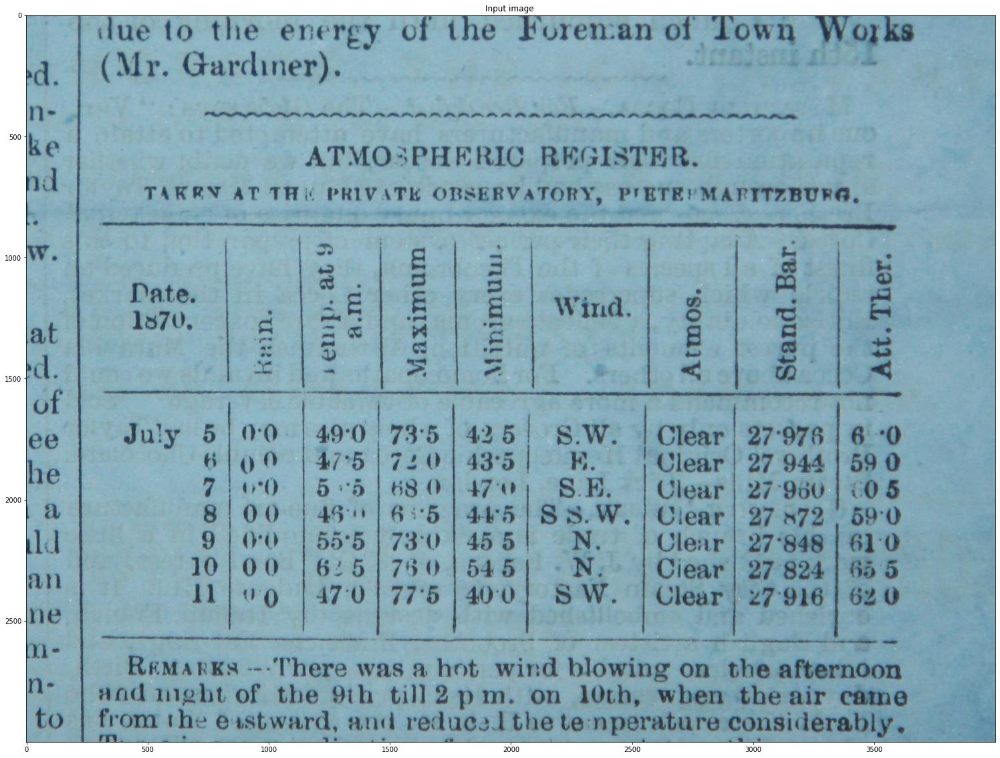

In [59]:
filename = 118
img_path = f'/data/glosat/Code-Git/docformer/dataset/Finetuning/test/images/{filename}.jpg'

img = cv.imread(img_path)

plt.rcParams["figure.figsize"] = (30,20)
plt.imshow(img)
plt.title('Input image ')
plt.show()

In [60]:
def thresholding(image):
    return cv.threshold(image, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)[1]

def image_preprocessing(img):
#     img = cv.resize(img, (800,1200), interpolation = cv.INTER_AREA)
    #Binarization
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    # Do dilation and erosion to eliminate unwanted noises
    kernel = np.ones((1,1), np.uint8)
    img = cv.dilate(img, kernel, iterations=30)
    img = cv.erode(img, kernel, iterations=30)

    #thresholding
    img = thresholding(img)
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    w,h,c = img.shape
    
    return img,h,w,c


In [9]:
def find_text_region(img, label_idx_color_mapping):
    
    print(f'Save preprocessed image')
    im_pil = Image.fromarray(img)
    im_pil.save(f"temp.jpg")
    
    # Normalize and convert to Tensor
    inp = np.array(img, dtype=np.float32) / 255
    if normalize:
        inp = ((inp - inp.mean(axis=(0, 1))) / (inp.std(axis=(0, 1)) + 10**-7))
    inp = torch.from_numpy(inp.transpose(2, 0, 1)).float().to(device)

    # compute prediction
    pred = model_extractor(inp.reshape(1, *inp.shape))[0].max(0)[1].cpu().numpy()

    # Retrieve good color mapping and transform to image
    pred_img = LabeledArray2Image.convert(pred, label_idx_color_mapping)

    # Blend predictions with original image    
    mask = Image.fromarray((np.array(pred_img) == (0, 0, 0)).all(axis=-1).astype(np.uint8) * 127 + 128)
    blend_img = Image.composite(im_pil, pred_img, mask)
    
    mask = torch.from_numpy(pred)
    mask = mask.unsqueeze(0)

    # We get the unique colors, as these would be the object ids.
    obj_ids = torch.unique(mask)

    # first id is the background, so remove it.
    obj_ids = obj_ids[1:]

    # split the color-encoded mask into a set of boolean masks.
    # Note that this snippet would work as well if the masks were float values instead of ints.
    masks = mask == obj_ids[:, None, None]

    return masks, blend_img 

In [61]:
img, h, w, c = image_preprocessing(img)
masks, blend_img = find_text_region(img, label_idx_color_mapping)

blend_img.save(f'{filename}_text_region.jpg')

Save preprocessed image


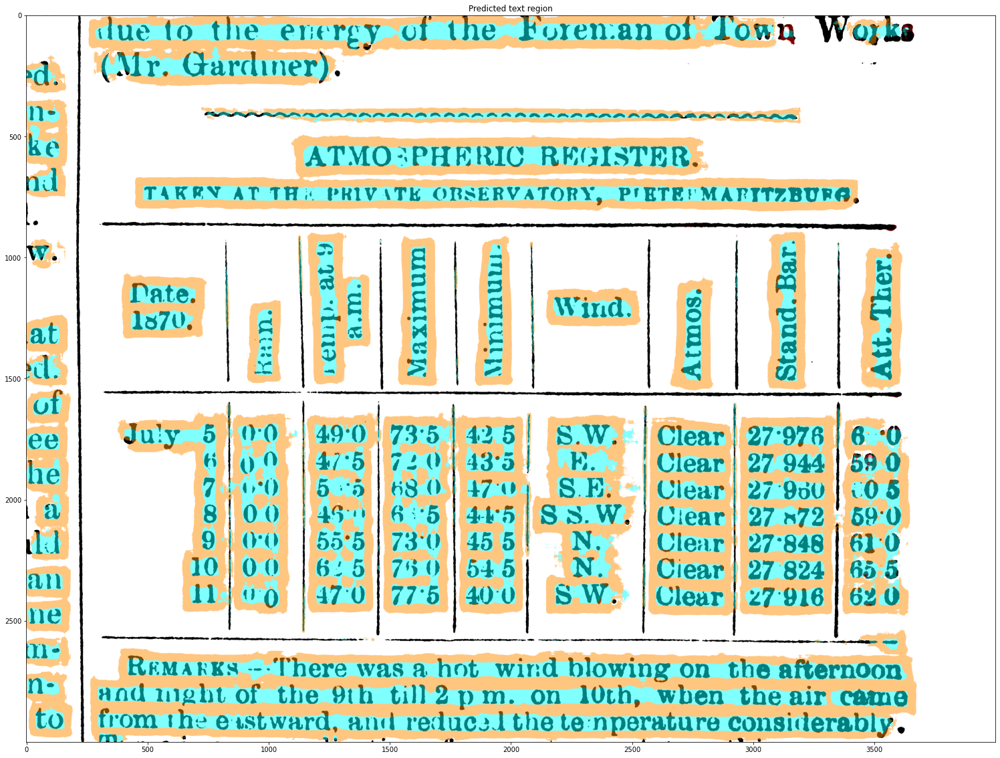

In [62]:
plt.rcParams["figure.figsize"] = (30,20)
plt.imshow(blend_img)
plt.title('Predicted text region')
plt.show()

### Intern code

In [12]:
from mmdet.apis import init_detector, inference_detector, show_result_pyplot
import mmcv
import cv2 as cv
import collections

In [13]:
import dla.src.table_structure_analysis as tsa
import dla.src.xml_utils as xml_utils
from dla.src.image_utils import put_box, put_line
import pytesseract
import numpy as np

In [14]:
config_file = '/data/glosat/glosat_table_dataset/dla/config/cascadeRCNN.py'
# download the checkpoint from model zoo and put it in `checkpoints/`

table_checkpoint_file = '/data/glosat/glosat_table_dataset/models/model_fulltables_only_GloSAT.pth'
# table_checkpoint_file = '/data/glosat/glosat_table_dataset/models/model_tables_enchanced_GloSAT.pth'

cell_checkpoint_file = '/data/glosat/glosat_table_dataset/models/model_coarsecell_GloSAT.pth'

In [15]:
THRESHOLD = 0.5
CLASSES = ("table_body","cell","full_table","header","heading")

In [16]:
model = init_detector(config_file, table_checkpoint_file, device='cuda:0')

/data/glosat/glosat_table_dataset/mmdetection/mmdet/apis/inference.py:40: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


In [17]:
cell_model = init_detector(config_file, cell_checkpoint_file, device='cuda:0')

### Cell classification

In [18]:
def detect_cell_pretrained(cell_model,img):
    result = inference_detector(cell_model, img)
    return result[CLASSES.index("cell")].tolist()

In [63]:
cells_by_image = collections.defaultdict(list)
cells_by_image[filename] = detect_cell_pretrained(cell_model,img)

/home/gyanendro/.local/lib/python3.7/site-packages/torch/nn/functional.py:2506: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


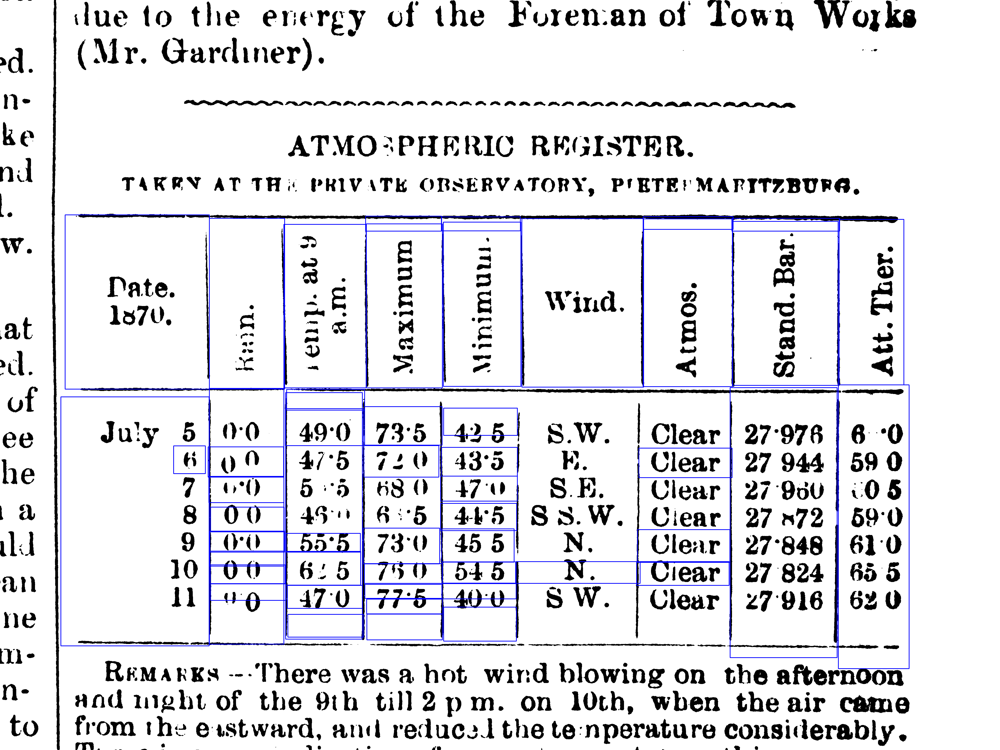

In [64]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)


for box in cells_by_image[filename]:
    put_box(image,box,(0,0,255))

im_pil = Image.fromarray(image)
# im_pil.save("temp_intern.jpg")
im_pil

### Table detection

In [21]:
def detect_table_region(model,image):
    result = inference_detector(model,image)
    #Process table headings
    headings = []
    for box in result[CLASSES.index("heading")]:
        if box[4]>THRESHOLD :
            headings.append(box[0:4])

    #Process table headers
    headers = []
    for box in result[CLASSES.index("header")]:
        if box[4]>THRESHOLD :
            headers.append(box[0:4])

    #Process table bodies
    tables = []
    for box in result[CLASSES.index("table_body")]:
        if box[4]>THRESHOLD :
            tables.append(box[0:4])

    full_tables = []
    for box in result[CLASSES.index("full_table")]:
        if box[4]>THRESHOLD :
            full_tables.append(box[0:4])
            if all(tsa.how_much_contained(table,box)<0.5 for table in tables):
                tables.append(box[0:4])
                
    for table in tables:
        if all(tsa.how_much_contained(table,full_table)<0.5 for full_table in full_tables):
            full_tables.append(table)
            
    return full_tables, tables

In [65]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

In [66]:
full_tables, tables = detect_table_region(model,image)

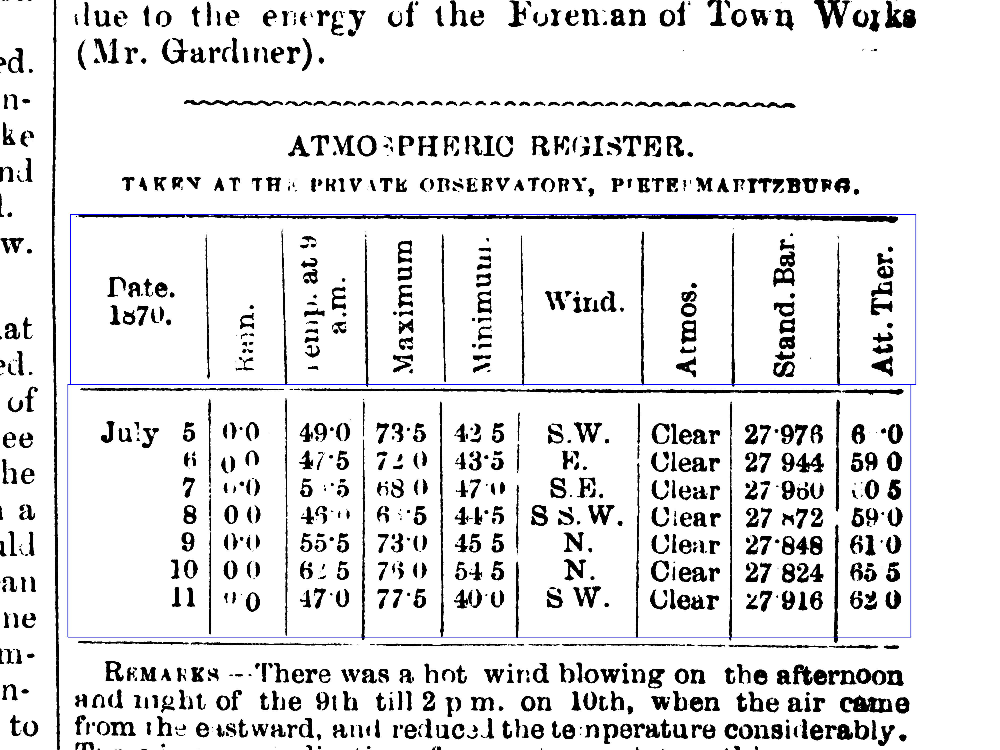

In [67]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)


for box in tables:
    put_box(image,box,(0,0,255))

im_pil = Image.fromarray(image)
# im_pil.save("temp_intern.jpg")
im_pil

### Check bounding box

In [25]:
def check_bounding_box(imagedraw,mask):
    scores = []
    count = 0
    
    key = imagedraw[1]
    for bol in mask[key,imagedraw[0]:imagedraw[2]]:  #Height
        if bol:
            count+=1
    score = count/len(mask[key,imagedraw[0]:imagedraw[2]])
    scores.append(score)
    if score<0.2: 
        top_height = True
    else:
        top_height = False
        
    count = 0
    key = imagedraw[3]
    for bol in mask[key,imagedraw[0]:imagedraw[2]]:  #Height
        if bol:
            count+=1
    score = count/len(mask[key,imagedraw[0]:imagedraw[2]])
    scores.append(score)
    if score<0.2:
        bottom_height = True
    else:
        bottom_height = False

    count = 0
    key = imagedraw[0]
    for bol in mask[imagedraw[1]:imagedraw[3],key]:  #width
        if bol:
            count+=1
    score = count/len(mask[imagedraw[1]:imagedraw[3],key])
    scores.append(score)
    if score<0.1:
        left_width = True
    else:
        left_width = False
        
    count = 0    
    key = imagedraw[2]
    for bol in mask[imagedraw[1]:imagedraw[3],key]:  #width
        if bol:
            count+=1
    score = count/len(mask[imagedraw[1]:imagedraw[3],key])
    scores.append(score)
    if score<0.1:
        right_width = True
    else:
        right_width = False
        
    return (top_height, bottom_height, left_width, right_width), scores

In [26]:
def has_object(imagedraw, image, mask):
    imagedraw = list(map(int, imagedraw))
    croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
    h, w, c = croppedimage_full.shape
    
    count = 0
    for cell_mask in mask[imagedraw[1]:imagedraw[3],imagedraw[0]:imagedraw[2]]:
        for bol in cell_mask:  
            if bol:
                count+=1
    
    if w>2 and h>2:
        if 100*(count/(w * h)) > 1:
            return True
        else:
            return False
    else:
        return False


In [27]:
def classify_single_cell(cells):    
    x = torch.IntTensor(cells)
    x = x[:,0:4]
    value, index = x[:,1].sort()

    corrected_cells = []
    exclude_cells = []
    blank_cells = []
    for idx in index:
        imagedraw = cells[idx][0:4]
        imagedraw = list(map(int, imagedraw))
#         print(imagedraw,idx)
    #     if has_object(imagedraw, image):
        boolean, scores = check_bounding_box(imagedraw,masks[1])

        if all(boolean):
            corrected_cells.append(cells[idx])
        else:
            exclude_cells.append(cells[idx])
    return corrected_cells, exclude_cells

In [91]:
ori_correct_cells, exclude_cells = classify_single_cell(cells_by_image[filename])

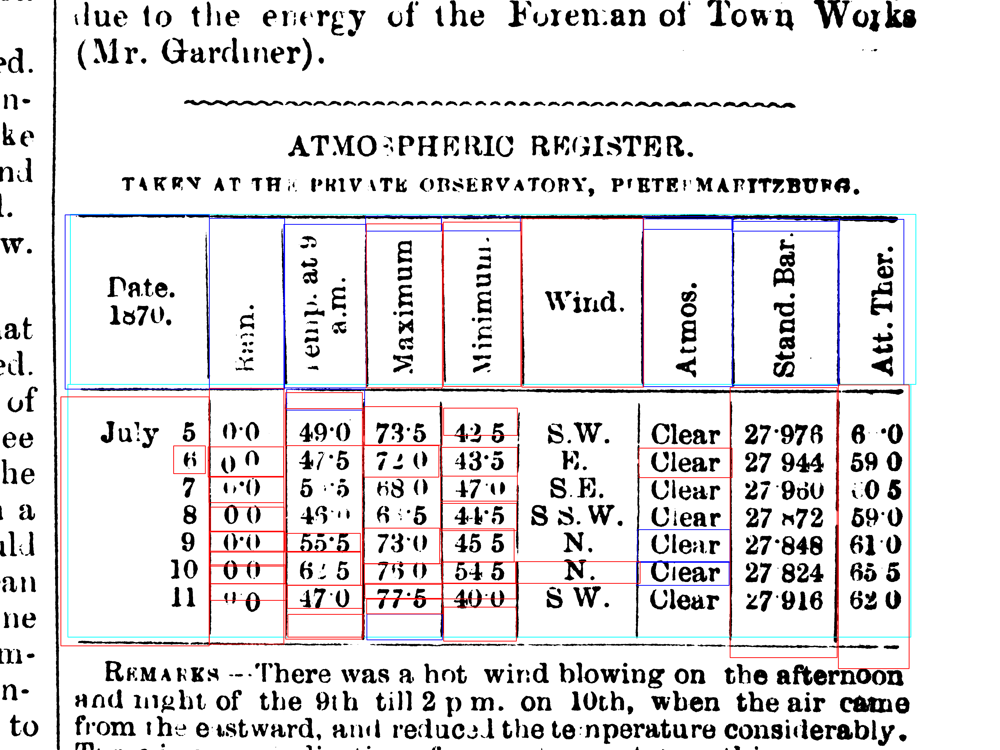

In [92]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
        
for box in ori_correct_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in exclude_cells:
#     print(box)
    put_box(image,box,(color,0,0)) # Red

im_pil = Image.fromarray(image)
im_pil.save(f"{filename}_table_cell_classification_pretrained.jpg")
im_pil  

### Segment cells

In [32]:
def segment_image(image, cell, mask,average_cordinates):
    cell = list(map(int, cell))
    pc = 0.4
    mask = masks[1]
    roi = mask[cell[1]:cell[3],cell[0]:cell[2]]
    rows, cols = roi.shape

    tid = cell[4]
    avg_x, avg_y = average_cordinates[tid]

    # check row by row first
    seg_x_region = []
    starting_flag = True
    
    for i in range(rows):
        if sum(roi[i,:])> cols*0.01 and starting_flag:
            seg_x_region.append(i-avg_y*0.05)
            starting_flag = False
            
        elif sum(roi[i,:]) < cols*0.01 and not starting_flag:
            seg_x_region.append(i+avg_y*0.05)
            starting_flag = True
            
    new_row_cells = []
    
    if len(seg_x_region)>1:
        last_end = 0
        flag = False
        for start,end in zip(seg_x_region[0:-1],seg_x_region[1:]):
            if abs(start - end)>avg_y/3:
                if last_end == 0:
                    new_row_cells.append(cell[1]+start) 
                    last_end = end
                else:
                    start = int((last_end+start)/2)
                    new_row_cells.append(cell[1]+start) 
                    last_end = end
                flag = True
            else:
                flag = False

        if flag:
            new_row_cells.append(cell[1]+end)  
    
    print(new_row_cells, avg_y*pc)
    new_row_cells = find_coordinates([cell[1]]+new_row_cells+[cell[3]], avg_y, pc)
    
    if len(new_row_cells)<2:
        new_row_cells = [cell[1],cell[3]]
    print('rows', cell, new_row_cells, avg_y)
        
        
    # check col by col 
    seg_y_region = []
    starting_flag = True

    for i in range(cols):
        if sum(roi[:,i]) > rows*0.05 and starting_flag:
    #         print(f'starting index {i} conditioned on {sum(roi[:,i])} > {rows*0.05}')
            seg_y_region.append(i-avg_x*0.05)
            starting_flag = False
        elif sum(roi[:,i])< rows*0.05 and not starting_flag:
    #         print(f'ending index {i} conditioned on {sum(roi[:,i])} > {rows*0.05}')
            seg_y_region.append(i+avg_x*0.05)
            starting_flag = True
            
    new_col_cells = []
    if len(seg_y_region)>1:
        last_end = 0
        flag = False
        for start,end in zip(seg_y_region[0:-1],seg_y_region[1:]):
            if abs(start - end)>avg_x/3:
                if last_end == 0:
                    new_col_cells.append(cell[0]+start) 
                    last_end = end
                else:
                    start = int((last_end+start)/2)
                    new_col_cells.append(cell[0]+start) 
                    last_end = end
                flag = True
            else:
                flag = False

        if flag:
            new_col_cells.append(cell[0]+end) 
    
    print(new_col_cells, avg_x*pc)
    new_col_cells = find_coordinates([cell[0]]+new_col_cells+[cell[2]], avg_x, pc)
            
    if len(new_col_cells)<2:
        new_col_cells= [cell[0],cell[2]] 
    print('cols', cell, new_col_cells, avg_x)

    return generate_new_cells(new_row_cells, new_col_cells,cell[4])

def get_table_coord(cell, tables):
    for idx,table in enumerate(tables):
        table = list(map(int, table))
        print(cell)
        score = tsa.how_much_contained(cell[0:4],table)    
        if score > 0.5:
            return idx, score 
    return [], score
    
def generate_new_cells(y_coords, x_coords,idx):
    possible_cells = []
    x_a = x_coords[0]
    for r, x_b in enumerate(x_coords[1:]):
        if abs(x_b-x_a)>2:
            row_a = [(int(x_a),y) for y in y_coords]
            row_b = [(int(x_b),y) for y in y_coords]
            
            for i in range(len(row_a)-1):
                imagedraw = (row_a[i]+row_b[i+1])
                imagedraw = list(map(int, imagedraw))

                xax = abs(imagedraw[2] - imagedraw[0])
                yax = abs(imagedraw[3] - imagedraw[1])
                possible_cells.append(imagedraw+[idx])
            x_a = int(x_b)
    return possible_cells

### Generate cells

In [33]:
from statistics import mean

In [34]:
def get_x_y_initial(tables, cells, THRESHOLD):   
    segment_headers =  False
    table_cells = []
    for tid, table in enumerate(tables):
        cells_x = []
        cells_y = []
        for box in cells:  #cells_by_image[img_path]: #
            cell = box[0:4] #(x0,y0,x1,y1)

            if box[4]>THRESHOLD:
                if tsa.how_much_contained(cell,table)>0.5:
                    cells_x.append(cell[0])
                    cells_x.append(cell[2])
                    cells_y.append(cell[1])
                    cells_y.append(cell[3])
                else:
                    pass
#                     print(cell,table)
        table_cells.append([cells_x, cells_y])
    return table_cells

def get_x_y(tables, cells):   
    segment_headers =  False
    table_cells = []
    for table in tables:
        cells_x = []
        cells_y = []
        for box in cells:  #cells_by_image[img_path]: #
            cell = box[0:4] #(x0,y0,x1,y1)
            
            if tsa.how_much_contained(cell,table)>0.5:
                cells_x.append(cell[0])
                cells_x.append(cell[2])
                cells_y.append(cell[1])
                cells_y.append(cell[3])
            else:
                pass
#                     print(cell,table)
        table_cells.append([cells_x, cells_y])
    return table_cells  

In [35]:
def average_list(cells):        
    x_avg = 0
    for i in cells:
        x_avg+=i
    x_avg = x_avg/len(cells)
    return x_avg

In [36]:
def find_coordinates(x_coords, x_avg, cell_size_pc):
    new_x_coords = []
    flag_j = False
    last_flag = True
    count = 0 

    for i,j in zip(x_coords[0:-1],x_coords[1:]):
        if count==0:
            new_x_coords.append(i)

        if abs(i-j)>x_avg*cell_size_pc:
            new_x_coords.append(j)
            flag_j = True
            last_flag = True

        elif not last_flag:
            new_x_coords.append(j)
            last_flag = True

        else:
            flag_j = False
            last_flag =  False

#         print(i,j,abs(i-j),x_avg*0.6, flag_j, last_flag)
        count+=1

    return new_x_coords


In [37]:
def avg_coordinates(cells_x):
    new_x = []   
    avg = mean([j-i for i,j in zip(cells_x[0:-1],cells_x[1:])])/3  ###why 3
#     print(cells_x, avg)
    
    while len(cells_x)>0:
        x=cells_x.pop()
        
        if len(new_x)>0 and abs(x - new_x[-1])<avg:  # last insert is near to current value then skip current value pop out
            new_x[-1] = int((x + new_x[-1])/2)
        else:
            if len(cells_x)>0:
                if abs(x - cells_x[-1])<avg:
                    n_c = int((x + cells_x[-1])/2)
                    x = cells_x.pop()
                    new_x.append(n_c)
                else:
                    new_x.append(x)
            else:
                new_x.append(x)
#             print(new_x)
    
    new_x = [i for i in reversed(new_x)] 
    return new_x

In [38]:
def get_coordinates(table_cells, pc):    
    cell_cordinates = []
    new_x = []
    new_y = []
    for cells_x, cells_y in table_cells:
        cells_x = list(map(int, cells_x))
        cells_x = list(set(cells_x))
        values, _ = torch.Tensor(cells_x).int().sort()
        cells_x = values.tolist()    

        cells_y = list(map(int, cells_y))
        cells_y = list(set(cells_y))
        values, _ = torch.Tensor(cells_y).int().sort()
        cells_y = values.tolist()

        new_y = list(cells_y)
        new_y = avg_coordinates(new_y)
#         new_y = avg_coordinates(new_y)
#     #     new_y = avg_coordinates(new_y)
#         print('----y',new_y,'\n')

        new_x = list(cells_x)
        new_x = avg_coordinates(new_x)
#         new_x = avg_coordinates(new_x)
    #     new_x = avg_coordinates(new_x)
    #     print('----x',new_x,'\n')
    #     print(new_x,'\n',new_y)
        cell_cordinates.append([new_x,new_y])
        
    average_cordinates = []
    for tid, (x_cords, y_cords) in enumerate(cell_cordinates):

        x_size = [abs(i-j) for i, j in zip(x_cords[0:-1], x_cords[1:])]
        y_size = [abs(i-j) for i, j in zip(y_cords[0:-1], y_cords[1:])]

        x_avg = average_list(x_size)
        y_avg = average_list(y_size)

        average_cordinates.append((x_avg, y_avg))
        
    new_cell_cordinates = []
    for idx, coords in enumerate(cell_cordinates):
        x_coords, y_coords = coords
        x_avg, y_avg = average_cordinates[idx]
        new_x_coords = find_coordinates(x_coords, x_avg, pc)
        new_y_coords = find_coordinates(y_coords, y_avg, pc)

#         print('x_coords',x_coords, x_avg, new_x_coords)
#         print('y_coords',y_coords, y_avg, new_y_coords)
        
        new_cell_cordinates.append([new_x_coords, new_y_coords])
    
    return new_cell_cordinates, average_cordinates

# print(new_x,'\n',new_y)   

In [39]:
# average nearby corodinates:
def find_average_coordinates(cells_x):
    new_x = []   
    avg = mean([abs(i-j) for i,j in zip(cells_x[0:-1],cells_x[1:])])/3
#     print(cells_x, avg)
    
    while len(cells_x)>0:
        x=cells_x.pop()
        
        if len(new_x)>0 and abs(x - new_x[-1])<avg:  # last insert is near to current value then skip current value pop out
            new_x[-1] = int((x + new_x[-1])/2)
        else:
            if len(cells_x)>0:
                if abs(x - cells_x[-1])<avg:
                    n_c = int((x + cells_x[-1])/2)
                    x = cells_x.pop()
                    new_x.append(n_c)
                else:
                    new_x.append(x)
            else:
                new_x.append(x)
#             print(new_x)
    
    new_x = [i for i in reversed(new_x)] 
    return new_x

In [40]:
def classify_cells(cells, mask, average_coordinates):
    x = torch.IntTensor(cells)
    x = x[:,0:4]
    value, index = x[:,1].sort()

    corrected_cells_new = []
    exclude_cells_new = []
    blank_cells_new = []

    for idx in index:
        imagedraw = cells[idx][0:4]
        tid = cells[idx][4]
        imagedraw = list(map(int, imagedraw))

        x_avg,y_avg = average_coordinates[tid]

        boolean, scores = check_bounding_box(imagedraw,mask)

        objects = has_object(imagedraw, image, mask)

        if all(boolean) and objects:
            corrected_cells_new.append(cells[idx])

        elif not objects:
            blank_cells_new.append(cells[idx])

        else:
            exclude_cells_new.append(cells[idx])

    return corrected_cells_new, blank_cells_new, exclude_cells_new

In [41]:
def generate_cells(mask, tables, cell_cordinates, average_coordinates):

    exclude_cells_pred = []
    possible_cells  = []
    
    for idx, table in enumerate(tables):
        x_avg, y_avg = average_coordinates[idx]
        
        x0,y0,xn,yn = table
        cells_x, cells_y = cell_cordinates[idx]
        cells_x = [x0]+cells_x
        cells_y = [y0]+cells_y
        
        cells_x = [x for x in cells_x if x<xn]
        cells_x+=[xn]
        cells_y = [y for y in cells_y if y<yn]
        cells_y+=[yn]

        x_a = x0
        for r, x_b in enumerate(cells_x):
            if (x_b-x_a)>2:
                row_a = [(int(x_a),y) for y in cells_y]
                row_b = [(int(x_b),y) for y in cells_y]

                select_cells = []

                for i in range(len(row_a)-1):
                    imagedraw = (row_a[i]+row_b[i+1])
                # select_cells

    #             for imagedraw in select_cells:
                    imagedraw = list(map(int, imagedraw))

                    xax = abs(imagedraw[2] - imagedraw[0])
                    yax = abs(imagedraw[3] - imagedraw[1])

                    if xax > x_avg/2 and yax > y_avg/2:
                        possible_cells.append(imagedraw+[idx])
                    else:
                        exclude_cells_pred.append(imagedraw+[idx])
                        
                x_a = int(x_b)
            
    return possible_cells, exclude_cells_pred

In [42]:
def find_overlapped_cell(corrected_cells, cells_pred):
    new_cells_pred = []
    for box in cells_pred:
        count=0        
#         croppedimage_check=image[int(box[1]):int(box[3]),int(box[0]):int(box[2])]

        for cells in corrected_cells:
#             croppedimage_target=image[int(cells[1]):int(cells[3]),int(cells[0]):int(cells[2])]
            
#             fig = plt.figure(figsize=(8, 8))
#             fig.add_subplot(1, 2, 1)
#             plt.imshow(croppedimage_check)
            
#             fig.add_subplot(1, 2, 2)
#             plt.imshow(croppedimage_target)              
#             plt.show()
            
            if tsa.how_much_contained(box, cells)>0.5:
                count+=1
#                 print('Yes')
                break
        if count==0:
#             print('No')
            new_cells_pred.append(box)
            
    return new_cells_pred

### Generate cell from corrected coordinates

In [111]:
def generate_cells_from_corrected_cells(tables, ori_correct_cells, mask):
    table_cells = get_x_y(tables, ori_correct_cells)
    cell_cordinates, average_cordinates = get_coordinates(table_cells,0.7)
    
    possible_cells, exclude_cells_pred = generate_cells(mask, tables, cell_cordinates, average_cordinates)
    correct_cells, blank_cells, exclude_cells = classify_cells(possible_cells, mask, average_cordinates)  
    
    not_ovellapped_correct_cells_pred =  find_overlapped_cell(ori_correct_cells, correct_cells)
    
    not_ovellapped_blank_cells_pred =  find_overlapped_cell(ori_correct_cells+not_ovellapped_correct_cells_pred, blank_cells)
    considered_cells = ori_correct_cells+not_ovellapped_correct_cells_pred+not_ovellapped_blank_cells_pred
    not_ovellapped_error_cells_pred =  find_overlapped_cell(considered_cells, exclude_cells+exclude_cells_pred)
    
    return not_ovellapped_correct_cells_pred, not_ovellapped_blank_cells_pred, not_ovellapped_error_cells_pred



In [142]:
not_ovellapped_correct_cells_pred, not_ovellapped_blank_cells_pred, not_ovellapped_error_cells_pred = generate_cells_from_corrected_cells(tables, ori_correct_cells, masks[1])

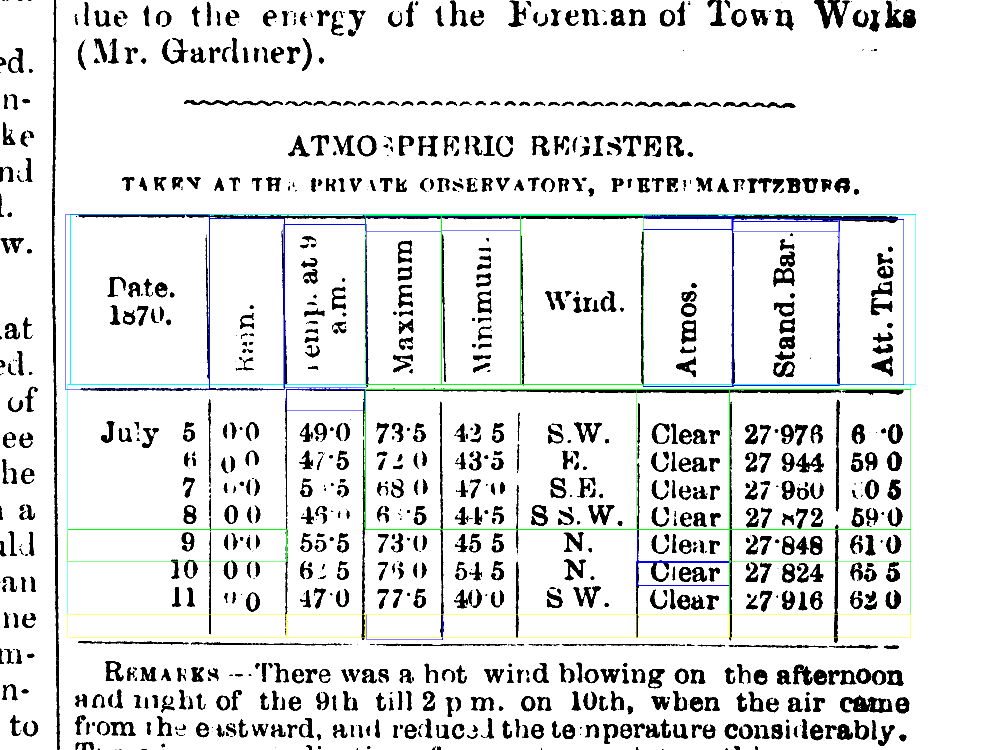

In [143]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in ori_correct_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in not_ovellapped_correct_cells_pred:
    put_box(image,box,(0,color,0)) # Green

# for box in not_ovellapped_error_cells_pred+exclude_cells:
#     put_box(image,box,(color,0,0)) # Red

for box in not_ovellapped_blank_cells_pred:
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
# im_pil.save(f"{filename}_temp_cell_classification_generation.jpg")
im_pil  

In [145]:
considered_cells = not_ovellapped_correct_cells_pred+ori_correct_cells
old_error_cells = not_ovellapped_error_cells_pred+exclude_cells

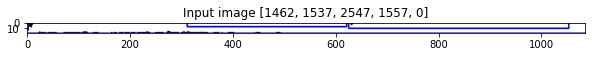

[1462, 1537, 2547, 1557, 0]


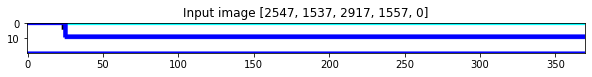

[2547, 1537, 2917, 1557, 0]


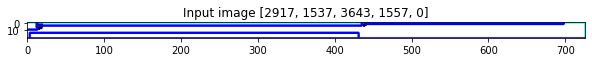

[2917, 1537, 3643, 1557, 0]


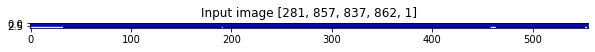

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


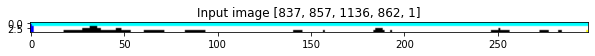

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


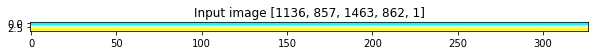

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


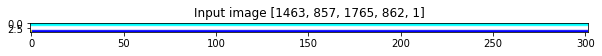

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


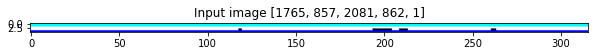

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


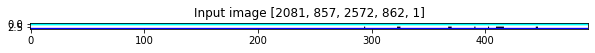

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


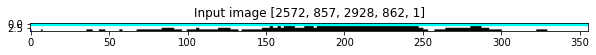

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


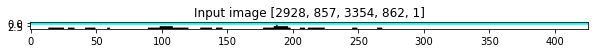

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


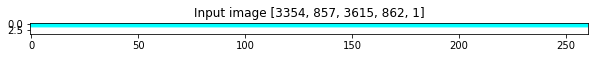

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


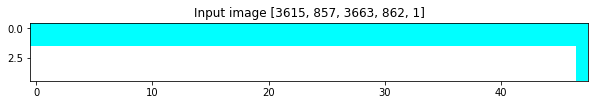

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


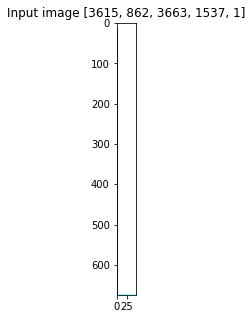

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


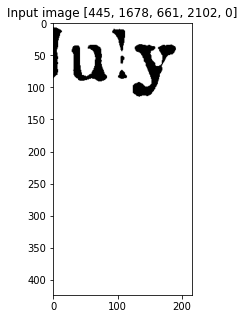

[445, 1678, 661, 2102, 0]


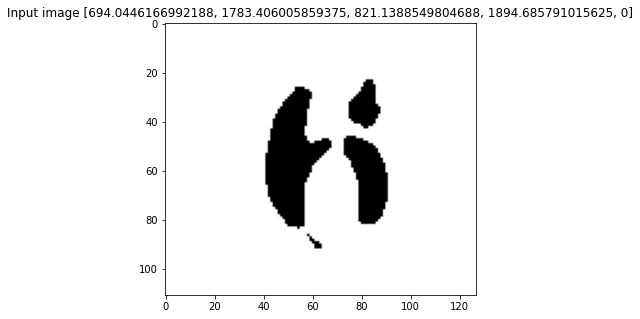

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


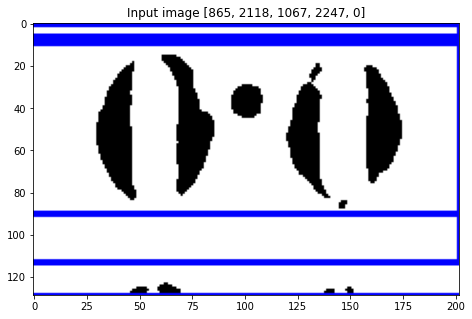

[865, 2118, 1067, 2247, 0]


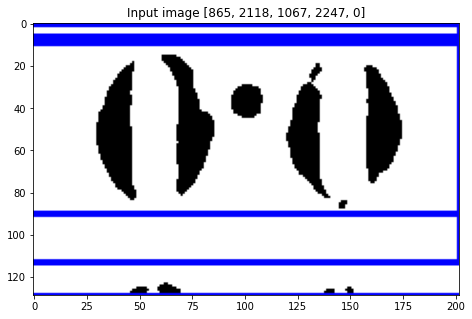

[865, 2118, 1067, 2247, 0]


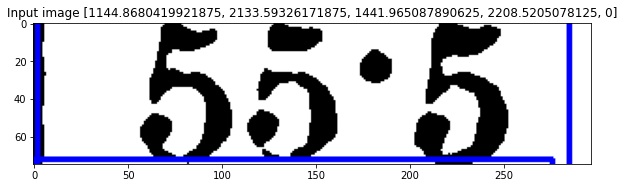

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


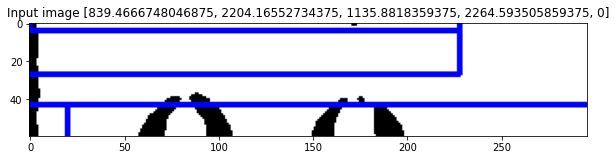

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


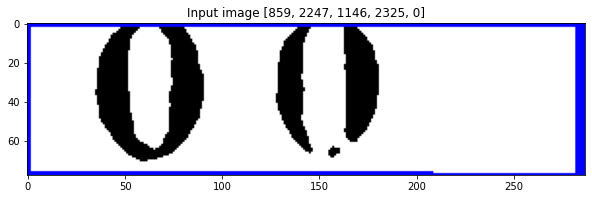

[859, 2247, 1146, 2325, 0]


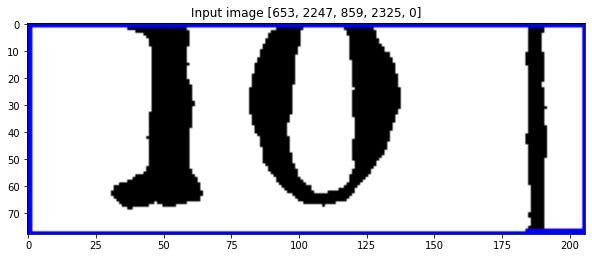

[653, 2247, 859, 2325, 0]


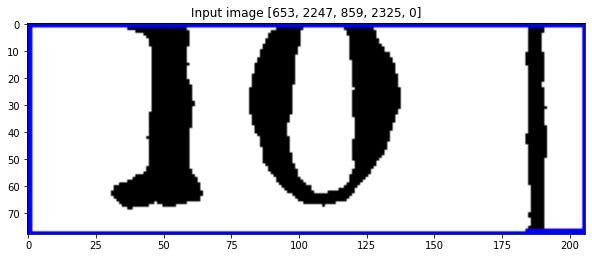

[653, 2247, 859, 2325, 0]


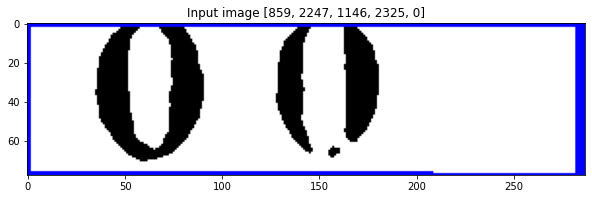

[859, 2247, 1146, 2325, 0]


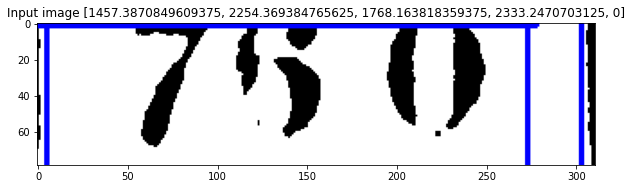

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


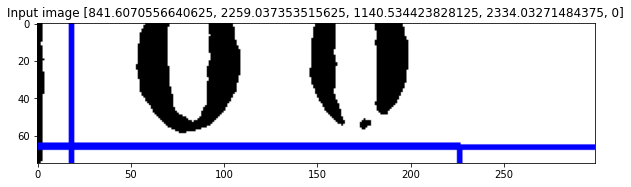

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


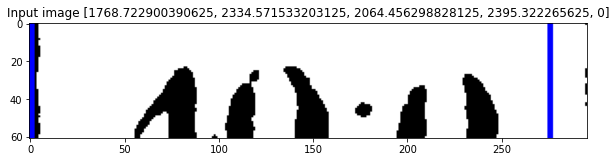

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


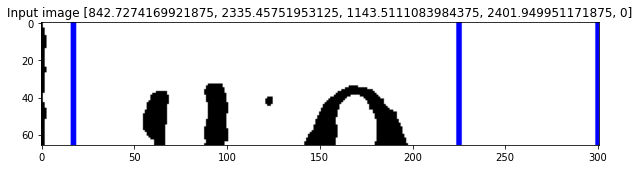

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


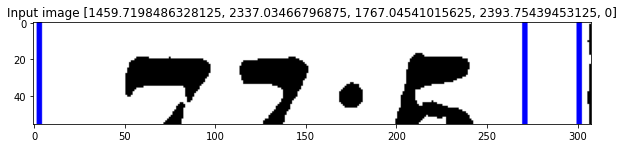

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


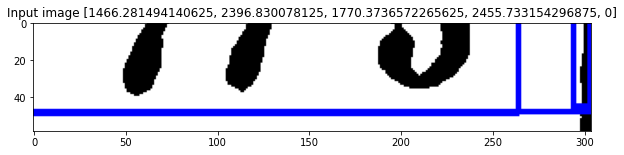

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


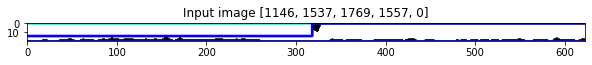

[1146, 1537, 1769, 1557, 0]


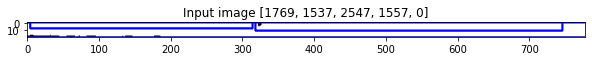

[1769, 1537, 2547, 1557, 0]


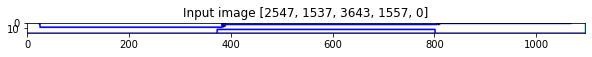

[2547, 1537, 3643, 1557, 0]


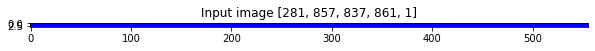

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


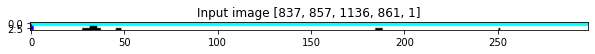

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


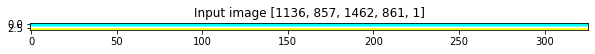

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


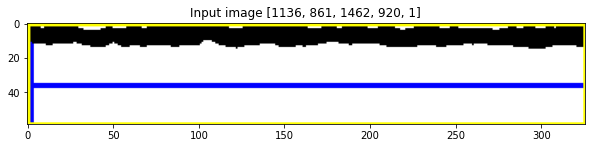

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


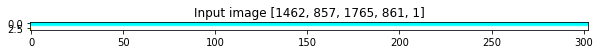

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


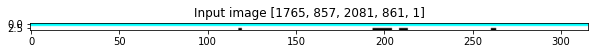

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


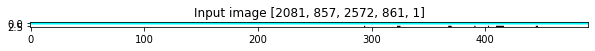

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


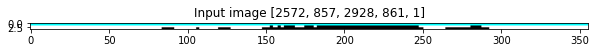

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


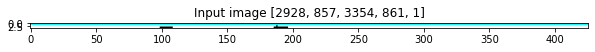

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


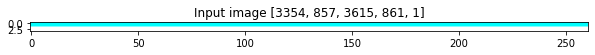

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


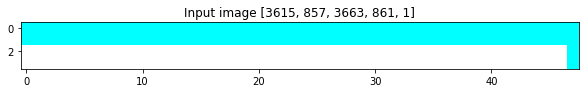

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


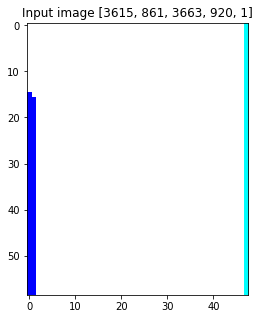

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


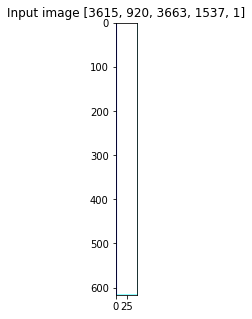

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


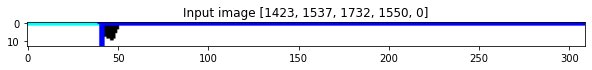

[1423, 1537, 1732, 1550, 0]


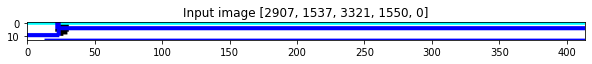

[2907, 1537, 3321, 1550, 0]


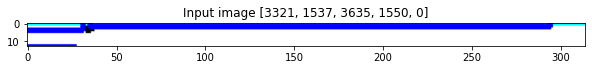

[3321, 1537, 3635, 1550, 0]


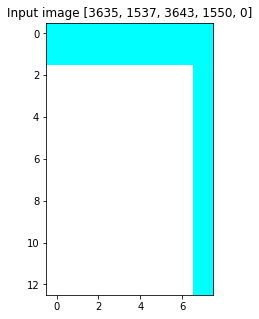

[3635, 1537, 3643, 1550, 0]


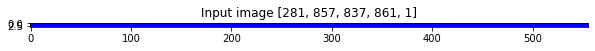

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


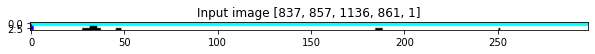

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


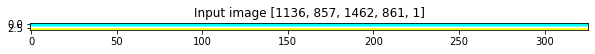

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


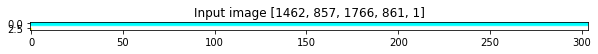

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


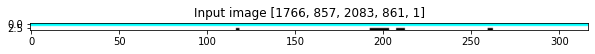

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


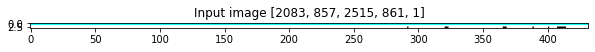

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


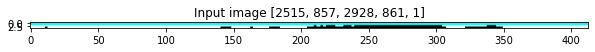

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


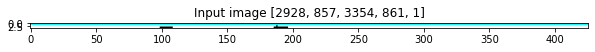

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


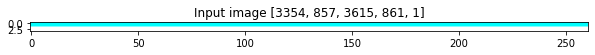

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


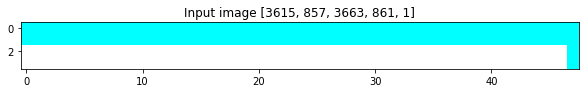

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


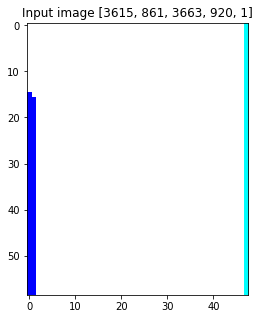

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


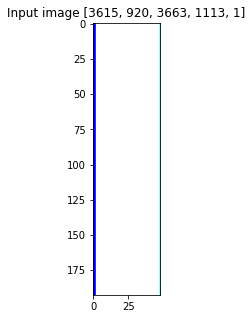

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


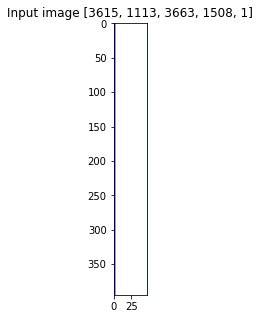

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


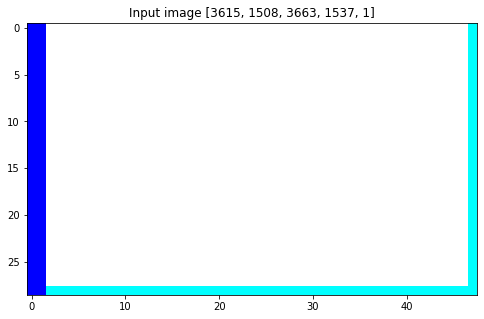

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


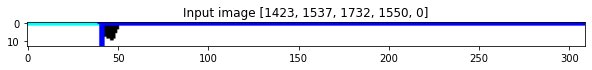

[1423, 1537, 1732, 1550, 0]


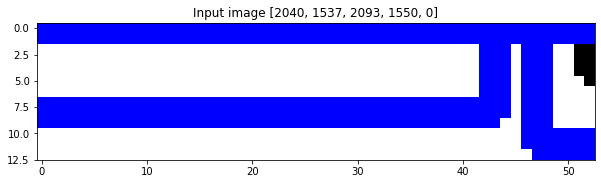

[2040, 1537, 2093, 1550, 0]


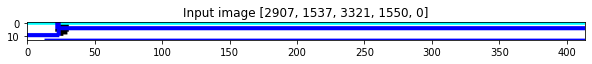

[2907, 1537, 3321, 1550, 0]


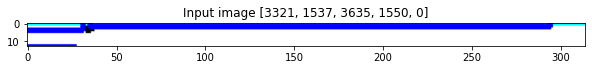

[3321, 1537, 3635, 1550, 0]


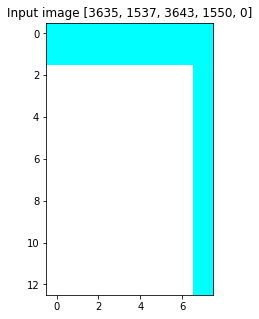

[3635, 1537, 3643, 1550, 0]


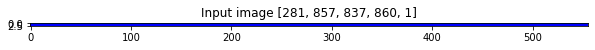

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


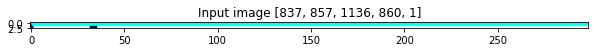

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


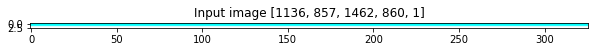

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


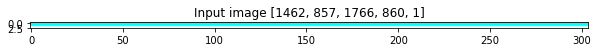

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


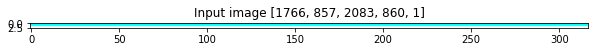

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


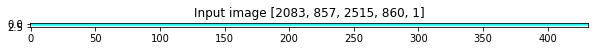

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


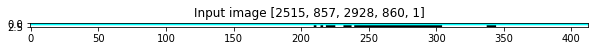

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


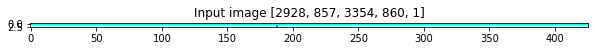

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


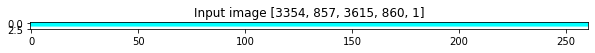

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


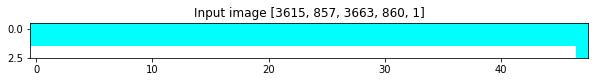

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


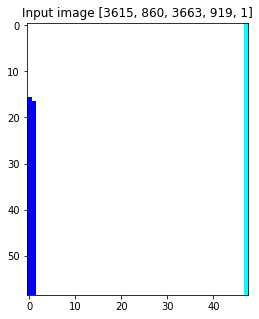

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


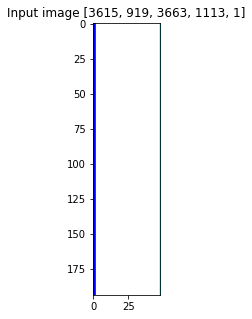

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


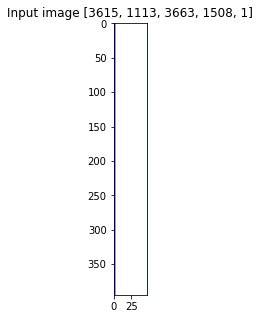

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


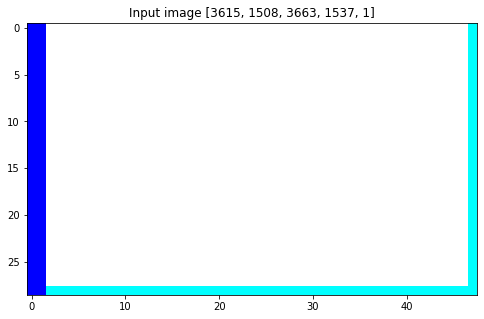

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


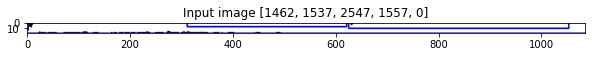

[1462, 1537, 2547, 1557, 0]


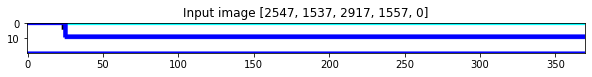

[2547, 1537, 2917, 1557, 0]


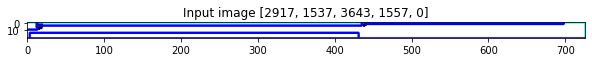

[2917, 1537, 3643, 1557, 0]


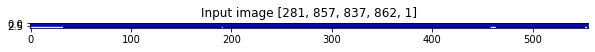

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


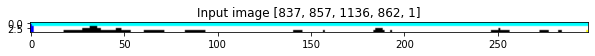

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


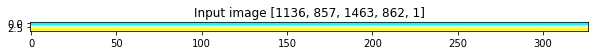

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


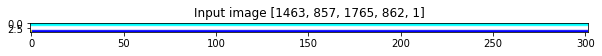

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


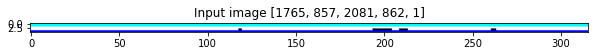

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


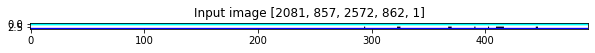

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


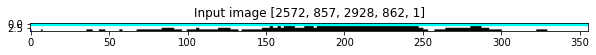

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


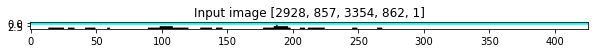

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


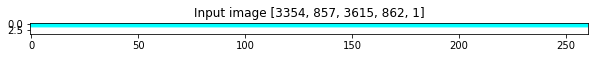

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


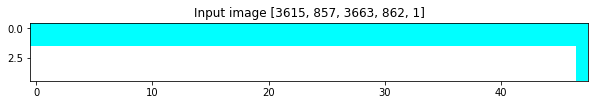

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


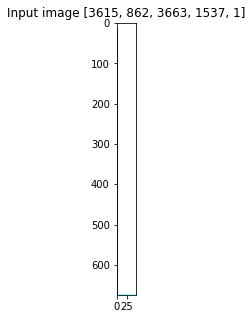

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


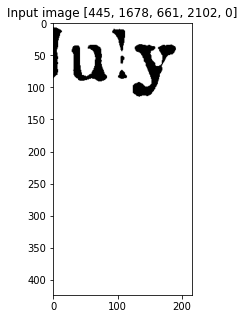

[445, 1678, 661, 2102, 0]


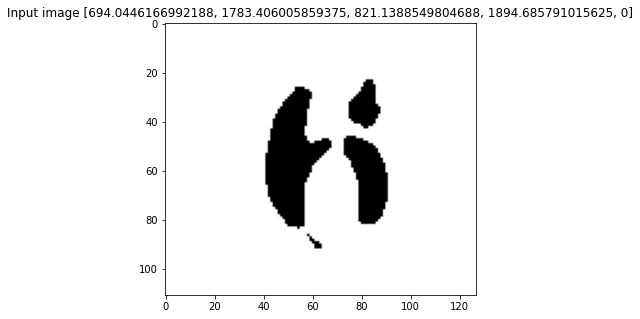

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


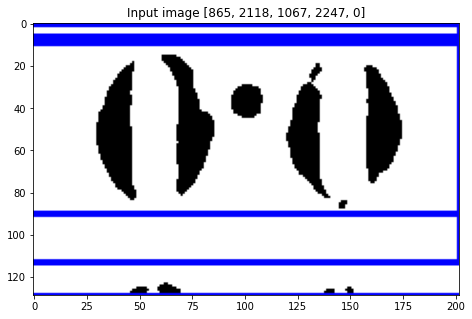

[865, 2118, 1067, 2247, 0]


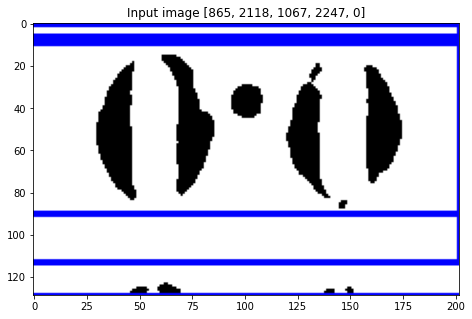

[865, 2118, 1067, 2247, 0]


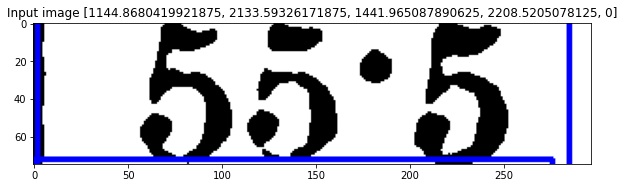

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


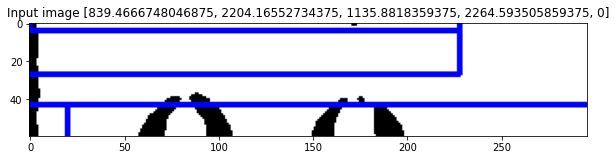

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


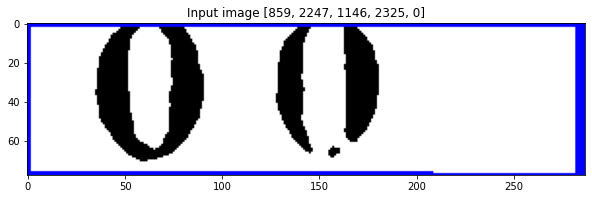

[859, 2247, 1146, 2325, 0]


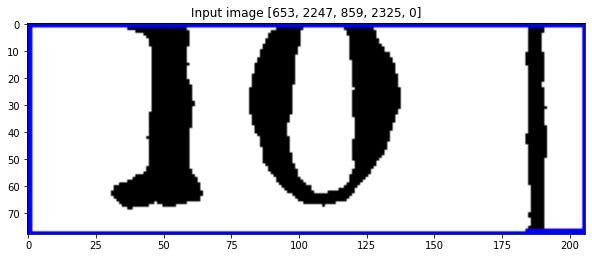

[653, 2247, 859, 2325, 0]


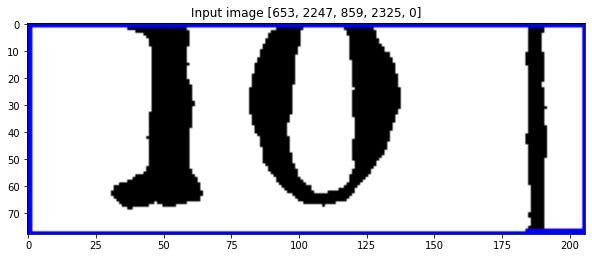

[653, 2247, 859, 2325, 0]


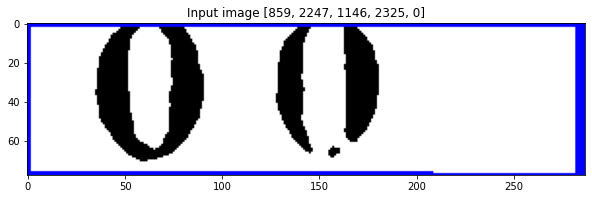

[859, 2247, 1146, 2325, 0]


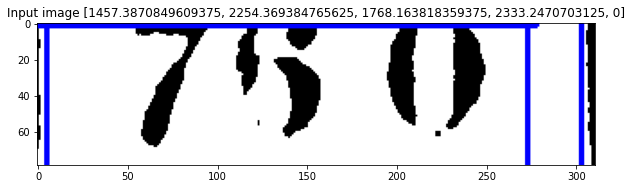

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


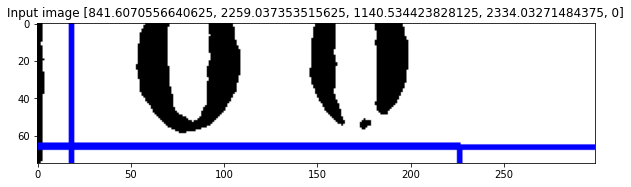

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


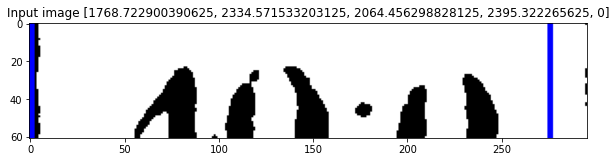

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


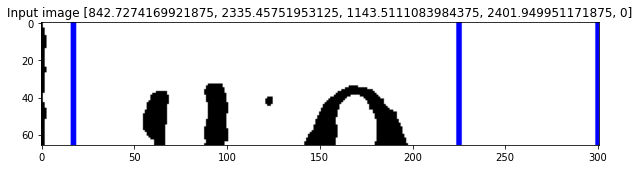

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


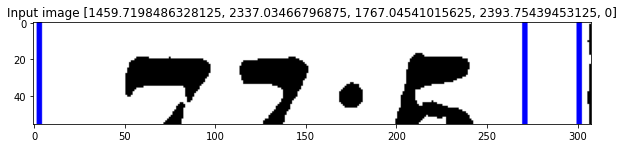

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


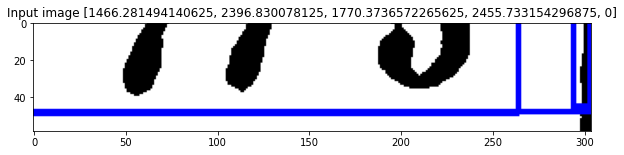

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


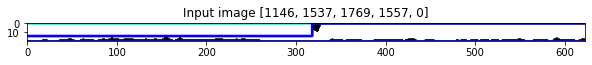

[1146, 1537, 1769, 1557, 0]


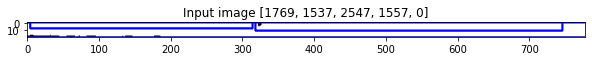

[1769, 1537, 2547, 1557, 0]


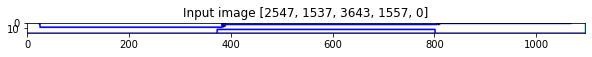

[2547, 1537, 3643, 1557, 0]


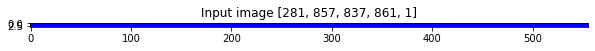

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


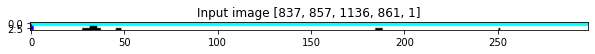

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


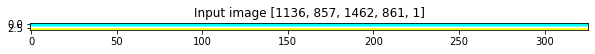

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


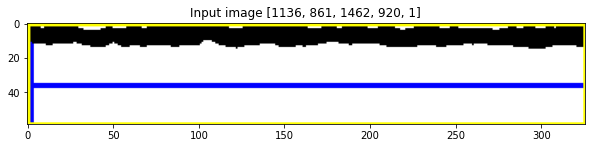

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


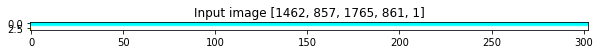

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


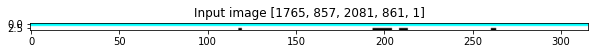

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


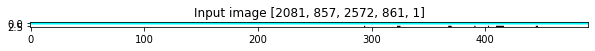

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


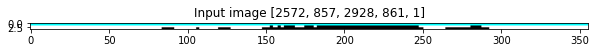

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


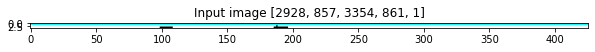

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


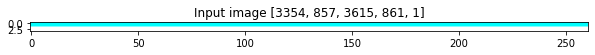

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


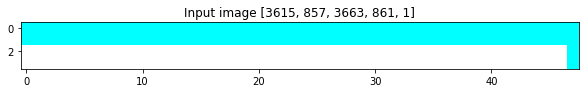

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


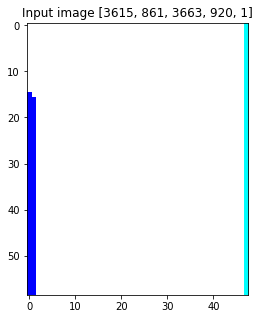

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


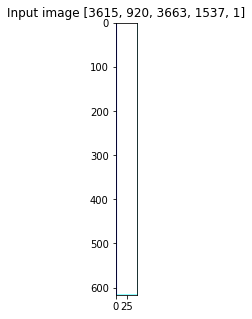

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


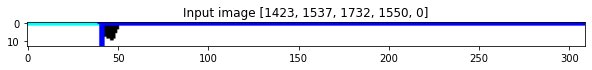

[1423, 1537, 1732, 1550, 0]


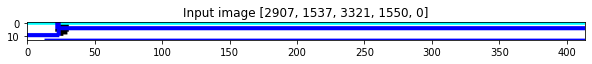

[2907, 1537, 3321, 1550, 0]


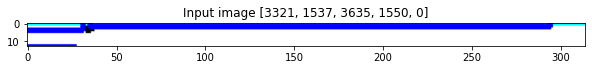

[3321, 1537, 3635, 1550, 0]


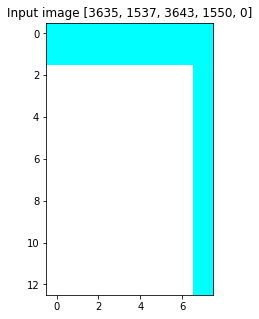

[3635, 1537, 3643, 1550, 0]


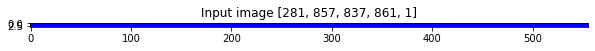

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


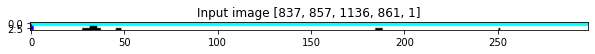

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


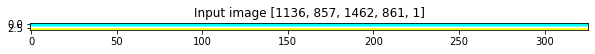

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


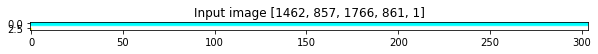

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


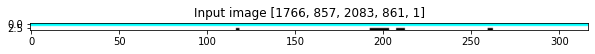

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


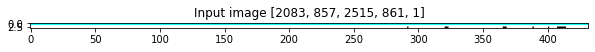

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


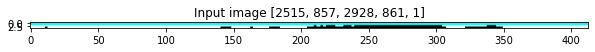

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


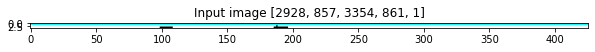

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


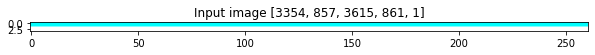

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


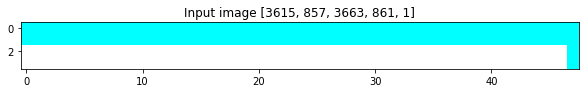

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


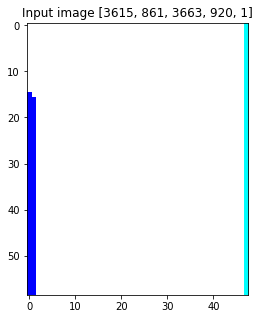

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


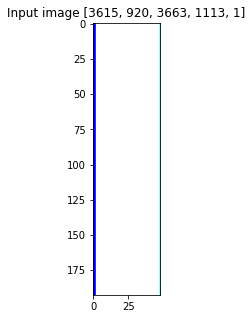

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


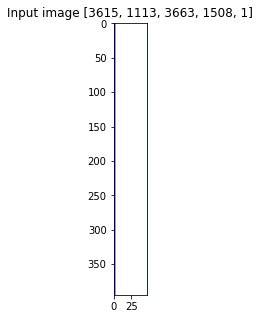

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


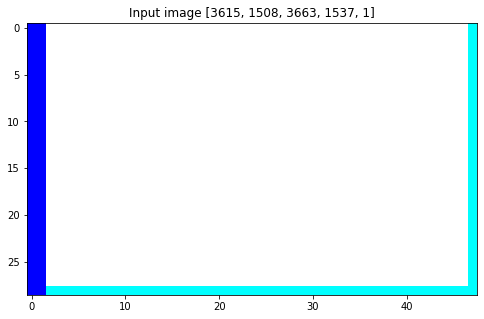

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


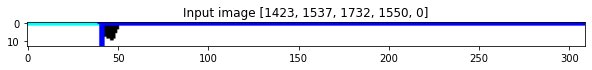

[1423, 1537, 1732, 1550, 0]


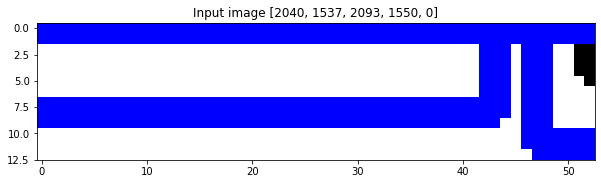

[2040, 1537, 2093, 1550, 0]


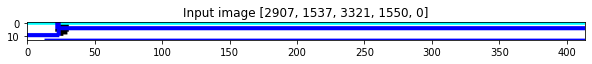

[2907, 1537, 3321, 1550, 0]


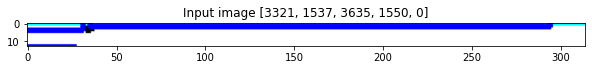

[3321, 1537, 3635, 1550, 0]


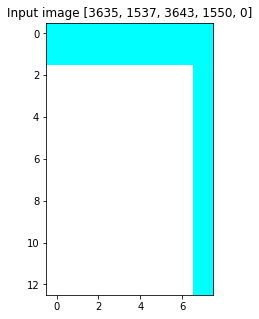

[3635, 1537, 3643, 1550, 0]


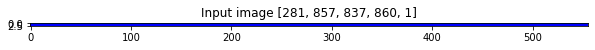

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


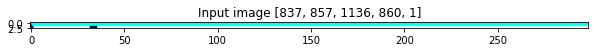

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


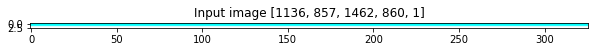

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


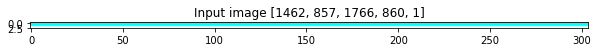

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


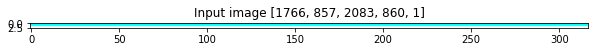

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


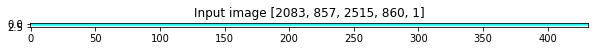

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


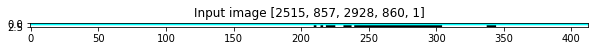

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


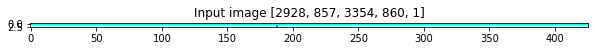

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


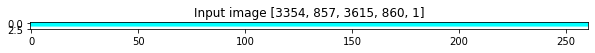

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


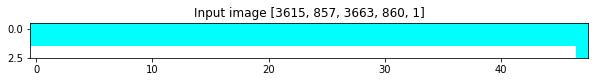

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


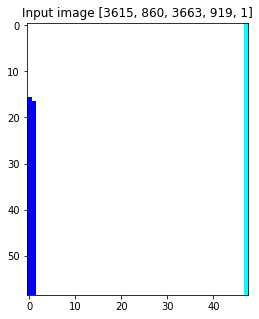

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


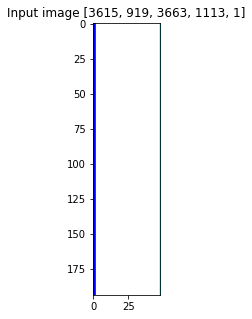

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


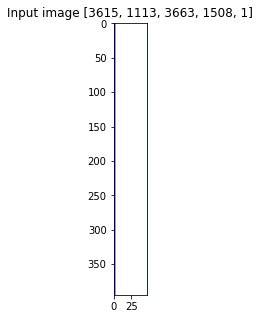

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


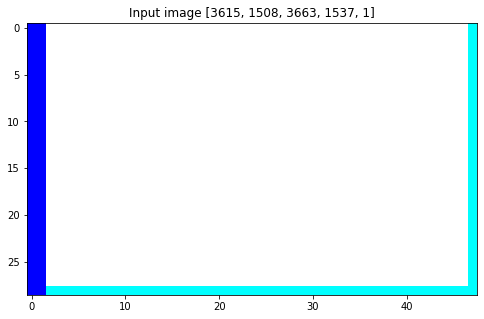

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


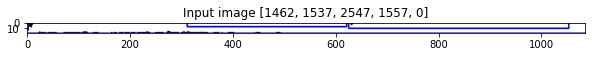

[1462, 1537, 2547, 1557, 0]


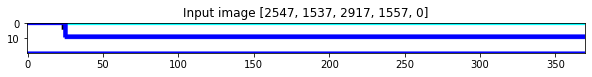

[2547, 1537, 2917, 1557, 0]


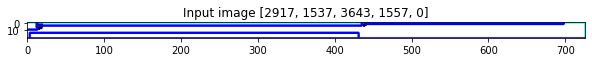

[2917, 1537, 3643, 1557, 0]


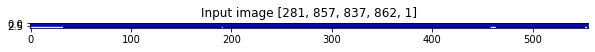

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


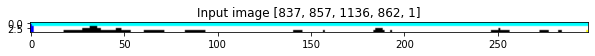

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


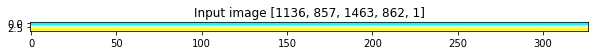

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


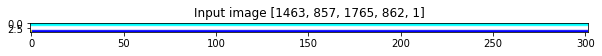

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


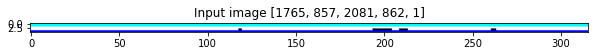

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


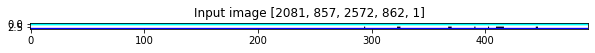

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


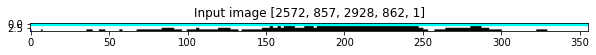

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


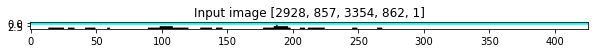

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


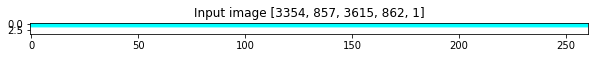

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


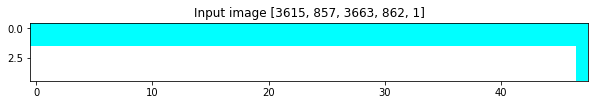

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


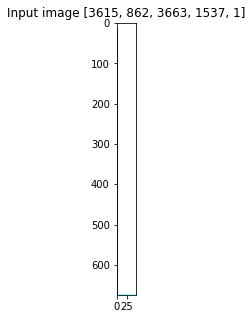

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


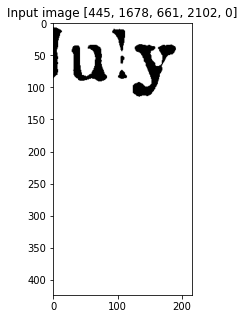

[445, 1678, 661, 2102, 0]


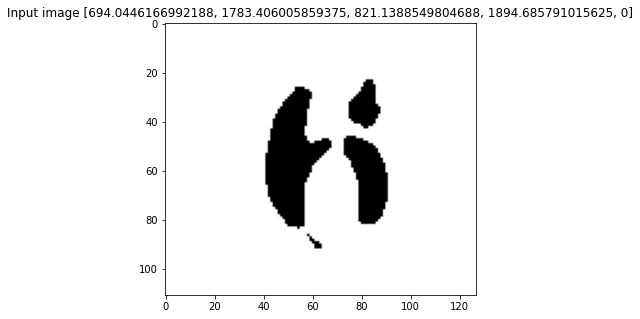

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


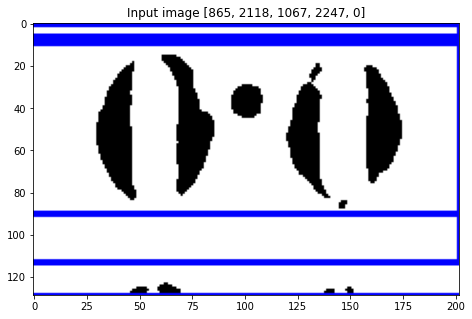

[865, 2118, 1067, 2247, 0]


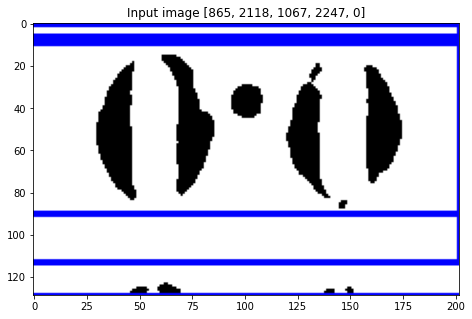

[865, 2118, 1067, 2247, 0]


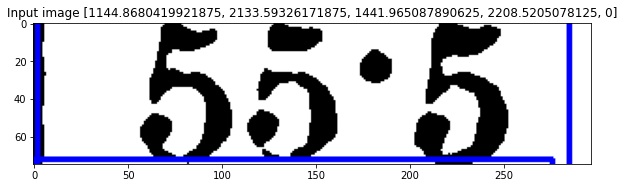

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


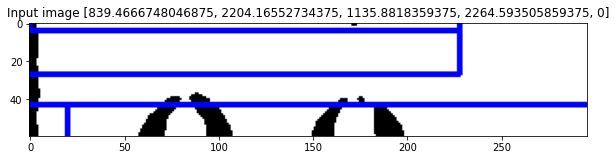

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


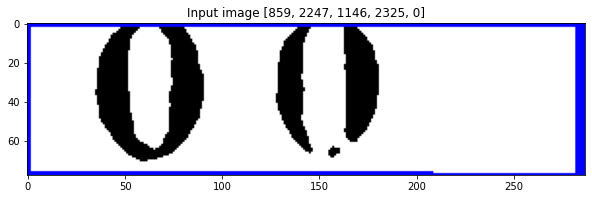

[859, 2247, 1146, 2325, 0]


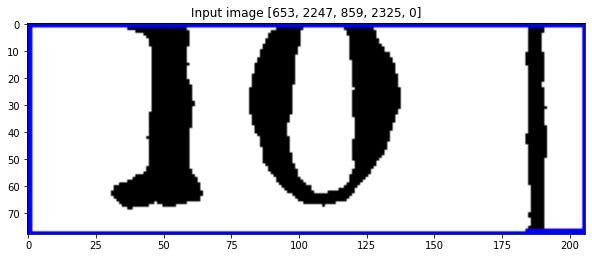

[653, 2247, 859, 2325, 0]


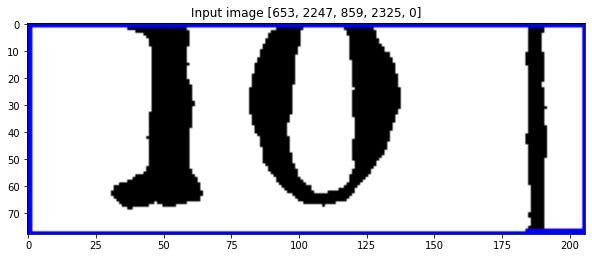

[653, 2247, 859, 2325, 0]


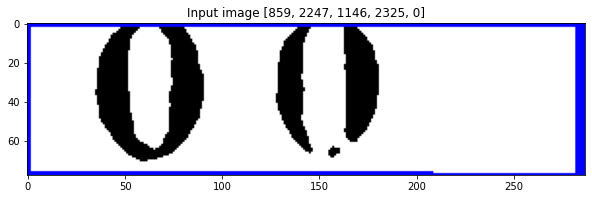

[859, 2247, 1146, 2325, 0]


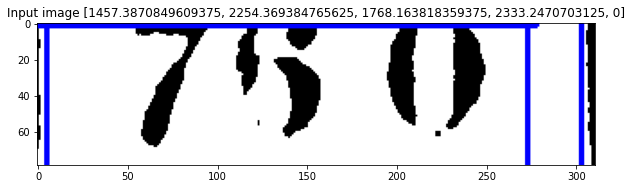

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


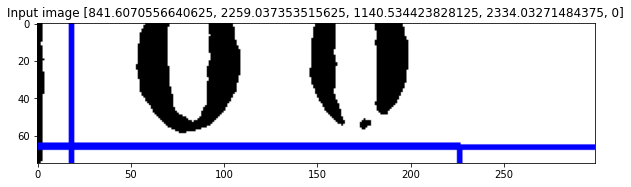

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


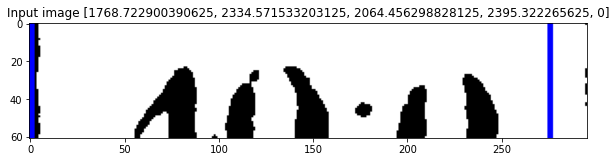

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


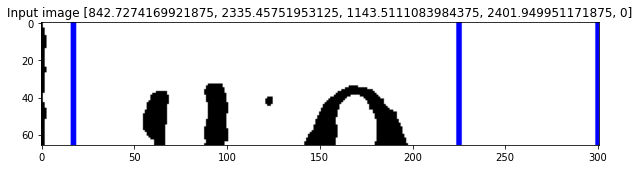

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


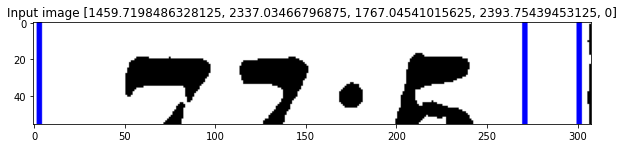

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


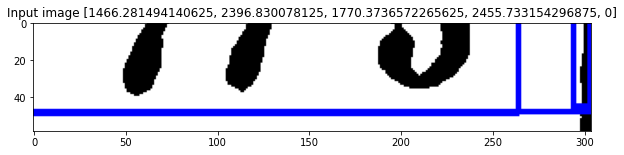

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


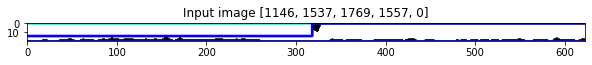

[1146, 1537, 1769, 1557, 0]


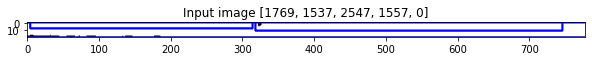

[1769, 1537, 2547, 1557, 0]


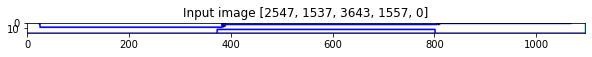

[2547, 1537, 3643, 1557, 0]


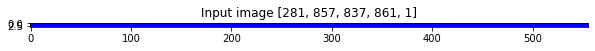

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


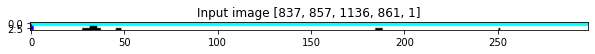

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


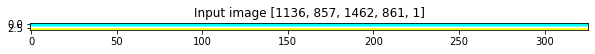

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


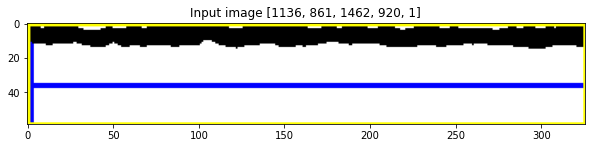

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


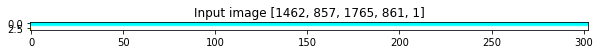

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


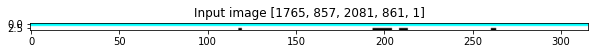

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


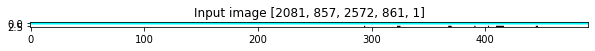

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


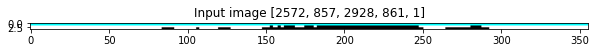

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


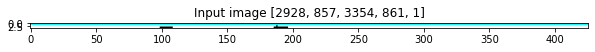

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


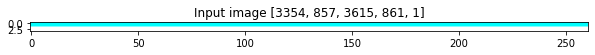

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


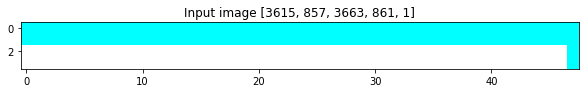

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


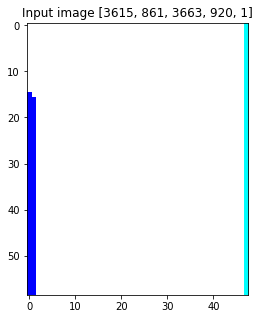

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


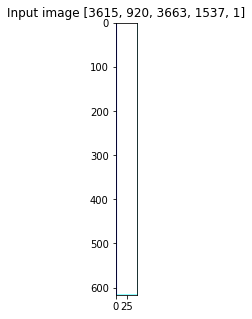

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


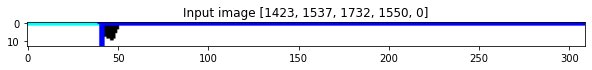

[1423, 1537, 1732, 1550, 0]


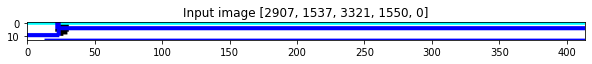

[2907, 1537, 3321, 1550, 0]


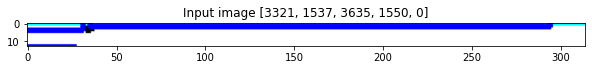

[3321, 1537, 3635, 1550, 0]


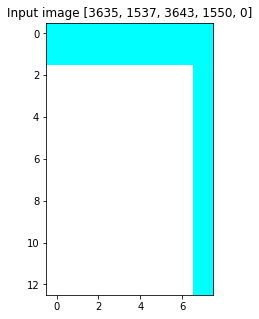

[3635, 1537, 3643, 1550, 0]


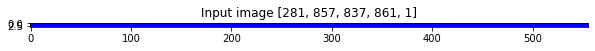

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


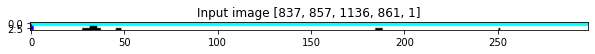

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


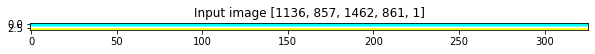

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


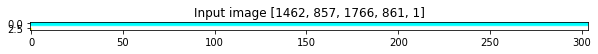

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


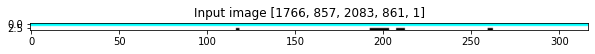

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


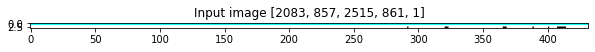

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


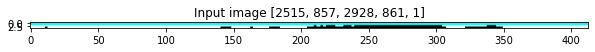

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


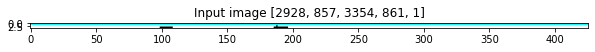

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


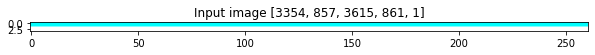

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


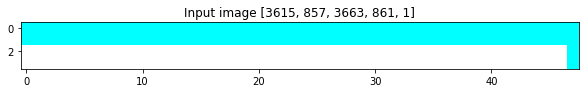

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


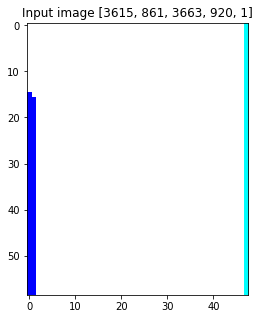

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


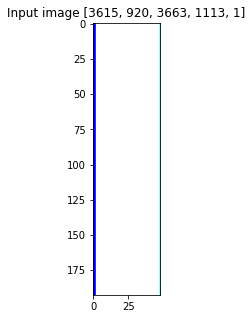

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


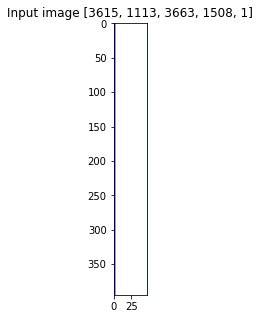

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


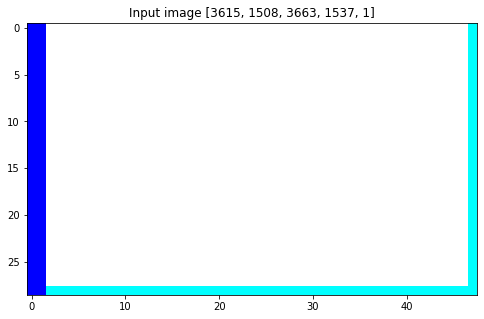

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


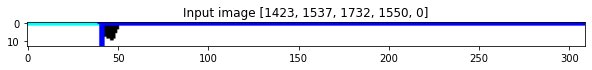

[1423, 1537, 1732, 1550, 0]


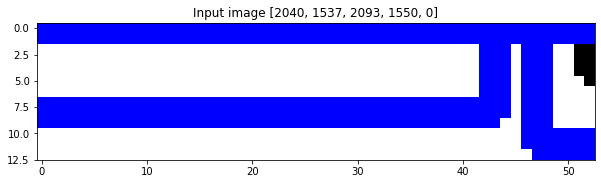

[2040, 1537, 2093, 1550, 0]


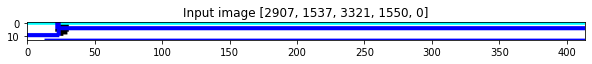

[2907, 1537, 3321, 1550, 0]


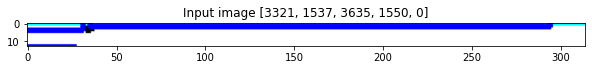

[3321, 1537, 3635, 1550, 0]


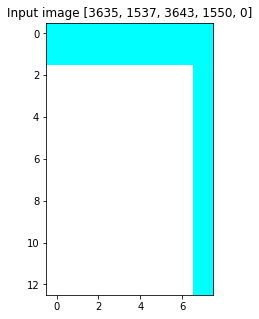

[3635, 1537, 3643, 1550, 0]


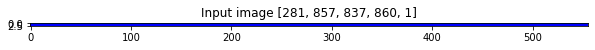

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


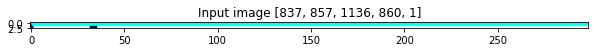

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


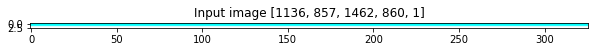

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


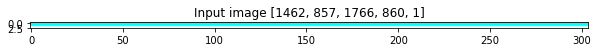

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


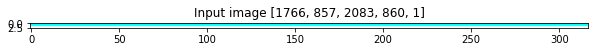

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


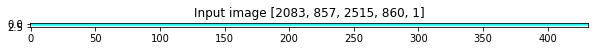

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


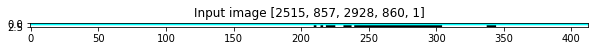

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


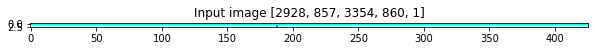

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


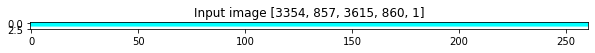

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


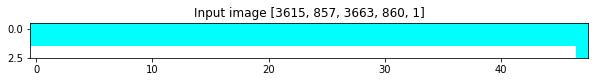

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


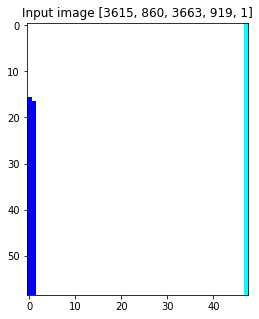

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


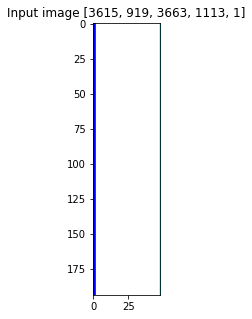

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


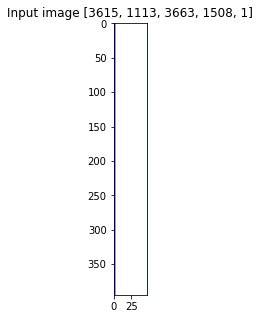

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


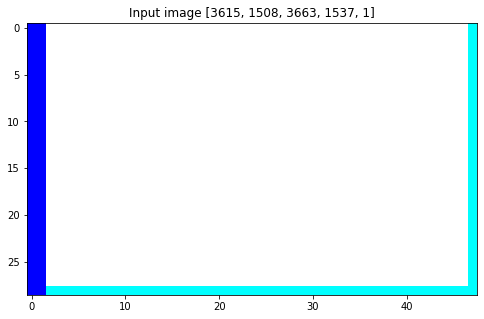

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


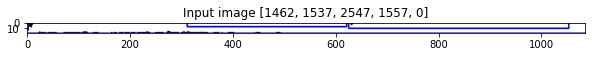

[1462, 1537, 2547, 1557, 0]


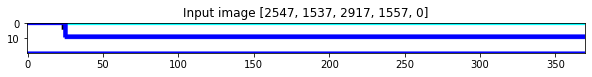

[2547, 1537, 2917, 1557, 0]


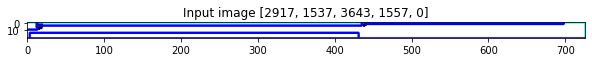

[2917, 1537, 3643, 1557, 0]


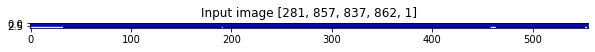

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


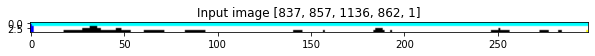

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


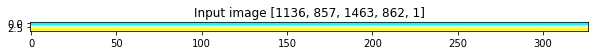

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


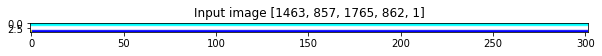

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


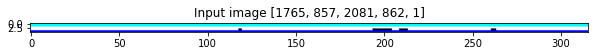

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


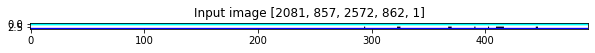

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


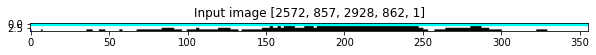

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


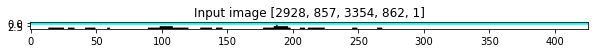

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


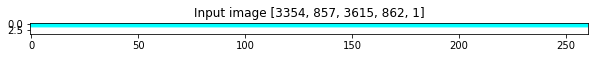

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


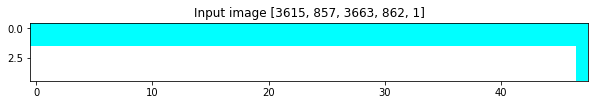

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


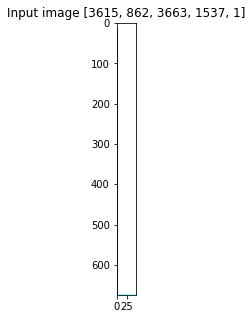

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


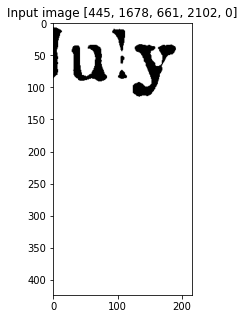

[445, 1678, 661, 2102, 0]


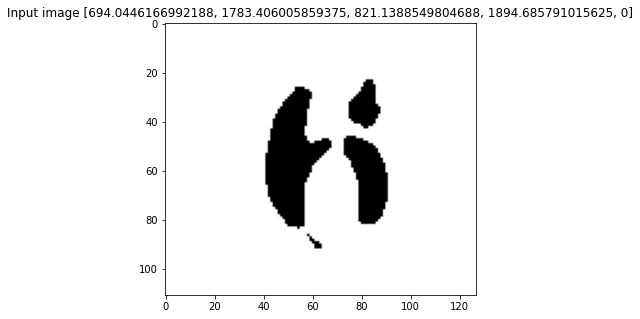

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


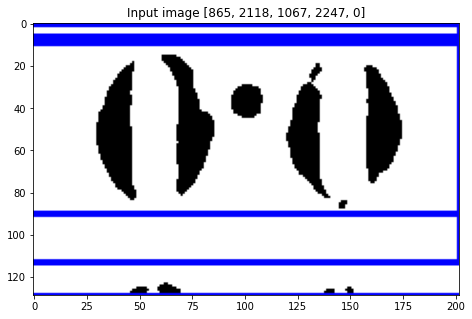

[865, 2118, 1067, 2247, 0]


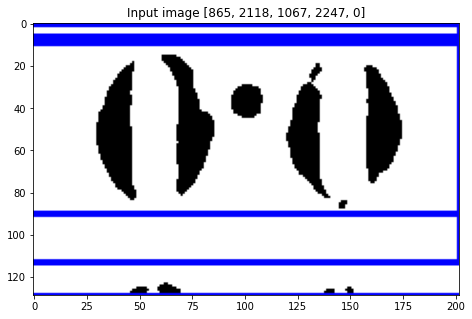

[865, 2118, 1067, 2247, 0]


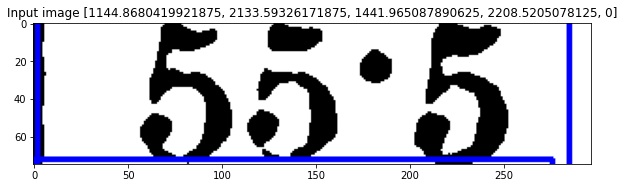

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


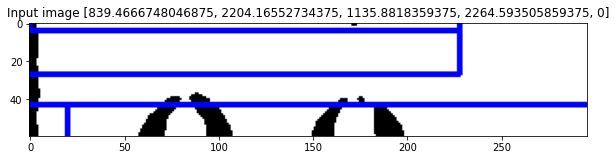

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


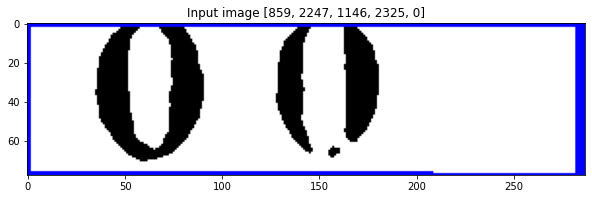

[859, 2247, 1146, 2325, 0]


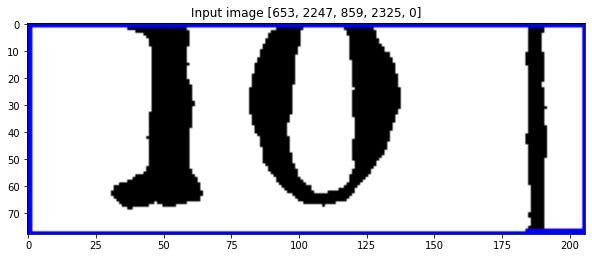

[653, 2247, 859, 2325, 0]


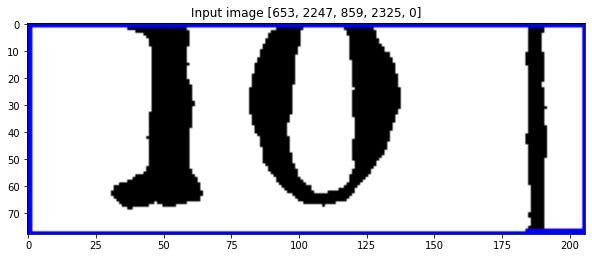

[653, 2247, 859, 2325, 0]


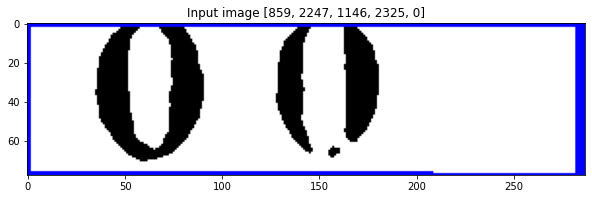

[859, 2247, 1146, 2325, 0]


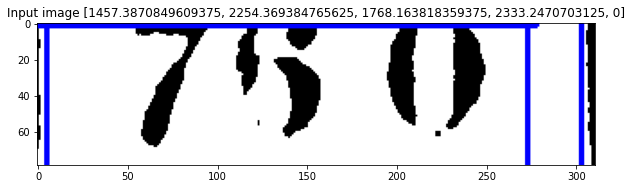

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


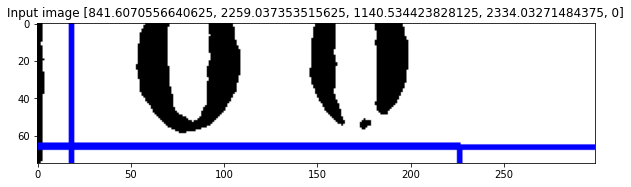

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


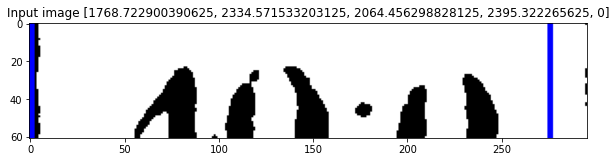

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


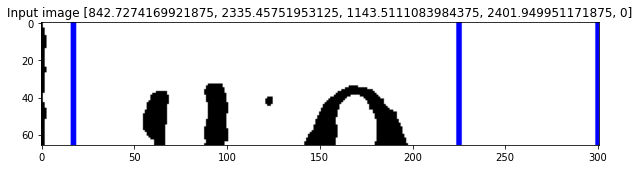

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


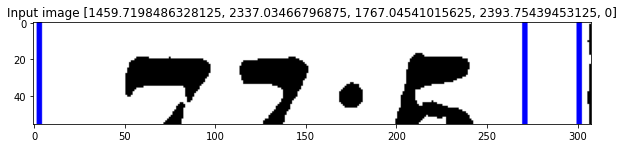

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


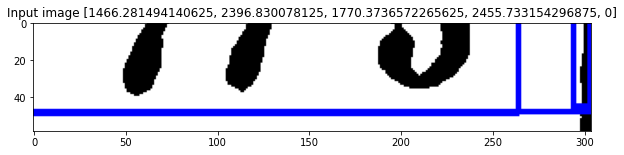

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


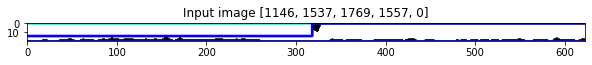

[1146, 1537, 1769, 1557, 0]


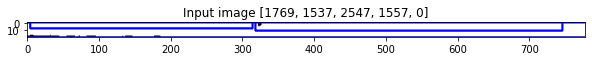

[1769, 1537, 2547, 1557, 0]


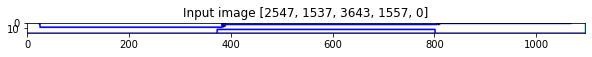

[2547, 1537, 3643, 1557, 0]


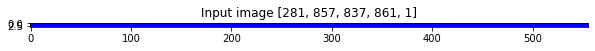

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


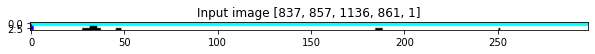

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


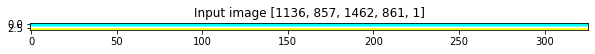

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


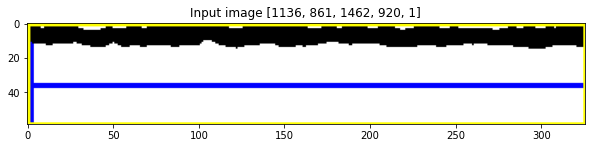

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


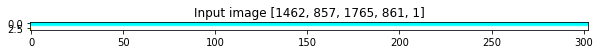

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


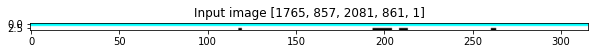

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


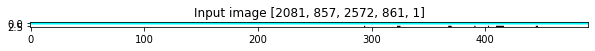

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


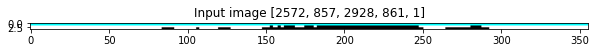

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


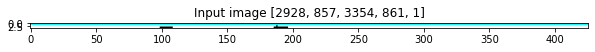

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


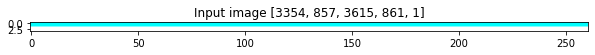

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


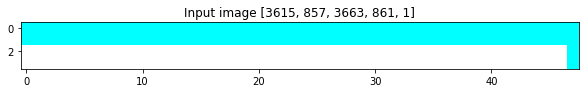

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


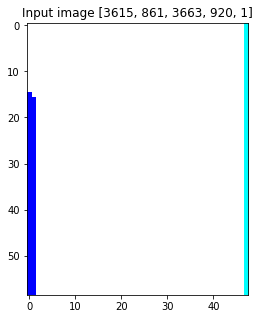

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


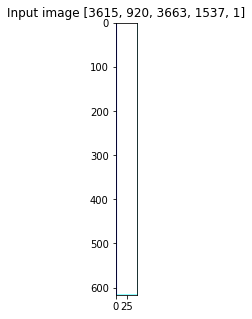

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


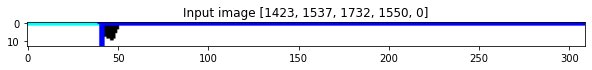

[1423, 1537, 1732, 1550, 0]


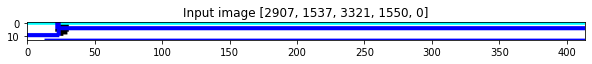

[2907, 1537, 3321, 1550, 0]


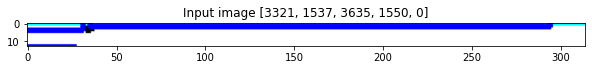

[3321, 1537, 3635, 1550, 0]


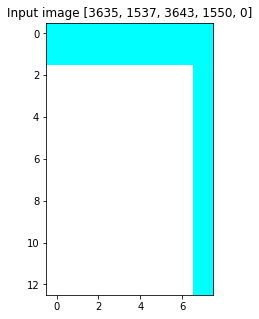

[3635, 1537, 3643, 1550, 0]


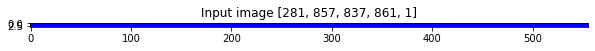

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


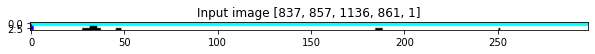

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


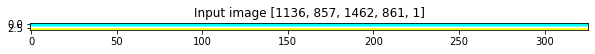

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


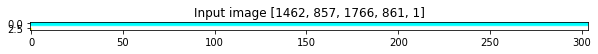

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


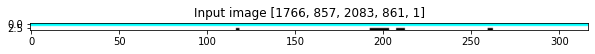

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


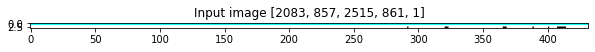

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


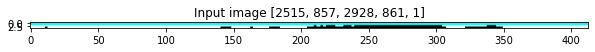

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


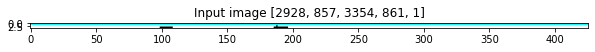

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


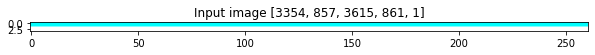

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


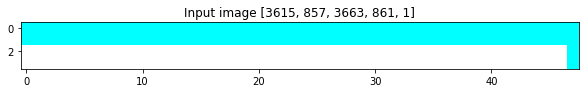

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


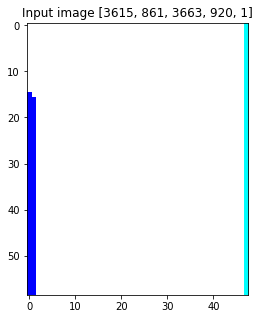

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


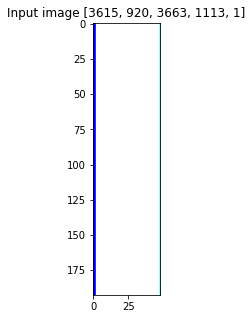

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


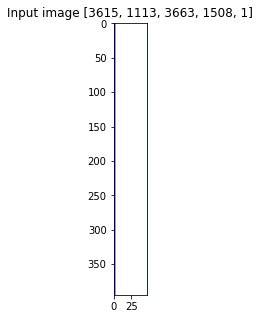

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


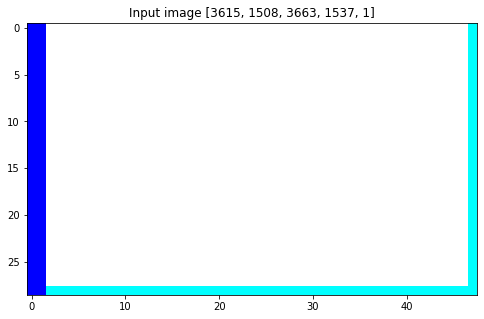

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


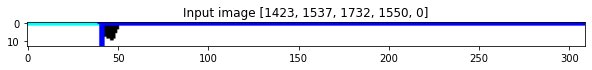

[1423, 1537, 1732, 1550, 0]


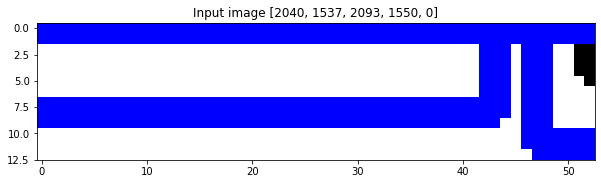

[2040, 1537, 2093, 1550, 0]


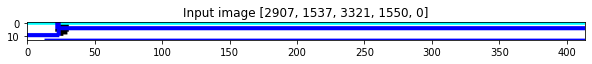

[2907, 1537, 3321, 1550, 0]


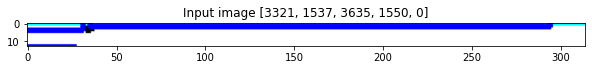

[3321, 1537, 3635, 1550, 0]


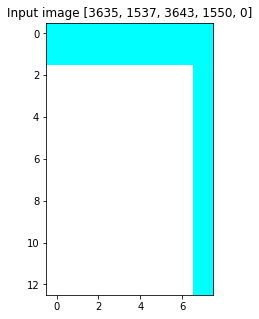

[3635, 1537, 3643, 1550, 0]


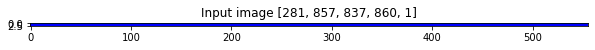

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


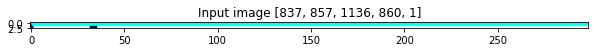

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


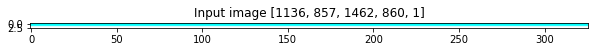

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


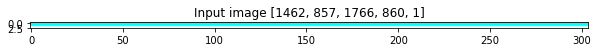

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


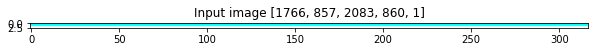

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


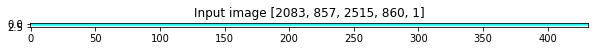

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


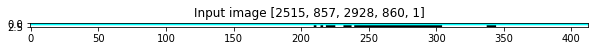

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


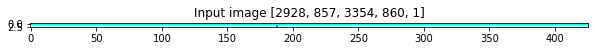

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


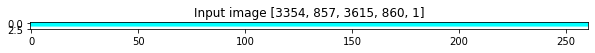

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


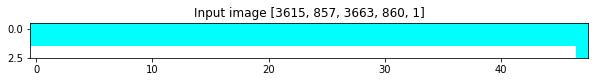

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


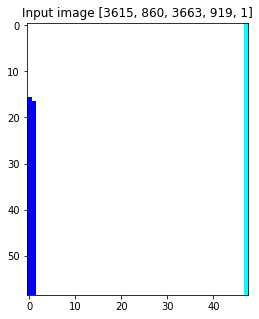

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


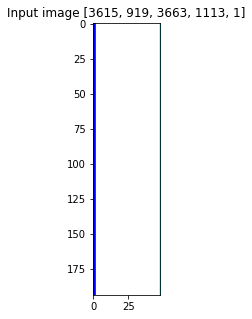

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


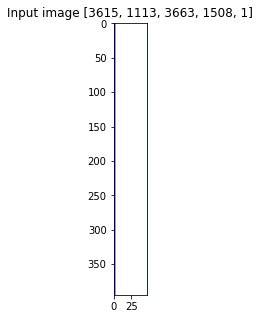

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


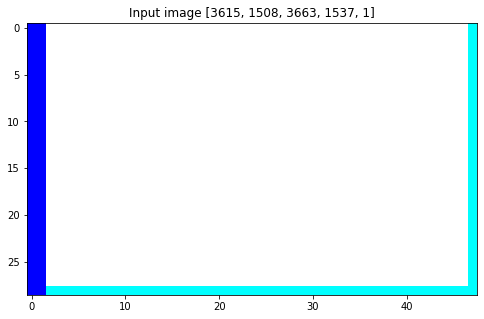

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


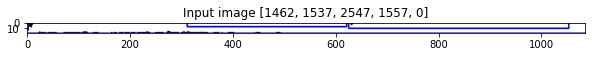

[1462, 1537, 2547, 1557, 0]


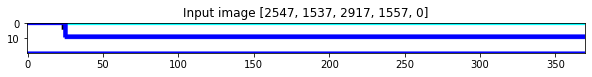

[2547, 1537, 2917, 1557, 0]


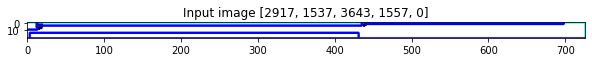

[2917, 1537, 3643, 1557, 0]


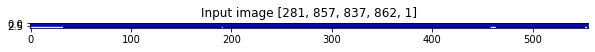

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


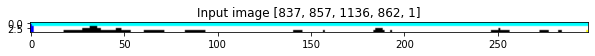

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


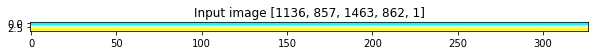

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


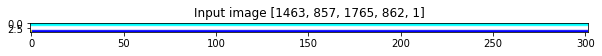

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


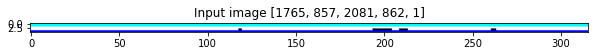

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


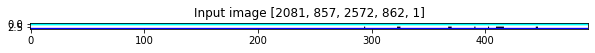

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


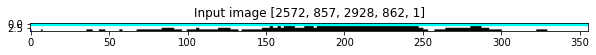

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


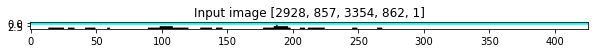

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


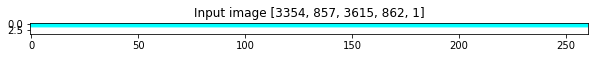

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


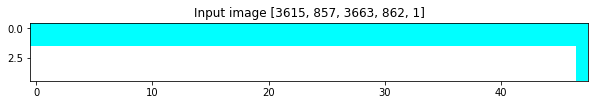

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


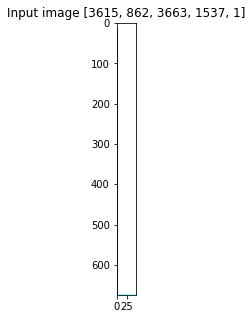

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


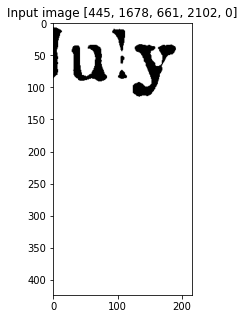

[445, 1678, 661, 2102, 0]


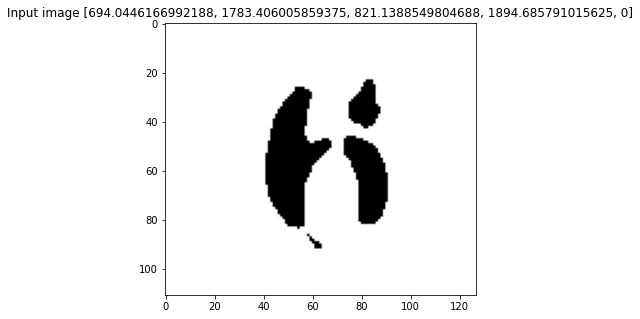

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


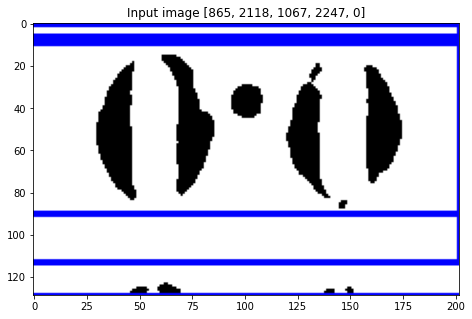

[865, 2118, 1067, 2247, 0]


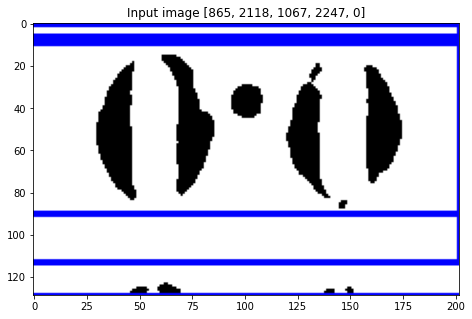

[865, 2118, 1067, 2247, 0]


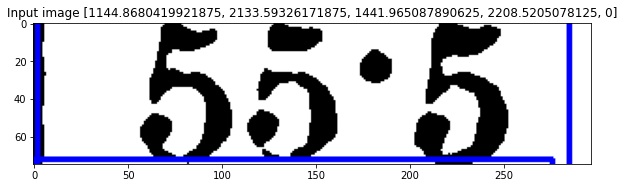

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


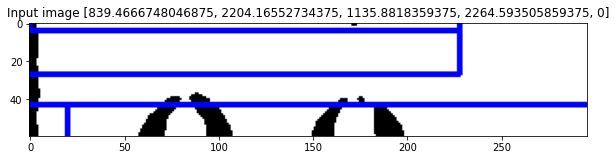

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


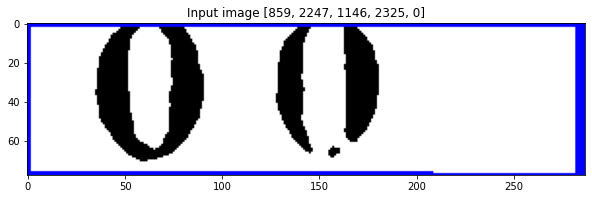

[859, 2247, 1146, 2325, 0]


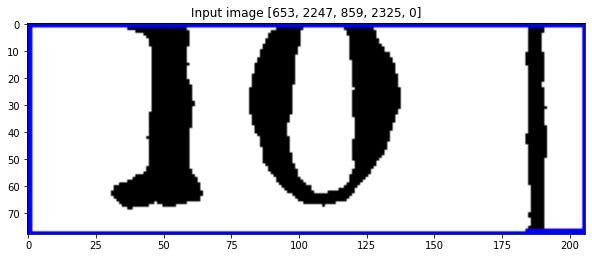

[653, 2247, 859, 2325, 0]


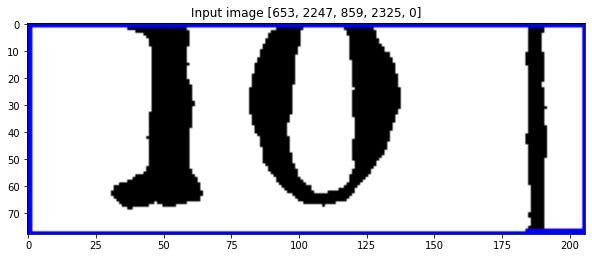

[653, 2247, 859, 2325, 0]


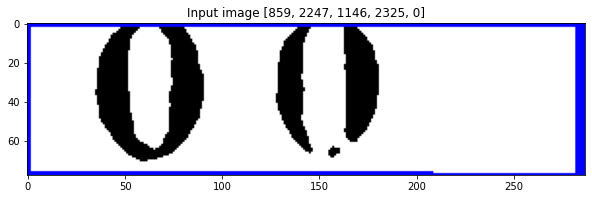

[859, 2247, 1146, 2325, 0]


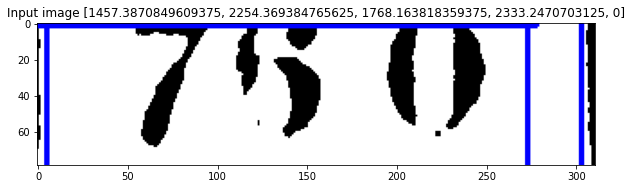

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


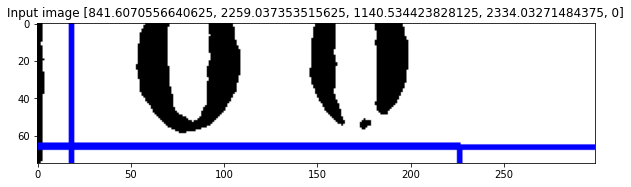

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


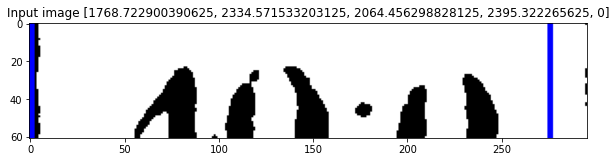

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


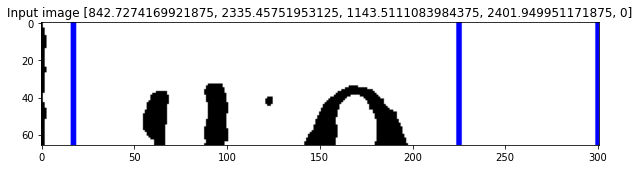

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


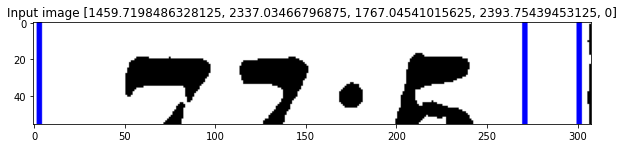

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


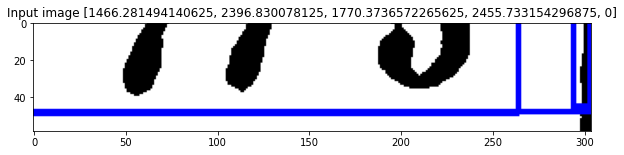

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


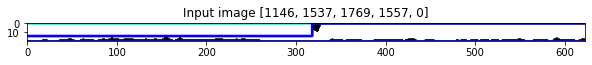

[1146, 1537, 1769, 1557, 0]


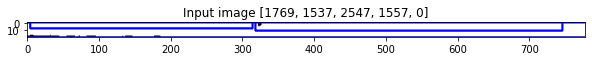

[1769, 1537, 2547, 1557, 0]


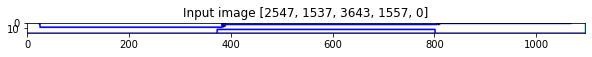

[2547, 1537, 3643, 1557, 0]


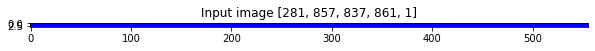

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


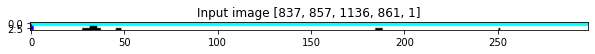

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


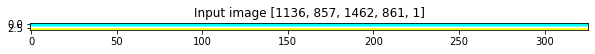

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


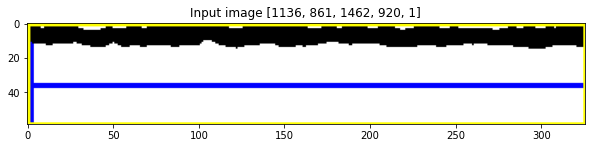

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


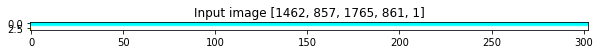

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


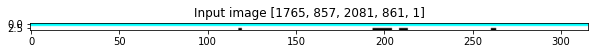

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


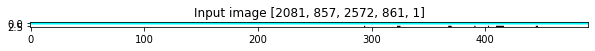

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


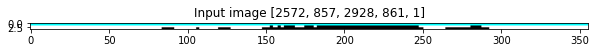

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


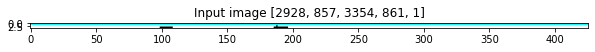

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


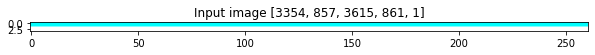

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


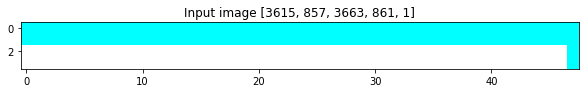

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


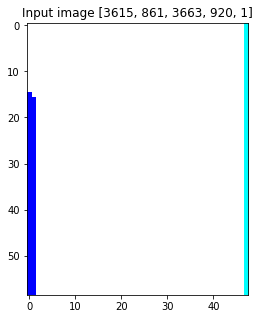

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


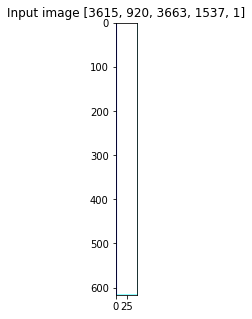

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


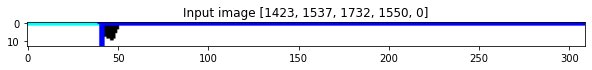

[1423, 1537, 1732, 1550, 0]


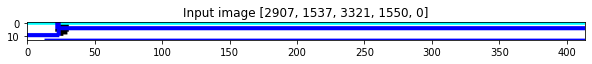

[2907, 1537, 3321, 1550, 0]


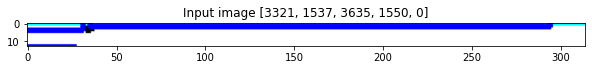

[3321, 1537, 3635, 1550, 0]


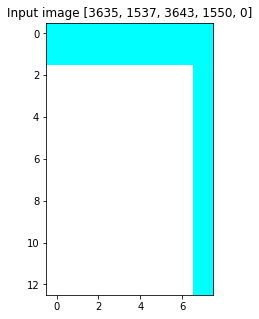

[3635, 1537, 3643, 1550, 0]


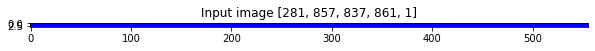

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


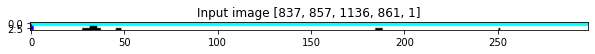

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


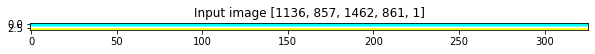

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


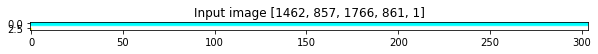

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


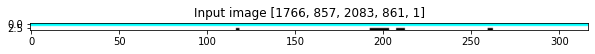

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


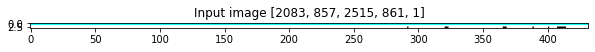

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


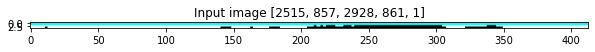

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


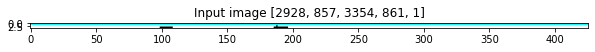

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


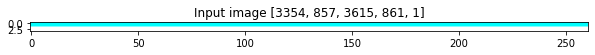

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


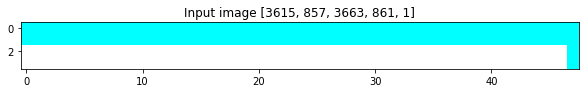

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


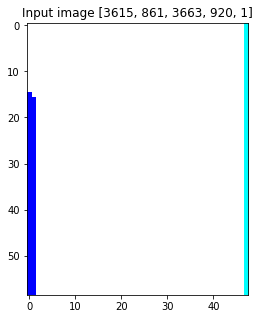

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


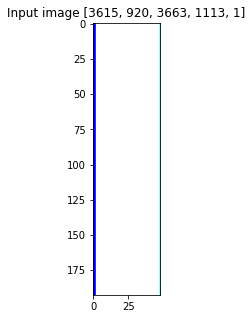

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


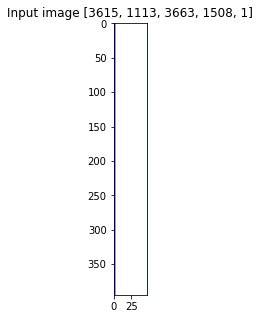

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


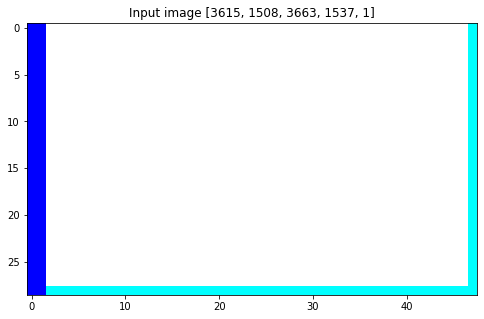

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


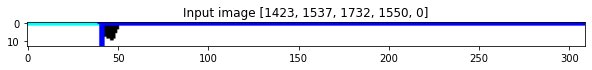

[1423, 1537, 1732, 1550, 0]


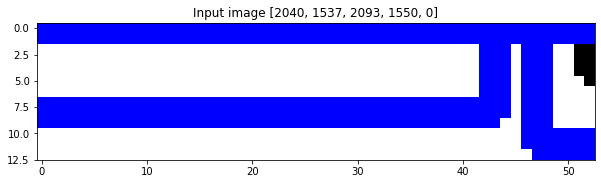

[2040, 1537, 2093, 1550, 0]


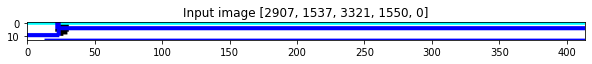

[2907, 1537, 3321, 1550, 0]


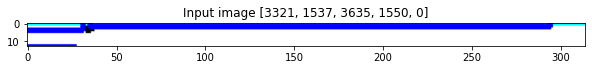

[3321, 1537, 3635, 1550, 0]


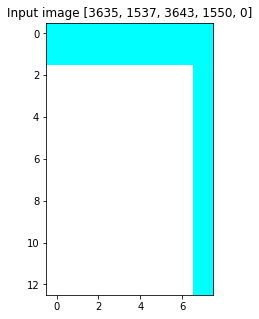

[3635, 1537, 3643, 1550, 0]


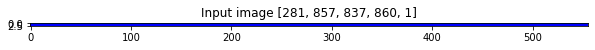

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


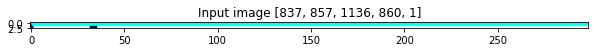

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


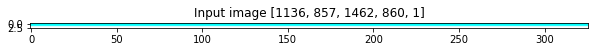

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


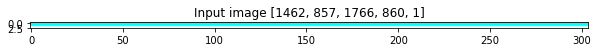

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


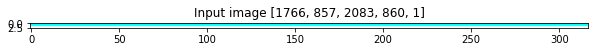

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


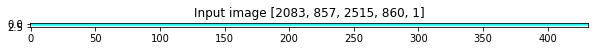

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


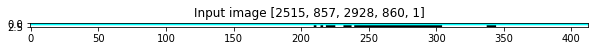

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


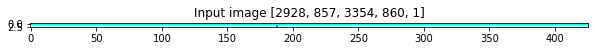

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


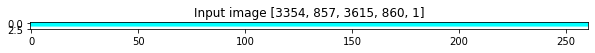

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


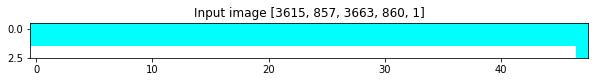

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


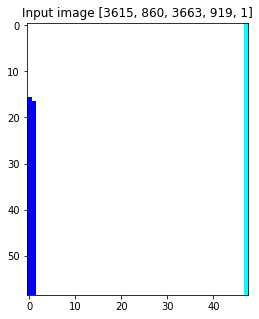

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


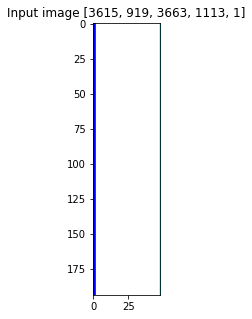

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


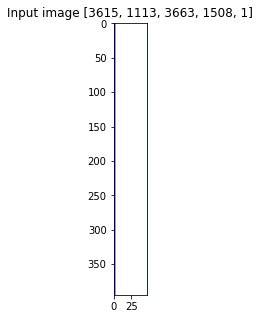

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


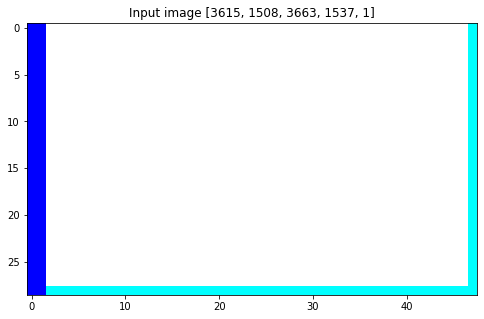

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


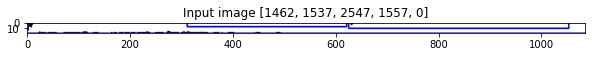

[1462, 1537, 2547, 1557, 0]


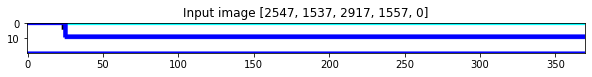

[2547, 1537, 2917, 1557, 0]


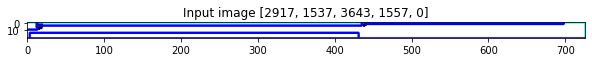

[2917, 1537, 3643, 1557, 0]


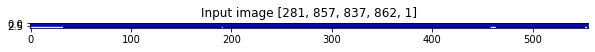

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


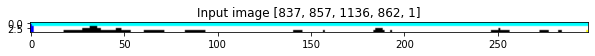

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


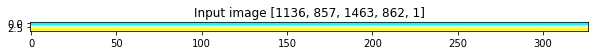

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


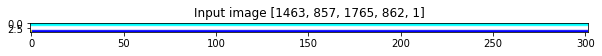

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


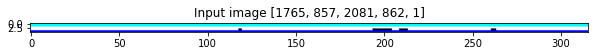

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


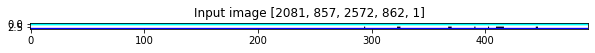

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


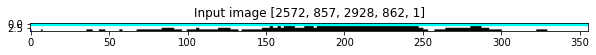

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


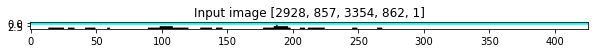

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


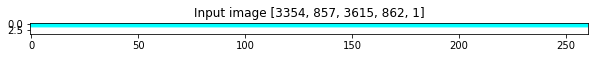

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


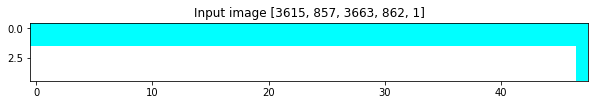

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


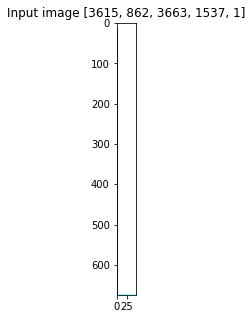

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


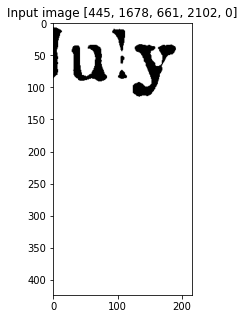

[445, 1678, 661, 2102, 0]


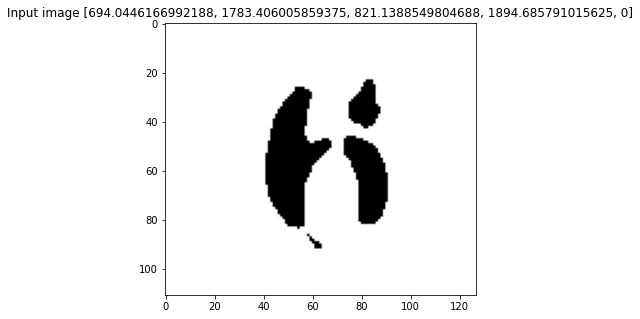

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


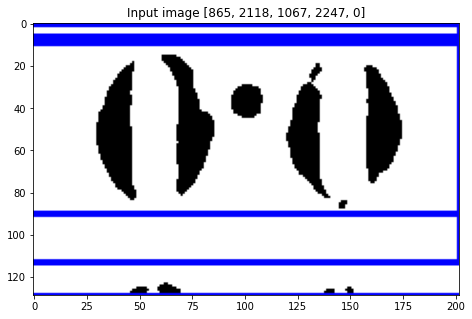

[865, 2118, 1067, 2247, 0]


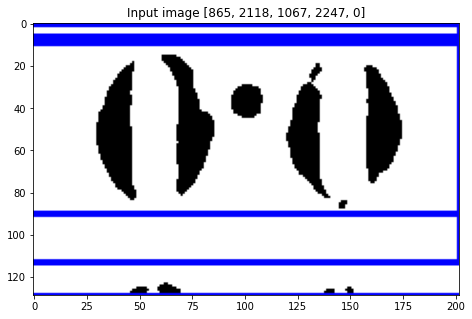

[865, 2118, 1067, 2247, 0]


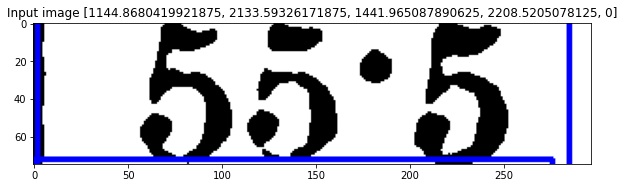

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


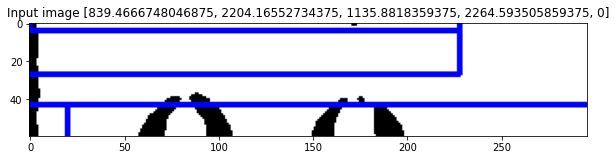

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


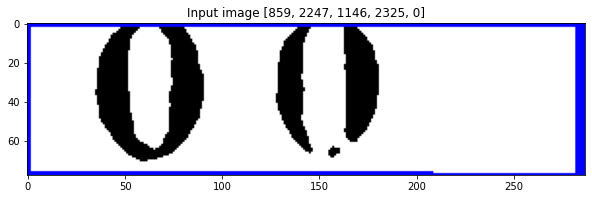

[859, 2247, 1146, 2325, 0]


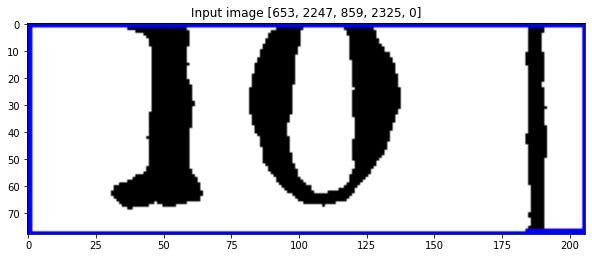

[653, 2247, 859, 2325, 0]


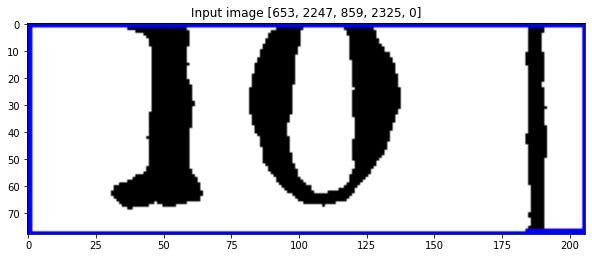

[653, 2247, 859, 2325, 0]


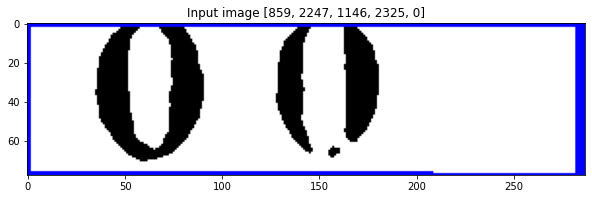

[859, 2247, 1146, 2325, 0]


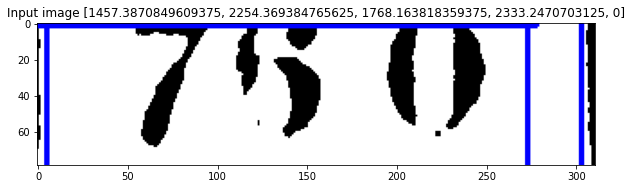

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


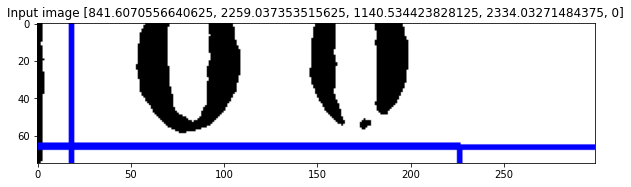

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


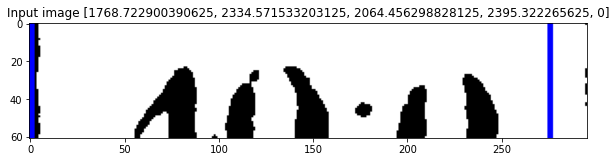

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


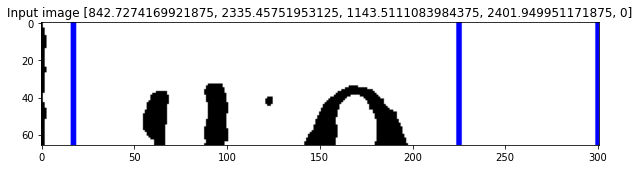

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


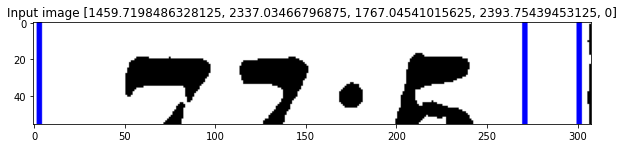

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


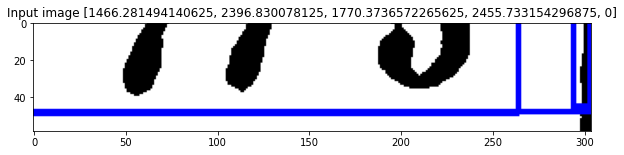

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


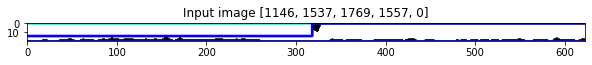

[1146, 1537, 1769, 1557, 0]


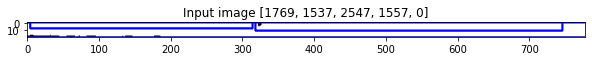

[1769, 1537, 2547, 1557, 0]


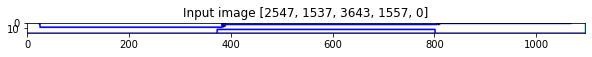

[2547, 1537, 3643, 1557, 0]


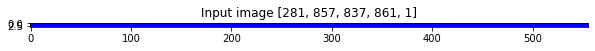

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


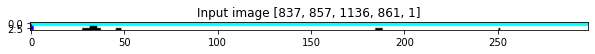

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


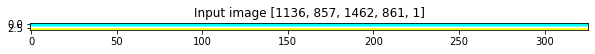

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


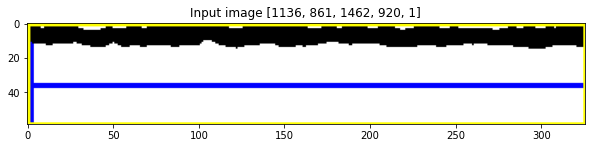

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


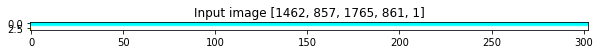

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


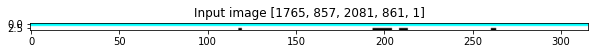

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


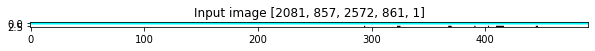

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


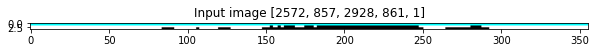

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


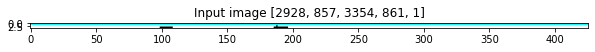

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


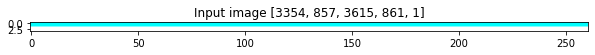

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


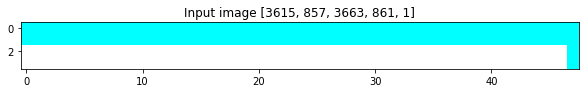

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


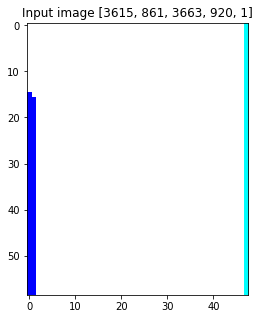

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


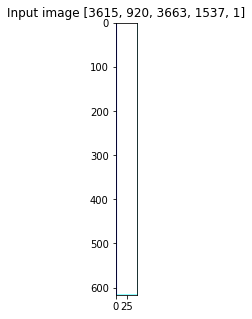

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


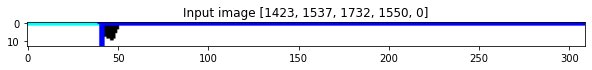

[1423, 1537, 1732, 1550, 0]


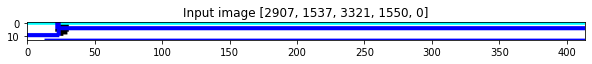

[2907, 1537, 3321, 1550, 0]


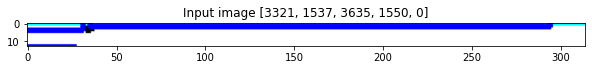

[3321, 1537, 3635, 1550, 0]


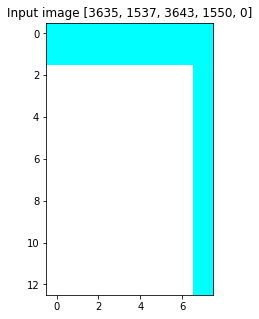

[3635, 1537, 3643, 1550, 0]


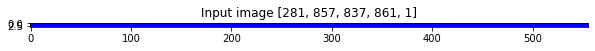

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


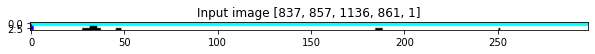

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


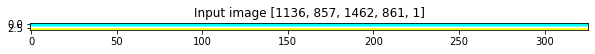

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


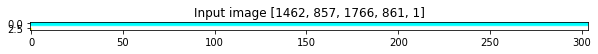

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


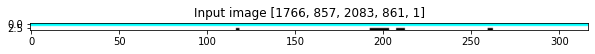

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


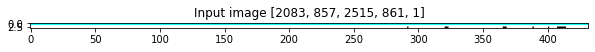

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


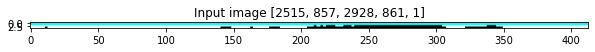

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


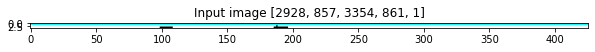

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


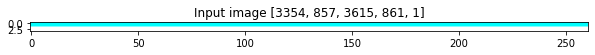

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


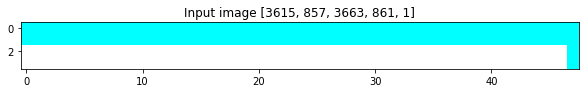

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


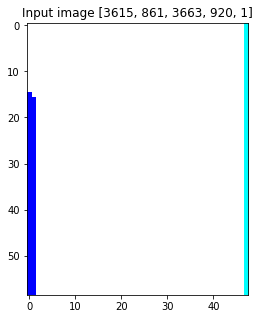

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


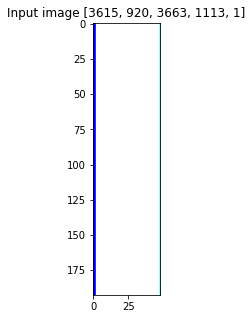

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


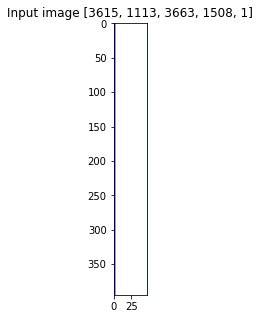

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


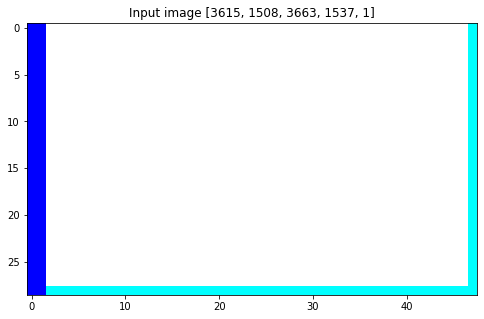

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


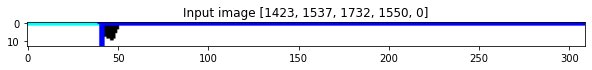

[1423, 1537, 1732, 1550, 0]


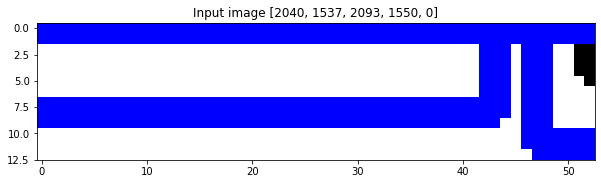

[2040, 1537, 2093, 1550, 0]


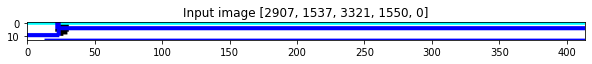

[2907, 1537, 3321, 1550, 0]


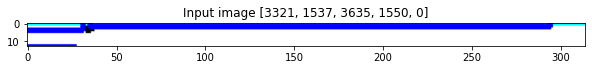

[3321, 1537, 3635, 1550, 0]


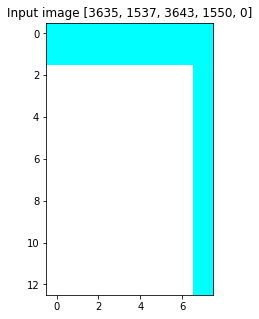

[3635, 1537, 3643, 1550, 0]


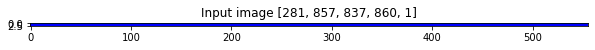

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


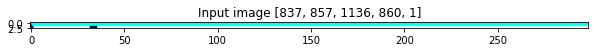

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


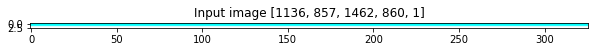

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


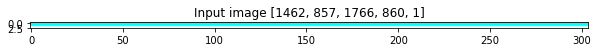

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


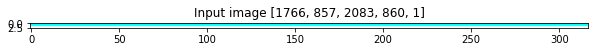

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


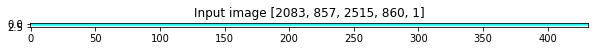

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


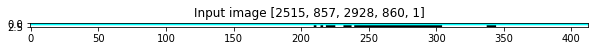

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


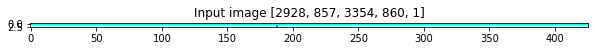

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


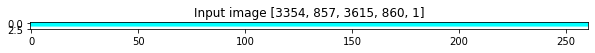

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


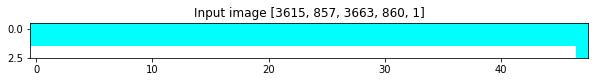

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


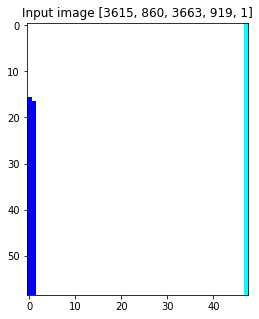

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


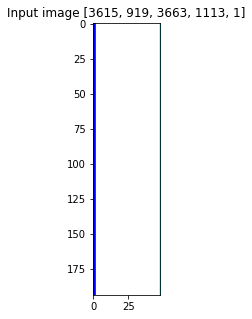

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


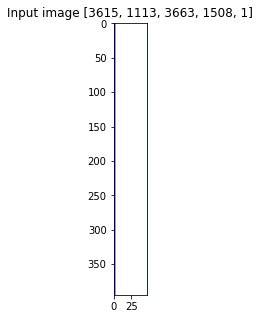

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


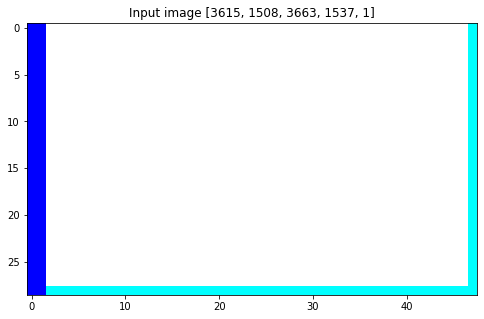

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


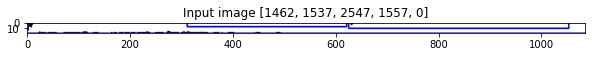

[1462, 1537, 2547, 1557, 0]


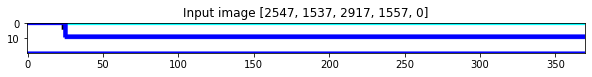

[2547, 1537, 2917, 1557, 0]


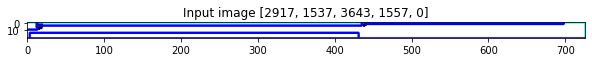

[2917, 1537, 3643, 1557, 0]


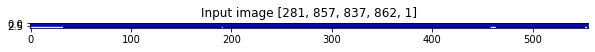

[281, 857, 837, 862, 1]
[281, 857, 837, 862, 1]


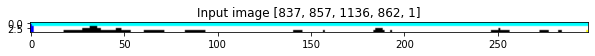

[837, 857, 1136, 862, 1]
[837, 857, 1136, 862, 1]


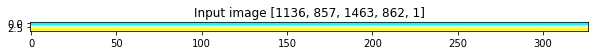

[1136, 857, 1463, 862, 1]
[1136, 857, 1463, 862, 1]


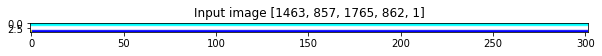

[1463, 857, 1765, 862, 1]
[1463, 857, 1765, 862, 1]


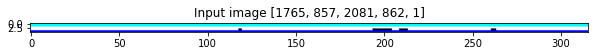

[1765, 857, 2081, 862, 1]
[1765, 857, 2081, 862, 1]


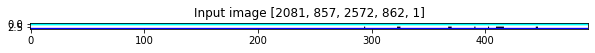

[2081, 857, 2572, 862, 1]
[2081, 857, 2572, 862, 1]


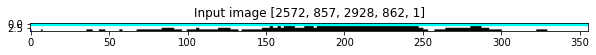

[2572, 857, 2928, 862, 1]
[2572, 857, 2928, 862, 1]


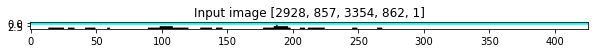

[2928, 857, 3354, 862, 1]
[2928, 857, 3354, 862, 1]


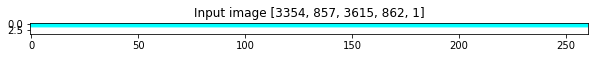

[3354, 857, 3615, 862, 1]
[3354, 857, 3615, 862, 1]


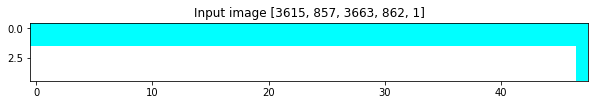

[3615, 857, 3663, 862, 1]
[3615, 857, 3663, 862, 1]


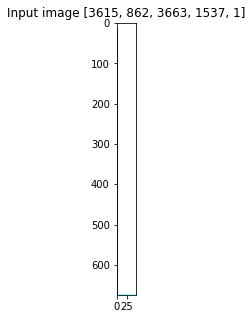

[3615, 862, 3663, 1537, 1]
[3615, 862, 3663, 1537, 1]


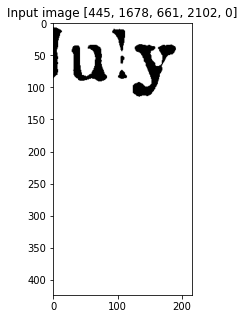

[445, 1678, 661, 2102, 0]


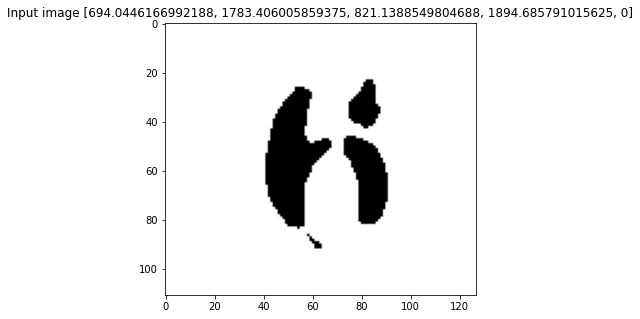

[694.0446166992188, 1783.406005859375, 821.1388549804688, 1894.685791015625, 0]


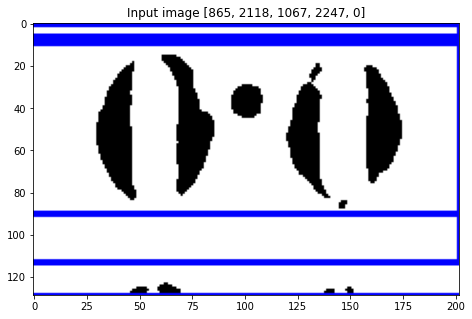

[865, 2118, 1067, 2247, 0]


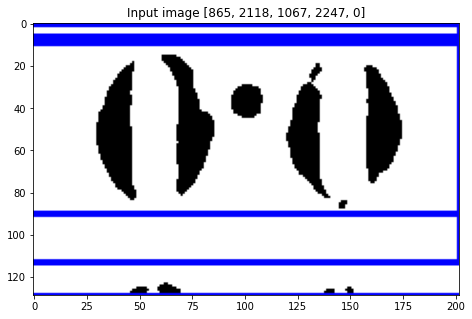

[865, 2118, 1067, 2247, 0]


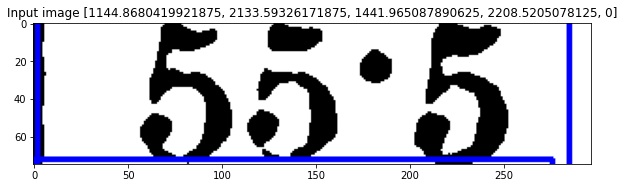

[1144.8680419921875, 2133.59326171875, 1441.965087890625, 2208.5205078125, 0]


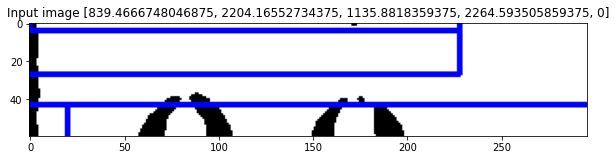

[839.4666748046875, 2204.16552734375, 1135.8818359375, 2264.593505859375, 0]


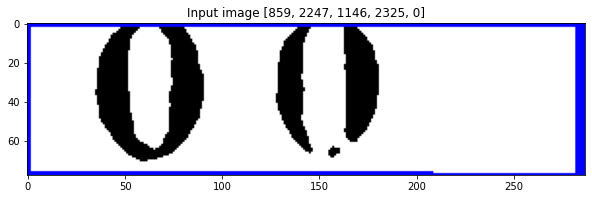

[859, 2247, 1146, 2325, 0]


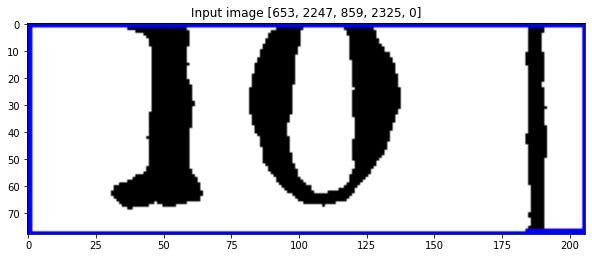

[653, 2247, 859, 2325, 0]


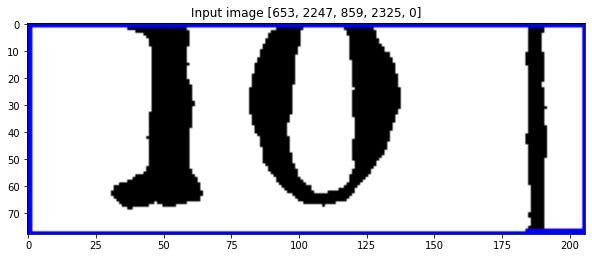

[653, 2247, 859, 2325, 0]


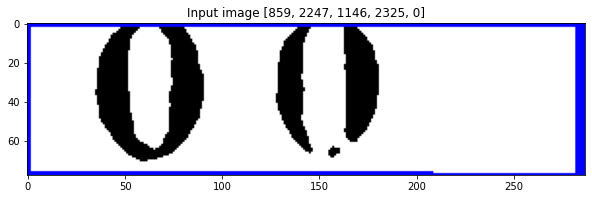

[859, 2247, 1146, 2325, 0]


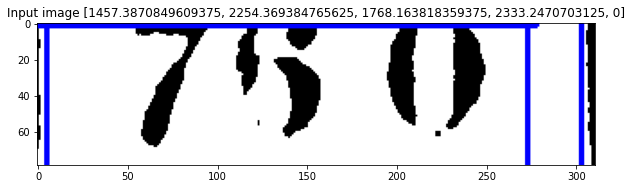

[1457.3870849609375, 2254.369384765625, 1768.163818359375, 2333.2470703125, 0]


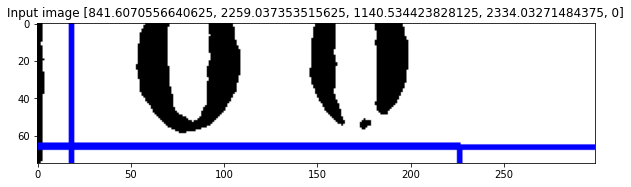

[841.6070556640625, 2259.037353515625, 1140.534423828125, 2334.03271484375, 0]


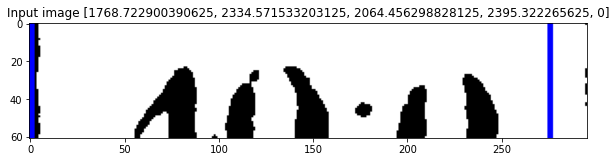

[1768.722900390625, 2334.571533203125, 2064.456298828125, 2395.322265625, 0]


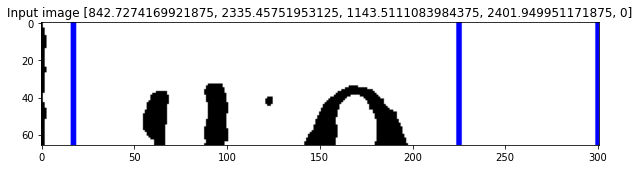

[842.7274169921875, 2335.45751953125, 1143.5111083984375, 2401.949951171875, 0]


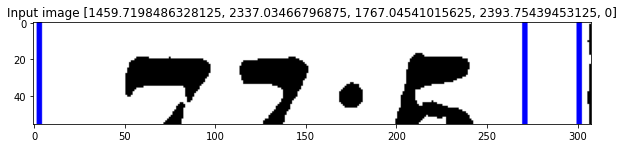

[1459.7198486328125, 2337.03466796875, 1767.04541015625, 2393.75439453125, 0]


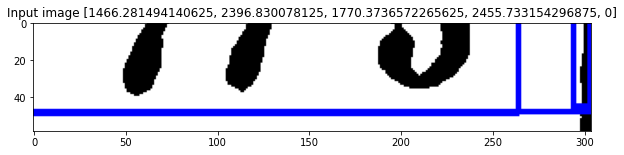

[1466.281494140625, 2396.830078125, 1770.3736572265625, 2455.733154296875, 0]


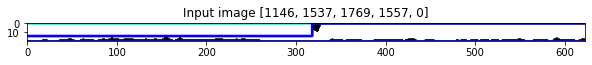

[1146, 1537, 1769, 1557, 0]


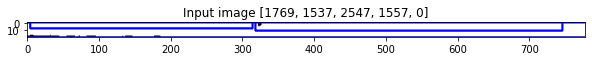

[1769, 1537, 2547, 1557, 0]


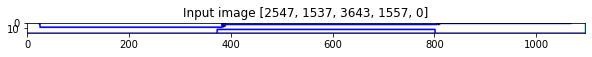

[2547, 1537, 3643, 1557, 0]


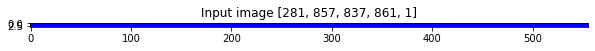

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


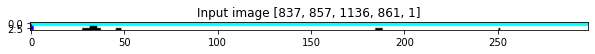

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


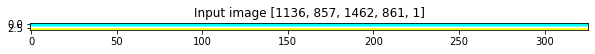

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


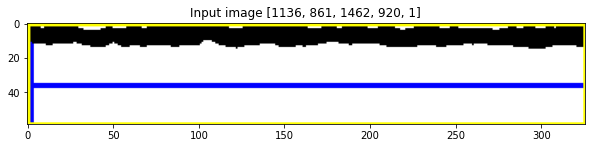

[1136, 861, 1462, 920, 1]
[1136, 861, 1462, 920, 1]


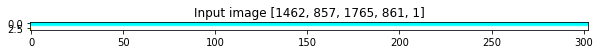

[1462, 857, 1765, 861, 1]
[1462, 857, 1765, 861, 1]


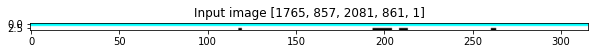

[1765, 857, 2081, 861, 1]
[1765, 857, 2081, 861, 1]


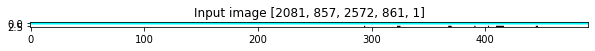

[2081, 857, 2572, 861, 1]
[2081, 857, 2572, 861, 1]


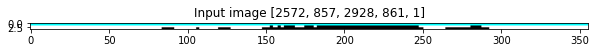

[2572, 857, 2928, 861, 1]
[2572, 857, 2928, 861, 1]


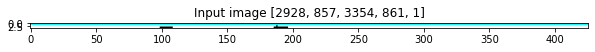

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


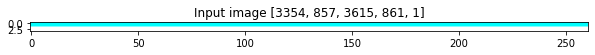

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


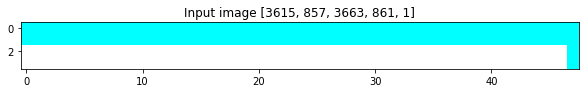

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


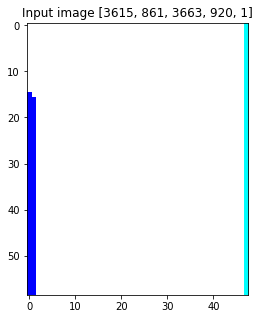

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


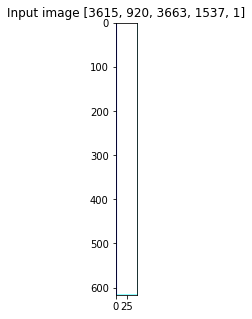

[3615, 920, 3663, 1537, 1]
[3615, 920, 3663, 1537, 1]


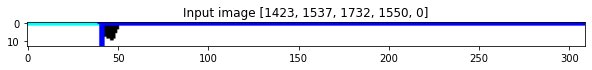

[1423, 1537, 1732, 1550, 0]


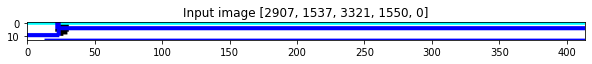

[2907, 1537, 3321, 1550, 0]


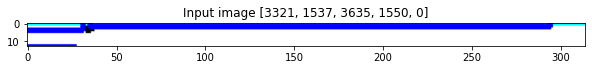

[3321, 1537, 3635, 1550, 0]


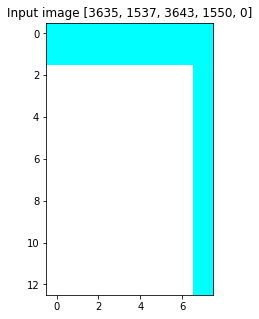

[3635, 1537, 3643, 1550, 0]


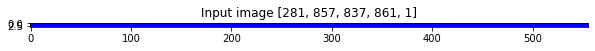

[281, 857, 837, 861, 1]
[281, 857, 837, 861, 1]


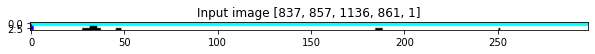

[837, 857, 1136, 861, 1]
[837, 857, 1136, 861, 1]


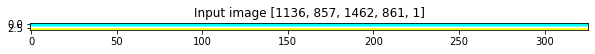

[1136, 857, 1462, 861, 1]
[1136, 857, 1462, 861, 1]


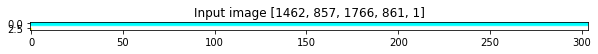

[1462, 857, 1766, 861, 1]
[1462, 857, 1766, 861, 1]


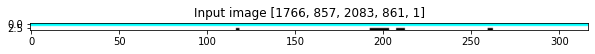

[1766, 857, 2083, 861, 1]
[1766, 857, 2083, 861, 1]


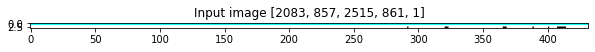

[2083, 857, 2515, 861, 1]
[2083, 857, 2515, 861, 1]


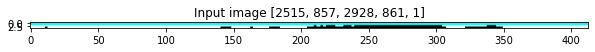

[2515, 857, 2928, 861, 1]
[2515, 857, 2928, 861, 1]


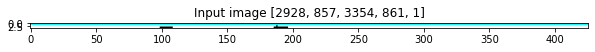

[2928, 857, 3354, 861, 1]
[2928, 857, 3354, 861, 1]


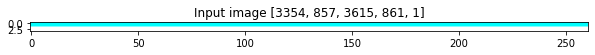

[3354, 857, 3615, 861, 1]
[3354, 857, 3615, 861, 1]


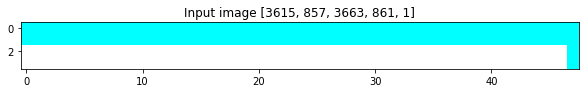

[3615, 857, 3663, 861, 1]
[3615, 857, 3663, 861, 1]


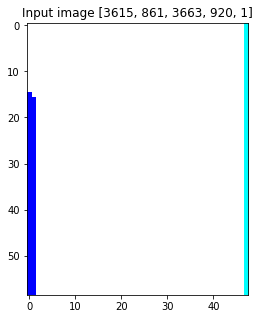

[3615, 861, 3663, 920, 1]
[3615, 861, 3663, 920, 1]


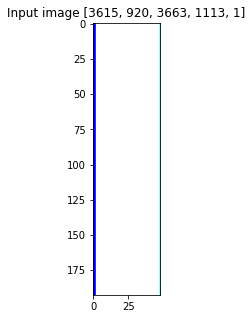

[3615, 920, 3663, 1113, 1]
[3615, 920, 3663, 1113, 1]


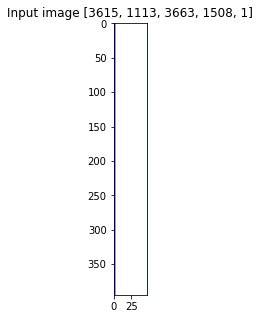

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


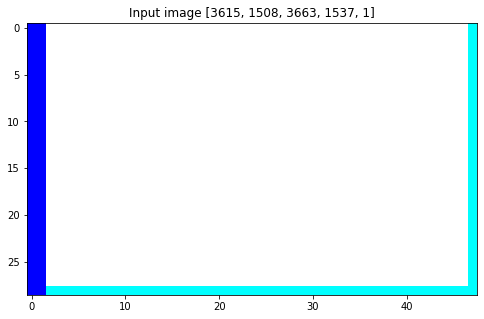

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


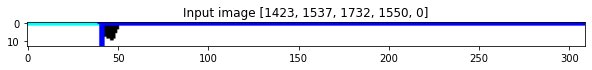

[1423, 1537, 1732, 1550, 0]


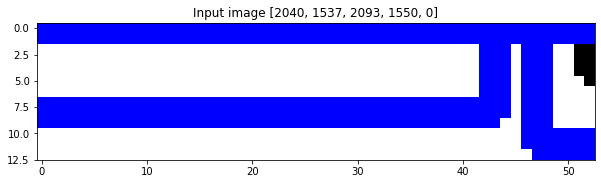

[2040, 1537, 2093, 1550, 0]


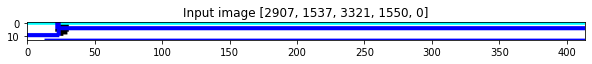

[2907, 1537, 3321, 1550, 0]


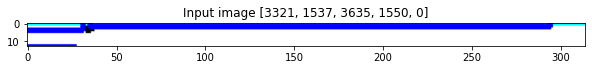

[3321, 1537, 3635, 1550, 0]


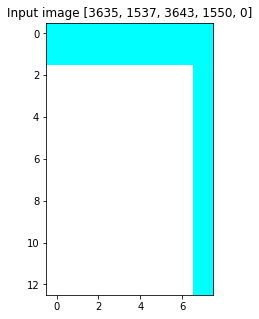

[3635, 1537, 3643, 1550, 0]


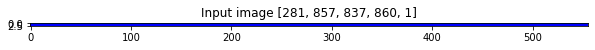

[281, 857, 837, 860, 1]
[281, 857, 837, 860, 1]


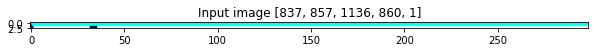

[837, 857, 1136, 860, 1]
[837, 857, 1136, 860, 1]


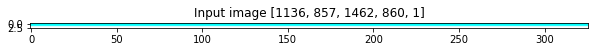

[1136, 857, 1462, 860, 1]
[1136, 857, 1462, 860, 1]


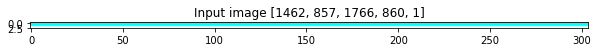

[1462, 857, 1766, 860, 1]
[1462, 857, 1766, 860, 1]


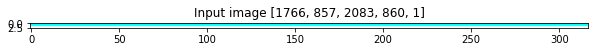

[1766, 857, 2083, 860, 1]
[1766, 857, 2083, 860, 1]


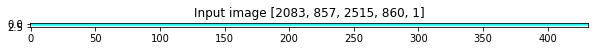

[2083, 857, 2515, 860, 1]
[2083, 857, 2515, 860, 1]


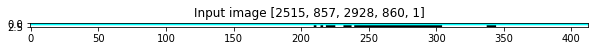

[2515, 857, 2928, 860, 1]
[2515, 857, 2928, 860, 1]


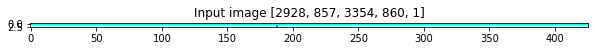

[2928, 857, 3354, 860, 1]
[2928, 857, 3354, 860, 1]


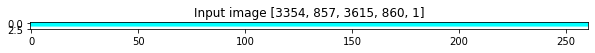

[3354, 857, 3615, 860, 1]
[3354, 857, 3615, 860, 1]


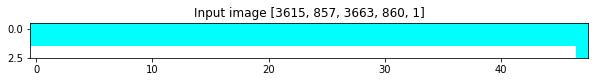

[3615, 857, 3663, 860, 1]
[3615, 857, 3663, 860, 1]


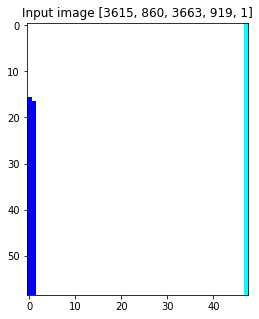

[3615, 860, 3663, 919, 1]
[3615, 860, 3663, 919, 1]


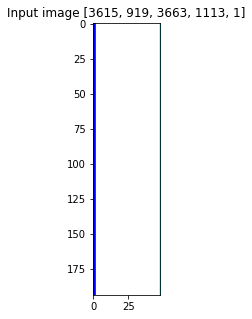

[3615, 919, 3663, 1113, 1]
[3615, 919, 3663, 1113, 1]


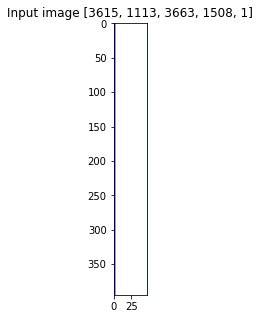

[3615, 1113, 3663, 1508, 1]
[3615, 1113, 3663, 1508, 1]


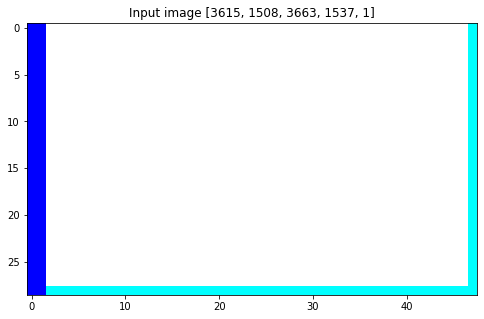

[3615, 1508, 3663, 1537, 1]
[3615, 1508, 3663, 1537, 1]


In [ ]:
count=0
while len(old_error_cells)>10:
    print(f'loop {count}')
    not_ovellapped_correct_cells_pred, not_ovellapped_blank_cells_pred, not_ovellapped_error_cells_pred = generate_cells_from_corrected_cells(tables, considered_cells, masks[1])
    considered_cells = not_ovellapped_correct_cells_pred+considered_cells
    
    segmented_cells = []
    error_cells = []
    
    for imagedraw in old_error_cells+not_ovellapped_error_cells_pred:#
        croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
        plt.rcParams["figure.figsize"] = (10,5)
        plt.imshow(croppedimage_full)
        plt.title(f'Input image {imagedraw}')
        plt.show()
        idx, score = get_table_coord(imagedraw, tables)
        avg_x, avg_y = average_cordinates[idx]

        x = abs(imagedraw[0]-imagedraw[2])
        y = abs(imagedraw[1]-imagedraw[3])

        if score > 0.5 and x>=avg_x/2 and y>=avg_y/2:
            print(imagedraw)
            possible_cells = segment_image(image, imagedraw[0:4]+[idx], masks[1],average_cordinates)
            segmented_cells += possible_cells
            for cell in possible_cells:
                croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
                plt.rcParams["figure.figsize"] = (10,5)
                plt.imshow(croppedimage_full)
                plt.title(f'Corrected image {cell}')
                plt.show()
        else:
            error_cells.append(imagedraw[0:4]+[idx])
            
    not_ovellapped_segmented_cells_pred =  find_overlapped_cell(considered_cells, segmented_cells)
            
    considered_cells = not_ovellapped_segmented_cells_pred+considered_cells+not_ovellapped_blank_cells_pred
    print(f'New error cells {len(error_cells)} and old error cells {len(old_error_cells)}')
    if len(error_cells) == len(old_error_cells):
        break
    count+=1

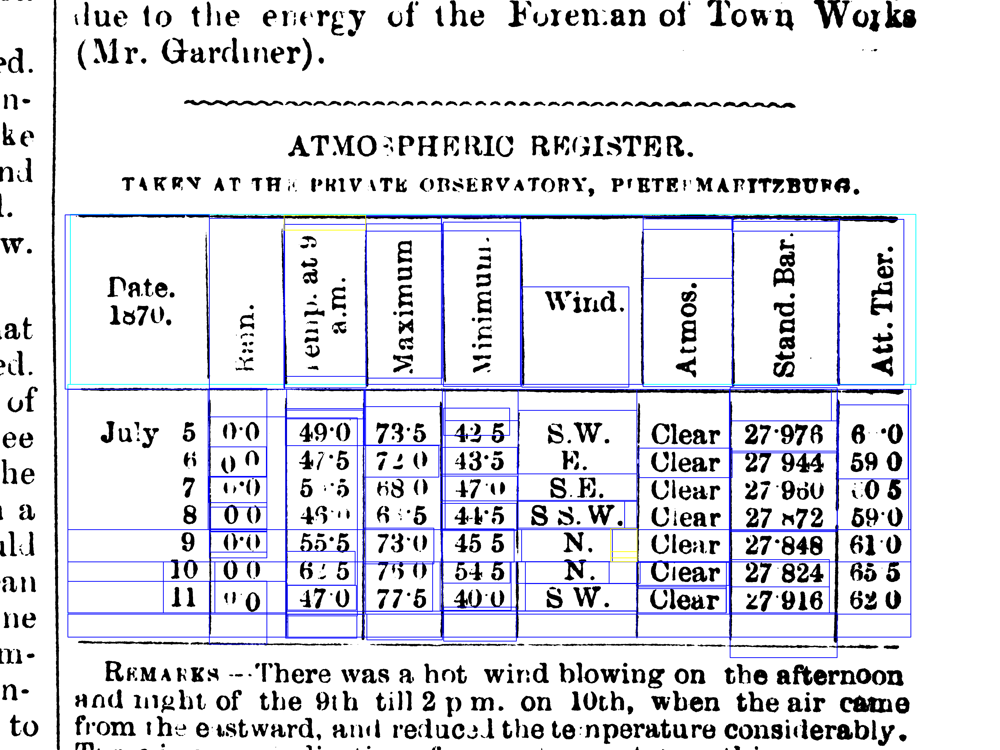

In [150]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in considered_cells:
    put_box(image,box,(0,0,color)) # Blue
    
# for box in not_ovellapped_correct_cells_pred:
#     put_box(image,box,(0,color,0)) # Green

# # for box in not_ovellapped_error_cells_pred+exclude_cells:
# #     put_box(image,box,(color,0,0)) # Red

for box in not_ovellapped_blank_cells_pred:
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
# im_pil.save(f"{filename}_temp_cell_classification_generation.jpg")
im_pil  

In [115]:
error_corrected_cells, exclude_cells = classify_single_cell(error_cells+segmented_cells)

correct_cells, blank_cells, exclude_cells_new = classify_cells(error_corrected_cells, masks[1], average_cordinates)    

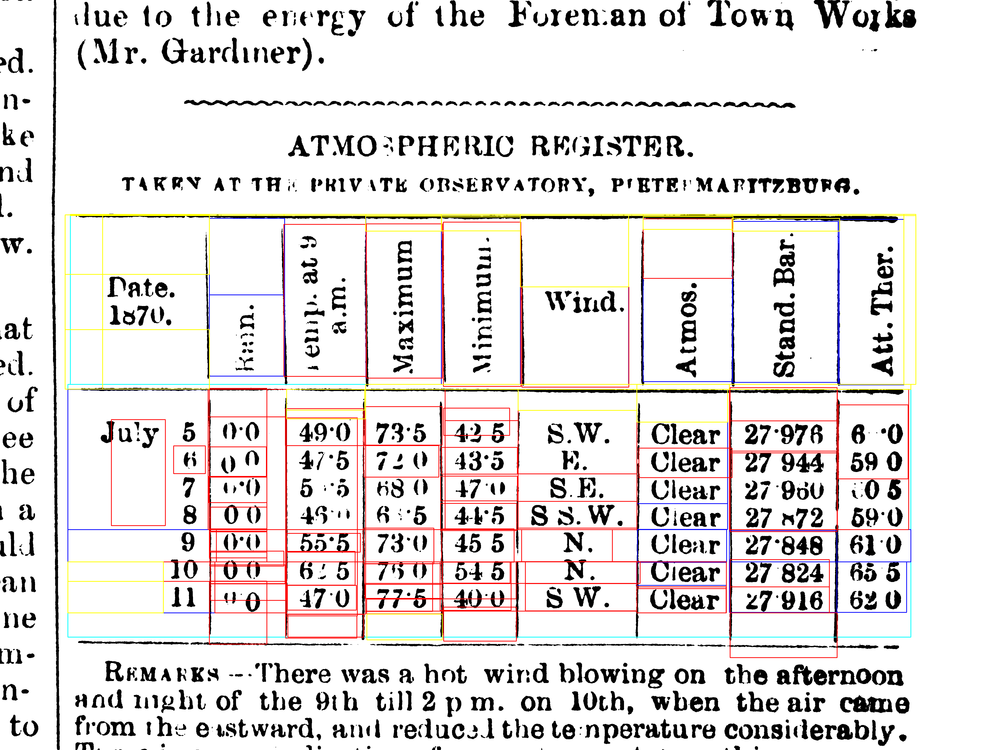

In [120]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in correct_cells:
    put_box(image,box,(0,0,color)) # Blue
    
# for box in not_ovellapped_correct_cells_pred:
#     put_box(image,box,(0,color,0)) # Green

for box in exclude_cells_new+exclude_cells:
    put_box(image,box,(color,0,0)) # Red

for box in blank_cells:
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
# im_pil.save(f"{filename}_temp_cell_classification_generation.jpg")
im_pil  

In [119]:
considered_cells = correct_cells+blank_cells
exclude_cells = exclude_cells+exclude_cells_new

### Segment the error cells if multiple cell exist

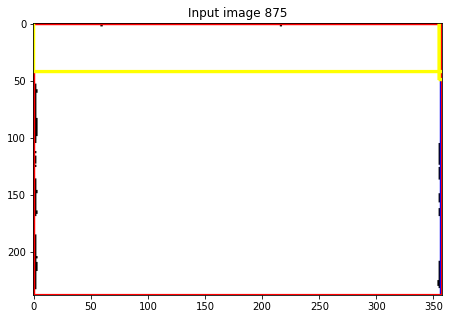

[1142, 2463, 1427, 2552, 0]
[] 66.8
rows [2572, 875, 2930, 1113, 0] [875, 1113] 167.0
[] 177.10000000000002
cols [2572, 875, 2930, 1113, 0] [2572, 2930] 442.75


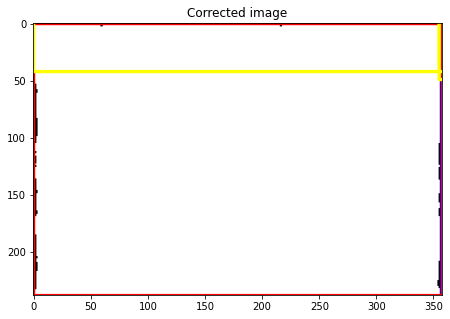

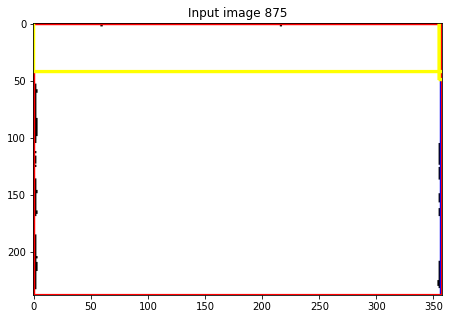

[2572, 875, 2930, 1113, 0]
[2572, 875, 2930, 1113, 0]
[] 136.0
rows [2572, 875, 2930, 1113, 1] [875, 1113] 340.0
[] 149.11111111111111
cols [2572, 875, 2930, 1113, 1] [2572, 2930] 372.77777777777777


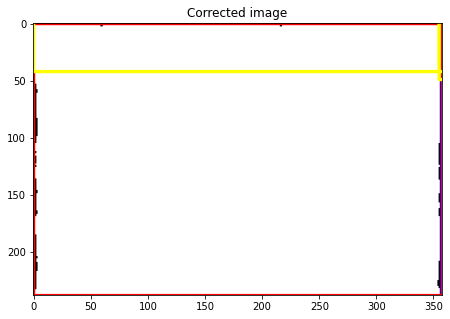

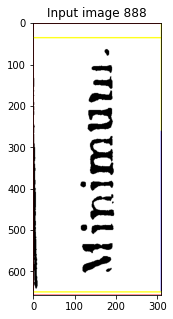

[2572, 875, 2930, 1113, 1]
[2572, 875, 2930, 1113, 1]
[929.0] 136.0
rows [1773, 888, 2083, 1545, 1] [888, 1545] 340.0
[] 149.11111111111111
cols [1773, 888, 2083, 1545, 1] [1773, 2083] 372.77777777777777


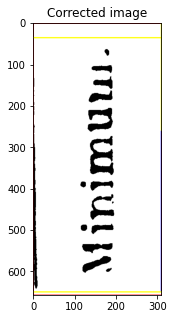

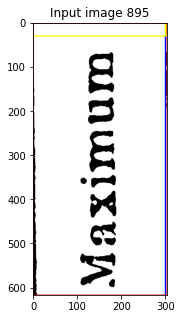

[1773, 888, 2083, 1545, 1]
[1773, 888, 2083, 1545, 1]
[938.0, 1512.0] 136.0
rows [1465, 895, 1769, 1512, 1] [895, 1512.0] 340.0
[] 149.11111111111111
cols [1465, 895, 1769, 1512, 1] [1465, 1769] 372.77777777777777


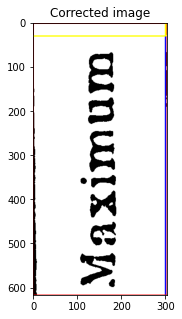

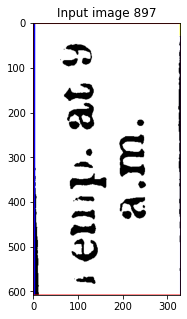

[1465, 895, 1769, 1512, 1]
[1465, 895, 1769, 1512, 1]
[917.0, 1505.0] 136.0
rows [1135, 897, 1464, 1505, 1] [897, 1505.0] 340.0
[] 149.11111111111111
cols [1135, 897, 1464, 1505, 1] [1135, 1464] 372.77777777777777


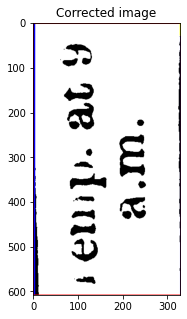

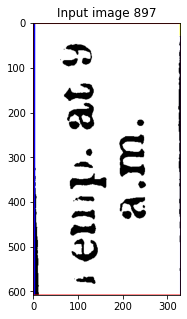

[1135, 897, 1464, 1505, 1]
[1135, 897, 1464, 1505, 1]
[917.0, 1505.0] 136.0
rows [1135, 897, 1464, 1505, 1] [897, 1505.0] 340.0
[] 149.11111111111111
cols [1135, 897, 1464, 1505, 1] [1135, 1464] 372.77777777777777


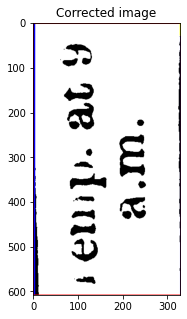

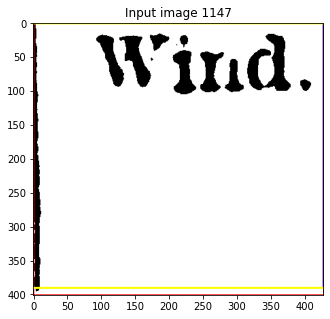

[1135, 897, 1464, 1505, 1]
[1135, 897, 1464, 1505, 1]
[1147.0] 136.0
rows [2087, 1147, 2515, 1548, 1] [1147, 1548] 340.0
[2157.3611111111113, 2515.6388888888887] 149.11111111111111
cols [2087, 1147, 2515, 1548, 1] [2087, 2515.6388888888887] 372.77777777777777


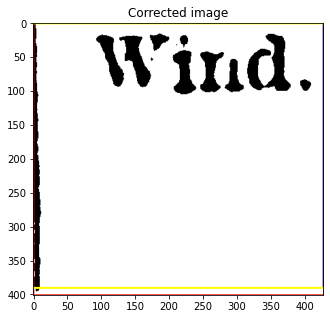

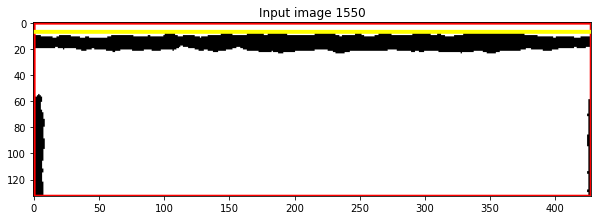

[2087, 1147, 2515, 1548, 1]
[2087, 1147, 2515, 1548, 1]


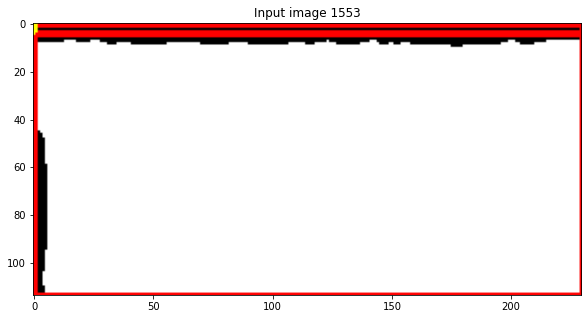

[2087, 1147, 2515, 1548, 1]
[2087, 1147, 2515, 1548, 1]


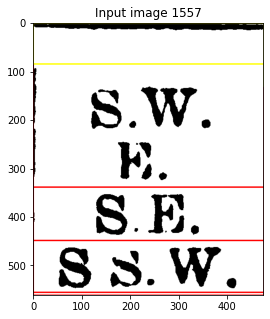

[2087, 1147, 2515, 1548, 1]
[2087, 1147, 2515, 1548, 1]
[1633.0, 1895, 2005, 2121.0] 136.0
rows [2072, 1557, 2547, 2118, 1] [1557, 1895, 2121.0] 340.0
[2104.3611111111113] 149.11111111111111
cols [2072, 1557, 2547, 2118, 1] [2072, 2547] 372.77777777777777


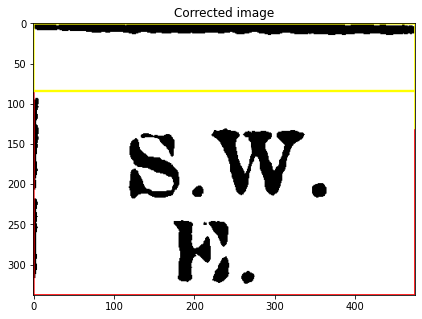

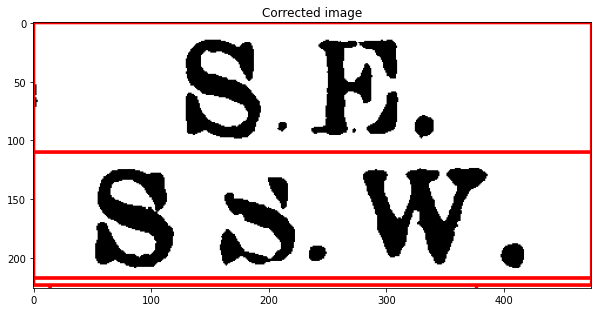

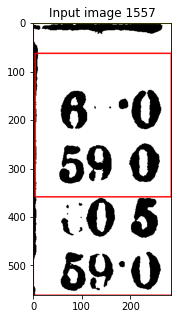

[2072, 1895, 2547, 2121, 1]
[1617.65] 66.8
rows [3349, 1557, 3634, 2118, 0] [1557, 2118] 167.0
[3380.8625, 3634.1375] 177.10000000000002
cols [3349, 1557, 3634, 2118, 0] [3349, 3634.1375] 442.75


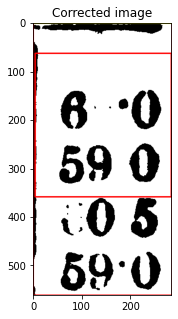

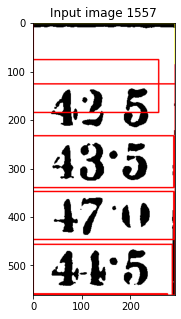

[3349, 1557, 3634, 2118, 0]
[1682.65] 66.8
rows [1780, 1557, 2072, 2118, 0] [1557, 1682.65, 2118] 167.0
[1791.8625] 177.10000000000002
cols [1780, 1557, 2072, 2118, 0] [1780, 2072] 442.75


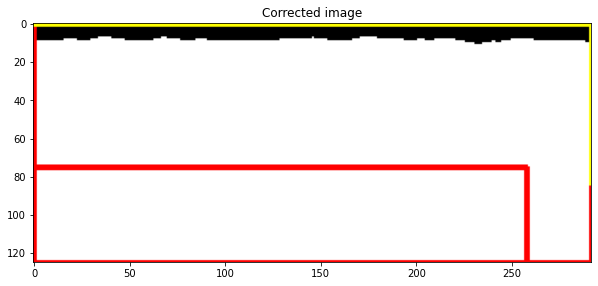

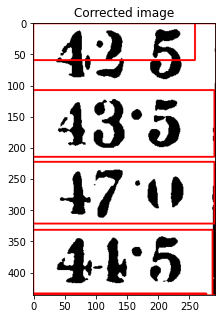

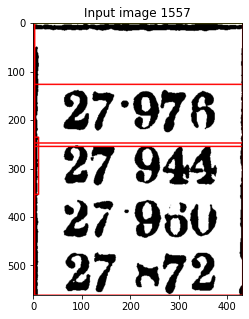

[1780, 1682, 2072, 2118, 0]
[1683.65, 1804, 2122.35] 66.8
rows [2917, 1557, 3349, 2118, 0] [1557, 1683.65, 1804, 2122.35] 167.0
[2951.8625] 177.10000000000002
cols [2917, 1557, 3349, 2118, 0] [2917, 3349] 442.75


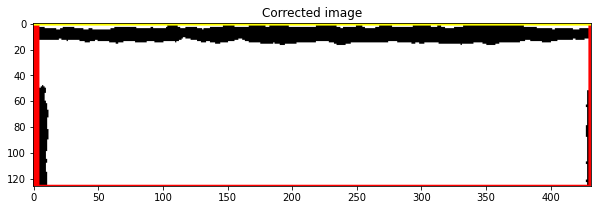

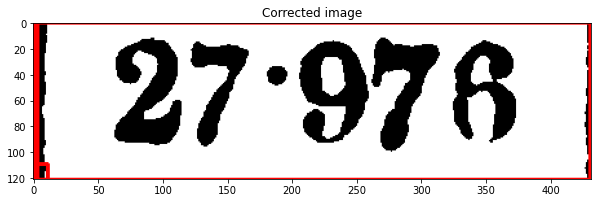

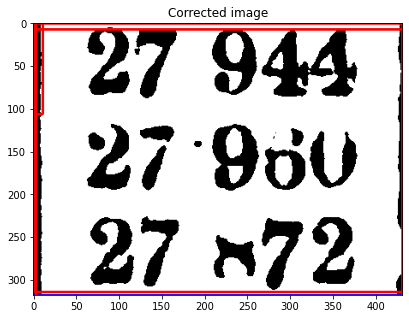

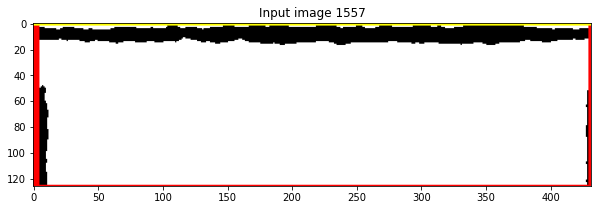

[2917, 1804, 3349, 2122, 0]
[] 66.8
rows [2917, 1557, 3349, 1683, 0] [1557, 1683] 167.0
[2950.1375, 3325.8625] 177.10000000000002
cols [2917, 1557, 3349, 1683, 0] [2917, 3325.8625] 442.75


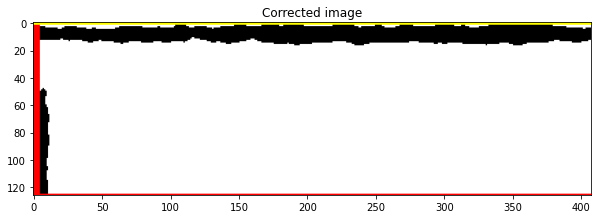

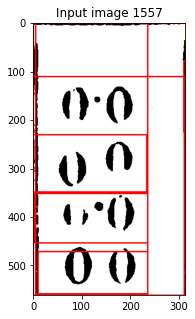

[2917, 1557, 3325, 1683, 0]
[1595.65, 1667] 66.8
rows [832, 1557, 1146, 2118, 0] [1557, 1667, 2118] 167.0
[853.8625] 177.10000000000002
cols [832, 1557, 1146, 2118, 0] [832, 1146] 442.75


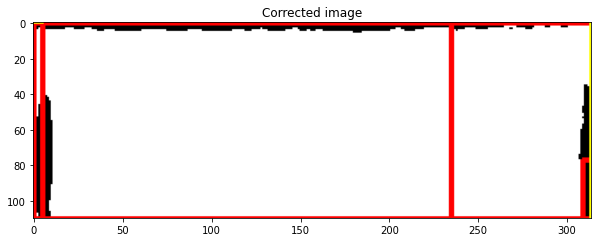

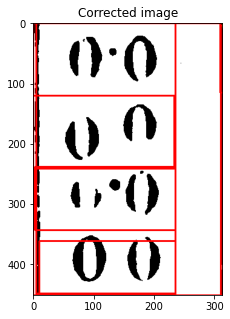

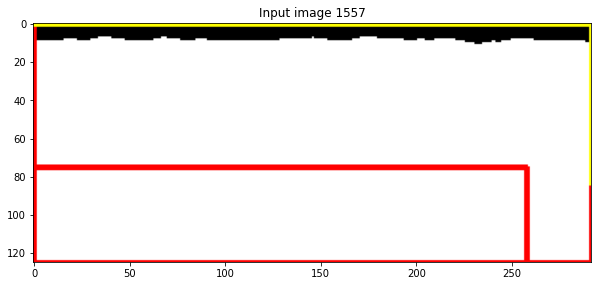

[832, 1667, 1146, 2118, 0]
[] 66.8
rows [1780, 1557, 2072, 1682, 0] [1557, 1682] 167.0
[] 177.10000000000002
cols [1780, 1557, 2072, 1682, 0] [1780, 2072] 442.75


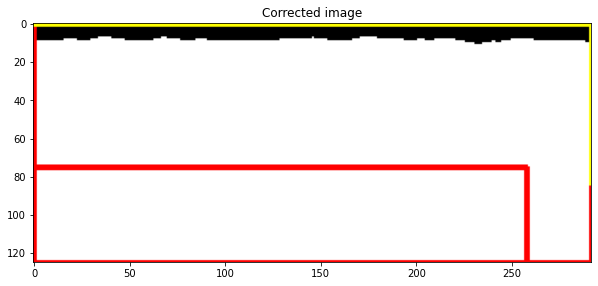

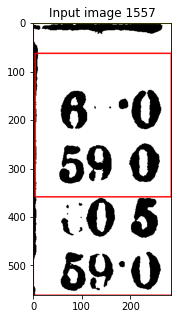

[1780, 1557, 2072, 1682, 0]
[1617.65] 66.8
rows [3349, 1557, 3634, 2118, 0] [1557, 2118] 167.0
[3380.8625, 3634.1375] 177.10000000000002
cols [3349, 1557, 3634, 2118, 0] [3349, 3634.1375] 442.75


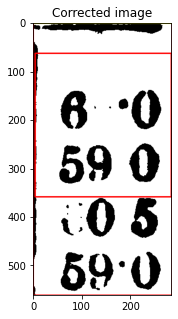

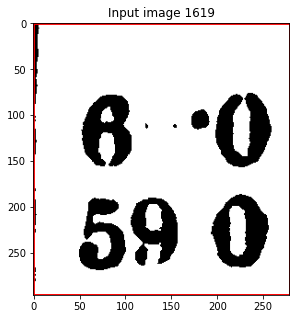

[3349, 1557, 3634, 2118, 0]
[] 66.8
rows [3353, 1619, 3632, 1915, 0] [1619, 1915] 167.0
[3380.8625, 3632.1375] 177.10000000000002
cols [3353, 1619, 3632, 1915, 0] [3353, 3632.1375] 442.75


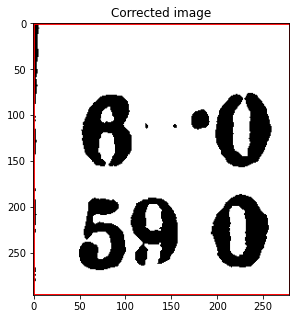

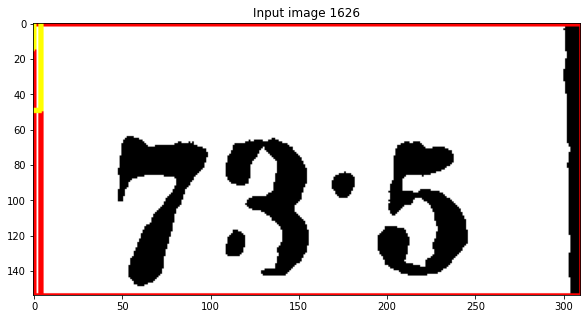

[3353, 1619, 3632, 1915, 0]
[] 66.8
rows [1458, 1626, 1768, 1780, 0] [1626, 1780] 167.0
[] 177.10000000000002
cols [1458, 1626, 1768, 1780, 0] [1458, 1768] 442.75


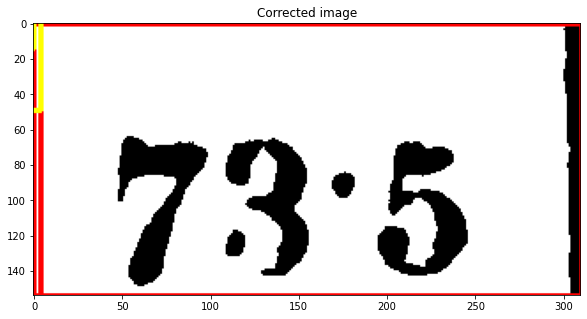

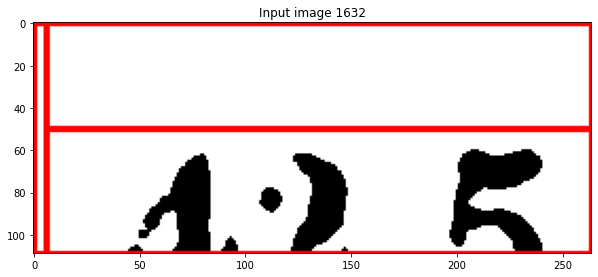

[1458, 1626, 1768, 1780, 0]
[] 66.8
rows [1774, 1632, 2038, 1741, 0] [1632, 1741] 167.0
[1791.8625, 2038.1375] 177.10000000000002
cols [1774, 1632, 2038, 1741, 0] [1774, 2038.1375] 442.75


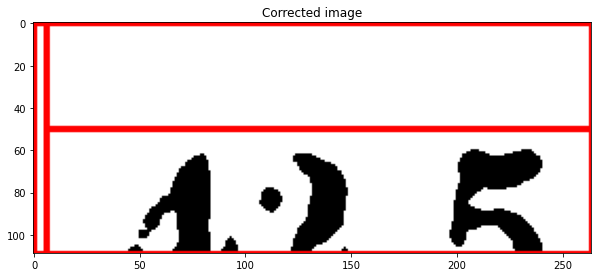

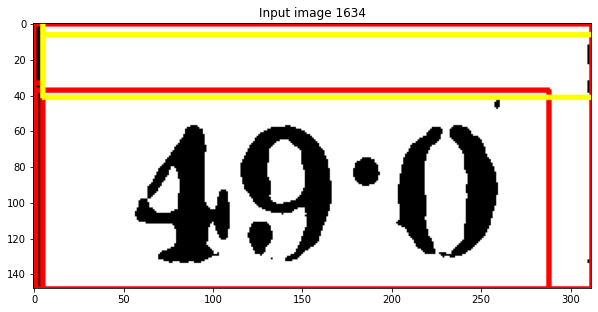

[1774, 1632, 2038, 1741, 0]
[] 66.8
rows [1141, 1634, 1453, 1782, 0] [1634, 1782] 167.0
[1167.8625] 177.10000000000002
cols [1141, 1634, 1453, 1782, 0] [1141, 1453] 442.75


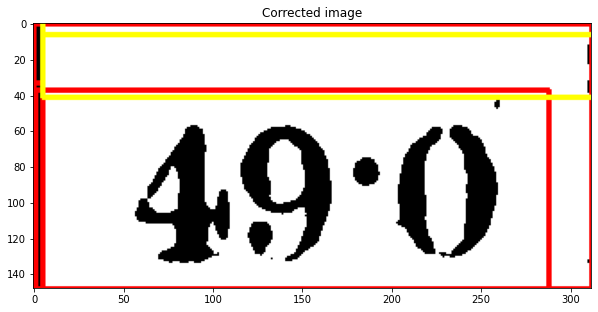

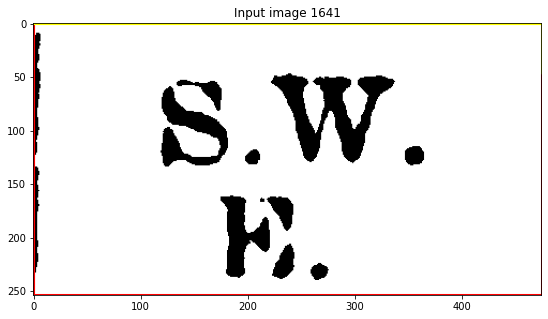

[1141, 1634, 1453, 1782, 0]
[1641.65, 1895.35] 66.8
rows [2072, 1641, 2547, 1895, 0] [1641, 1895.35] 167.0
[2161.8625] 177.10000000000002
cols [2072, 1641, 2547, 1895, 0] [2072, 2547] 442.75


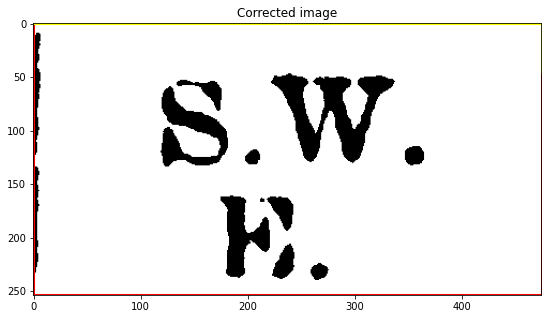

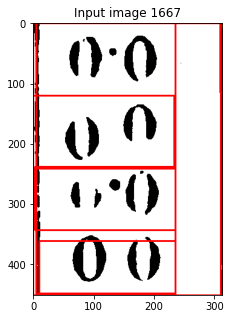

[2072, 1641, 2547, 1895, 0]
[1669.65] 66.8
rows [832, 1667, 1146, 2118, 0] [1667, 2118] 167.0
[853.8625] 177.10000000000002
cols [832, 1667, 1146, 2118, 0] [832, 1146] 442.75


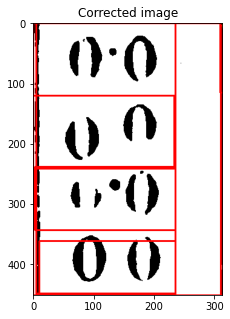

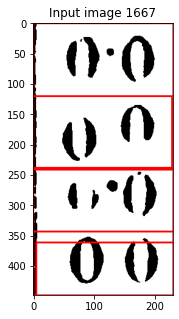

[832, 1667, 1146, 2118, 0]
[] 66.8
rows [837, 1667, 1067, 2115, 0] [1667, 2115] 167.0
[853.8625, 1067.1375] 177.10000000000002
cols [837, 1667, 1067, 2115, 0] [837, 1067.1375] 442.75


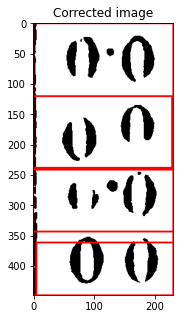

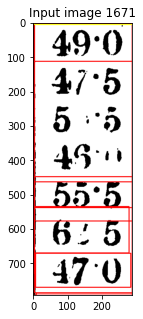

[837, 1667, 1067, 2115, 0]
[1671.65] 66.8
rows [1142, 1671, 1429, 2463, 0] [1671, 2463] 167.0
[1170.8625, 1429.1375] 177.10000000000002
cols [1142, 1671, 1429, 2463, 0] [1142, 1429.1375] 442.75


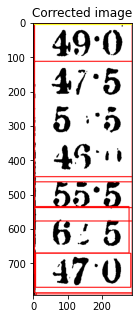

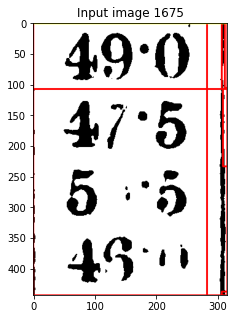

[1142, 1671, 1429, 2463, 0]
[1675.65] 66.8
rows [1146, 1675, 1462, 2118, 0] [1675, 2118] 167.0
[1168.8625] 177.10000000000002
cols [1146, 1675, 1462, 2118, 0] [1146, 1462] 442.75


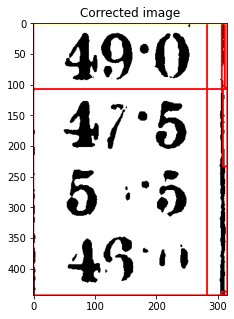

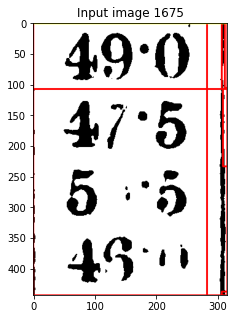

[1146, 1675, 1462, 2118, 0]
[1675.65] 66.8
rows [1146, 1675, 1462, 2118, 0] [1675, 2118] 167.0
[1168.8625] 177.10000000000002
cols [1146, 1675, 1462, 2118, 0] [1146, 1462] 442.75


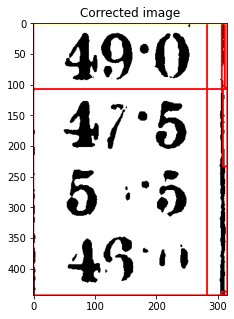

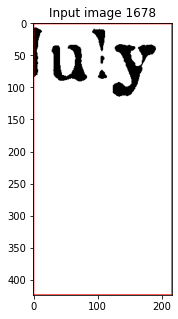

[1146, 1675, 1462, 2118, 0]


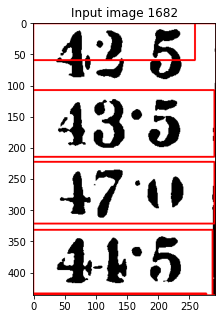

[1146, 1675, 1462, 2118, 0]
[1682.65] 66.8
rows [1780, 1682, 2072, 2118, 0] [1682, 2118] 167.0
[1791.8625] 177.10000000000002
cols [1780, 1682, 2072, 2118, 0] [1780, 2072] 442.75


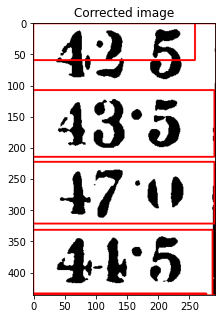

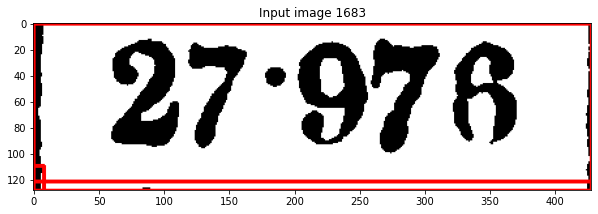

[1780, 1682, 2072, 2118, 0]
[1683.65] 66.8
rows [2920, 1683, 3348, 1811, 0] [1683, 1811] 167.0
[2947.8625] 177.10000000000002
cols [2920, 1683, 3348, 1811, 0] [2920, 3348] 442.75


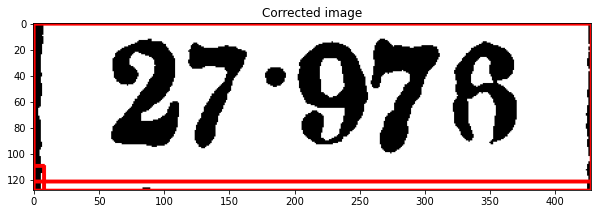

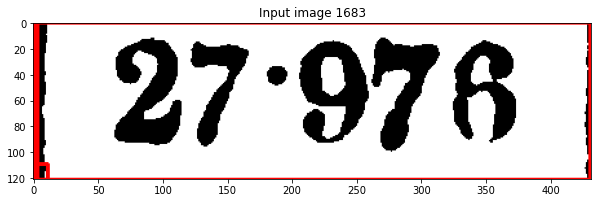

[2920, 1683, 3348, 1811, 0]
[1683.65, 1811.35] 66.8
rows [2917, 1683, 3349, 1804, 0] [1683, 1811.35] 167.0
[2947.8625] 177.10000000000002
cols [2917, 1683, 3349, 1804, 0] [2917, 3349] 442.75


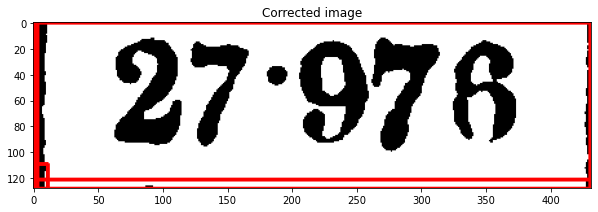

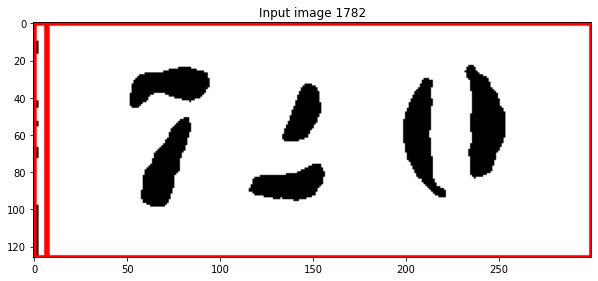

[2917, 1683, 3349, 1811, 0]
[] 66.8
rows [1455, 1782, 1755, 1908, 0] [1782, 1908] 167.0
[1482.8625] 177.10000000000002
cols [1455, 1782, 1755, 1908, 0] [1455, 1755] 442.75


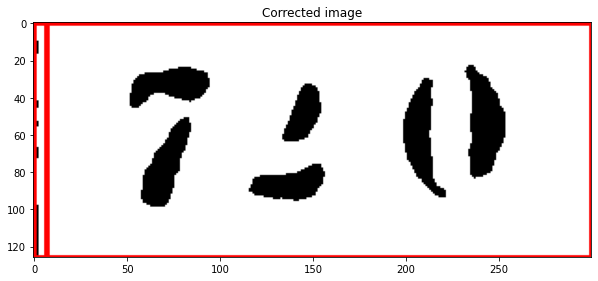

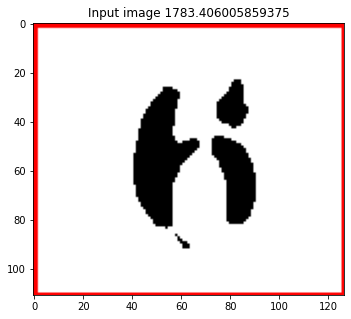

[1455, 1782, 1755, 1908, 0]


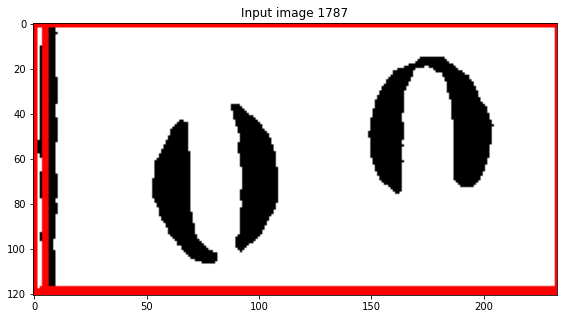

[1455, 1782, 1755, 1908, 0]
[] 66.8
rows [832, 1787, 1065, 1908, 0] [1787, 1908] 167.0
[856.8625, 1065.1375] 177.10000000000002
cols [832, 1787, 1065, 1908, 0] [832, 1065.1375] 442.75


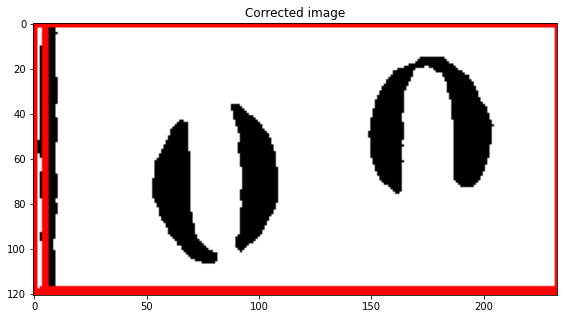

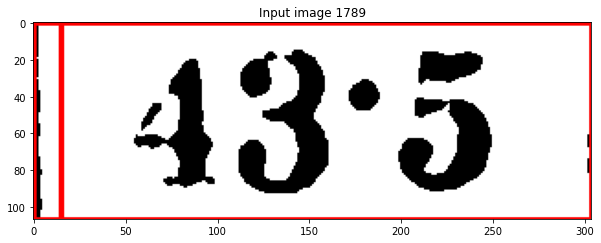

[832, 1787, 1065, 1908, 0]
[1780.65, 1896.35] 66.8
rows [1765, 1789, 2069, 1896, 0] [1789, 1896.35] 167.0
[1791.8625] 177.10000000000002
cols [1765, 1789, 2069, 1896, 0] [1765, 2069] 442.75


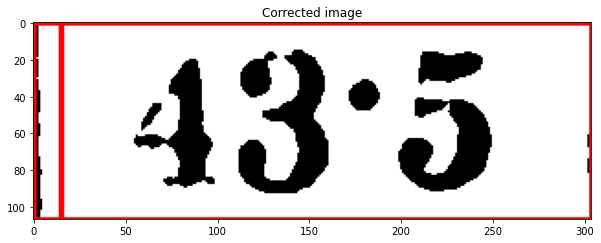

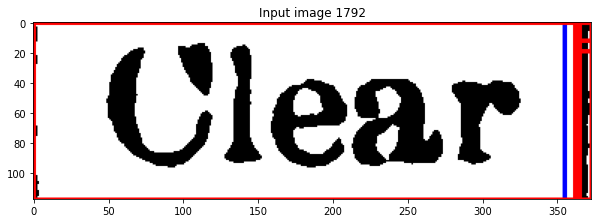

[1765, 1789, 2069, 1896, 0]
[] 66.8
rows [2555, 1792, 2928, 1910, 0] [1792, 1910] 167.0
[2582.8625] 177.10000000000002
cols [2555, 1792, 2928, 1910, 0] [2555, 2928] 442.75


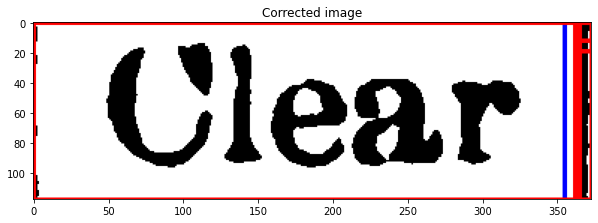

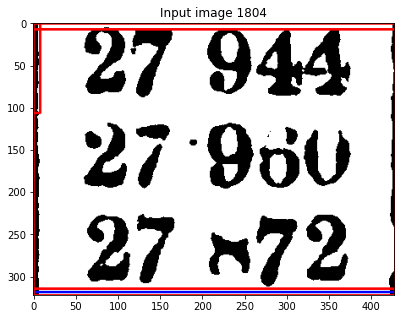

[2555, 1792, 2928, 1910, 0]
[1797.65] 66.8
rows [2920, 1804, 3348, 2126, 0] [1804, 2126] 167.0
[2952.8625] 177.10000000000002
cols [2920, 1804, 3348, 2126, 0] [2920, 3348] 442.75


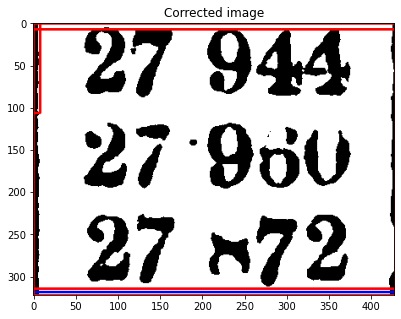

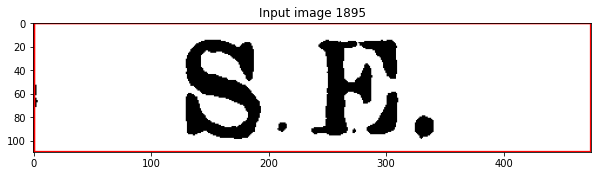

[2920, 1804, 3348, 2126, 0]
[1894.65, 2001.35] 66.8
rows [2072, 1895, 2547, 2005, 0] [1895, 2001.35] 167.0
[2165.8625] 177.10000000000002
cols [2072, 1895, 2547, 2005, 0] [2072, 2547] 442.75


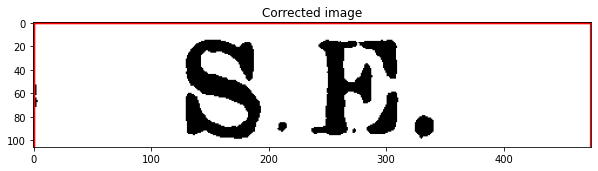

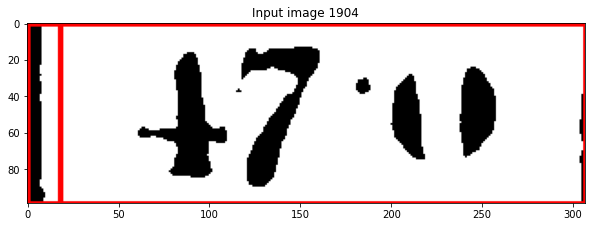

[2072, 1895, 2547, 2001, 0]
[1908.65, 2003.35] 66.8
rows [1762, 1904, 2069, 2003, 0] [1904, 2003.35] 167.0
[1797.8625] 177.10000000000002
cols [1762, 1904, 2069, 2003, 0] [1762, 2069] 442.75


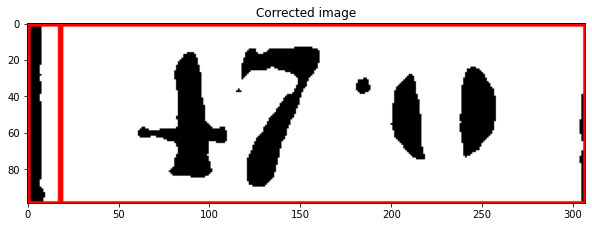

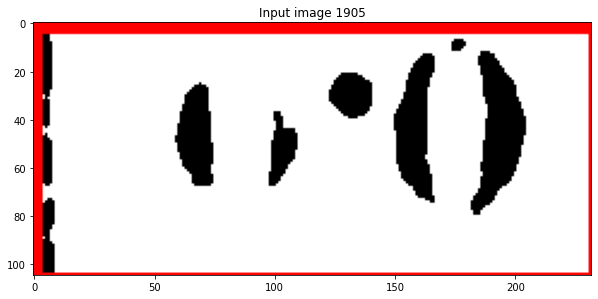

[1762, 1904, 2069, 2003, 0]
[] 66.8
rows [835, 1905, 1067, 2010, 0] [1905, 2010] 167.0
[859.8625, 1067.1375] 177.10000000000002
cols [835, 1905, 1067, 2010, 0] [835, 1067.1375] 442.75


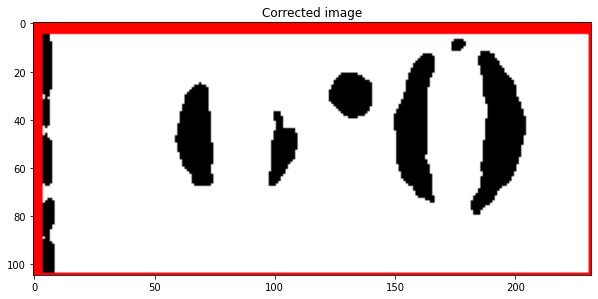

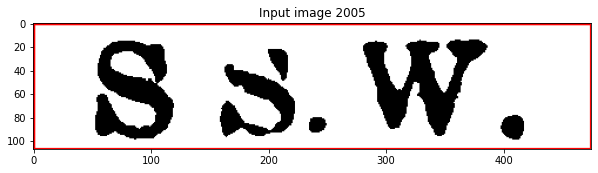

[835, 1905, 1067, 2010, 0]
[2008.65, 2112.35] 66.8
rows [2072, 2005, 2547, 2112, 0] [2005, 2112.35] 167.0
[2093.8625, 2498.1375] 177.10000000000002
cols [2072, 2005, 2547, 2112, 0] [2072, 2498.1375] 442.75


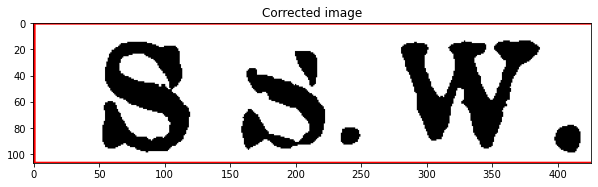

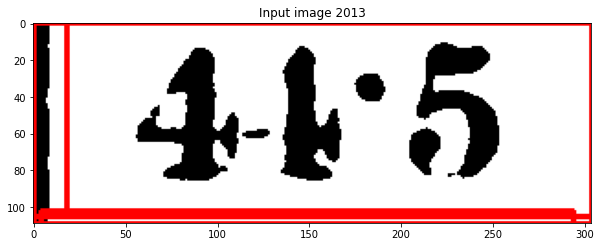

[2072, 2005, 2498, 2112, 0]
[] 66.8
rows [1762, 2013, 2066, 2122, 0] [2013, 2122] 167.0
[1793.8625] 177.10000000000002
cols [1762, 2013, 2066, 2122, 0] [1762, 2066] 442.75


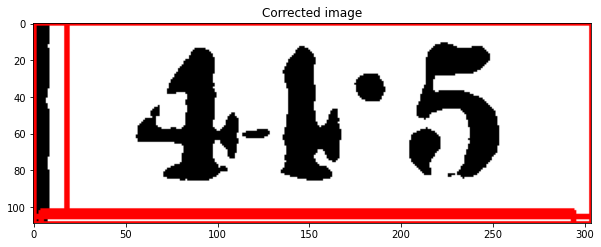

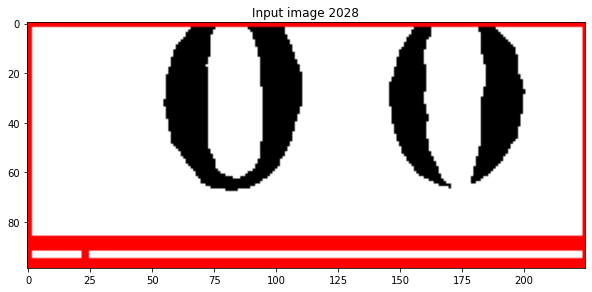

[1762, 2013, 2066, 2122, 0]
[2019.65] 66.8
rows [842, 2028, 1067, 2127, 0] [2028, 2127] 167.0
[866.8625, 1067.1375] 177.10000000000002
cols [842, 2028, 1067, 2127, 0] [842, 1067.1375] 442.75


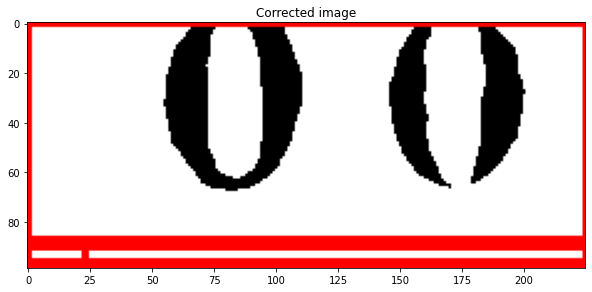

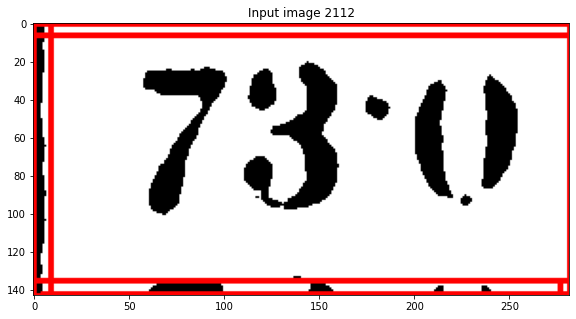

[842, 2028, 1067, 2127, 0]
[] 66.8
rows [1453, 2112, 1735, 2255, 0] [2112, 2255] 167.0
[1486.8625, 1735.1375] 177.10000000000002
cols [1453, 2112, 1735, 2255, 0] [1453, 1735.1375] 442.75


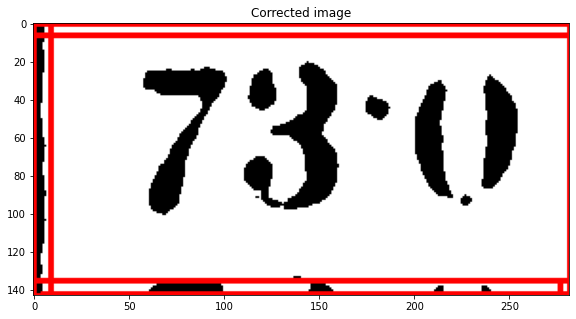

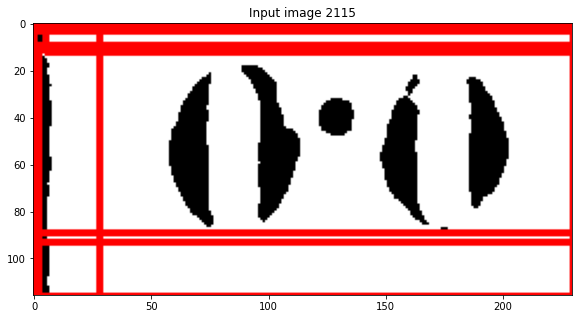

[1453, 2112, 1735, 2255, 0]
[2107.65] 66.8
rows [837, 2115, 1067, 2231, 0] [2115, 2231] 167.0
[865.8625, 1067.1375] 177.10000000000002
cols [837, 2115, 1067, 2231, 0] [837, 1067.1375] 442.75


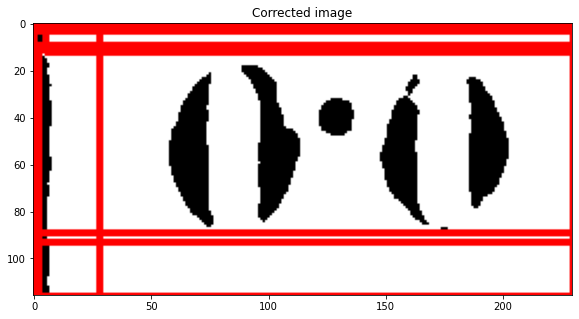

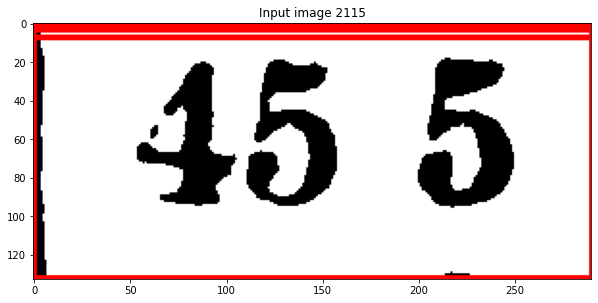

[837, 2115, 1067, 2231, 0]
[] 66.8
rows [1766, 2115, 2056, 2248, 0] [2115, 2248] 167.0
[1796.8625] 177.10000000000002
cols [1766, 2115, 2056, 2248, 0] [1766, 2056] 442.75


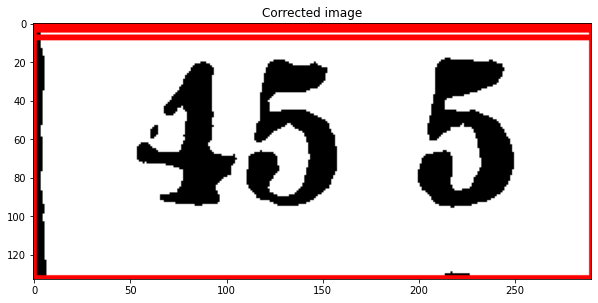

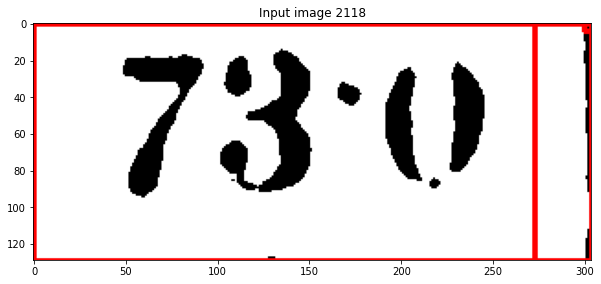

[1766, 2115, 2056, 2248, 0]
[] 66.8
rows [1462, 2118, 1766, 2247, 0] [2118, 2247] 167.0
[1485.8625, 1735.1375] 177.10000000000002
cols [1462, 2118, 1766, 2247, 0] [1462, 1735.1375] 442.75


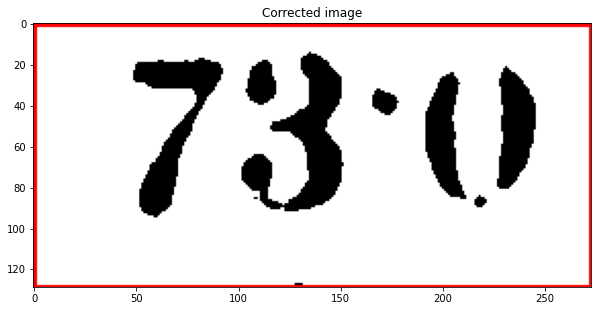

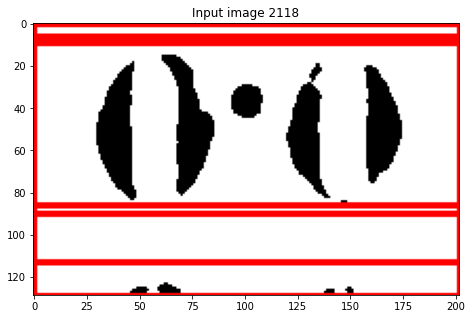

[1462, 2118, 1735, 2247, 0]


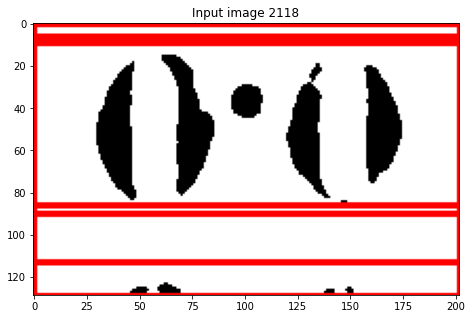

[1462, 2118, 1735, 2247, 0]


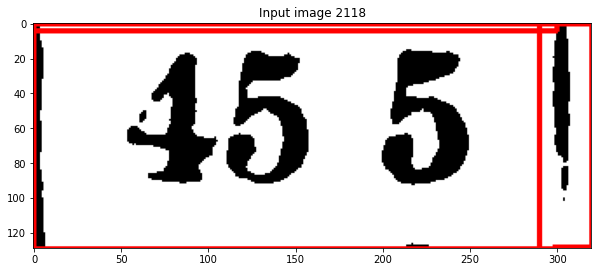

[1462, 2118, 1735, 2247, 0]
[] 66.8
rows [1766, 2118, 2086, 2247, 0] [2118, 2247] 167.0
[1796.8625] 177.10000000000002
cols [1766, 2118, 2086, 2247, 0] [1766, 2086] 442.75


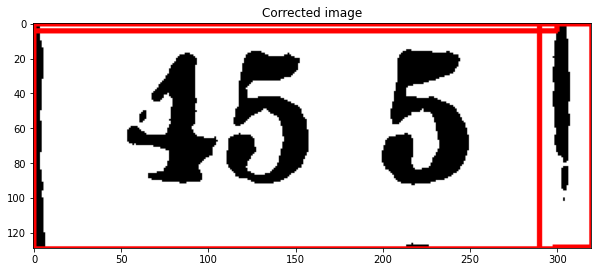

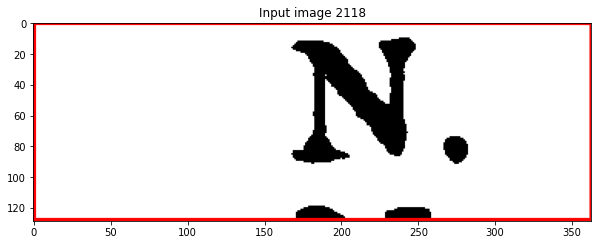

[1766, 2118, 2086, 2247, 0]
[] 66.8
rows [2086, 2118, 2449, 2247, 0] [2118, 2247] 167.0
[2223.8625, 2449.1375] 177.10000000000002
cols [2086, 2118, 2449, 2247, 0] [2086, 2449.1375] 442.75


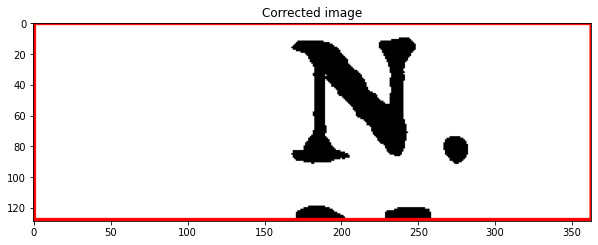

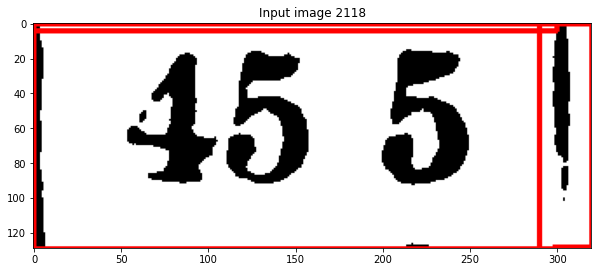

[2086, 2118, 2449, 2247, 0]
[] 66.8
rows [1766, 2118, 2086, 2247, 0] [2118, 2247] 167.0
[1796.8625] 177.10000000000002
cols [1766, 2118, 2086, 2247, 0] [1766, 2086] 442.75


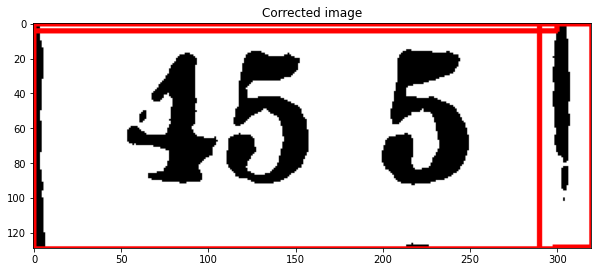

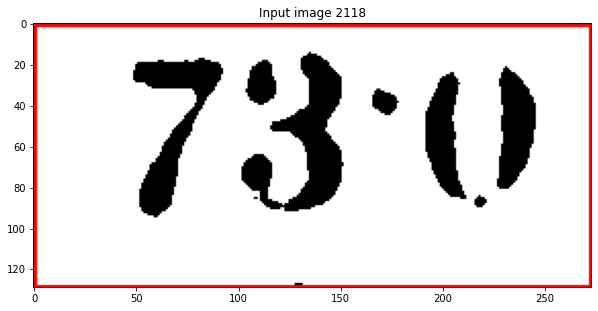

[1766, 2118, 2086, 2247, 0]
[] 66.8
rows [1462, 2118, 1735, 2247, 0] [2118, 2247] 167.0
[1485.8625, 1735.1375] 177.10000000000002
cols [1462, 2118, 1735, 2247, 0] [1462, 1735.1375] 442.75


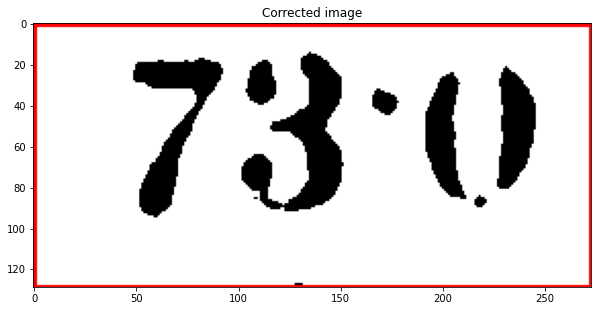

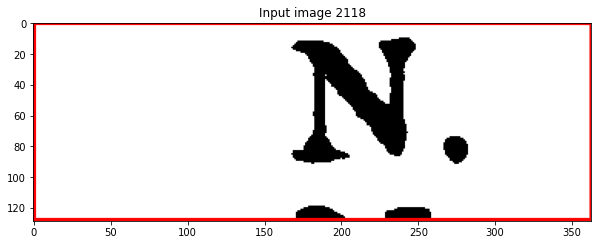

[1462, 2118, 1735, 2247, 0]
[] 66.8
rows [2086, 2118, 2449, 2247, 0] [2118, 2247] 167.0
[2223.8625, 2449.1375] 177.10000000000002
cols [2086, 2118, 2449, 2247, 0] [2086, 2449.1375] 442.75


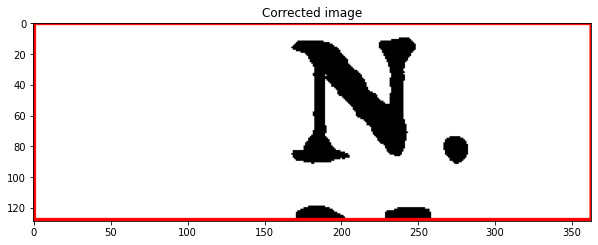

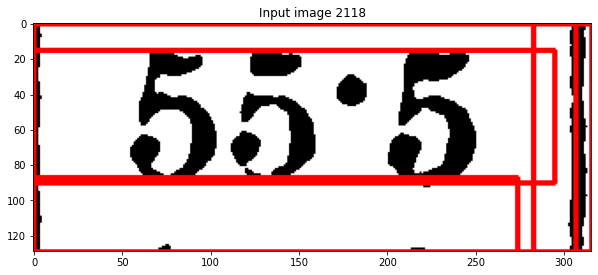

[2086, 2118, 2449, 2247, 0]
[] 66.8
rows [1146, 2118, 1462, 2247, 0] [2118, 2247] 167.0
[1174.8625] 177.10000000000002
cols [1146, 2118, 1462, 2247, 0] [1146, 1462] 442.75


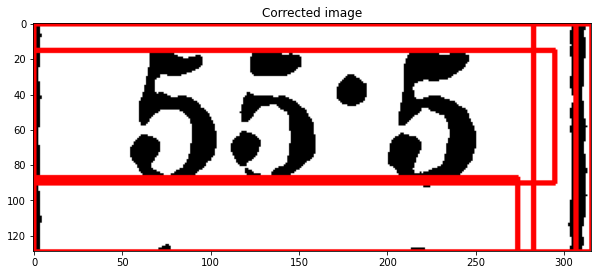

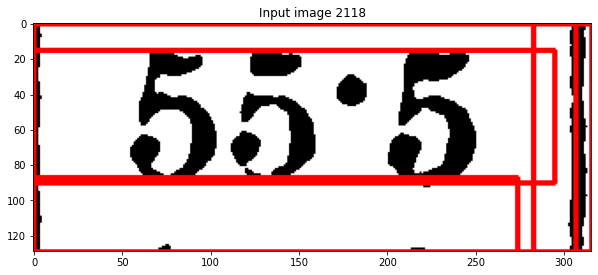

[1146, 2118, 1462, 2247, 0]
[] 66.8
rows [1146, 2118, 1462, 2247, 0] [2118, 2247] 167.0
[1174.8625] 177.10000000000002
cols [1146, 2118, 1462, 2247, 0] [1146, 1462] 442.75


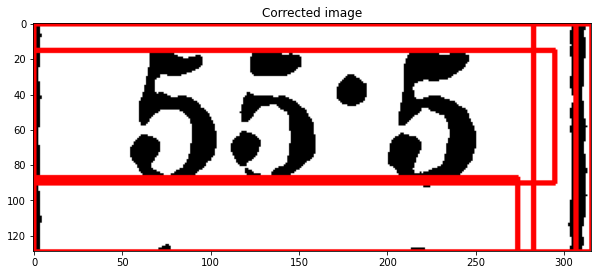

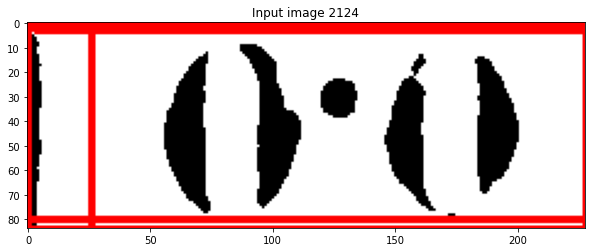

[1146, 2118, 1462, 2247, 0]
[] 66.8
rows [839, 2124, 1067, 2208, 0] [2124, 2208] 167.0
[865.8625, 1067.1375] 177.10000000000002
cols [839, 2124, 1067, 2208, 0] [839, 1067.1375] 442.75


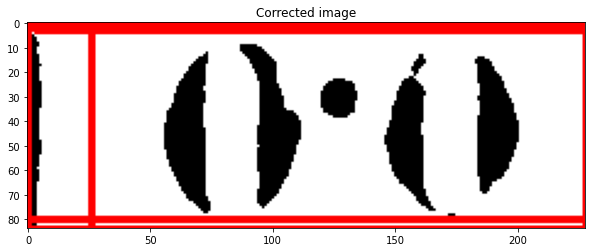

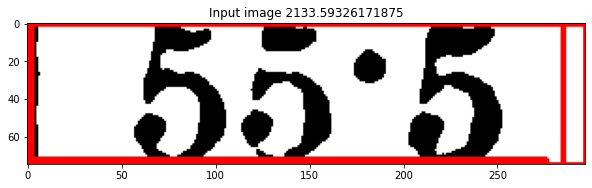

[839, 2124, 1067, 2208, 0]


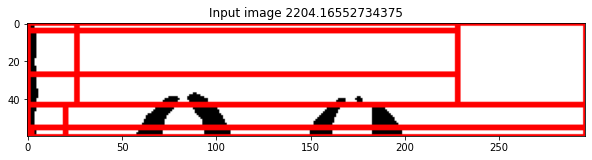

[839, 2124, 1067, 2208, 0]


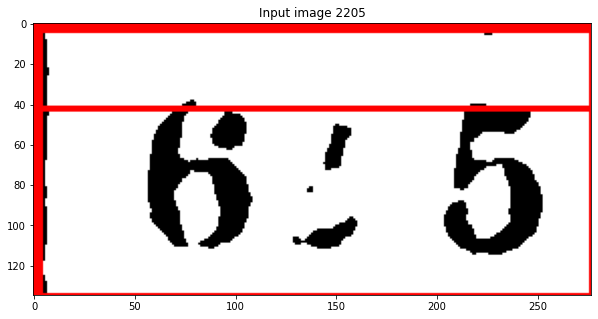

[839, 2124, 1067, 2208, 0]
[] 66.8
rows [1143, 2205, 1420, 2340, 0] [2205, 2340] 167.0
[1171.8625, 1420.1375] 177.10000000000002
cols [1143, 2205, 1420, 2340, 0] [1143, 1420.1375] 442.75


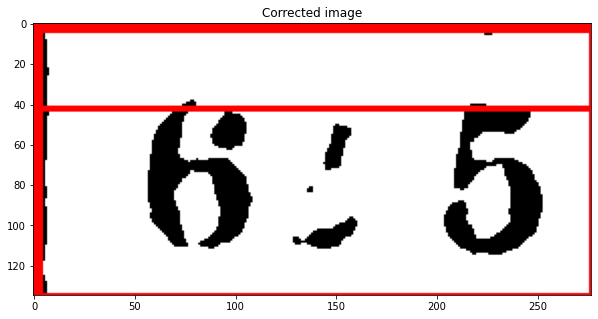

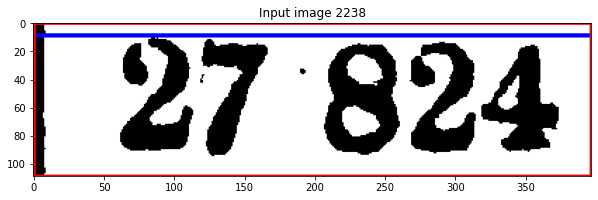

[1143, 2205, 1420, 2340, 0]
[2237.65] 66.8
rows [2920, 2238, 3317, 2347, 0] [2238, 2347] 167.0
[2954.8625, 3317.1375] 177.10000000000002
cols [2920, 2238, 3317, 2347, 0] [2920, 3317.1375] 442.75


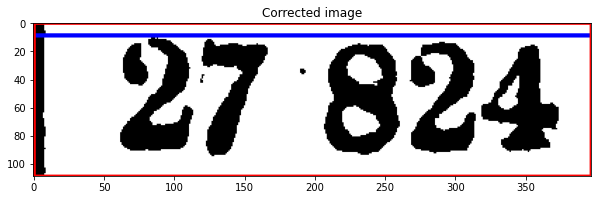

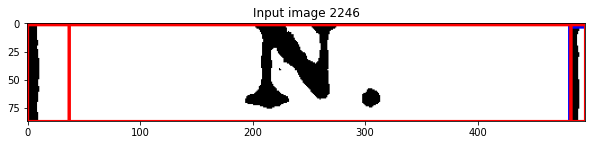

[2920, 2238, 3317, 2347, 0]
[] 66.8
rows [2064, 2246, 2560, 2333, 0] [2246, 2333] 167.0
[2223.8625] 177.10000000000002
cols [2064, 2246, 2560, 2333, 0] [2064, 2560] 442.75


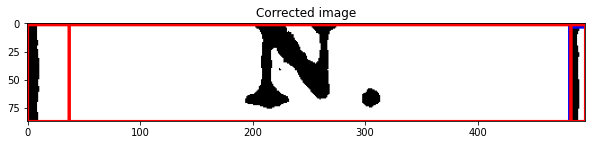

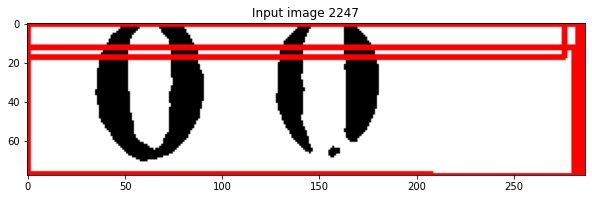

[2064, 2246, 2560, 2333, 0]


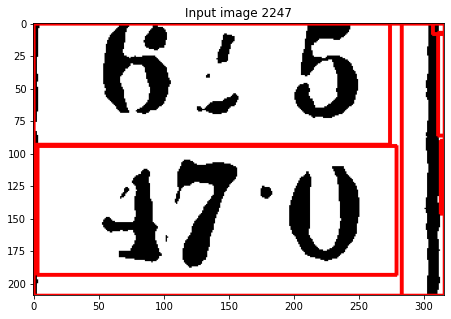

[2064, 2246, 2560, 2333, 0]
[2238.65] 66.8
rows [1146, 2247, 1462, 2456, 0] [2247, 2456] 167.0
[1171.8625] 177.10000000000002
cols [1146, 2247, 1462, 2456, 0] [1146, 1462] 442.75


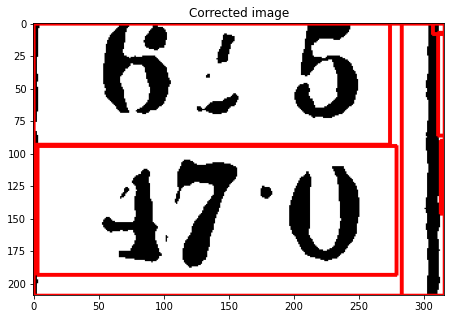

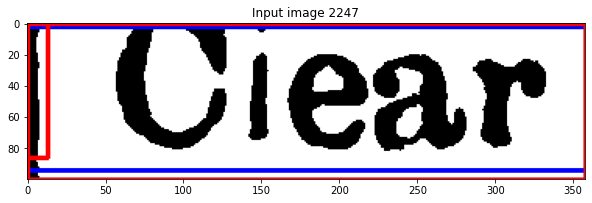

[1146, 2247, 1462, 2456, 0]
[2238.65, 2354.35] 66.8
rows [2547, 2247, 2905, 2347, 0] [2247, 2354.35] 167.0
[2580.8625, 2905.1375] 177.10000000000002
cols [2547, 2247, 2905, 2347, 0] [2547, 2905.1375] 442.75


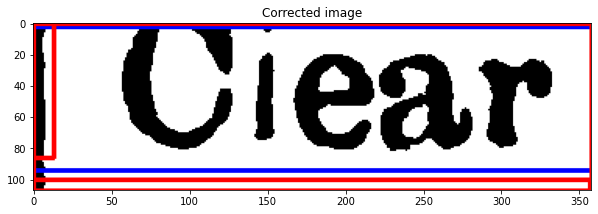

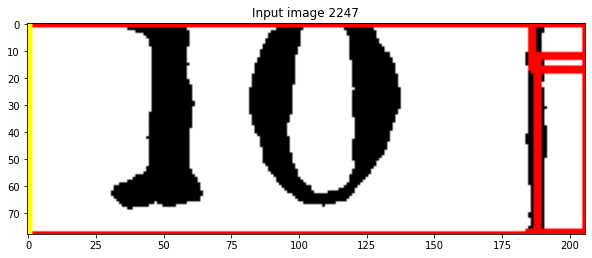

[2547, 2247, 2905, 2354, 0]


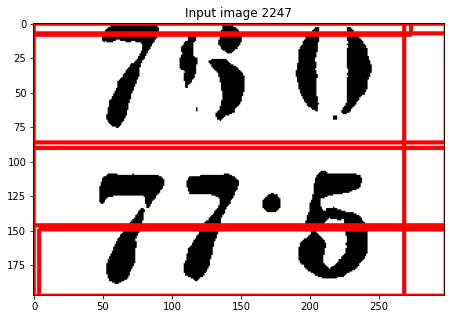

[2547, 2247, 2905, 2354, 0]
[2238.65, 2445.35] 66.8
rows [1462, 2247, 1760, 2444, 0] [2247, 2445.35] 167.0
[1485.8625, 1730.1375] 177.10000000000002
cols [1462, 2247, 1760, 2444, 0] [1462, 1730.1375] 442.75


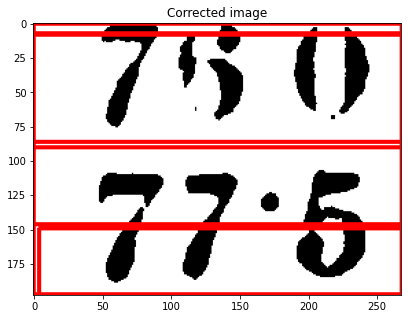

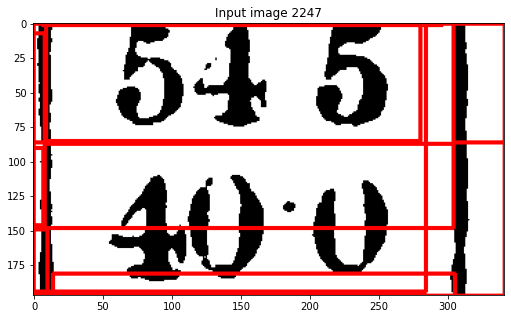

[1462, 2247, 1730, 2445, 0]
[2238.65, 2441.35] 66.8
rows [1760, 2247, 2101, 2444, 0] [2247, 2441.35] 167.0
[1790.8625, 2044.1375] 177.10000000000002
cols [1760, 2247, 2101, 2444, 0] [1760, 2044.1375] 442.75


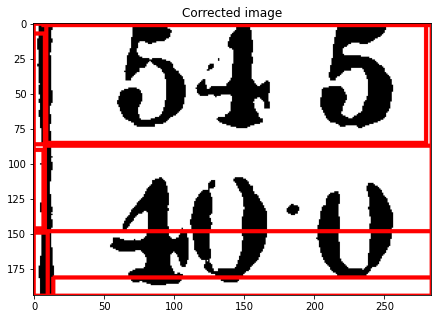

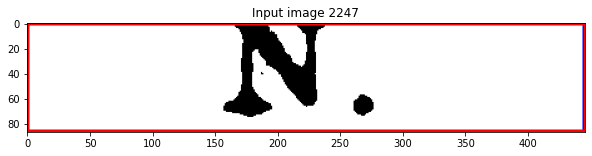

[1760, 2247, 2044, 2441, 0]
[2238.65] 66.8
rows [2101, 2247, 2547, 2334, 0] [2247, 2334] 167.0
[2223.8625, 2436.1375] 177.10000000000002
cols [2101, 2247, 2547, 2334, 0] [2101, 2436.1375] 442.75


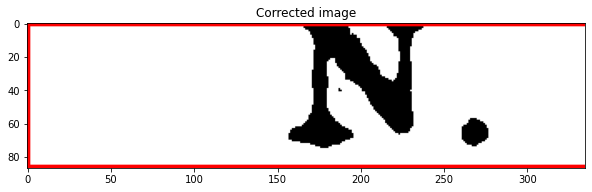

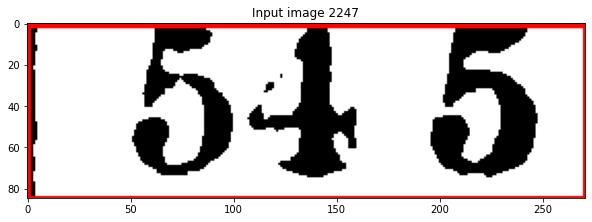

[2101, 2247, 2436, 2334, 0]
[] 66.8
rows [1769, 2247, 2040, 2332, 0] [2247, 2332] 167.0
[1793.8625, 2040.1375] 177.10000000000002
cols [1769, 2247, 2040, 2332, 0] [1769, 2040.1375] 442.75


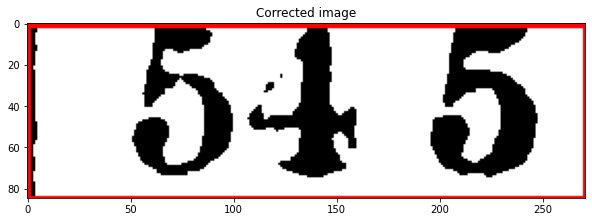

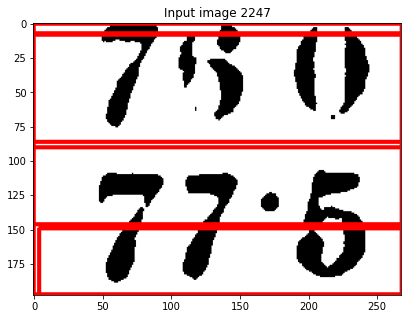

[1769, 2247, 2040, 2332, 0]
[2238.65, 2445.35] 66.8
rows [1462, 2247, 1730, 2445, 0] [2247, 2445.35] 167.0
[1485.8625, 1730.1375] 177.10000000000002
cols [1462, 2247, 1730, 2445, 0] [1462, 1730.1375] 442.75


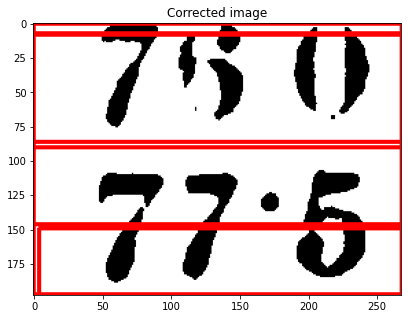

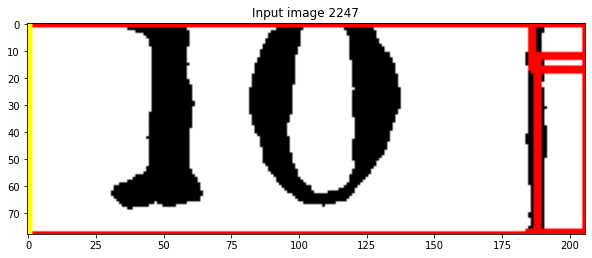

[1462, 2247, 1730, 2445, 0]


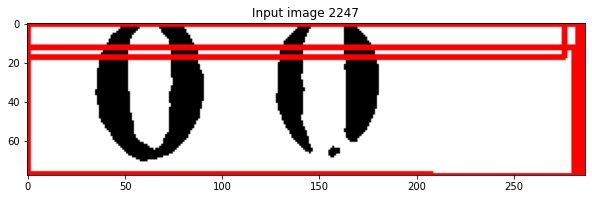

[1462, 2247, 1730, 2445, 0]


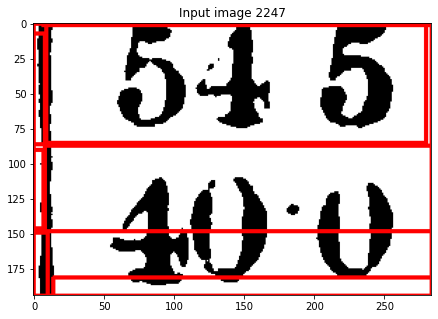

[1462, 2247, 1730, 2445, 0]
[2238.65, 2441.35] 66.8
rows [1760, 2247, 2044, 2441, 0] [2247, 2441.35] 167.0
[1790.8625, 2044.1375] 177.10000000000002
cols [1760, 2247, 2044, 2441, 0] [1760, 2044.1375] 442.75


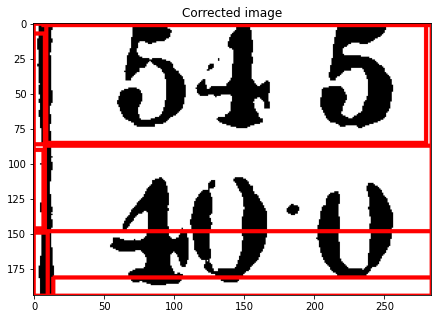

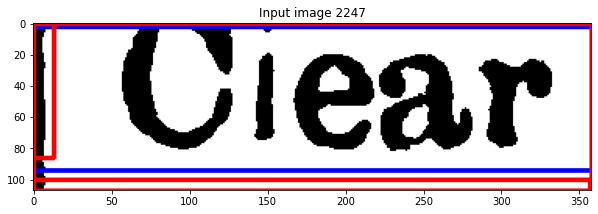

[1760, 2247, 2044, 2441, 0]
[2238.65] 66.8
rows [2547, 2247, 2905, 2354, 0] [2247, 2354] 167.0
[2580.8625, 2905.1375] 177.10000000000002
cols [2547, 2247, 2905, 2354, 0] [2547, 2905.1375] 442.75


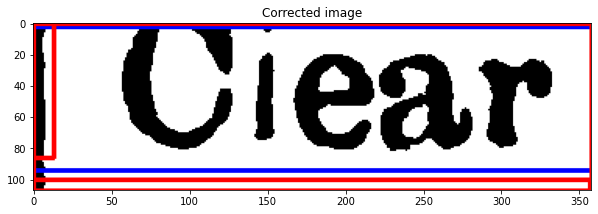

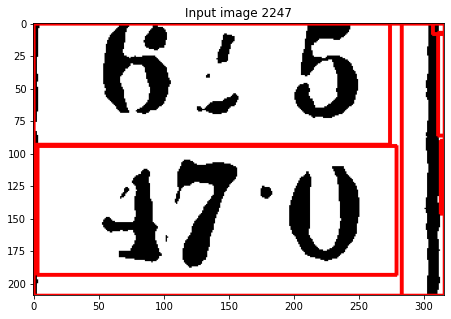

[2547, 2247, 2905, 2354, 0]
[2238.65] 66.8
rows [1146, 2247, 1462, 2456, 0] [2247, 2456] 167.0
[1171.8625] 177.10000000000002
cols [1146, 2247, 1462, 2456, 0] [1146, 1462] 442.75


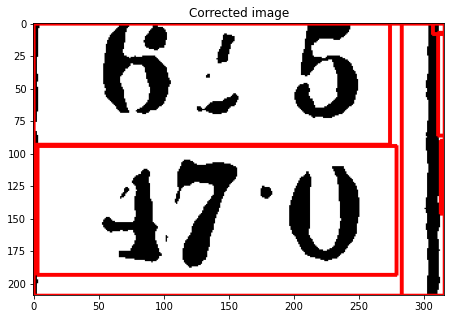

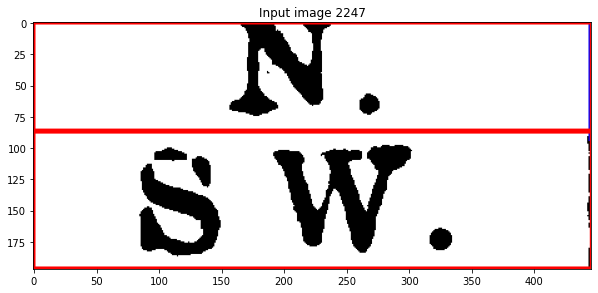

[1146, 2247, 1462, 2456, 0]
[2238.65, 2334, 2443.35] 66.8
rows [2101, 2247, 2547, 2444, 0] [2247, 2334, 2443.35] 167.0
[2158.8625] 177.10000000000002
cols [2101, 2247, 2547, 2444, 0] [2101, 2547] 442.75


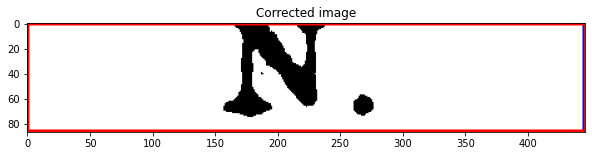

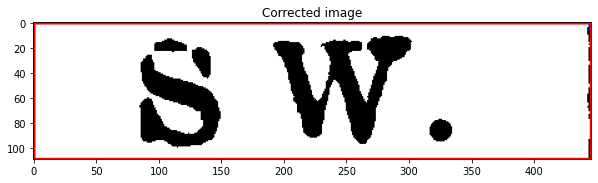

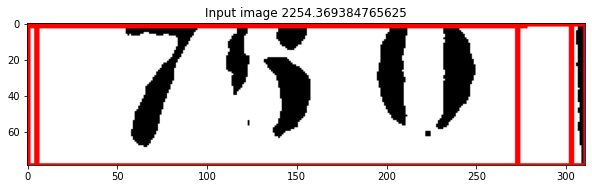

[2101, 2334, 2547, 2443, 0]


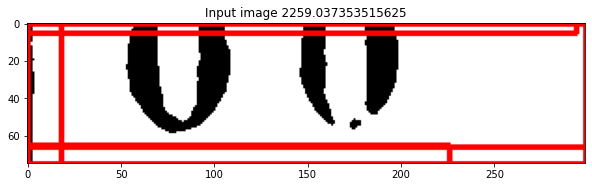

[2101, 2334, 2547, 2443, 0]


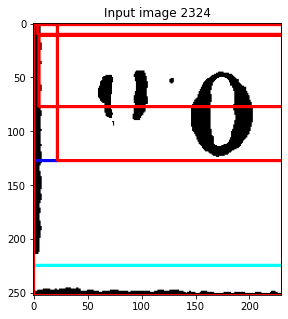

[2101, 2334, 2547, 2443, 0]
[2319.65] 66.8
rows [837, 2324, 1067, 2576, 0] [2324, 2576] 167.0
[863.8625, 1067.1375] 177.10000000000002
cols [837, 2324, 1067, 2576, 0] [837, 1067.1375] 442.75


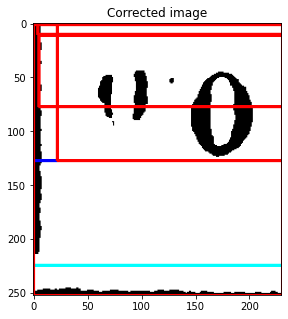

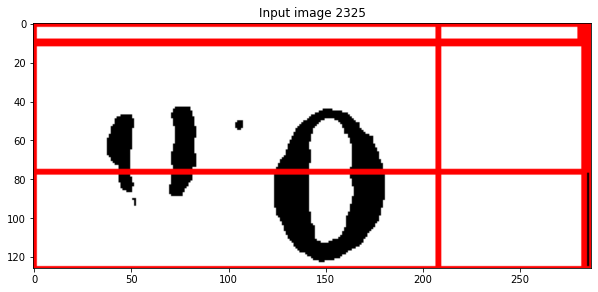

[837, 2324, 1067, 2576, 0]
[] 66.8
rows [859, 2325, 1146, 2451, 0] [2325, 2451] 167.0
[863.8625] 177.10000000000002
cols [859, 2325, 1146, 2451, 0] [859, 1146] 442.75


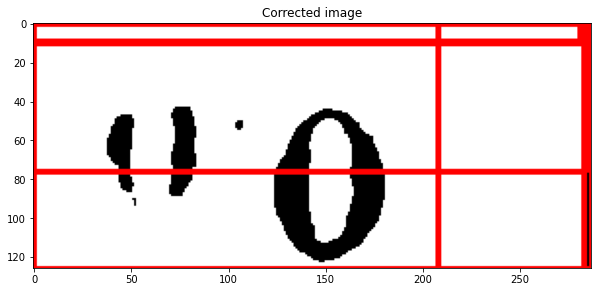

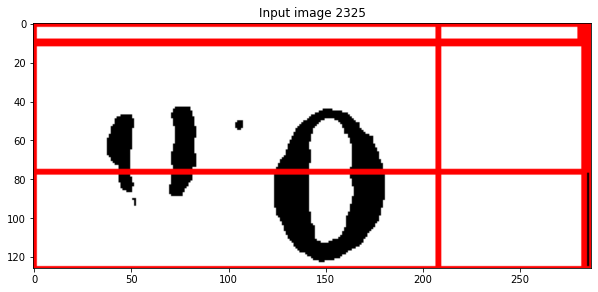

[859, 2325, 1146, 2451, 0]
[] 66.8
rows [859, 2325, 1146, 2451, 0] [2325, 2451] 167.0
[863.8625] 177.10000000000002
cols [859, 2325, 1146, 2451, 0] [859, 1146] 442.75


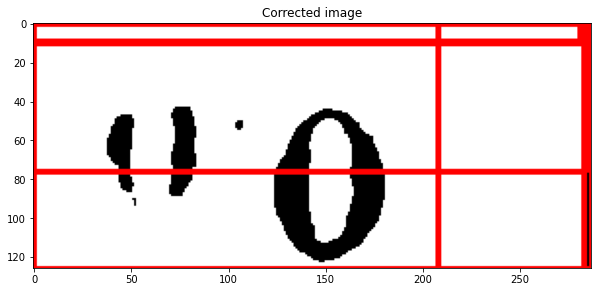

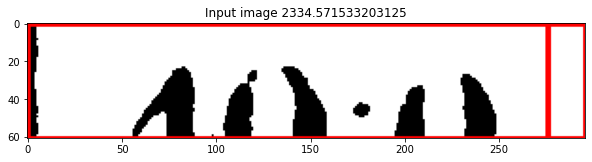

[859, 2325, 1146, 2451, 0]


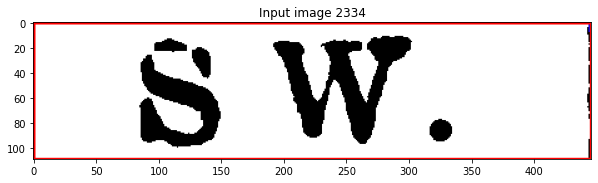

[859, 2325, 1146, 2451, 0]
[2337.65, 2443.35] 66.8
rows [2101, 2334, 2547, 2443, 0] [2334, 2443.35] 167.0
[2158.8625] 177.10000000000002
cols [2101, 2334, 2547, 2443, 0] [2101, 2547] 442.75


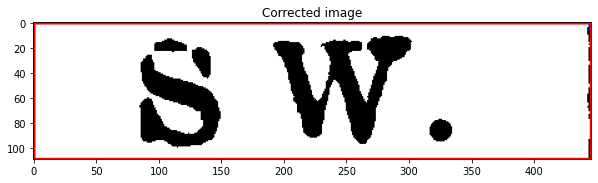

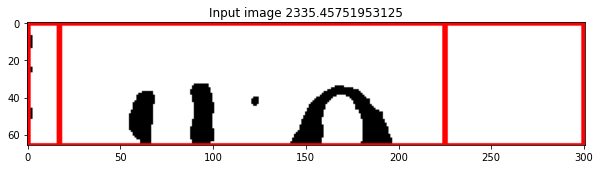

[2101, 2334, 2547, 2443, 0]


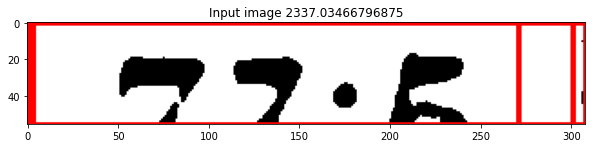

[2101, 2334, 2547, 2443, 0]


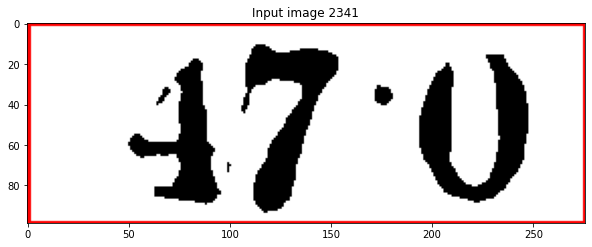

[2101, 2334, 2547, 2443, 0]
[2332.65, 2440.35] 66.8
rows [1149, 2341, 1425, 2440, 0] [2341, 2440.35] 167.0
[1172.8625, 1425.1375] 177.10000000000002
cols [1149, 2341, 1425, 2440, 0] [1149, 1425.1375] 442.75


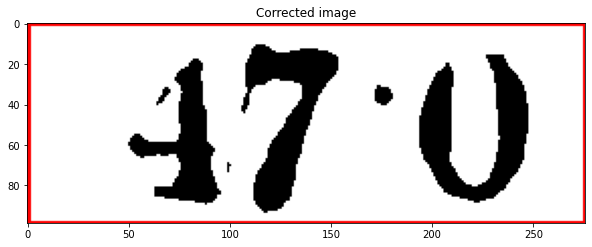

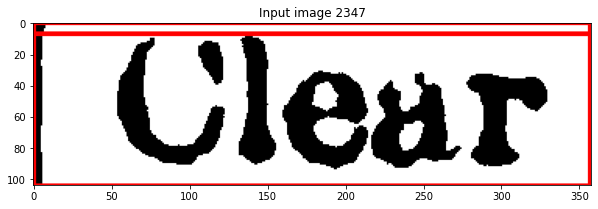

[1149, 2341, 1425, 2440, 0]
[2339.65, 2451.35] 66.8
rows [2547, 2347, 2905, 2451, 0] [2347, 2451.35] 167.0
[2575.8625, 2904.1375] 177.10000000000002
cols [2547, 2347, 2905, 2451, 0] [2547, 2904.1375] 442.75


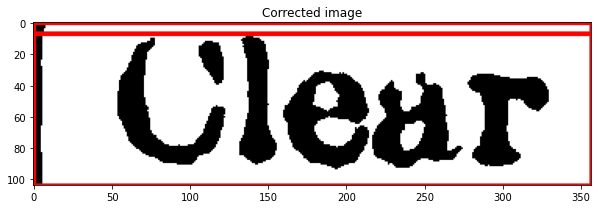

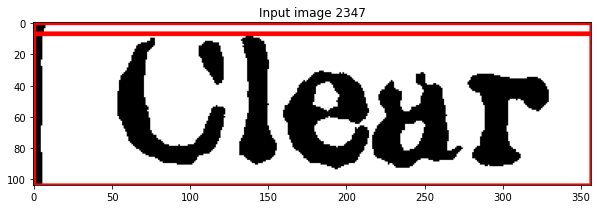

[2547, 2347, 2904, 2451, 0]
[2339.65, 2451.35] 66.8
rows [2547, 2347, 2904, 2451, 0] [2347, 2451.35] 167.0
[2575.8625, 2904.1375] 177.10000000000002
cols [2547, 2347, 2904, 2451, 0] [2547, 2904.1375] 442.75


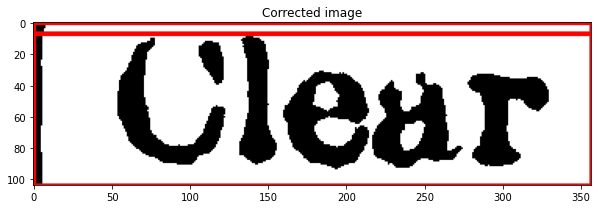

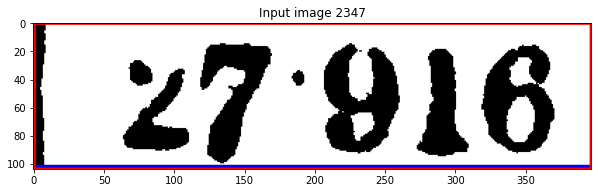

[2547, 2347, 2904, 2451, 0]
[2351.65, 2451.35] 66.8
rows [2920, 2347, 3317, 2451, 0] [2347, 2451.35] 167.0
[2944.8625, 3317.1375] 177.10000000000002
cols [2920, 2347, 3317, 2451, 0] [2920, 3317.1375] 442.75


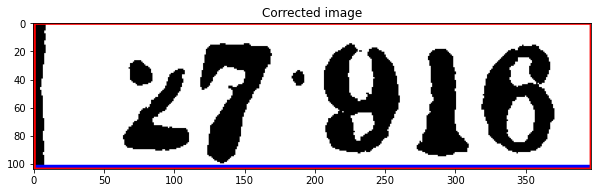

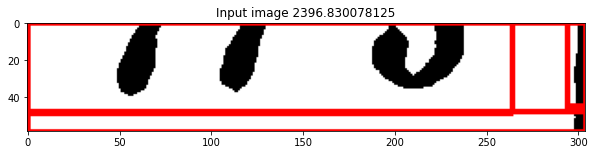

[2920, 2347, 3317, 2451, 0]


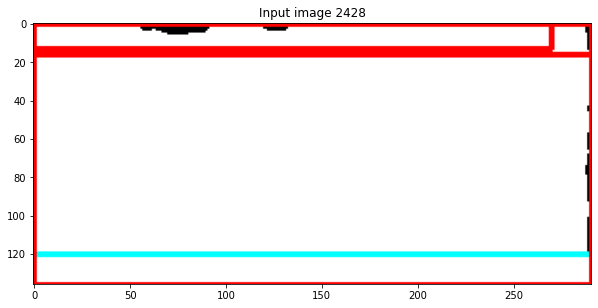

[2920, 2347, 3317, 2451, 0]
[] 66.8
rows [1774, 2428, 2065, 2564, 0] [2428, 2564] 167.0
[] 177.10000000000002
cols [1774, 2428, 2065, 2564, 0] [1774, 2065] 442.75


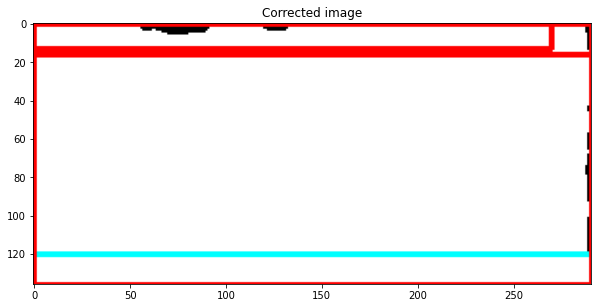

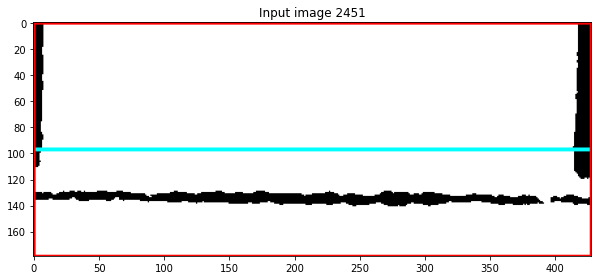

[1774, 2428, 2065, 2564, 0]
[] 66.8
rows [2920, 2451, 3348, 2630, 0] [2451, 2630] 167.0
[] 177.10000000000002
cols [2920, 2451, 3348, 2630, 0] [2920, 3348] 442.75


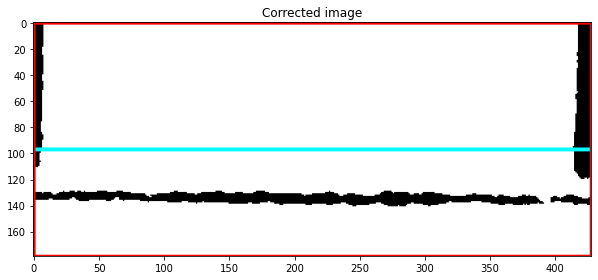

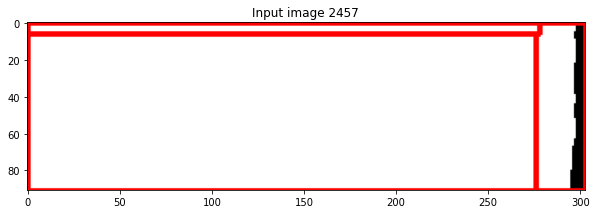

[2920, 2451, 3348, 2630, 0]
[] 66.8
rows [1151, 2457, 1454, 2548, 0] [2457, 2548] 167.0
[] 177.10000000000002
cols [1151, 2457, 1454, 2548, 0] [1151, 1454] 442.75


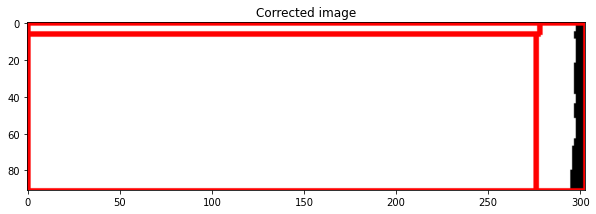

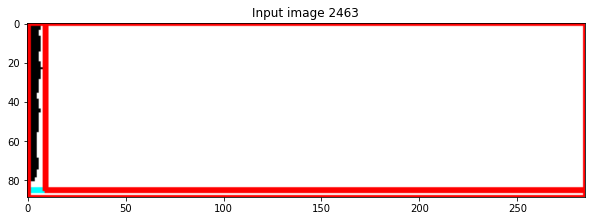

[1151, 2457, 1454, 2548, 0]
[2459.65, 2552.35] 66.8
rows [1142, 2463, 1427, 2552, 0] [2463, 2552.35] 167.0
[] 177.10000000000002
cols [1142, 2463, 1427, 2552, 0] [1142, 1427] 442.75


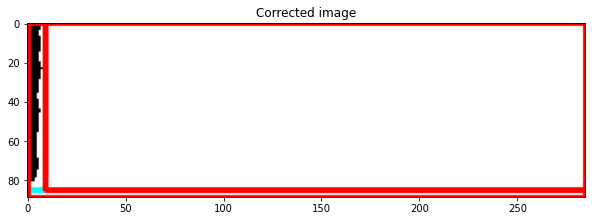

In [121]:
if len(exclude_cells)>0:
    segmented_cells = []
    error_cells = []
    for imagedraw in exclude_cells:#

        croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
        plt.rcParams["figure.figsize"] = (10,5)
        plt.imshow(croppedimage_full)
        plt.title(f'Input image {imagedraw[1]}')
        plt.show()
        idx, score = get_table_coord(cell, tables)
        avg_x, avg_y = average_cordinates[idx]

        x = abs(imagedraw[0]-imagedraw[2])
        y = abs(imagedraw[1]-imagedraw[3])

        if score > 0.5 and x>=avg_x/2 and y>=avg_y/2:
            possible_cells = segment_image(image, imagedraw[0:4]+[idx], masks[1],average_cordinates)
            segmented_cells += possible_cells
            for cell in possible_cells:
                croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
                plt.rcParams["figure.figsize"] = (10,5)
                plt.imshow(croppedimage_full)
                plt.title(f'Corrected image')
                plt.show()
        else:
            error_cells.append(imagedraw[0:4]+[idx])



In [122]:
error_corrected_cells, error_blank_cells, error_exclude_cells = classify_cells(segmented_cells, masks[1], average_cordinates)    

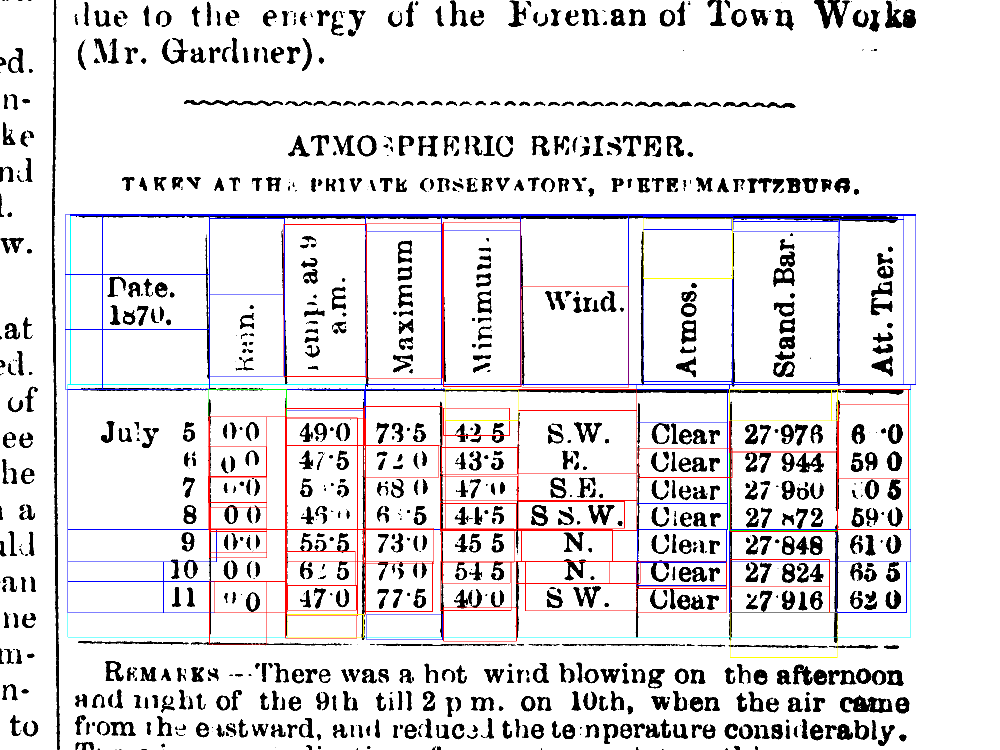

In [123]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in considered_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in error_corrected_cells:
    put_box(image,box,(0,color,0)) # Green

for box in error_exclude_cells:
    put_box(image,box,(color,0,0)) # Red

for box in error_blank_cells:
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
# im_pil.save(f"{filename}_temp_cell_classification_generation.jpg")
im_pil  

In [110]:
considered_cells += error_corrected_cells
not_ovellapped_correct_cells_pred, not_ovellapped_correct_cells_pred, not_ovellapped_error_cells_pred = generate_cells_from_corrected_cells(tables, considered_cells, masks[1])

In [ ]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in considered_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in not_ovellapped_correct_cells_pred:
    put_box(image,box,(0,color,0)) # Green

for box in error_exclude_cells:
    put_box(image,box,(color,0,0)) # Red

for box in error_blank_cells:
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
# im_pil.save(f"{filename}_temp_cell_classification_generation.jpg")
im_pil  

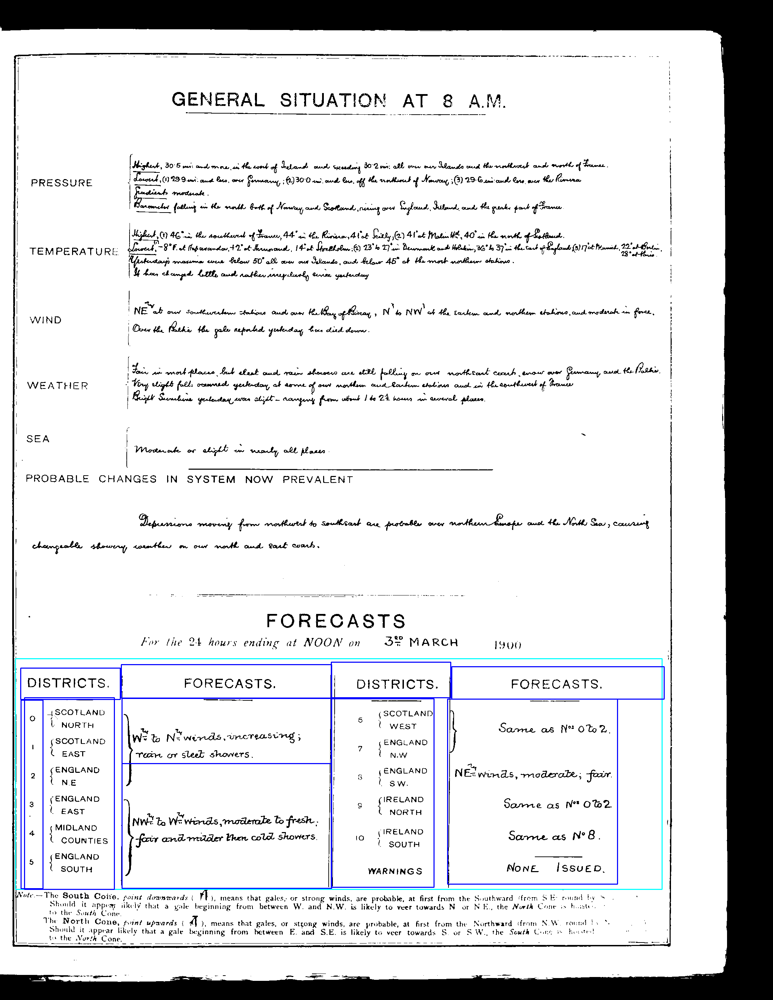

In [239]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)
color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 

for box in considered_cells:
    put_box(image,box,(0,0,color)) # blue


if len(segmented_cells)>0:
    error_correct_cells, error_blank_cells, exclude_cells = classify_cells(segmented_cells, masks[1], average_cordinates)  
    
    for box in error_correct_cells:
        put_box(image,box,(0,color,0)) # Green

    for box in exclude_cells:
        put_box(image,box,(color,0,0)) # Red

    for box in not_ovellapped_blank_cells_pred+error_blank_cells:   
        put_box(image,box,(color,color,0)) # Yellow

    # im_pil.save(f"{filename}_temp_cell_classification_overlapped_filtered.jpg")
    all_possible_cells = correct_cells+error_correct_cells+exclude_cells+not_ovellapped_blank_cells_pred+error_blank_cells

else:

    for box in not_ovellapped_blank_cells_pred:   
        put_box(image,box,(color,color,0)) # Yellow
    
    all_possible_cells = considered_cells + not_ovellapped_blank_cells_pred

im_pil = Image.fromarray(image)
im_pil  

In [240]:
# upto here

### Readjust the corrected cells

In [222]:
table_cells = get_x_y(tables, all_possible_cells)
cell_cordinates, average_cordinates = get_coordinates(table_cells,0.7)

In [223]:
cell_cordinates_new = []
for tid in cell_cordinates:
    new_col_cells = find_coordinates(tid[0], avg_x, 0.7)
    new_row_cells = find_coordinates(tid[1], avg_y, 0.7)
    cell_cordinates_new.append([new_col_cells,new_row_cells])

In [232]:
possible_cells, exclude_cells_pred = generate_cells(masks[1], tables, cell_cordinates_new, average_cordinates)
# correct_cells, blank_cells, exclude_cells = classify_cells(possible_cells, masks[1], average_cordinates)    


[[44, 1890, 62, 1905, 0],
 [44, 1905, 62, 2191, 0],
 [44, 2191, 62, 2542, 0],
 [44, 2542, 62, 2552, 0],
 [62, 1890, 337, 1905, 0],
 [62, 2542, 337, 2552, 0],
 [337, 1890, 951, 1905, 0],
 [337, 2542, 951, 2552, 0],
 [951, 1890, 1246, 1905, 0],
 [951, 2542, 1246, 2552, 0],
 [1246, 1890, 1773, 1905, 0],
 [1246, 2542, 1773, 2552, 0],
 [1773, 1890, 1901, 1905, 0],
 [1773, 1905, 1901, 2191, 0],
 [1773, 2191, 1901, 2542, 0],
 [1773, 2542, 1901, 2552, 0]]

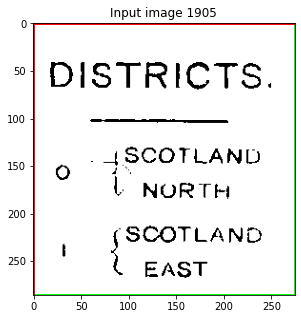

[1406, 2191, 1770, 2542, 0]
[2025.3833333333332] 84.93333333333334
rows [62, 1905, 337, 2191, 0] [1905, 2025.3833333333332, 2191] 212.33333333333334
[63.82142857142857, 332.17857142857144] 105.42857142857143
cols [62, 1905, 337, 2191, 0] [62, 332.17857142857144] 263.57142857142856


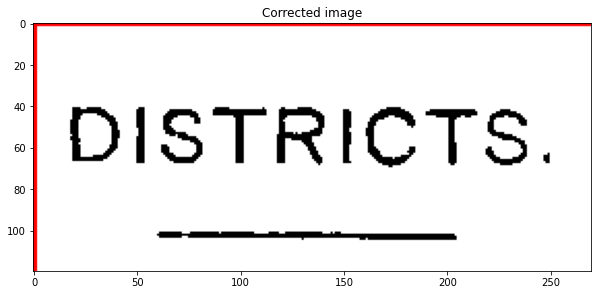

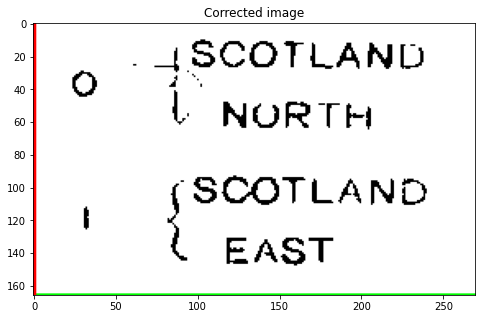

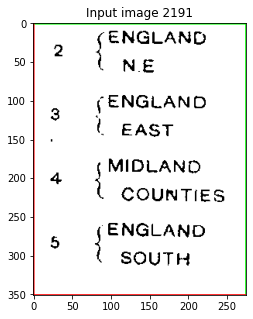

[62, 2025, 332, 2191, 0]
[2190.383333333333] 84.93333333333334
rows [62, 2191, 337, 2542, 0] [2191, 2542] 212.33333333333334
[128.82142857142856, 301.17857142857144] 105.42857142857143
cols [62, 2191, 337, 2542, 0] [62, 301.17857142857144] 263.57142857142856


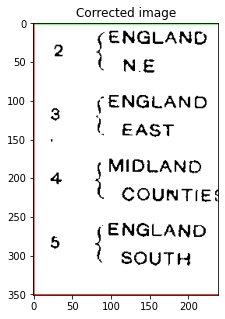

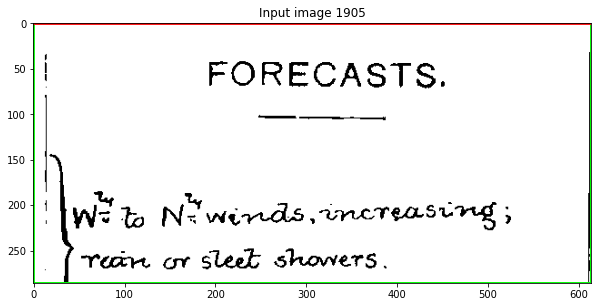

[62, 2191, 301, 2542, 0]
[1986.6166666666668] 84.93333333333334
rows [337, 1905, 951, 2191, 0] [1905, 2191] 212.33333333333334
[342.82142857142856] 105.42857142857143
cols [337, 1905, 951, 2191, 0] [337, 951] 263.57142857142856


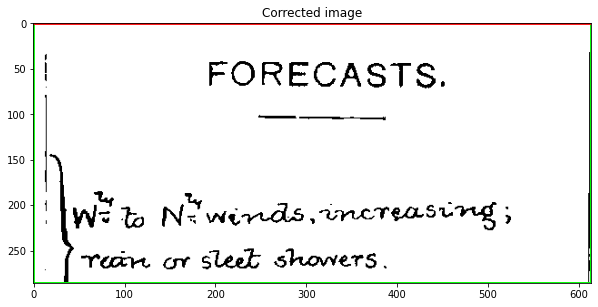

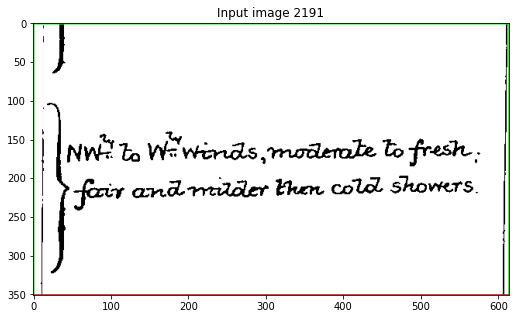

[337, 1905, 951, 2191, 0]
[] 84.93333333333334
rows [337, 2191, 951, 2542, 0] [2191, 2542] 212.33333333333334
[365.82142857142856, 921.1785714285714] 105.42857142857143
cols [337, 2191, 951, 2542, 0] [337, 921.1785714285714] 263.57142857142856


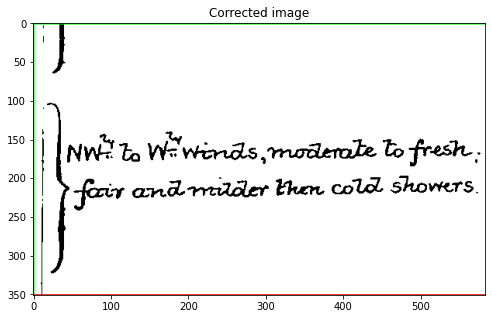

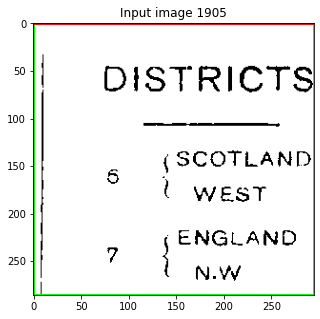

[337, 2191, 921, 2542, 0]
[] 84.93333333333334
rows [951, 1905, 1246, 2191, 0] [1905, 2191] 212.33333333333334
[] 105.42857142857143
cols [951, 1905, 1246, 2191, 0] [951, 1246] 263.57142857142856


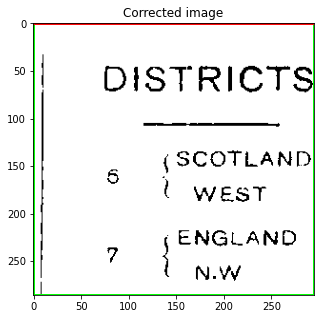

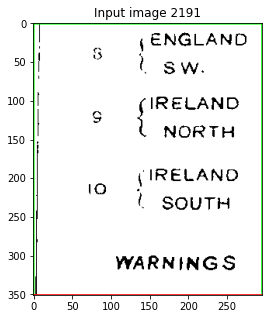

[951, 1905, 1246, 2191, 0]
[] 84.93333333333334
rows [951, 2191, 1246, 2542, 0] [2191, 2542] 212.33333333333334
[1069.8214285714287, 1230.1785714285716] 105.42857142857143
cols [951, 2191, 1246, 2542, 0] [951, 1069.8214285714287, 1230.1785714285716] 263.57142857142856


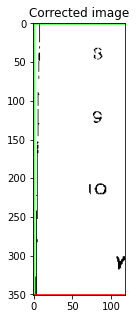

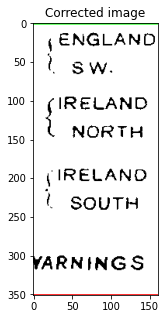

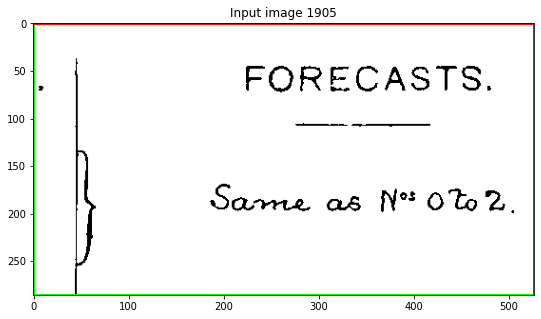

[1069, 2191, 1230, 2542, 0]
[1987.6166666666668] 84.93333333333334
rows [1246, 1905, 1773, 2191, 0] [1905, 2191] 212.33333333333334
[1272.1785714285713, 1438, 1767.1785714285716] 105.42857142857143
cols [1246, 1905, 1773, 2191, 0] [1246, 1438, 1767.1785714285716] 263.57142857142856


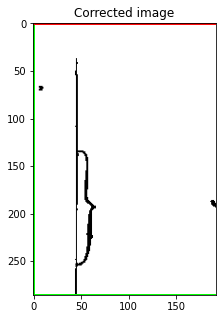

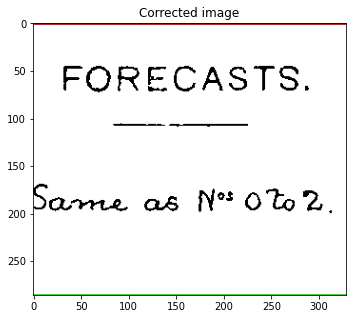

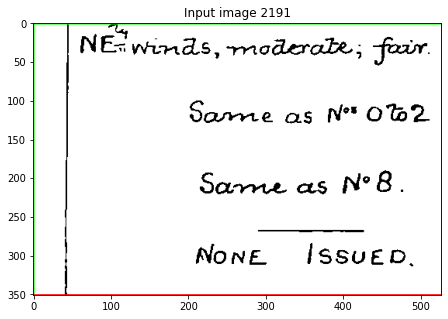

[1438, 1905, 1767, 2191, 0]
[] 84.93333333333334
rows [1246, 2191, 1773, 2542, 0] [2191, 2542] 212.33333333333334
[1291.8214285714287, 1406, 1770.1785714285716] 105.42857142857143
cols [1246, 2191, 1773, 2542, 0] [1246, 1406, 1770.1785714285716] 263.57142857142856


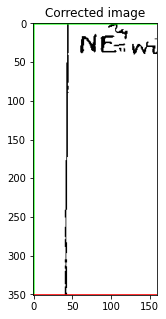

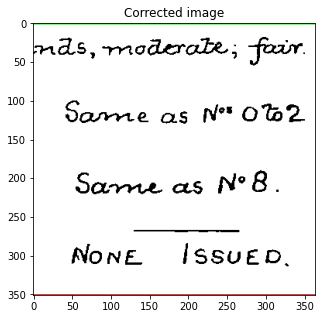

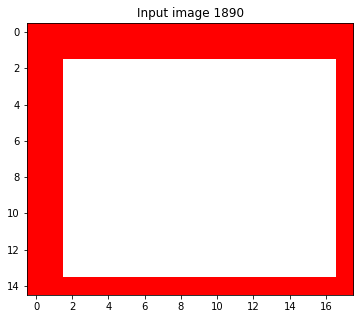

[1406, 2191, 1770, 2542, 0]


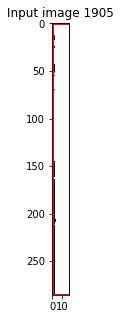

[1406, 2191, 1770, 2542, 0]


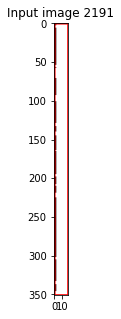

[1406, 2191, 1770, 2542, 0]


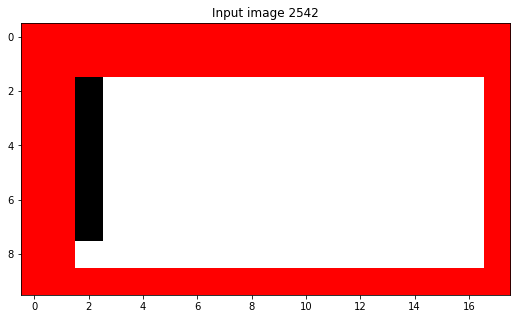

[1406, 2191, 1770, 2542, 0]


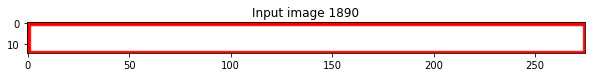

[1406, 2191, 1770, 2542, 0]


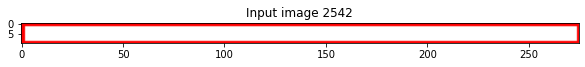

[1406, 2191, 1770, 2542, 0]


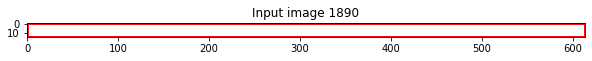

[1406, 2191, 1770, 2542, 0]


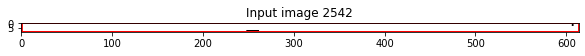

[1406, 2191, 1770, 2542, 0]


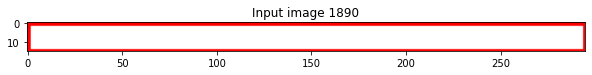

[1406, 2191, 1770, 2542, 0]


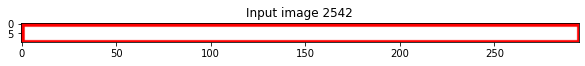

[1406, 2191, 1770, 2542, 0]


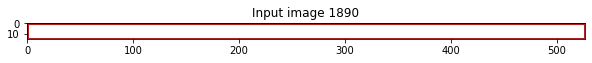

[1406, 2191, 1770, 2542, 0]


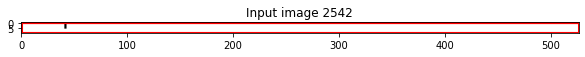

[1406, 2191, 1770, 2542, 0]


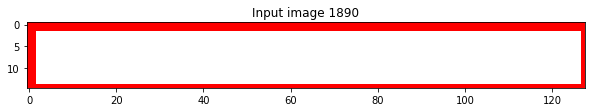

[1406, 2191, 1770, 2542, 0]


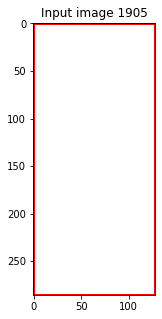

[1406, 2191, 1770, 2542, 0]


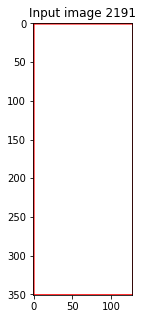

[1406, 2191, 1770, 2542, 0]


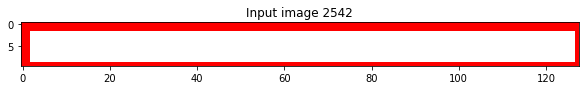

[1406, 2191, 1770, 2542, 0]


In [233]:
segmented_cells = []
error_cells = []
for imagedraw in possible_cells:#
    
    croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
    plt.rcParams["figure.figsize"] = (10,5)
    plt.imshow(croppedimage_full)
    plt.title(f'Input image {imagedraw[1]}')
    plt.show()
    idx, score = get_table_coord(cell, tables)
    avg_x, avg_y = average_cordinates[idx]
    
    x = abs(imagedraw[0]-imagedraw[2])
    y = abs(imagedraw[1]-imagedraw[3])
    
    if score > 0.5 and x>=avg_x/2 and y>=avg_y/2:
        possible_cells = segment_image(image, imagedraw[0:4]+[idx], masks[1],average_cordinates)
        segmented_cells += possible_cells
        for cell in possible_cells:
            croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
            plt.rcParams["figure.figsize"] = (10,5)
            plt.imshow(croppedimage_full)
            plt.title(f'Corrected image')
            plt.show()
    else:
        error_cells.append(imagedraw[0:4]+[idx])
            

for imagedraw in exclude_cells_pred:#
    
    croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
    plt.rcParams["figure.figsize"] = (10,5)
    plt.imshow(croppedimage_full)
    plt.title(f'Input image {imagedraw[1]}')
    plt.show()
    idx, score = get_table_coord(cell, tables)
    avg_x, avg_y = average_cordinates[idx]
    
    x = abs(imagedraw[0]-imagedraw[2])
    y = abs(imagedraw[1]-imagedraw[3])
    
    if score > 0.5 and x>=avg_x/2 and y>=avg_y/2:
        possible_cells = segment_image(image, imagedraw[0:4]+[idx], masks[1],average_cordinates)
        segmented_cells += possible_cells
        for cell in possible_cells:
            croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
            plt.rcParams["figure.figsize"] = (10,5)
            plt.imshow(croppedimage_full)
            plt.title(f'Corrected image')
            plt.show()
    else:
        error_cells.append(imagedraw[0:4]+[idx])

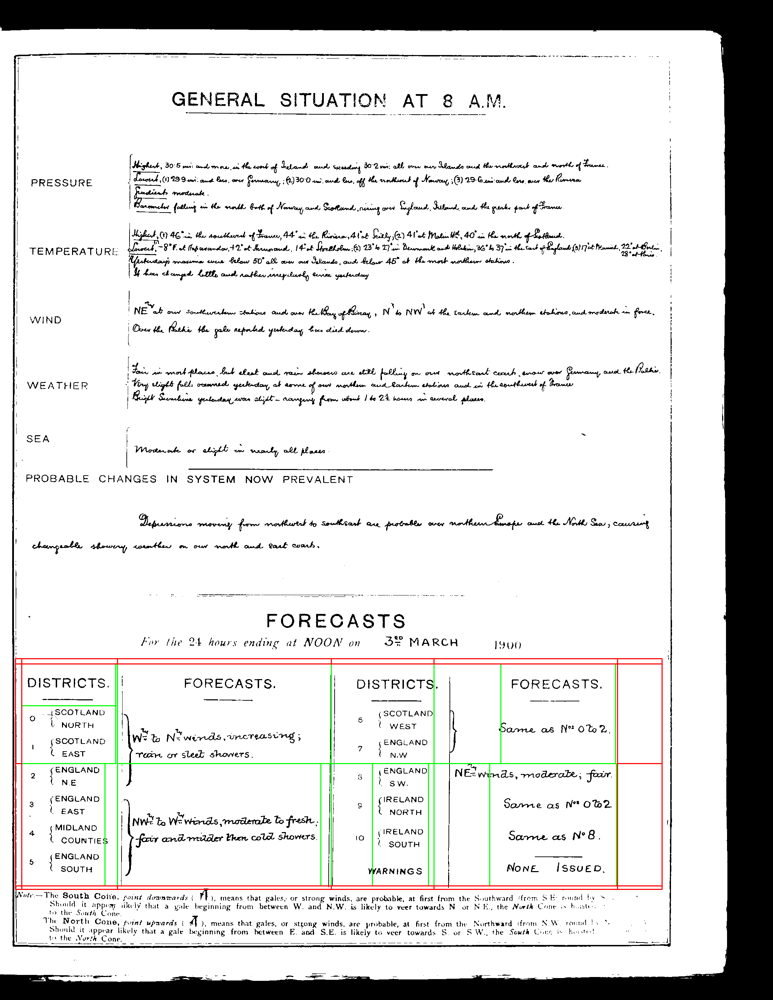

In [234]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in segmented_cells:
    put_box(image,box,(0,color,0)) # Green
    
for box in error_cells:
    put_box(image,box,(color,0,0)) # Red

im_pil = Image.fromarray(image)
# im_pil.save(f"{filename}_temp_cell_classification_generation.jpg")
im_pil  

### Correct single cell error

In [112]:
# check boundary
def correct_boundary_single_cell(imagedraw, mask, table,average_cordinate, pc):
    cell = imagedraw[0:4]
    x_avg, y_avg = average_cordinate
    mask_area = mask[cell[1]:cell[3],cell[0]:cell[2]]
    
    x0,y0,x1,y1 = list(map(int, table))
    new_cell = list(cell)
    changed = [0]*4
        
    # Fix y-axis boundary
    count = 0
    lower = 0
    xc0,yc0,xc1,yc1 = list(map(int, cell))
    for idx, mask_cell in enumerate(mask_area):  # row by row check ascending order
    #     print(len(mask_cell),len(mask_area))
        if not any(mask_cell): # not text region
            count+=1

        elif lower == 0 and count>0:  # check y0
            if count>5:
                new_cell[1]= new_cell[1]+5
            else:
                new_cell[1]= new_cell[1]+count
            changed[1] = 1
            break

        elif float(sum(mask_cell))/len(mask_cell)< 0.2:
            count+=1
            
        elif count == 0:
            break

    count = 0
    lower = 0
    for idx in reversed(range(len(mask_area))):  # row by row check descending order
        mask_cell = mask_area[idx]
    #     print(len(mask_cell),len(mask_area))
        if not any(mask_cell): # not text region
            count+=1

        elif lower == 0 and count>0:  # check y0
            if count>5:
                new_cell[3]= new_cell[3]-5
            else:
                new_cell[3]= new_cell[3]-count
            changed[3] = 1
            break

        elif float(sum(mask_cell))/len(mask_cell)< 0.2:
            count+=1
            
        elif count == 0:
            break

    # Fix x-axis boundary
    count = 0
    lower = 0

    for col_check in range(len(mask_area[0])): # column by column check x0 to xn
        mask_cell = mask_area[:,col_check]
    #     print(len(mask_cell),len(mask_area[0]))
        if not any(mask_cell): # not text region
            count+=1

        elif lower == 0 and count>0:  # check x0
            if count>5:
                new_cell[0]= new_cell[0]+5
            else:
                new_cell[0]= new_cell[0]+count
            changed[0] = 1
            break

        elif float(sum(mask_cell))/len(mask_cell)< 0.2:
            count+=1
            
        elif count == 0:
            break

    count = 0
    lower = 0

    for col_check in reversed(range(len(mask_area[0]))): # column by column check reverse xn to x0
        mask_cell = mask_area[:,col_check]
    #     print(len(mask_cell),len(mask_area[0]))
        if not any(mask_cell): # not text region
            count+=1

        elif lower == 0 and count>0:  # check x0
            if count>5:
                new_cell[2]= new_cell[2]-5
            else:
                new_cell[2]= new_cell[2]-count
            changed[2] = 1
            break

        elif float(sum(mask_cell))/len(mask_cell)< 0.2:
            count+=1

        elif count == 0:
            break

    # if cell is in table border area
    if abs(x0-cell[0])<x_avg*pc:
        new_cell[0] = x0
        changed[0] = 5
    if abs(x1-cell[2])<x_avg*pc:
        new_cell[2] = x1
        changed[2] = 5
    if abs(y0-cell[1])<y_avg*pc:
        new_cell[1] = y0
        changed[1] = 5
    if abs(y1-cell[3])<y_avg*pc:
        new_cell[3] = y1
        changed[3] = 5

    return new_cell, changed

In [114]:
def sort_coord(new_excluded_cells_pred):
    x = torch.IntTensor(new_excluded_cells_pred)
    value, index = x[:,1].sort()

    # value,index
    y_cords = {}
    for idx, i in zip(index,value):
        idx, i = (int(idx),int(i))

        if i not in y_cords:
            y_cords[i]=[]
        y_cords[i].append(idx)
        
    y_cords_new = {}
    for i in y_cords:
        mat = [new_excluded_cells_pred[idx] for idx in y_cords[i]]
        mat = torch.IntTensor(mat)
        _, index = mat[:,0].sort()
    #     print(_, index, mat)

        mat_new = []

        for idx in index:
    #         print(mat[int(idx)])
            cell =  mat[int(idx)].tolist()
            table_idx, score = get_table_coord(cell, tables)
            if score > 0.5:
                mat_new.append(cell[0:4]+[table_idx])  #cells and its table index
        y_cords_new[i]=mat_new
    return y_cords_new

In [115]:
def classify_error_cells(new_excluded_cells_pred, tables, average_cordinates,pc):
    y_cords = sort_coord(new_excluded_cells_pred)

    new_corrected_excluded_cells = []
    not_corrected_excluded_cells = []
    yidx = list(y_cords.keys())
#     print(yidx)
    for yid, y_idx in enumerate(y_cords):
        yneighbours_idx = []
        if yid>0 and yid+1 < len(y_cords):
            yneighbours_idx = [yidx[yid-1],yidx[yid+1]]
        elif yid+1 < len(y_cords):
            yneighbours_idx = [yidx[yid+1]]

    #     print('---',yid, '--',len(y_cords[y_idx]), '--', y_idx, yneighbours_idx,'####')
        xneighbours_idx = []

        for xid, imagedraw in enumerate(y_cords[y_idx]):

            if xid>0 and xid+1 < len(y_cords[y_idx]):
                xneighbours_idx = [yneighbours_idx, [y_cords[y_idx][xid-1],y_cords[y_idx][xid+1]]]

            elif xid+1 < len(y_cords[y_idx]):
                xneighbours_idx = [yneighbours_idx,[y_cords[y_idx][xid+1]]]
            else:
                xneighbours_idx = [yneighbours_idx,[]]

    #         print('x---',xid,'total cells: #',len(y_cords[y_idx]),xneighbours_idx,'###')

            table_idx = imagedraw[-1]

            table = tables[table_idx]
            new_cell, changed = correct_boundary_single_cell(imagedraw, masks[1], table, average_cordinates[table_idx], 1-pc)
            
            x_avg, y_avg = average_cordinates[table_idx]

            if abs(new_cell[0]-new_cell[2])<x_avg*pc or abs(new_cell[1]-new_cell[3])<y_avg*pc:
                not_corrected_excluded_cells.append(new_cell+[0]+[xneighbours_idx]+[changed])
            elif sum(changed)==4 and 5 not in changed:
                new_corrected_excluded_cells.append(new_cell+[1]+[xneighbours_idx]+[changed])
            elif sum(changed)> 5 and 0 not in changed:
                new_corrected_excluded_cells.append(new_cell+[1]+[xneighbours_idx]+[changed])
            else:
                not_corrected_excluded_cells.append(new_cell+[0]+[xneighbours_idx]+[changed])
    
    return new_corrected_excluded_cells, not_corrected_excluded_cells

In [116]:
new_corrected_excluded_cells, not_corrected_excluded_cells = classify_error_cells(not_ovellapped_exclude_cells_pred, tables, average_cordinates,0.7)

[1156, 347, 1269, 457, 0]
[1269, 347, 1385, 457, 0]
[1385, 347, 1496, 457, 0]
[1496, 347, 1612, 457, 0]
[1612, 347, 1890, 457, 0]
[1890, 347, 2003, 457, 0]
[2003, 347, 2116, 457, 0]
[2228, 347, 2341, 457, 0]
[2341, 347, 2462, 457, 0]
[2462, 347, 2598, 457, 0]
[2598, 347, 2618, 457, 0]
[2820, 347, 2926, 457, 0]
[2926, 347, 3041, 457, 0]
[3041, 347, 3137, 457, 0]
[3137, 347, 3164, 457, 0]
[3164, 347, 3196, 457, 0]
[3196, 347, 3392, 457, 0]
[3392, 347, 3525, 457, 0]
[3525, 347, 3658, 457, 0]
[3658, 347, 3807, 457, 0]
[3807, 347, 3936, 457, 0]
[1039, 457, 1156, 755, 0]
[1156, 457, 1269, 755, 0]
[1269, 457, 1385, 755, 0]
[1385, 457, 1496, 755, 0]
[1496, 457, 1612, 755, 0]
[1612, 457, 1890, 755, 0]
[1890, 457, 2003, 755, 0]
[2003, 457, 2116, 755, 0]
[2116, 457, 2228, 755, 0]
[2228, 457, 2341, 755, 0]
[2341, 457, 2462, 755, 0]
[2462, 457, 2598, 755, 0]
[2598, 457, 2618, 755, 0]
[2820, 457, 2926, 755, 0]
[2926, 457, 3041, 755, 0]
[3041, 457, 3137, 755, 0]
[3137, 457, 3164, 755, 0]
[3164, 457, 

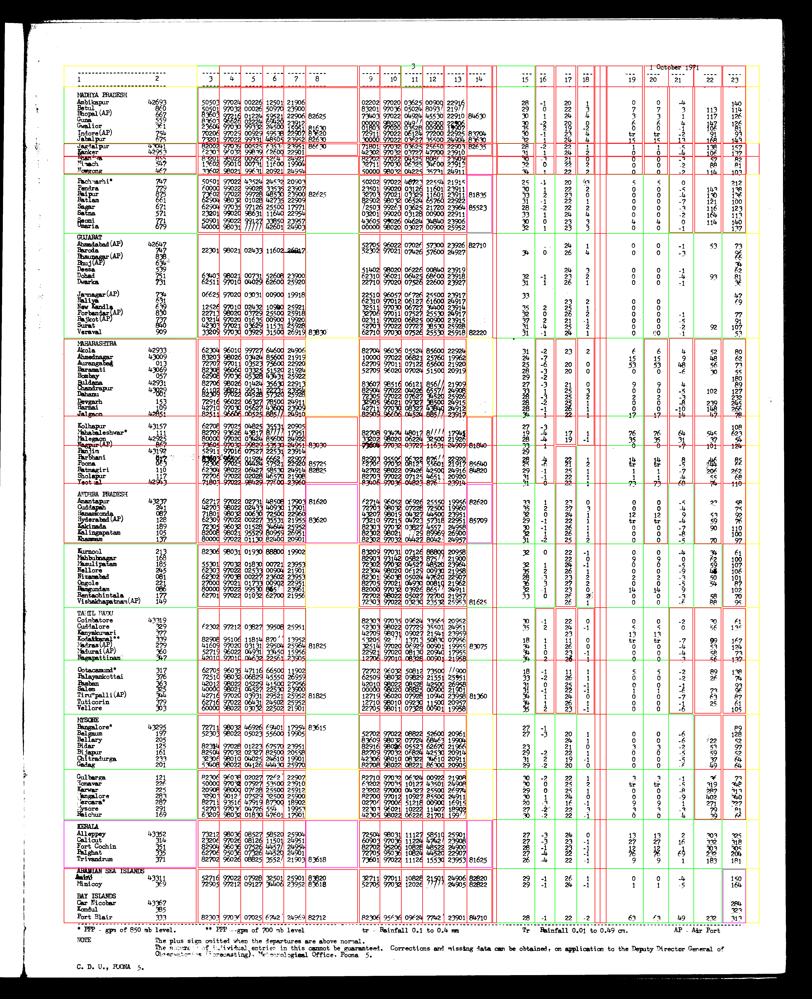

In [118]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in correct_cells:
    put_box(image,box,(0,color,0)) # Green

for box in not_corrected_excluded_cells:
    put_box(image,box,(color,0,0)) # Red

for box in new_corrected_excluded_cells:
#     print(box)
    put_box(image,box,(color,0,color))  # pink
    
for box in not_ovellapped_blank_cells_pred:   
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
im_pil.save(f"{filename}_temp_cell_classification_single_cell_correction.jpg")
im_pil  

### Generate cells from valid cells

In [119]:
all_valid_cells = ori_correct_cells+correct_cells+not_ovellapped_blank_cells_pred+new_corrected_excluded_cells

In [120]:
table_cells = get_x_y(tables, all_valid_cells)
cell_cordinates, average_cordinates = get_coordinates(table_cells,0.7)

In [150]:
possible_cells, exclude_cells_pred = generate_cells(masks[1], tables, cell_cordinates, average_cordinates)
correct_cells, blank_cells, exclude_cells = classify_cells(possible_cells, masks[1], average_cordinates)  

In [151]:
new_corrected_excluded_cells, not_corrected_excluded_cells = classify_error_cells(exclude_cells, tables, average_cordinates,0.7)
corrected_cells, corrected_excluded_cells = classify_error_cells(correct_cells, tables, average_cordinates,0.7)

[1036, 347, 1612, 755, 0]
[1612, 347, 1887, 755, 0]
[1887, 347, 2116, 755, 0]
[2116, 347, 2464, 755, 0]
[2464, 347, 2598, 755, 0]
[3393, 347, 3526, 755, 0]
[3526, 347, 3658, 755, 0]
[1887, 755, 2116, 1228, 0]
[2116, 755, 2464, 1228, 0]
[2464, 755, 2598, 1228, 0]
[1887, 1228, 2116, 1782, 0]
[2116, 1228, 2464, 1782, 0]
[337, 1782, 1036, 2193, 0]
[1036, 1782, 1612, 2193, 0]
[1887, 1782, 2116, 2193, 0]
[2116, 1782, 2464, 2193, 0]
[2820, 1782, 3041, 2193, 0]
[3393, 1782, 3526, 2193, 0]
[3526, 1782, 3658, 2193, 0]
[3658, 1782, 3808, 2193, 0]
[3808, 1782, 3932, 2193, 0]
[337, 2193, 1036, 2550, 0]
[1036, 2193, 1612, 2550, 0]
[1612, 2193, 1887, 2550, 0]
[1887, 2193, 2116, 2550, 0]
[2116, 2193, 2464, 2550, 0]
[2464, 2193, 2598, 2550, 0]
[2820, 2193, 3041, 2550, 0]
[3393, 2193, 3526, 2550, 0]
[3526, 2193, 3658, 2550, 0]
[3658, 2193, 3808, 2550, 0]
[3808, 2193, 3932, 2550, 0]
[337, 2550, 1036, 2866, 0]
[1036, 2550, 1612, 2866, 0]
[1612, 2550, 1887, 2866, 0]
[1887, 2550, 2116, 2866, 0]
[2116, 2550,

In [160]:
corrected_cells = find_overlapped_cell(correct_cells, corrected_cells)
exclude_cells_cor = find_overlapped_cell(exclude_cells, corrected_excluded_cells)

In [161]:
exclude_cells_cor

[[3046,
  347,
  3157,
  754,
  0,
  [[755], [[2820, 347, 3041, 755, 0], [3162, 347, 3393, 755, 0]]],
  [1, 5, 1, 1]],
 [3811, 347, 3927, 755, 0, [[755], []], [1, 5, 1, 0]],
 [3046,
  756,
  3157,
  1223,
  0,
  [[347, 1228], [[2820, 755, 3041, 1228, 0], [3162, 755, 3393, 1228, 0]]],
  [1, 1, 1, 1]],
 [3531,
  756,
  3653,
  1223,
  0,
  [[347, 1228], [[3393, 755, 3526, 1228, 0], [3658, 755, 3808, 1228, 0]]],
  [1, 1, 1, 1]],
 [3813, 756, 3927, 1223, 0, [[347, 1228], []], [1, 1, 1, 1]],
 [3046,
  1233,
  3157,
  1781,
  0,
  [[755, 1782], [[2820, 1228, 3041, 1782, 0], [3162, 1228, 3393, 1782, 0]]],
  [1, 1, 1, 1]],
 [3531,
  1231,
  3653,
  1781,
  0,
  [[755, 1782], [[3393, 1228, 3526, 1782, 0], [3658, 1228, 3808, 1782, 0]]],
  [1, 1, 1, 1]],
 [3813, 1233, 3927, 1777, 0, [[755, 1782], []], [1, 1, 1, 1]],
 [3046,
  1783,
  3157,
  2192,
  0,
  [[1228, 2193], [[2598, 1782, 2820, 2193, 0], [3162, 1782, 3393, 2193, 0]]],
  [1, 1, 1, 1]],
 [3046,
  2194,
  3157,
  2549,
  0,
  [[1782, 2550

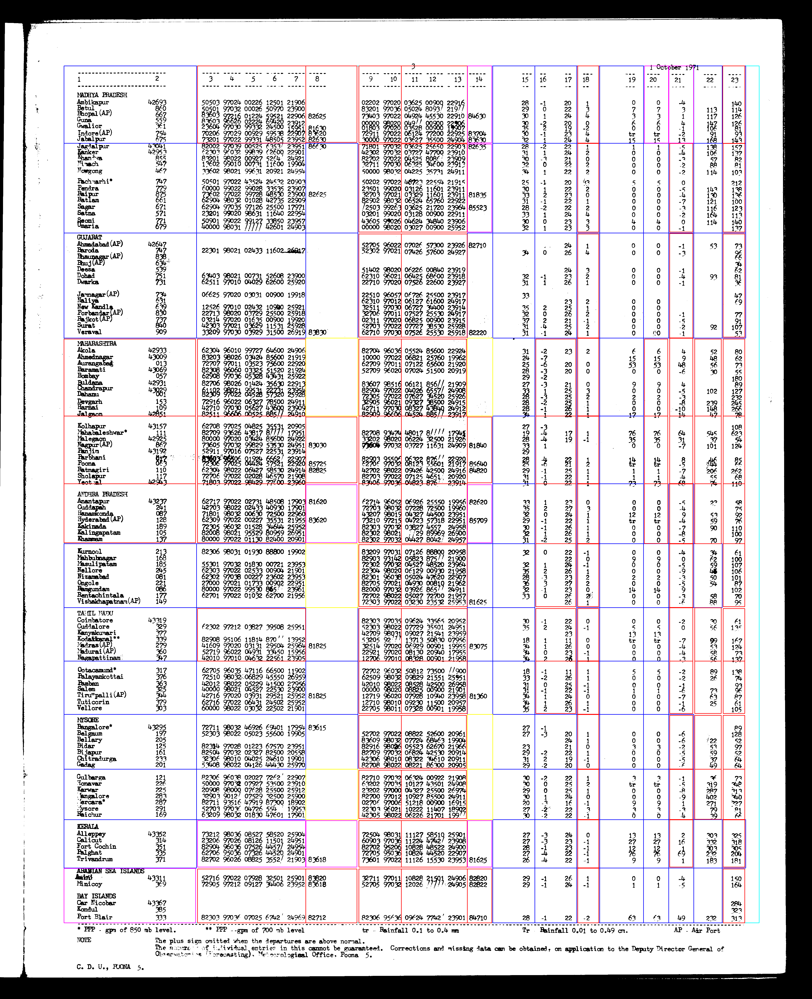

In [162]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in correct_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in corrected_cells:
    put_box(image,box,(0,color,0)) # Green

for box in exclude_cells+exclude_cells_cor:
    put_box(image,box,(color,0,0)) # Red
    
for box in new_corrected_excluded_cells:
#     print(box)
    put_box(image,box,(color,0,color))  # pink
    
for box in blank_cells:   
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
im_pil.save(f"{filename}_temp_cell_generation_from_valid_cells.jpg")
im_pil  

### Correct cell boundary considering multiple cells

In [135]:
def get_neighbouring_coord(cells, tables):
    new_excluded_cells_pred = []
    
    for cell in cells:
        new_excluded_cells_pred.append(cell[0:5])
    
    x = torch.IntTensor(new_excluded_cells_pred)
    value, index = x[:,1].sort()

    # value,index
    y_cords = {}
    for idx, i in zip(index,value):
        idx, i = (int(idx),int(i))

        if i not in y_cords:
            y_cords[i]=[]
        y_cords[i].append(idx)
        
    y_cords_new = {}
    for i in y_cords:
        mat = [new_excluded_cells_pred[idx] for idx in y_cords[i]]
        mat = torch.IntTensor(mat)
        _, index = mat[:,0].sort()
    #     print(_, index, mat)

        mat_new = []

        for idx in index:
    #         print(mat[int(idx)])
            cell =  mat[int(idx)].tolist()
            table_idx, score = get_table_coord(cell, tables)
            if score > 0.5:
                mat_new.append(cell[0:4]+[table_idx])  #cells and its table index
        y_cords_new[i]=mat_new
    return y_cords_new

In [136]:
# sort x and y coordinates of excluded_cells_pred
def get_x_y_neighbour_cells(new_excluded_cells_pred, tables, average_cordinates):
    y_cords = get_neighbouring_coord(new_excluded_cells_pred, tables)
    
    neighbouring_cells = {}
    yidx = list(y_cords.keys())
    
    for yid, y_idx in enumerate(y_cords):
        yneighbours_idx = []
        
        ## can be remove for later filtering
        tid = y_cords[y_idx][0][4]
        avg_x, avg_y = average_cordinates[tid]
        
        yneighbours_idx = []
        if yid>0 and yid+1 < len(y_cords):
            if abs(yidx[yid-1]-y_idx)<avg_y:           
                yneighbours_idx.append(yidx[yid-1]) #= [yidx[yid-1],yidx[yid+1]]
            if abs(yidx[yid+1]-y_idx)<avg_y:           
                yneighbours_idx.append(yidx[yid+1]) 

        elif yid+1 < len(y_cords):
            if abs(yidx[yid+1]-y_idx)<avg_y:           
                yneighbours_idx.append(yidx[yid+1]) #first cell neighbour 
        ### remove if condition if filtering is not required

        xneighbours_idx = []
        if len(y_cords[y_idx])>=1:
            xneighbours_idx = [yneighbours_idx, y_cords[y_idx]]
        else:
            xneighbours_idx = [yneighbours_idx,[]]  # no neighbours

        neighbouring_cells[y_idx]=xneighbours_idx
    
    return neighbouring_cells, y_cords
            

In [163]:
neighbouring_cells, y_cords = get_x_y_neighbour_cells(exclude_cells+exclude_cells_cor, tables, average_cordinates)

[1041, 347, 1612, 754, 0]
[1612, 347, 1882, 750, 0]
[1892, 347, 2116, 751, 0]
[2116, 347, 2464, 754, 0]
[3046, 347, 3157, 754, 0]
[3811, 347, 3927, 755, 0]
[3046, 756, 3157, 1223, 0]
[3531, 756, 3653, 1223, 0]
[3813, 756, 3927, 1223, 0]
[2116, 758, 2463, 1223, 0]
[1892, 759, 2116, 1223, 0]
[3531, 1231, 3653, 1781, 0]
[1892, 1233, 2116, 1777, 0]
[2116, 1233, 2463, 1777, 0]
[3046, 1233, 3157, 1781, 0]
[3813, 1233, 3927, 1777, 0]
[3046, 1783, 3157, 2192, 0]
[3531, 1783, 3653, 2193, 0]
[337, 1787, 1031, 2193, 0]
[1041, 1787, 1611, 2193, 0]
[1892, 1787, 2116, 2193, 0]
[2116, 1787, 2459, 2193, 0]
[2825, 1787, 3036, 2193, 0]
[3398, 1787, 3521, 2193, 0]
[3663, 1787, 3803, 2193, 0]
[3813, 1787, 3927, 2193, 0]
[337, 2193, 1031, 2550, 0]
[1041, 2193, 1612, 2550, 0]
[1892, 2193, 2116, 2550, 0]
[2116, 2193, 2464, 2550, 0]
[2825, 2193, 3036, 2550, 0]
[3398, 2193, 3521, 2550, 0]
[3531, 2193, 3653, 2549, 0]
[3663, 2193, 3803, 2550, 0]
[3813, 2193, 3927, 2550, 0]
[3046, 2194, 3157, 2549, 0]
[1612, 2198

In [164]:
x_y_neighbouring_cells_dict = {}
for yid in neighbouring_cells:
    cells = neighbouring_cells[yid]
    
    y_neighbours = cells[0]
    x_neighbours = cells[1]
    
    tid =x_neighbours[0][4]
    
    avg_x, avg_y = average_cordinates[tid]
    
    # print(yid,y_neighbours,x_neighbours,tid, average_cordinates[tid])
    
    # find x_neighbours
    ncells = []
    imagedraw = []
    next_cell_begin = True
    starting_cell = []
    
    for xid, xcell in enumerate(x_neighbours):    

        # Either split the cell or merge to begining cell
        if next_cell_begin:
            starting_cell = list(xcell)
        else:
            starting_cell[2] = xcell[2]
        
        # check next cell distance
        if (xid+1)<len(x_neighbours):
            next_cell = x_neighbours[xid+1]
            if abs(next_cell[0]-xcell[2])<(avg_x/3):
                next_cell_begin = False
            else:
                ncells.append(starting_cell)
                starting_cell = []
                next_cell_begin = True
        elif len(x_neighbours)==1:
            ncells.append(starting_cell)
            starting_cell = []
    
    if len(starting_cell)>0:
        ncells.append(starting_cell)
                
#     print(x_neighbours,'---',ncells)   
    x_y_neighbouring_cells_dict[yid] = (y_neighbours, ncells)
    
x_y_neighbouring_cells_dict

{347: ([],
  [[1041, 347, 2464, 754, 0],
   [3046, 347, 3157, 754, 0],
   [3811, 347, 3927, 755, 0]]),
 756: ([758],
  [[3046, 756, 3157, 1223, 0],
   [3531, 756, 3653, 1223, 0],
   [3813, 756, 3927, 1223, 0]]),
 758: ([756, 759], [[2116, 758, 2463, 1223, 0]]),
 759: ([758], [[1892, 759, 2116, 1223, 0]]),
 1231: ([1233], [[3531, 1231, 3653, 1781, 0]]),
 1233: ([1231],
  [[1892, 1233, 2463, 1777, 0],
   [3046, 1233, 3157, 1781, 0],
   [3813, 1233, 3927, 1777, 0]]),
 1783: ([1787], [[3046, 1783, 3157, 2192, 0], [3531, 1783, 3653, 2193, 0]]),
 1787: ([1783],
  [[337, 1787, 1611, 2193, 0],
   [1892, 1787, 2459, 2193, 0],
   [2825, 1787, 3036, 2193, 0],
   [3398, 1787, 3521, 2193, 0],
   [3663, 1787, 3927, 2193, 0]]),
 2193: ([2194],
  [[337, 2193, 1612, 2550, 0],
   [1892, 2193, 2464, 2550, 0],
   [2825, 2193, 3036, 2550, 0],
   [3398, 2193, 3927, 2550, 0]]),
 2194: ([2193, 2198], [[3046, 2194, 3157, 2549, 0]]),
 2198: ([2194], [[1612, 2198, 1882, 2545, 0], [2464, 2198, 2593, 2545, 0]]),
 

In [165]:
yids = list(x_y_neighbouring_cells_dict.keys())
count = 0
y_neighbours = {}
cur_list = []

for i, j in zip(yids[:-1],yids[1:]):
    if count == 0:  # First index
        cur_list.append(i)        
    if (j-i) < avg_y:
        cur_list.append(j)
    else:
        y_neighbours[cur_list[0]] = cur_list
        cur_list = [j]
    count+=1
    
if cur_list[0] not in y_neighbours:
    y_neighbours[cur_list[0]] = cur_list

y_neighbours_new = {}
for yid in y_neighbours:
    for yidn in y_neighbours[yid]:
        y_neighbours_new[yidn] = y_neighbours[yid]
#         if yidn not in y_neighbours:
#             print(y_neighbours[yid])
    
print(y_neighbours_new)

{347: [347], 756: [756, 758, 759], 758: [756, 758, 759], 759: [756, 758, 759], 1231: [1231, 1233], 1233: [1231, 1233], 1783: [1783, 1787], 1787: [1783, 1787], 2193: [2193, 2194, 2198], 2194: [2193, 2194, 2198], 2198: [2193, 2194, 2198], 2550: [2550, 2551], 2551: [2550, 2551], 2866: [2866, 2867, 2871], 2867: [2866, 2867, 2871], 2871: [2866, 2867, 2871], 3204: [3204, 3208], 3208: [3204, 3208], 3485: [3485, 3486], 3486: [3485, 3486], 3767: [3767, 3771], 3771: [3767, 3771], 4055: [4055, 4056, 4060], 4056: [4055, 4056, 4060], 4060: [4055, 4056, 4060], 4322: [4322, 4326], 4326: [4322, 4326], 4577: [4577, 4581], 4581: [4577, 4581]}


In [166]:
def correct_boundary_neighbour(image, cell, tables, step_x, step_y):
    croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]  
    plt.rcParams["figure.figsize"] = (10,5)
    plt.imshow(croppedimage_full)
    plt.title(f'Input image')
    plt.show()
    
    anchor = list(cell)
    notfound = True
    count = 0 
    step_x0 = 0 
    step_x1 = 0
    step_y0 = 0
    step_y1 = 0
    changed = [1,1,1,1]
    
    while notfound:
        
        if anchor[0]<anchor[2] and anchor[1]< anchor[3]:
            new_corrected, not_corrected = classify_error_cells([anchor], tables, average_cordinates,0.7) # correct single error cell or declare error
        else:
            return []
#         print(anchor, new_corrected, not_corrected)
        if len(new_corrected)>0:
            count+=1
            
            anchor[0]+=step_x0
            anchor[1]+=step_y0
            anchor[2]+=step_x1
            anchor[3]+=step_y1
            
            if count>0:
                notfound = False
        elif len(not_corrected)>0:
            
            changed = not_corrected[0][6]   
            if 0 not in changed: 
                notfound = False
            else:
                if changed[0]==0:
                    step_x0+=step_x
                    anchor[0]+=step_x0
                if changed[1]==0:
                    step_y0+=step_y
                    anchor[1]+=step_y0
                if changed[2]==0:
                    step_x1+=step_x
                    anchor[2]+=step_x1
                if changed[3]==0:
                    step_y1+=step_y
                    anchor[3]+=step_y1           
    
    cur_corrected = list(anchor)
    return cur_corrected

def find_proper_cell(cell, avg_x, avg_y):
    if abs(cell[0]-cell[2])>(avg_x*2)/3 and abs(cell[1]-cell[3])>(avg_y*2)/3 :
        return True
    else:
        return False
    
def correct_boundary_multiple_cell(image, cell, n_cell, above, average_cordinates, tables):
    
    tid = cell[4]
    avg_x, avg_y = average_cordinates[tid]
    tab_boundary = list(map(int, tables[tid]))
    
    step_x = int(avg_x*0.025)
    step_y = int(avg_y*0.025)
    
    if find_proper_cell(cell, avg_x, avg_y):
        cur_corrected = correct_boundary_neighbour(image, cell, tables, step_x, step_y)
        if len(cur_corrected) == 0:
            cur_corrected = cell
    else:
        cur_corrected = cell
#     croppedimage_full=image[int(cur_corrected[1]):int(cur_corrected[3]),int(cur_corrected[0]):int(cur_corrected[2])]  
#     plt.rcParams["figure.figsize"] = (10,5)
#     plt.imshow(croppedimage_full)
#     plt.title(f'try cell images')
#     plt.show()

    anchor = list(n_cell) ## neighbour update check
    if len(cur_corrected)>1:
        if above: # check cell by crossing boundary of above cell i.e. decrease y0 and y1
            anchor[3] = cur_corrected[1]
            anchor[0] = cur_corrected[0]

        else: # increase y0 and y1 by avg_y*0.05 (5%) cell size
            anchor[1] = cur_corrected[3]
            anchor[0] = cur_corrected[0]

    if find_proper_cell(anchor, avg_x, avg_y):
        n_cur_corrected = correct_boundary_neighbour(image, anchor, tables, step_x, step_y)
        if len(n_cur_corrected) == 0:
            n_cur_corrected = anchor
    else:
        n_cur_corrected = anchor
#     croppedimage_full=image[int(n_cur_corrected[1]):int(n_cur_corrected[3]),int(n_cur_corrected[0]):int(n_cur_corrected[2])]  
#     plt.rcParams["figure.figsize"] = (10,5)
#     plt.imshow(croppedimage_full)
#     plt.title(f'try cell images')
#     plt.show()
    
    return cur_corrected, n_cur_corrected

In [167]:
# combine x and y neighbours v2
error_corrected_cells = []
not_corrected_cells = []
for yid in x_y_neighbouring_cells_dict:
#     print(yid)
    ynid, xnid = x_y_neighbouring_cells_dict[yid]
    
    if len(ynid) == 0: 
        new_corrected, not_corrected = classify_error_cells(xnid, tables, average_cordinates,0.7) # correct single error cell or declare error
        
        if len(not_corrected)==0:
            error_corrected_cells+=new_corrected
        else:
            for cell in not_corrected:                
                tid = cell[4]
                avg_x, avg_y = average_cordinates[tid]
                tab_boundary = list(map(int, tables[tid]))
                
                move = cell[6]
                
                for idx,i in enumerate(move):
                    if i == 0:
                        if abs(cell[idx]-tab_boundary[idx])<avg_y/3:
                            cell[idx] = tab_boundary[idx]
                            move[idx] = 5
                            
                if 0 in move:
                    not_corrected_cells+=not_corrected
                    
                else:
                    cell[6] =  move
                    error_corrected_cells+=[cell]
#                     print(cell, imagedraw[idx],tab_boundary[idx], avg_y/3, abs(cell[idx]-tab_boundary[idx]))
                    
    elif len(xnid)>0: #multiple neighbours
#         print(ynid, yid)
        above_cells = []
        cur_cells = []
        below_cells = []
        for y_n in ynid:
            if y_n < yid:
#                 print(y_n, yid)
                above_cells = x_y_neighbouring_cells_dict[y_n][1]
            else:
                cur_cells = xnid
            
                below_cells = x_y_neighbouring_cells_dict[y_n][1]
        print(f'============{yid}================== \nAbove cells:{above_cells} \nCurrent cells: {xnid} \nBelow cells: {below_cells}')
        
        for cell in xnid:
            anchor = list(cell)      
            
            tid = cell[4]
            avg_x, avg_y = average_cordinates[tid]
            tab_boundary = list(map(int, tables[tid]))

            #check above first:
            for a_cell in above_cells:
                anchor_a = list(a_cell)
                anchor_a[1] = anchor[1] # change the y-coordinates to see overlapping or not and if overlapped the cell is immediate neighbour
                anchor_a[3] = anchor[3]
                score1 = tsa.how_much_contained(anchor_a, cell)
                score2 = tsa.how_much_contained(cell,anchor_a)
                
                if score1>0.5:
                    
                    
                    if a_cell[0] < cell[0]:  ## check if a_cell[0] >= cell[0] and change a_cell[0] to cell[0] and a_cell[2] to cell[2] for correction
                        
                        print(f'1--{yid} just above cell: {a_cell}, Current cell: {cell}, {anchor_a}, {score1}')
                        above = True
                        cur_corrected, n_cur_corrected = correct_boundary_multiple_cell(image, cell, a_cell, above, average_cordinates, tables)
                        error_corrected_cells.append(cur_corrected)
                        
                        merged_cell = list(cell)
                        merged_cell[1] = a_cell[1]
                        
                        croppedimage_full=image[int(merged_cell[1]):int(merged_cell[3]),int(merged_cell[0]):int(merged_cell[2])] 
                        plt.rcParams["figure.figsize"] = (10,5)
                        plt.imshow(croppedimage_full)
                        plt.title(f'{yid} merged cell of {len(y_cords[yid])} #images')
                        plt.show()
                        
                        croppedimage_full=image[int(cur_corrected[1]):int(cur_corrected[3]),int(cur_corrected[0]):int(cur_corrected[2])]  
                        plt.rcParams["figure.figsize"] = (10,5)
                        plt.imshow(croppedimage_full)
                        plt.title(f'current cell images')
                        plt.show()


                        croppedimage_full=image[int(n_cur_corrected[1]):int(n_cur_corrected[3]),int(n_cur_corrected[0]):int(n_cur_corrected[2])]  
                        plt.rcParams["figure.figsize"] = (10,5)
                        plt.imshow(croppedimage_full)
                        plt.title(f'neighbour cell images')
                        plt.show()
                        
                        
#                         new_cells = predict_cells(cell, a_cell, above=True, masks[1], tab_boundary, avg_x, avg_y)
#                         for n_cell(imagedraw) in new_cells:
#                             classify_error_cells(n_cell, tables)
#                             new_cell, changed = correct_boundary_single_cell(imagedraw, masks[1], table)

#                             if sum(changed)==4 and 5 not in changed:
#                                 new_corrected_excluded_cells.append(new_cell+[table_idx]+[xneighbours_idx]+[changed])
#                             elif 0 not in changed:
#                                 new_corrected_excluded_cells.append(new_cell+[table_idx]+[xneighbours_idx]+[changed])
#                             else:
#                                 not_corrected_excluded_cells.append(new_cell+[table_idx]+[xneighbours_idx]+[changed])

                        
                        print('-----Above-----\n')
#                         pass
                    
                    else:                            
                        pass ##wrong issue

#                         croppedimage_full=image[int(a_cell[1]):int(a_cell[3]),int(a_cell[0]):int(a_cell[2])]  ## check if a_cell[0] >= cell[0] and change a_cell[0] to cell[0] and a_cell[2] to cell[2] for correction
#                         plt.rcParams["figure.figsize"] = (10,5)
#                         plt.imshow(croppedimage_full)
#                         plt.title(f'Issue with above cell image')
#                         plt.show()
                    
#                         croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
#                         plt.rcParams["figure.figsize"] = (10,5)
#                         plt.imshow(croppedimage_full)
#                         plt.title(f'Current cell image')
#                         plt.show()
            
            
            #check below cell:
            for b_cell in below_cells:
                anchor_b = list(b_cell)
                anchor_b[1] = anchor[1] # change the y-coordinates to see overlapping or not and if overlapped the cell is immediate neighbour
                anchor_b[3] = anchor[3]
                score1 = tsa.how_much_contained(cell,anchor_b)
                score2 = tsa.how_much_contained(anchor_b, cell)
                
                if score1>0.5:
                    
                    if b_cell[0] < cell[0]: ##check if b_cell[0] >= cell[0] and change b_cell[0] to cell[0] and b_cell[2] to cell[2] for correction
                        
                        above = False
                        cur_corrected, n_cur_corrected = correct_boundary_multiple_cell(image, cell, b_cell, above, average_cordinates, tables)
                        error_corrected_cells.append(cur_corrected)
                        print(f'2--{yid} just below cell: {b_cell}, Current cell: {cell}, {anchor_b} {score1}')
                        
                        merged_cell = list(cell)
                        merged_cell[3] = b_cell[3]
                        
                        croppedimage_full=image[int(merged_cell[1]):int(merged_cell[3]),int(merged_cell[0]):int(merged_cell[2])]  
                        plt.rcParams["figure.figsize"] = (10,5)
                        plt.imshow(croppedimage_full)
                        plt.title(f'{yid} merged cell of {len(y_cords[yid])} #images')
                        plt.show()
                        
                        croppedimage_full=image[int(cur_corrected[1]):int(cur_corrected[3]),int(cur_corrected[0]):int(cur_corrected[2])]  
                        plt.rcParams["figure.figsize"] = (10,5)
                        plt.imshow(croppedimage_full)
                        plt.title(f'current cell images')
                        plt.show()


                        croppedimage_full=image[int(n_cur_corrected[1]):int(n_cur_corrected[3]),int(n_cur_corrected[0]):int(n_cur_corrected[2])]  
                        plt.rcParams["figure.figsize"] = (10,5)
                        plt.imshow(croppedimage_full)
                        plt.title(f'neighbour cell images')
                        plt.show()
                        
                        print('-----Below-----\n')
#                         pass
                    
                    else:                        
                        pass ##wrong issue
                    
#                         croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
#                         plt.rcParams["figure.figsize"] = (10,5)
#                         plt.imshow(croppedimage_full)
#                         plt.title(f'Current cell image')
#                         plt.show()

#                         croppedimage_full=image[int(b_cell[1]):int(b_cell[3]),int(b_cell[0]):int(b_cell[2])]  ##check if b_cell[0] >= cell[0] and change b_cell[0] to cell[0] and b_cell[2] to cell[2] for correction
#                         plt.rcParams["figure.figsize"] = (10,5)
#                         plt.imshow(croppedimage_full)
#                         plt.title(f'Issue with below cell image')
#                         plt.show()
            
#         print(f'\n')

#         for imagedraw in xnid:                    
#             croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
#             plt.rcParams["figure.figsize"] = (10,5)
#             plt.imshow(croppedimage_full)
#             plt.title(f'Wrong image')
#             plt.show()
        
        

[1041, 347, 2464, 754, 0]
[3046, 347, 3157, 754, 0]
[3811, 347, 3927, 755, 0]
============756================== 
Above cells:[] 
Current cells: [[3046, 756, 3157, 1223, 0], [3531, 756, 3653, 1223, 0], [3813, 756, 3927, 1223, 0]] 
Below cells: [[2116, 758, 2463, 1223, 0]]
============758================== 
Above cells:[[3046, 756, 3157, 1223, 0], [3531, 756, 3653, 1223, 0], [3813, 756, 3927, 1223, 0]] 
Current cells: [[2116, 758, 2463, 1223, 0]] 
Below cells: [[1892, 759, 2116, 1223, 0]]
============759================== 
Above cells:[[2116, 758, 2463, 1223, 0]] 
Current cells: [[1892, 759, 2116, 1223, 0]] 
Below cells: []
============1231================== 
Above cells:[] 
Current cells: [[3531, 1231, 3653, 1781, 0]] 
Below cells: [[1892, 1233, 2463, 1777, 0], [3046, 1233, 3157, 1781, 0], [3813, 1233, 3927, 1777, 0]]
============1233================== 
Above cells:[[3531, 1231, 3653, 1781, 0]] 
Current cells: [[1892, 1233, 2463, 1777, 0], [3046, 1233, 3157, 1781, 0], [3813, 1233, 3927,

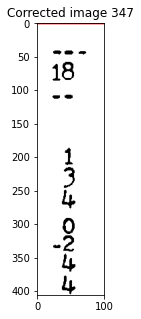

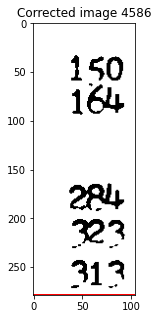

In [168]:
for imagedraw in error_corrected_cells:
    croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
    plt.rcParams["figure.figsize"] = (10,5)
    plt.imshow(croppedimage_full)
    plt.title(f'Corrected image {imagedraw[1]}')
    plt.show()

In [172]:
not_overlap_error_cells =  find_overlapped_cell(error_corrected_cells, exclude_cells+exclude_cells_cor)

In [174]:
not_overlap_error_cells

[[1041, 347, 1612, 754, 0, [[755], [[1612, 347, 1887, 755, 0]]], [1, 5, 0, 1]],
 [1612,
  347,
  1882,
  750,
  0,
  [[755], [[1036, 347, 1612, 755, 0], [1887, 347, 2116, 755, 0]]],
  [0, 5, 1, 1]],
 [1892,
  347,
  2116,
  751,
  0,
  [[755], [[1612, 347, 1887, 755, 0], [2116, 347, 2464, 755, 0]]],
  [1, 5, 0, 1]],
 [2116,
  347,
  2464,
  754,
  0,
  [[755], [[1887, 347, 2116, 755, 0], [2464, 347, 2598, 755, 0]]],
  [0, 5, 0, 1]],
 [1892,
  759,
  2116,
  1223,
  0,
  [[347, 1228], [[2116, 755, 2464, 1228, 0]]],
  [1, 1, 0, 1]],
 [2116,
  758,
  2463,
  1223,
  0,
  [[347, 1228], [[1887, 755, 2116, 1228, 0], [2464, 755, 2598, 1228, 0]]],
  [0, 1, 1, 1]],
 [1892,
  1233,
  2116,
  1777,
  0,
  [[755, 1782], [[2116, 1228, 2464, 1782, 0]]],
  [1, 1, 0, 1]],
 [2116, 1233, 2463, 1777, 0, [[755, 1782], []], [0, 1, 1, 1]],
 [337,
  1787,
  1031,
  2193,
  0,
  [[1228, 2193], [[1036, 1782, 1612, 2193, 0]]],
  [5, 1, 1, 0]],
 [1041,
  1787,
  1611,
  2193,
  0,
  [[1228, 2193], [[337, 1782, 1

In [173]:
new_corrected_excluded_cells, not_corrected_excluded_cells = classify_error_cells(not_overlap_error_cells, tables, average_cordinates,0.7)

TypeError: an integer is required (got type list)

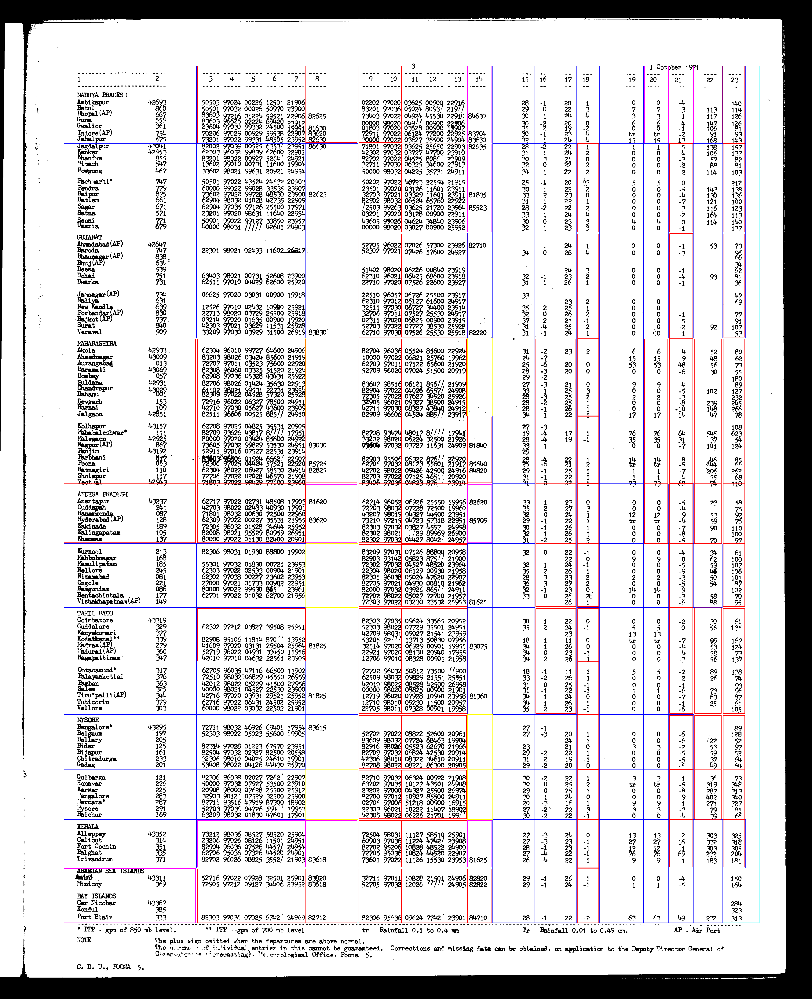

In [175]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in correct_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in corrected_cells:
    put_box(image,box,(0,color,0)) # Green

for box in not_overlap_error_cells:
    put_box(image,box,(color,0,0)) # Red
    
for box in new_corrected_excluded_cells:
#     print(box)
    put_box(image,box,(color,0,color))  # pink
    
for box in blank_cells:   
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
im_pil.save(f"{filename}_temp_cell_multiple_cell_correction.jpg")
im_pil  

In [453]:
#upto here 8 july

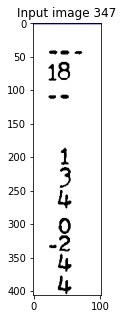

x [3051, 347, 3152, 753, 0, [[], [[1041, 347, 2464, 754, 0], [3811, 347, 3927, 755, 0]]], [1, 5, 1, 1]] [382, 753]
y [3051, 347, 3152, 753, 0, [[], [[1041, 347, 2464, 754, 0], [3811, 347, 3927, 755, 0]]], [1, 5, 1, 1]] [3051, 3152]


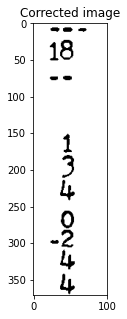

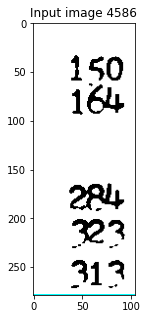

x [3818, 4586, 3922, 4865, 0, [[], []], [1, 1, 1, 5]] [4586, 4865]
y [3818, 4586, 3922, 4865, 0, [[], []], [1, 1, 1, 5]] [3852, 3922]


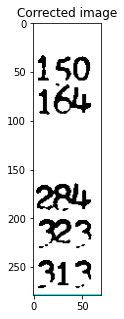

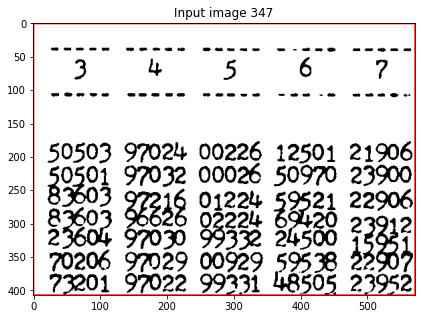

x [1041, 347, 1612, 754, 0, [[755], [[1612, 347, 1887, 755, 0]]], [1, 5, 0, 1]] [559, 753]
y [1041, 347, 1612, 754, 0, [[755], [[1612, 347, 1887, 755, 0]]], [1, 5, 0, 1]] [1041, 1612]


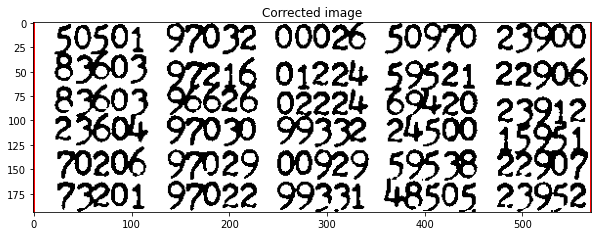

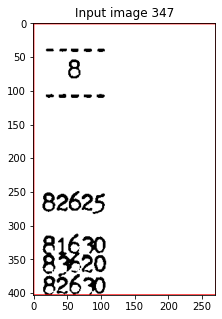

x [1612, 347, 1882, 750, 0, [[755], [[1036, 347, 1612, 755, 0], [1887, 347, 2116, 755, 0]]], [0, 5, 1, 1]] [458, 750]
y [1612, 347, 1882, 750, 0, [[755], [[1036, 347, 1612, 755, 0], [1887, 347, 2116, 755, 0]]], [0, 5, 1, 1]] [1611, 1882]


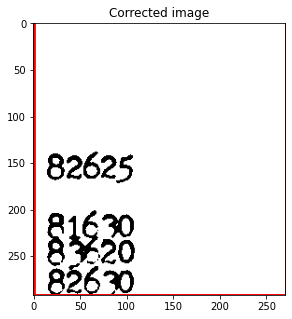

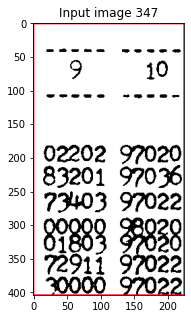

x [1892, 347, 2116, 751, 0, [[755], [[1612, 347, 1887, 755, 0], [2116, 347, 2464, 755, 0]]], [1, 5, 0, 1]] [347, 751]
y [1892, 347, 2116, 751, 0, [[755], [[1612, 347, 1887, 755, 0], [2116, 347, 2464, 755, 0]]], [1, 5, 0, 1]] [1892, 2116]


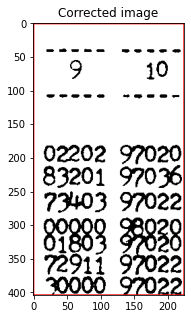

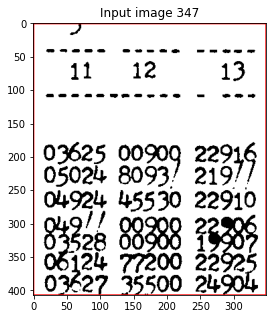

x [2116, 347, 2464, 754, 0, [[755], [[1887, 347, 2116, 755, 0], [2464, 347, 2598, 755, 0]]], [0, 5, 0, 1]] [347, 754]
y [2116, 347, 2464, 754, 0, [[755], [[1887, 347, 2116, 755, 0], [2464, 347, 2598, 755, 0]]], [0, 5, 0, 1]] [2116, 2464]


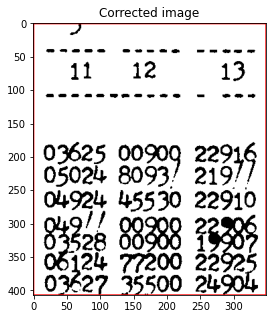

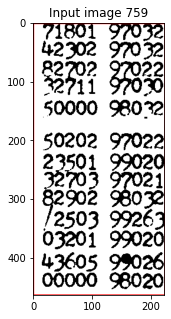

x [1892, 759, 2116, 1223, 0, [[347, 1228], [[2116, 755, 2464, 1228, 0]]], [1, 1, 0, 1]] [758, 1223]
y [1892, 759, 2116, 1223, 0, [[347, 1228], [[2116, 755, 2464, 1228, 0]]], [1, 1, 0, 1]] [1892, 2116]


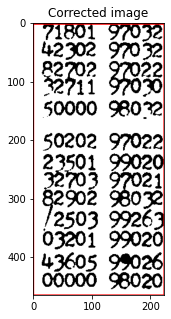

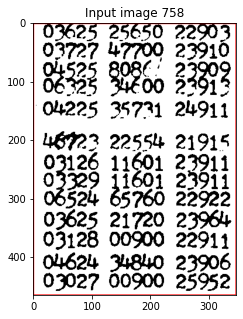

x [2116, 758, 2463, 1223, 0, [[347, 1228], [[1887, 755, 2116, 1228, 0], [2464, 755, 2598, 1228, 0]]], [0, 1, 1, 1]] [758, 1223]
y [2116, 758, 2463, 1223, 0, [[347, 1228], [[1887, 755, 2116, 1228, 0], [2464, 755, 2598, 1228, 0]]], [0, 1, 1, 1]] [2116, 2463]


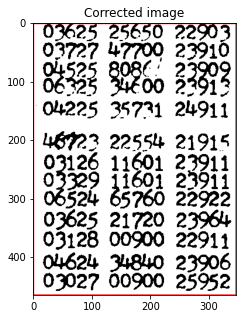

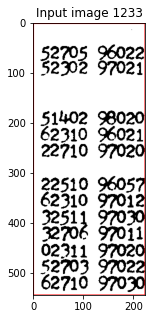

x [1892, 1233, 2116, 1777, 0, [[755, 1782], [[2116, 1228, 2464, 1782, 0]]], [1, 1, 0, 1]] [1570, 1768]
y [1892, 1233, 2116, 1777, 0, [[755, 1782], [[2116, 1228, 2464, 1782, 0]]], [1, 1, 0, 1]] [1892, 2116]


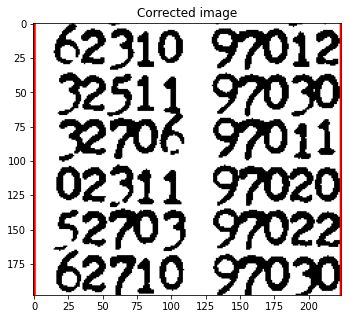

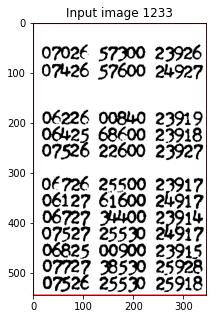

x [2116, 1233, 2463, 1777, 0, [[755, 1782], []], [0, 1, 1, 1]] [1408, 1771]
y [2116, 1233, 2463, 1777, 0, [[755, 1782], []], [0, 1, 1, 1]] [2116, 2463]


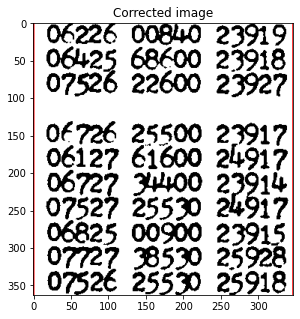

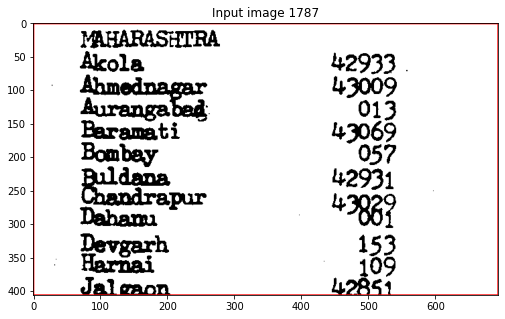

x [337, 1787, 1031, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0]]], [5, 1, 1, 0]] [1899, 2193]
y [337, 1787, 1031, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0]]], [5, 1, 1, 0]] [406, 616, 780, 1031]


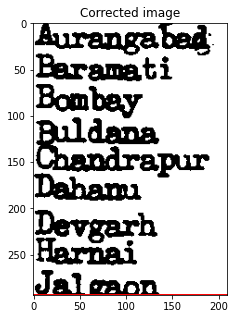

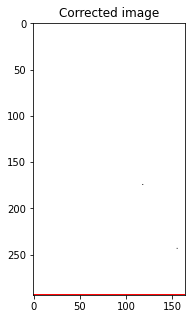

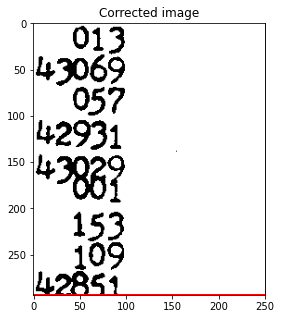

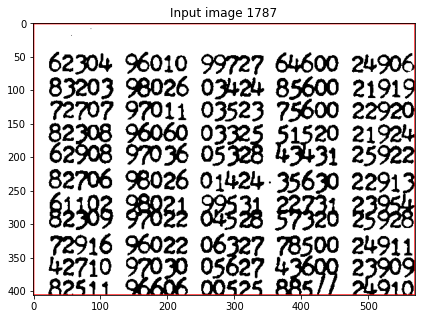

x [1041, 1787, 1611, 2193, 0, [[1228, 2193], [[337, 1782, 1036, 2193, 0], [1887, 1782, 2116, 2193, 0]]], [1, 1, 1, 0]] [1829, 2193]
y [1041, 1787, 1611, 2193, 0, [[1228, 2193], [[337, 1782, 1036, 2193, 0], [1887, 1782, 2116, 2193, 0]]], [1, 1, 1, 0]] [1041, 1611]


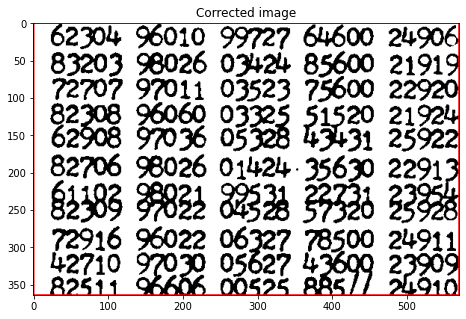

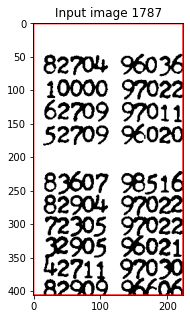

x [1892, 1787, 2116, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0], [2116, 1782, 2464, 2193, 0]]], [1, 1, 0, 0]] [1787, 2193]
y [1892, 1787, 2116, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0], [2116, 1782, 2464, 2193, 0]]], [1, 1, 0, 0]] [1892, 2116]


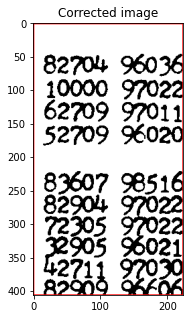

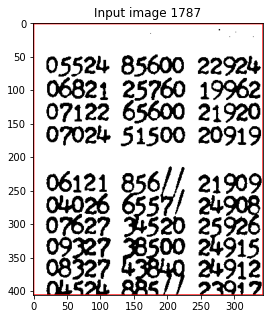

x [2116, 1787, 2459, 2193, 0, [[1228, 2193], [[1887, 1782, 2116, 2193, 0], [2820, 1782, 3041, 2193, 0]]], [0, 1, 1, 0]] [1787, 2193]
y [2116, 1787, 2459, 2193, 0, [[1228, 2193], [[1887, 1782, 2116, 2193, 0], [2820, 1782, 3041, 2193, 0]]], [0, 1, 1, 0]] [2115, 2458]


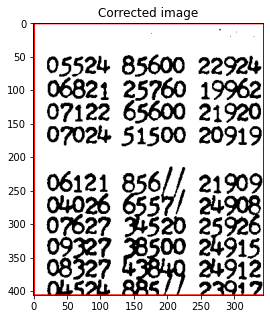

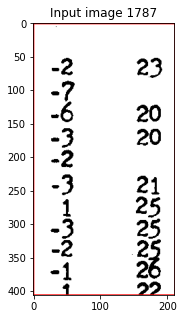

x [2825, 1787, 3036, 2193, 0, [[1228, 2193], [[2116, 1782, 2464, 2193, 0], [3393, 1782, 3526, 2193, 0]]], [1, 1, 1, 0]] [1787, 2193]
y [2825, 1787, 3036, 2193, 0, [[1228, 2193], [[2116, 1782, 2464, 2193, 0], [3393, 1782, 3526, 2193, 0]]], [1, 1, 1, 0]] [2887, 3036]


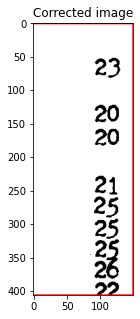

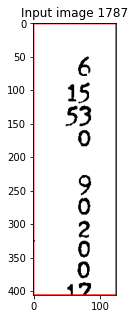

x [3398, 1787, 3521, 2193, 0, [[1228, 2193], [[2820, 1782, 3041, 2193, 0], [3526, 1782, 3658, 2193, 0]]], [1, 1, 1, 0]] [1787, 2193]
y [3398, 1787, 3521, 2193, 0, [[1228, 2193], [[2820, 1782, 3041, 2193, 0], [3526, 1782, 3658, 2193, 0]]], [1, 1, 1, 0]] [3398, 3521]


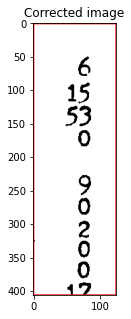

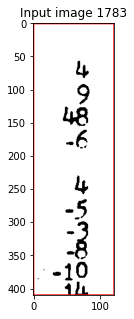

x [3531, 1783, 3653, 2193, 0, [[1228, 2193], [[3393, 1782, 3526, 2193, 0], [3658, 1782, 3808, 2193, 0]]], [1, 1, 1, 0]] [1783, 2193]
y [3531, 1783, 3653, 2193, 0, [[1228, 2193], [[3393, 1782, 3526, 2193, 0], [3658, 1782, 3808, 2193, 0]]], [1, 1, 1, 0]] [3531, 3653]


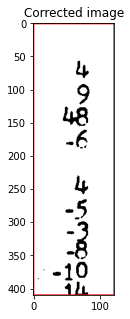

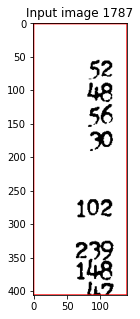

x [3663, 1787, 3803, 2193, 0, [[1228, 2193], [[3526, 1782, 3658, 2193, 0], [3808, 1782, 3932, 2193, 0]]], [1, 1, 1, 0]] [1838, 2193]
y [3663, 1787, 3803, 2193, 0, [[1228, 2193], [[3526, 1782, 3658, 2193, 0], [3808, 1782, 3932, 2193, 0]]], [1, 1, 1, 0]] [3663, 3803]


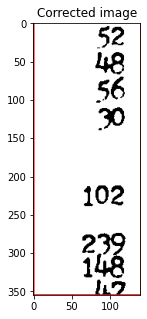

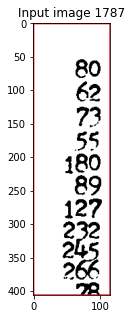

x [3813, 1787, 3927, 2193, 0, [[1228, 2193], []], [1, 1, 1, 0]] [1787, 2193]
y [3813, 1787, 3927, 2193, 0, [[1228, 2193], []], [1, 1, 1, 0]] [3856, 3927]


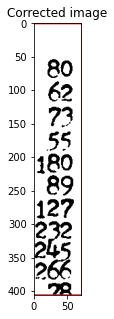

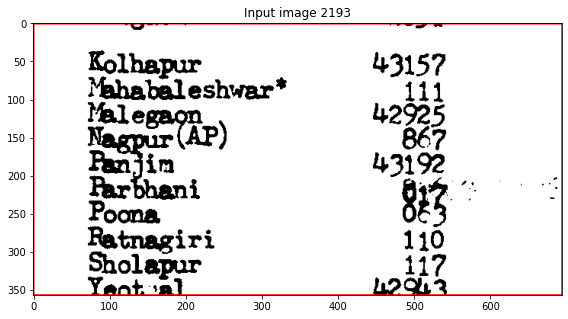

x [337, 2193, 1031, 2550, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0]]], [5, 0, 1, 0]] [2193, 2550]
y [337, 2193, 1031, 2550, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0]]], [5, 0, 1, 0]] [407, 627, 780, 1031]


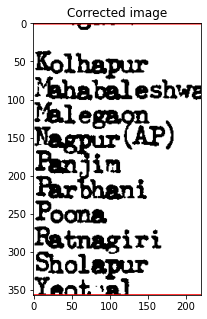

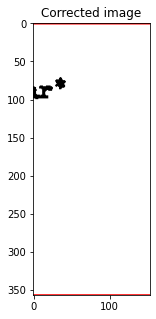

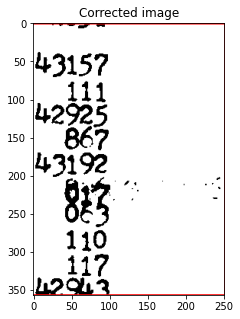

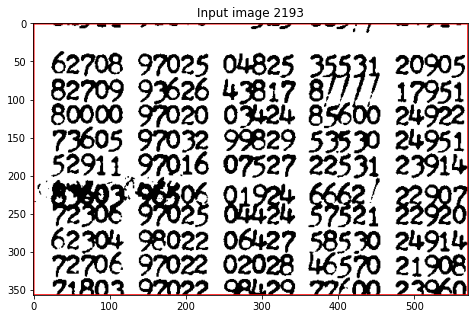

x [1041, 2193, 1612, 2550, 0, [[1782, 2550], [[337, 2193, 1036, 2550, 0], [1612, 2193, 1887, 2550, 0]]], [1, 0, 0, 0]] [2193, 2550]
y [1041, 2193, 1612, 2550, 0, [[1782, 2550], [[337, 2193, 1036, 2550, 0], [1612, 2193, 1887, 2550, 0]]], [1, 0, 0, 0]] [1041, 1612]


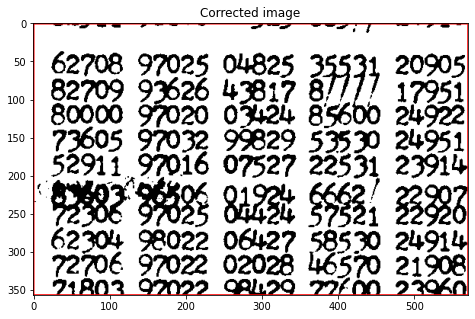

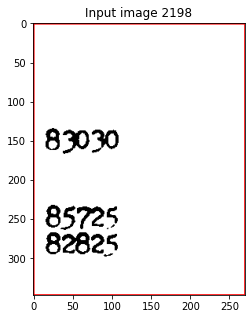

x [1612, 2198, 1882, 2545, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0], [1887, 2193, 2116, 2550, 0]]], [0, 1, 1, 1]] [2198, 2545]
y [1612, 2198, 1882, 2545, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0], [1887, 2193, 2116, 2550, 0]]], [0, 1, 1, 1]] [1611, 1882]


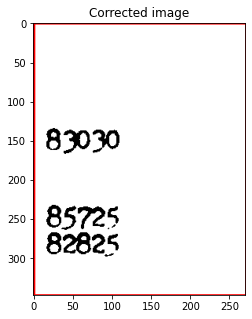

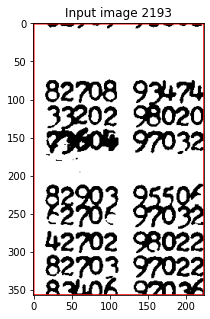

x [1892, 2193, 2116, 2550, 0, [[1782, 2550], [[1612, 2193, 1887, 2550, 0], [2116, 2193, 2464, 2550, 0]]], [1, 0, 0, 0]] [2267, 2550]
y [1892, 2193, 2116, 2550, 0, [[1782, 2550], [[1612, 2193, 1887, 2550, 0], [2116, 2193, 2464, 2550, 0]]], [1, 0, 0, 0]] [1892, 2116]


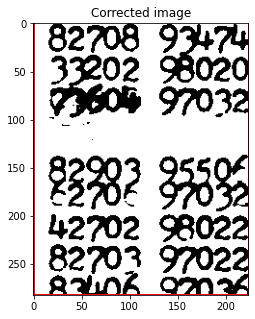

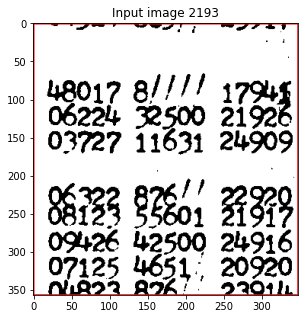

x [2116, 2193, 2464, 2550, 0, [[1782, 2550], [[1887, 2193, 2116, 2550, 0], [2464, 2193, 2598, 2550, 0]]], [0, 0, 0, 0]] [2193, 2550]
y [2116, 2193, 2464, 2550, 0, [[1782, 2550], [[1887, 2193, 2116, 2550, 0], [2464, 2193, 2598, 2550, 0]]], [0, 0, 0, 0]] [2116, 2464]


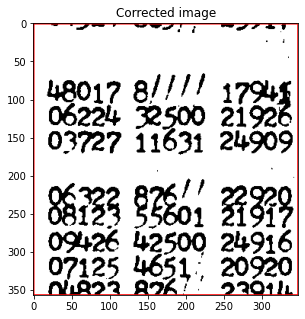

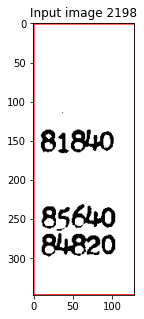

x [2464, 2198, 2593, 2545, 0, [[1782, 2550], [[2116, 2193, 2464, 2550, 0], [2820, 2193, 3041, 2550, 0]]], [0, 1, 1, 1]] [2198, 2545]
y [2464, 2198, 2593, 2545, 0, [[1782, 2550], [[2116, 2193, 2464, 2550, 0], [2820, 2193, 3041, 2550, 0]]], [0, 1, 1, 1]] [2463, 2593]


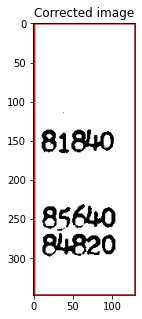

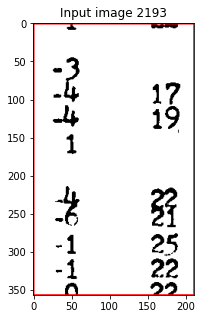

x [2825, 2193, 3036, 2550, 0, [[1782, 2550], [[2464, 2193, 2598, 2550, 0], [3393, 2193, 3526, 2550, 0]]], [1, 0, 1, 0]] [2193, 2550]
y [2825, 2193, 3036, 2550, 0, [[1782, 2550], [[2464, 2193, 2598, 2550, 0], [3393, 2193, 3526, 2550, 0]]], [1, 0, 1, 0]] [2887, 3036]


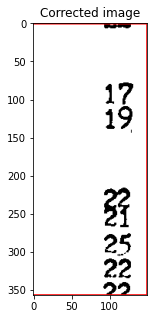

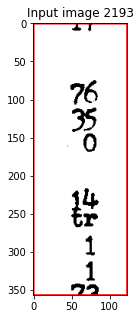

x [3398, 2193, 3521, 2550, 0, [[1782, 2550], [[2820, 2193, 3041, 2550, 0], [3526, 2193, 3658, 2550, 0]]], [1, 0, 1, 0]] [2193, 2550]
y [3398, 2193, 3521, 2550, 0, [[1782, 2550], [[2820, 2193, 3041, 2550, 0], [3526, 2193, 3658, 2550, 0]]], [1, 0, 1, 0]] [3398, 3521]


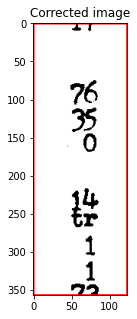

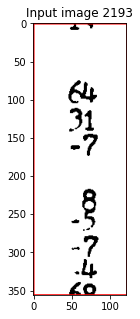

x [3531, 2193, 3653, 2549, 0, [[1782, 2550], [[3393, 2193, 3526, 2550, 0], [3658, 2193, 3808, 2550, 0]]], [1, 0, 1, 1]] [2193, 2549]
y [3531, 2193, 3653, 2549, 0, [[1782, 2550], [[3393, 2193, 3526, 2550, 0], [3658, 2193, 3808, 2550, 0]]], [1, 0, 1, 1]] [3531, 3653]


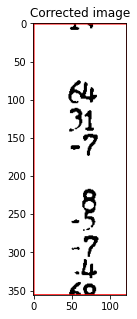

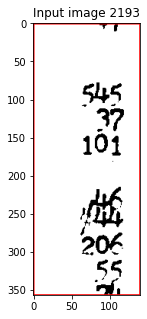

x [3663, 2193, 3803, 2550, 0, [[1782, 2550], [[3526, 2193, 3658, 2550, 0], [3808, 2193, 3932, 2550, 0]]], [1, 0, 1, 0]] [2269, 2550]
y [3663, 2193, 3803, 2550, 0, [[1782, 2550], [[3526, 2193, 3658, 2550, 0], [3808, 2193, 3932, 2550, 0]]], [1, 0, 1, 0]] [3663, 3803]


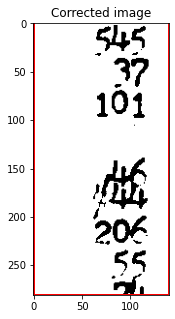

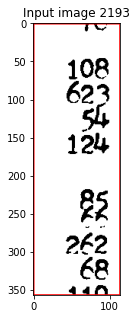

x [3813, 2193, 3927, 2550, 0, [[1782, 2550], []], [1, 0, 1, 0]] [2238, 2550]
y [3813, 2193, 3927, 2550, 0, [[1782, 2550], []], [1, 0, 1, 0]] [3853, 3927]


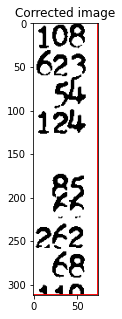

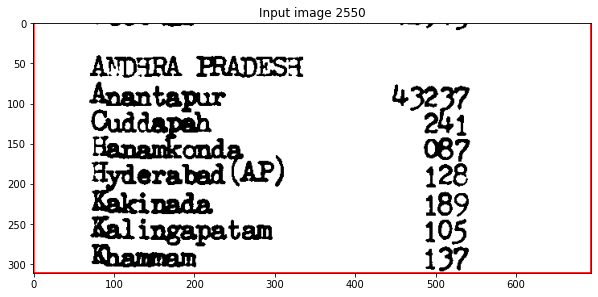

x [337, 2550, 1031, 2861, 0, [[2193, 2866], [[1036, 2550, 1612, 2866, 0]]], [5, 0, 1, 1]] [2628, 2861]
y [337, 2550, 1031, 2861, 0, [[2193, 2866], [[1036, 2550, 1612, 2866, 0]]], [5, 0, 1, 1]] [408, 677, 882, 1031]


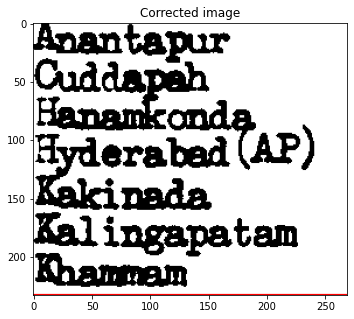

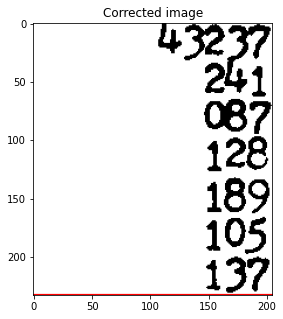

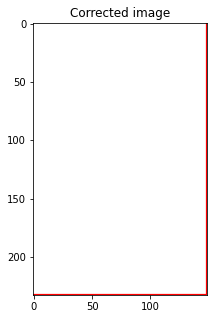

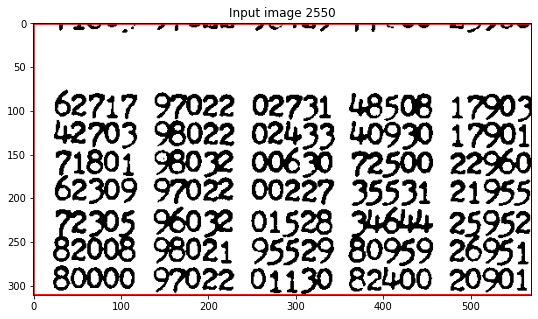

x [1041, 2550, 1611, 2861, 0, [[2193, 2866], [[337, 2550, 1036, 2866, 0], [1612, 2550, 1887, 2866, 0]]], [1, 0, 1, 1]] [2628, 2860]
y [1041, 2550, 1611, 2861, 0, [[2193, 2866], [[337, 2550, 1036, 2866, 0], [1612, 2550, 1887, 2866, 0]]], [1, 0, 1, 1]] [1041, 1611]


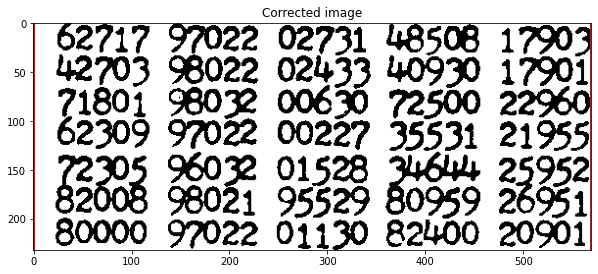

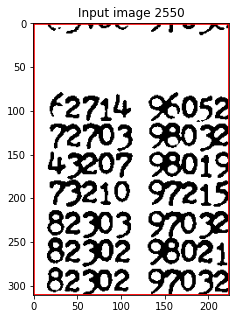

x [1892, 2550, 2116, 2861, 0, [[2193, 2866], [[1612, 2550, 1887, 2866, 0], [2116, 2550, 2464, 2866, 0]]], [1, 0, 0, 1]] [2631, 2861]
y [1892, 2550, 2116, 2861, 0, [[2193, 2866], [[1612, 2550, 1887, 2866, 0], [2116, 2550, 2464, 2866, 0]]], [1, 0, 0, 1]] [1892, 2116]


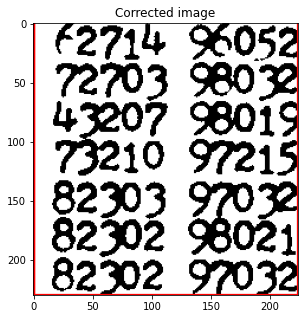

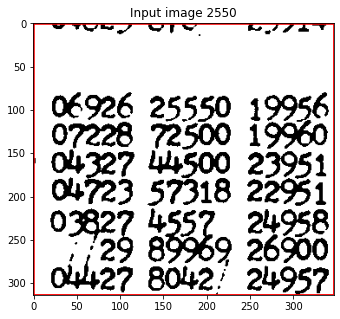

x [2116, 2550, 2463, 2864, 0, [[2193, 2866], [[1887, 2550, 2116, 2866, 0], [2464, 2550, 2598, 2866, 0]]], [0, 0, 1, 1]] [2632, 2864]
y [2116, 2550, 2463, 2864, 0, [[2193, 2866], [[1887, 2550, 2116, 2866, 0], [2464, 2550, 2598, 2866, 0]]], [0, 0, 1, 1]] [2116, 2463]


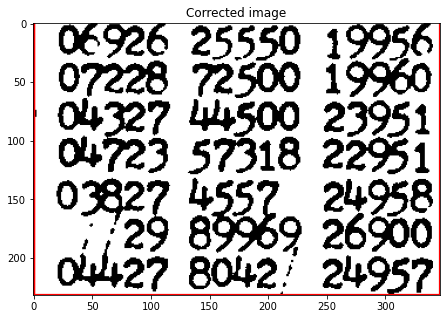

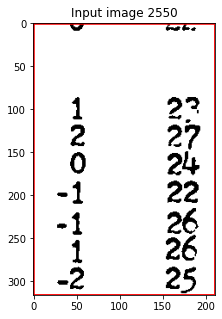

x [2825, 2550, 3036, 2866, 0, [[2193, 2866], [[2464, 2550, 2598, 2866, 0], [3393, 2550, 3526, 2866, 0]]], [1, 0, 1, 0]] [2550, 2866]
y [2825, 2550, 3036, 2866, 0, [[2193, 2866], [[2464, 2550, 2598, 2866, 0], [3393, 2550, 3526, 2866, 0]]], [1, 0, 1, 0]] [2887, 3036]


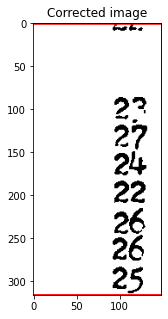

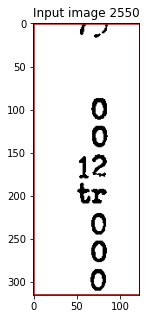

x [3398, 2550, 3521, 2865, 0, [[2193, 2866], [[2820, 2550, 3041, 2866, 0], [3658, 2550, 3808, 2866, 0]]], [1, 0, 1, 1]] [2550, 2865]
y [3398, 2550, 3521, 2865, 0, [[2193, 2866], [[2820, 2550, 3041, 2866, 0], [3658, 2550, 3808, 2866, 0]]], [1, 0, 1, 1]] [3398, 3521]


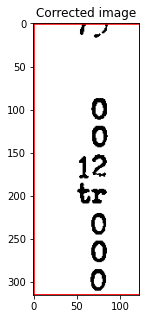

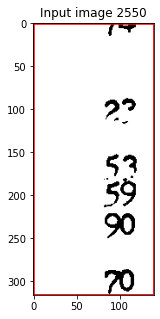

x [3663, 2550, 3803, 2866, 0, [[2193, 2866], [[3393, 2550, 3526, 2866, 0], [3808, 2550, 3932, 2866, 0]]], [1, 0, 1, 0]] [2550, 2866]
y [3663, 2550, 3803, 2866, 0, [[2193, 2866], [[3393, 2550, 3526, 2866, 0], [3808, 2550, 3932, 2866, 0]]], [1, 0, 1, 0]] [3663, 3803]


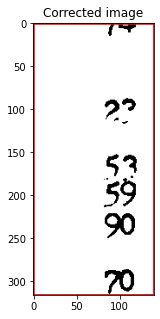

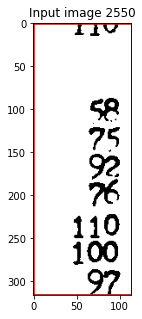

x [3813, 2550, 3927, 2866, 0, [[2193, 2866], []], [1, 0, 1, 0]] [2631, 2866]
y [3813, 2550, 3927, 2866, 0, [[2193, 2866], []], [1, 0, 1, 0]] [3813, 3927]


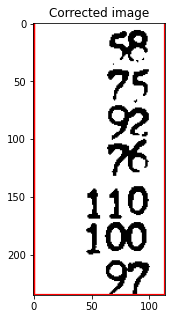

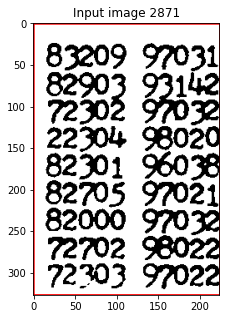

x [1892, 2871, 2116, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0]]], [1, 1, 0, 1]] [2993, 3189]
y [1892, 2871, 2116, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0]]], [1, 1, 0, 1]] [1892, 2116]


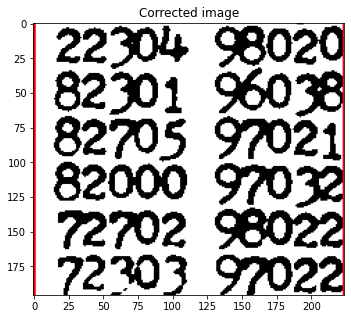

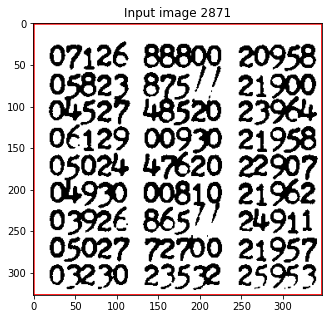

x [2116, 2871, 2463, 3198, 0, [[2550, 3203], [[1887, 2866, 2116, 3203, 0], [2820, 2866, 3041, 3203, 0]]], [0, 1, 1, 1]] [2895, 3190]
y [2116, 2871, 2463, 3198, 0, [[2550, 3203], [[1887, 2866, 2116, 3203, 0], [2820, 2866, 3041, 3203, 0]]], [0, 1, 1, 1]] [2116, 2463]


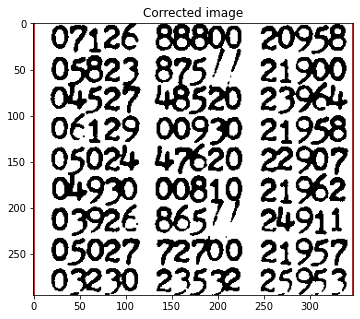

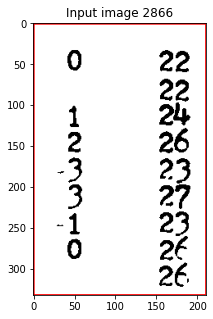

x [2825, 2866, 3036, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0], [3808, 2866, 3932, 3203, 0]]], [1, 0, 1, 1]] [2865, 3189]
y [2825, 2866, 3036, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0], [3808, 2866, 3932, 3203, 0]]], [1, 0, 1, 1]] [2887, 3036]


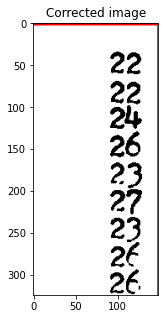

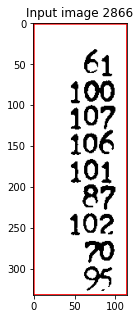

x [3813, 2866, 3927, 3198, 0, [[2550, 3203], []], [1, 0, 1, 1]] [2865, 3044, 3198]
y [3813, 2866, 3927, 3198, 0, [[2550, 3203], []], [1, 0, 1, 1]] [3854, 3927]


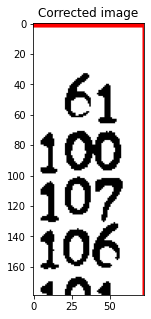

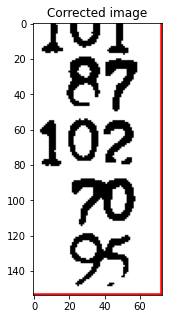

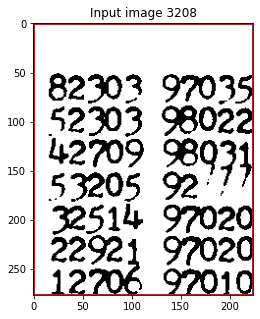

x [1892, 3208, 2116, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0]]], [1, 1, 0, 0]] [3258, 3485]
y [1892, 3208, 2116, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0]]], [1, 1, 0, 0]] [1892, 2116]


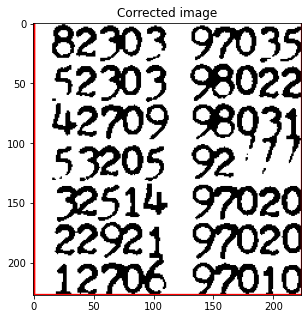

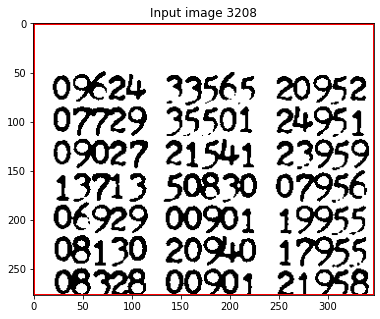

x [2116, 3208, 2463, 3485, 0, [[2866, 3485], [[1887, 3203, 2116, 3485, 0], [2820, 3203, 3041, 3485, 0]]], [0, 1, 1, 0]] [3258, 3485]
y [2116, 3208, 2463, 3485, 0, [[2866, 3485], [[1887, 3203, 2116, 3485, 0], [2820, 3203, 3041, 3485, 0]]], [0, 1, 1, 0]] [2116, 2463]


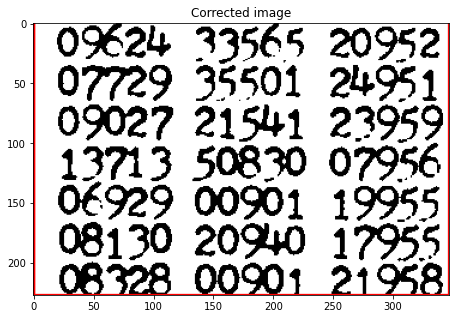

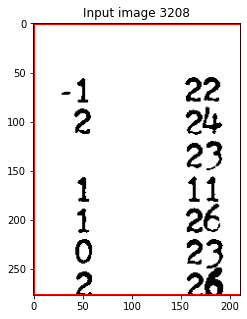

x [2825, 3208, 3036, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0], [3526, 3203, 3658, 3485, 0]]], [1, 1, 1, 0]] [3208, 3485]
y [2825, 3208, 3036, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0], [3526, 3203, 3658, 3485, 0]]], [1, 1, 1, 0]] [2889, 3036]


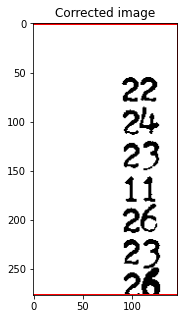

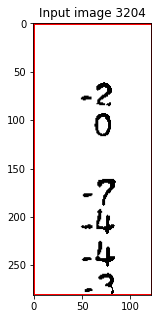

x [3531, 3204, 3653, 3485, 0, [[2866, 3485], [[2820, 3203, 3041, 3485, 0], [3658, 3203, 3808, 3485, 0]]], [1, 1, 1, 0]] [3204, 3485]
y [3531, 3204, 3653, 3485, 0, [[2866, 3485], [[2820, 3203, 3041, 3485, 0], [3658, 3203, 3808, 3485, 0]]], [1, 1, 1, 0]] [3531, 3653]


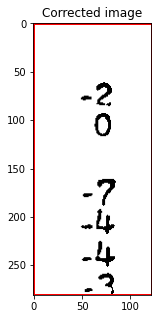

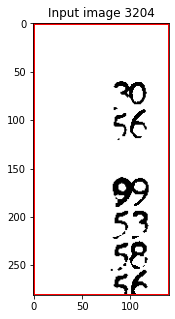

x [3663, 3204, 3803, 3485, 0, [[2866, 3485], [[3526, 3203, 3658, 3485, 0], [3808, 3203, 3932, 3485, 0]]], [1, 1, 1, 0]] [3220, 3485]
y [3663, 3204, 3803, 3485, 0, [[2866, 3485], [[3526, 3203, 3658, 3485, 0], [3808, 3203, 3932, 3485, 0]]], [1, 1, 1, 0]] [3663, 3803]


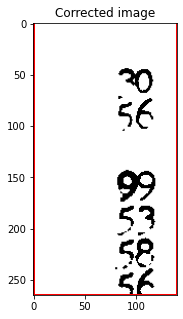

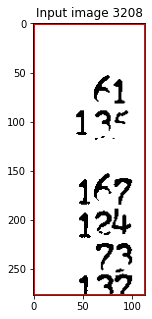

x [3813, 3208, 3927, 3485, 0, [[2866, 3485], []], [1, 1, 1, 0]] [3208, 3485]
y [3813, 3208, 3927, 3485, 0, [[2866, 3485], []], [1, 1, 1, 0]] [3853, 3927]


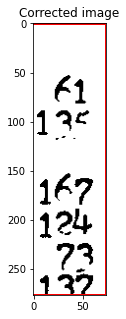

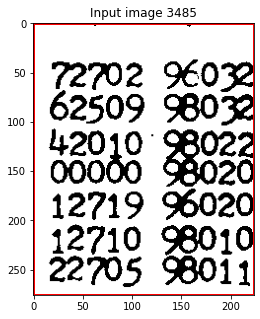

x [1892, 3485, 2116, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0]]], [1, 0, 0, 1]] [3485, 3761]
y [1892, 3485, 2116, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0]]], [1, 0, 0, 1]] [1892, 2116]


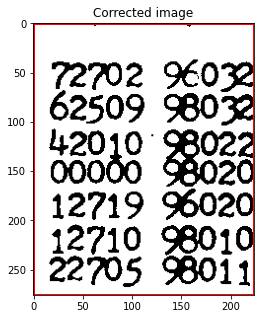

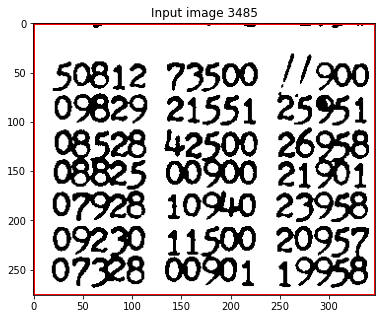

x [2116, 3485, 2463, 3761, 0, [[3203, 3766], [[1887, 3485, 2116, 3766, 0], [2820, 3485, 3041, 3766, 0]]], [0, 0, 1, 1]] [3485, 3761]
y [2116, 3485, 2463, 3761, 0, [[3203, 3766], [[1887, 3485, 2116, 3766, 0], [2820, 3485, 3041, 3766, 0]]], [0, 0, 1, 1]] [2116, 2463]


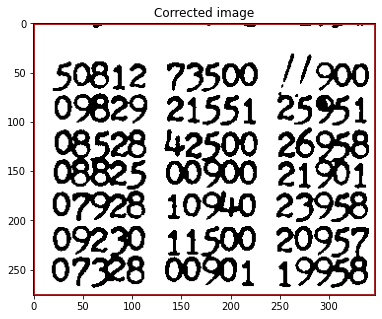

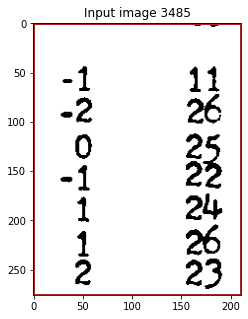

x [2825, 3485, 3036, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0], [3526, 3485, 3658, 3766, 0]]], [1, 0, 1, 1]] [3484, 3756]
y [2825, 3485, 3036, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0], [3526, 3485, 3658, 3766, 0]]], [1, 0, 1, 1]] [2887, 3036]


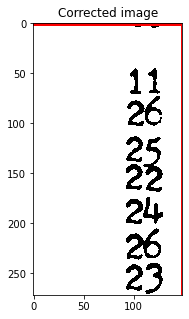

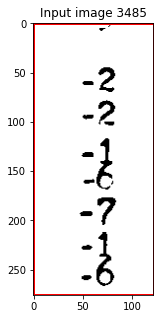

x [3531, 3485, 3653, 3761, 0, [[3203, 3766], [[2820, 3485, 3041, 3766, 0], [3658, 3485, 3808, 3766, 0]]], [1, 0, 1, 1]] [3484, 3753]
y [3531, 3485, 3653, 3761, 0, [[3203, 3766], [[2820, 3485, 3041, 3766, 0], [3658, 3485, 3808, 3766, 0]]], [1, 0, 1, 1]] [3531, 3653]


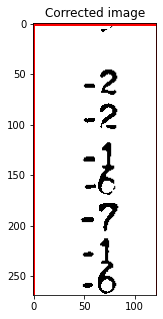

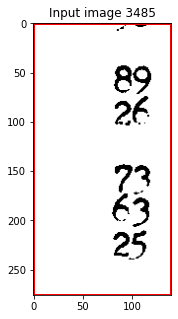

x [3663, 3485, 3803, 3761, 0, [[3203, 3766], [[3526, 3485, 3658, 3766, 0], [3808, 3485, 3932, 3766, 0]]], [1, 0, 1, 1]] [3484, 3726]
y [3663, 3485, 3803, 3761, 0, [[3203, 3766], [[3526, 3485, 3658, 3766, 0], [3808, 3485, 3932, 3766, 0]]], [1, 0, 1, 1]] [3663, 3803]


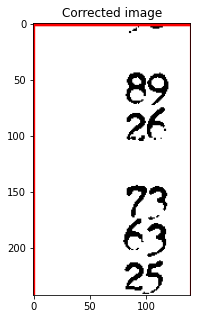

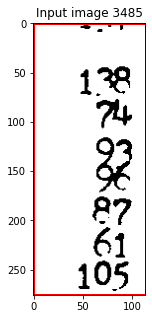

x [3813, 3485, 3927, 3761, 0, [[3203, 3766], []], [1, 0, 1, 1]] [3527, 3755]
y [3813, 3485, 3927, 3761, 0, [[3203, 3766], []], [1, 0, 1, 1]] [3813, 3927]


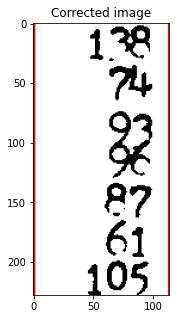

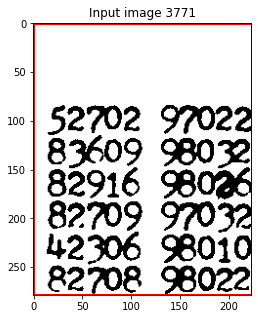

x [1892, 3771, 2116, 4050, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0]]], [1, 1, 0, 1]] [3854, 4049]
y [1892, 3771, 2116, 4050, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0]]], [1, 1, 0, 1]] [1892, 2116]


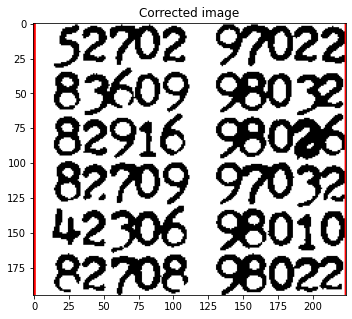

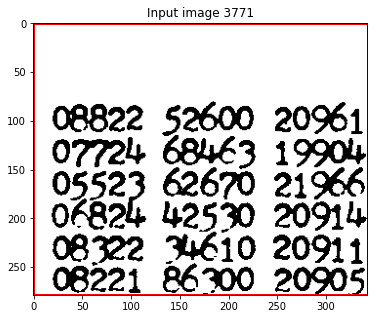

x [2116, 3771, 2459, 4050, 0, [[3485, 4055], [[1887, 3766, 2116, 4055, 0], [3658, 3766, 3808, 4055, 0]]], [0, 1, 1, 1]] [3853, 4050]
y [2116, 3771, 2459, 4050, 0, [[3485, 4055], [[1887, 3766, 2116, 4055, 0], [3658, 3766, 3808, 4055, 0]]], [0, 1, 1, 1]] [2115, 2458]


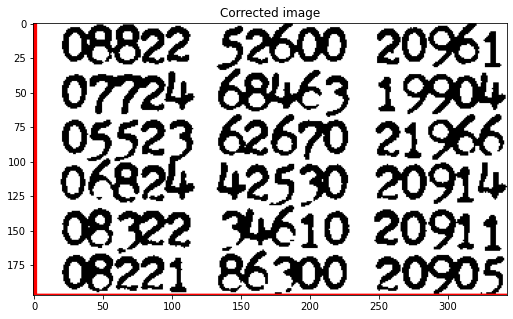

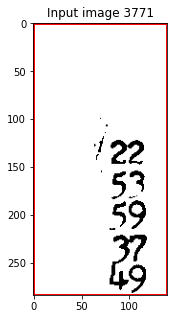

x [3663, 3771, 3803, 4055, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0], [3808, 3766, 3932, 4055, 0]]], [1, 1, 1, 0]] [3771, 4055]
y [3663, 3771, 3803, 4055, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0], [3808, 3766, 3932, 4055, 0]]], [1, 1, 1, 0]] [3663, 3803]


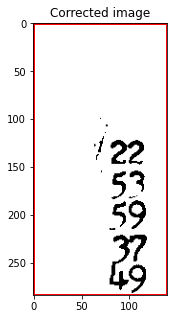

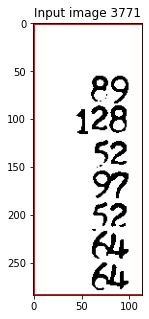

x [3813, 3771, 3927, 4055, 0, [[3485, 4055], []], [1, 1, 1, 0]] [3771, 4055]
y [3813, 3771, 3927, 4055, 0, [[3485, 4055], []], [1, 1, 1, 0]] [3813, 3927]


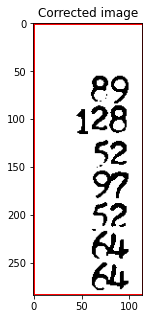

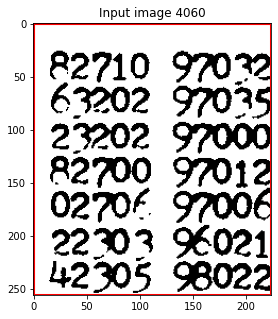

x [1892, 4060, 2116, 4316, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0]]], [1, 1, 0, 1]] [4085, 4313]
y [1892, 4060, 2116, 4316, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0]]], [1, 1, 0, 1]] [1892, 2116]


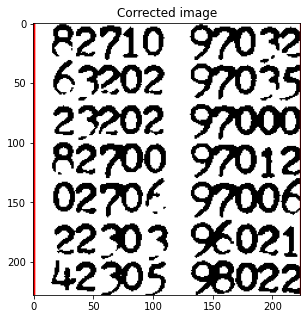

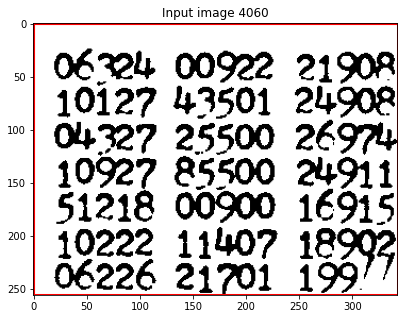

x [2116, 4060, 2459, 4316, 0, [[3766, 4321], [[1887, 4055, 2116, 4321, 0], [3658, 4055, 3808, 4321, 0]]], [0, 1, 1, 1]] [4152, 4316]
y [2116, 4060, 2459, 4316, 0, [[3766, 4321], [[1887, 4055, 2116, 4321, 0], [3658, 4055, 3808, 4321, 0]]], [0, 1, 1, 1]] [2115, 2458]


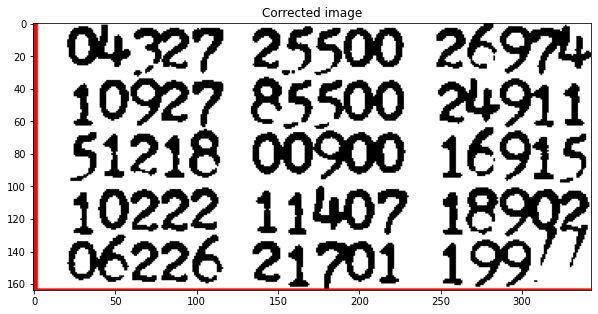

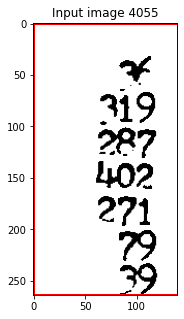

x [3663, 4055, 3803, 4319, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0], [3808, 4055, 3932, 4321, 0]]], [1, 0, 1, 1]] [4055, 4319]
y [3663, 4055, 3803, 4319, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0], [3808, 4055, 3932, 4321, 0]]], [1, 0, 1, 1]] [3724, 3803]


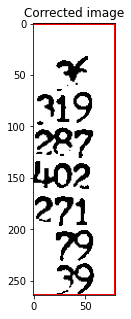

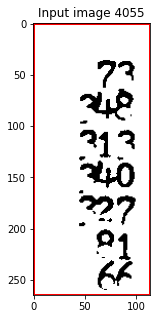

x [3813, 4055, 3927, 4320, 0, [[3766, 4321], []], [1, 0, 1, 1]] [4055, 4320]
y [3813, 4055, 3927, 4320, 0, [[3766, 4321], []], [1, 0, 1, 1]] [3813, 3927]


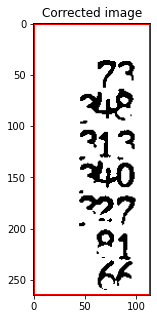

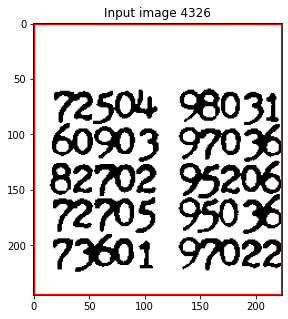

x [1892, 4326, 2116, 4571, 0, [[4055, 4576], [[1612, 4321, 1887, 4576, 0], [2116, 4321, 2464, 4576, 0]]], [1, 1, 0, 1]] [4386, 4571]
y [1892, 4326, 2116, 4571, 0, [[4055, 4576], [[1612, 4321, 1887, 4576, 0], [2116, 4321, 2464, 4576, 0]]], [1, 1, 0, 1]] [1892, 2116]


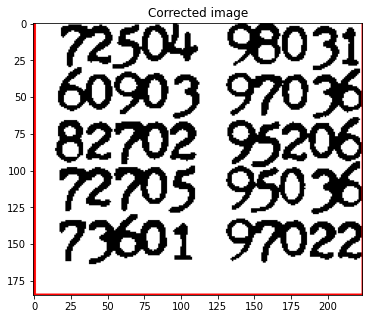

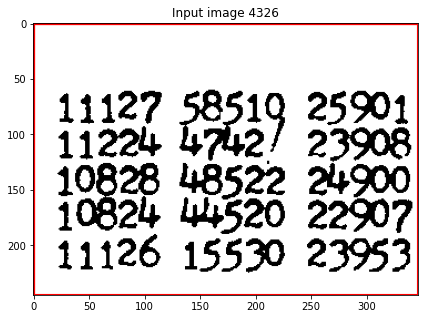

x [2116, 4326, 2463, 4571, 0, [[4055, 4576], [[1887, 4321, 2116, 4576, 0], [2464, 4321, 2598, 4576, 0]]], [0, 1, 1, 1]] [4386, 4571]
y [2116, 4326, 2463, 4571, 0, [[4055, 4576], [[1887, 4321, 2116, 4576, 0], [2464, 4321, 2598, 4576, 0]]], [0, 1, 1, 1]] [2116, 2463]


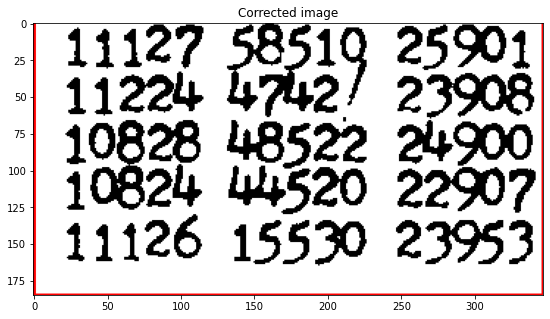

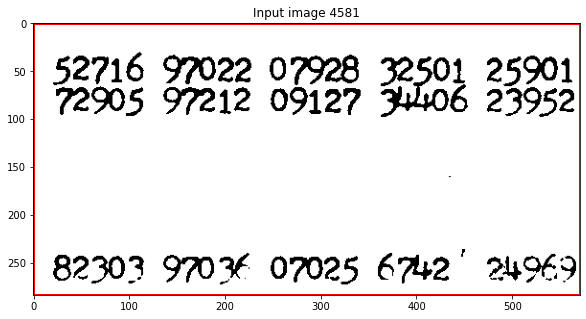

x [1041, 4581, 1612, 4865, 0, [[], [[337, 4576, 1036, 4865, 0], [1612, 4576, 1887, 4865, 0]]], [1, 1, 0, 5]] [4676, 4865]
y [1041, 4581, 1612, 4865, 0, [[], [[337, 4576, 1036, 4865, 0], [1612, 4576, 1887, 4865, 0]]], [1, 1, 0, 5]] [1041, 1612]


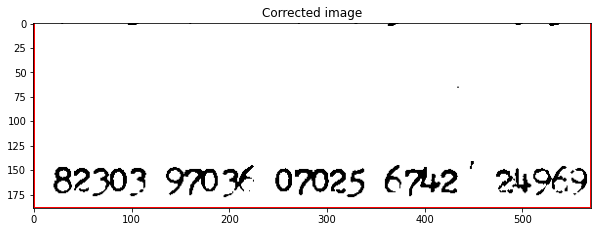

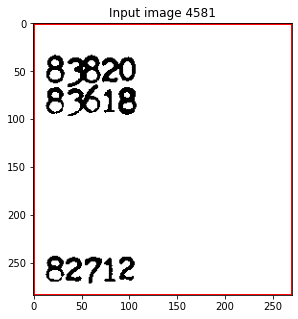

x [1612, 4581, 1882, 4865, 0, [[], [[1036, 4576, 1612, 4865, 0], [1887, 4576, 2116, 4865, 0]]], [0, 1, 1, 5]] [4677, 4865]
y [1612, 4581, 1882, 4865, 0, [[], [[1036, 4576, 1612, 4865, 0], [1887, 4576, 2116, 4865, 0]]], [0, 1, 1, 5]] [1611, 1882]


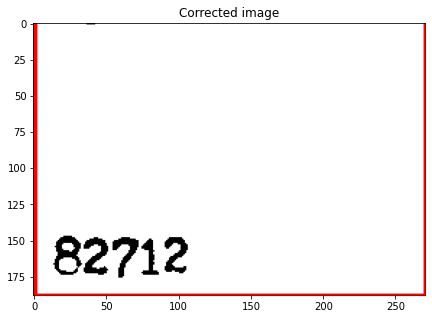

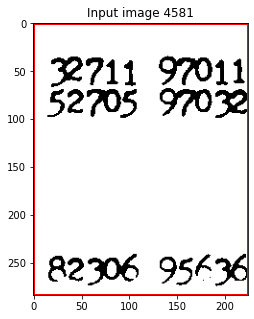

x [1892, 4581, 2116, 4865, 0, [[], [[1612, 4576, 1887, 4865, 0], [2116, 4576, 2464, 4865, 0]]], [1, 1, 0, 5]] [4680, 4865]
y [1892, 4581, 2116, 4865, 0, [[], [[1612, 4576, 1887, 4865, 0], [2116, 4576, 2464, 4865, 0]]], [1, 1, 0, 5]] [1892, 2116]


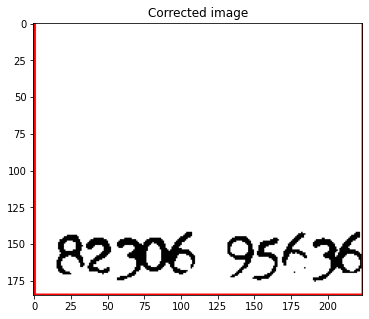

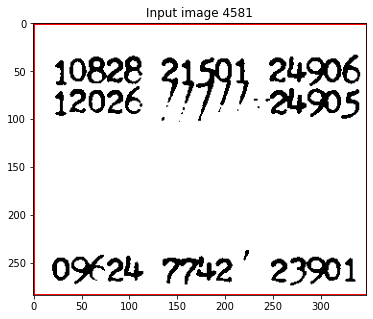

x [2116, 4581, 2464, 4865, 0, [[], [[1887, 4576, 2116, 4865, 0], [2464, 4576, 2598, 4865, 0]]], [0, 1, 0, 5]] [4678, 4865]
y [2116, 4581, 2464, 4865, 0, [[], [[1887, 4576, 2116, 4865, 0], [2464, 4576, 2598, 4865, 0]]], [0, 1, 0, 5]] [2116, 2464]


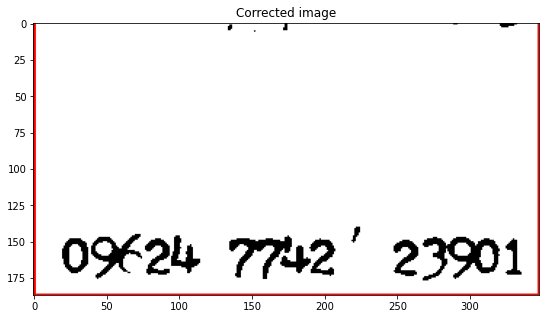

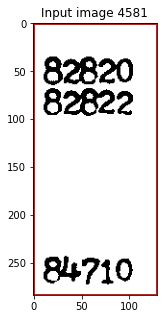

x [2464, 4581, 2593, 4865, 0, [[], [[2116, 4576, 2464, 4865, 0], [3808, 4576, 3932, 4865, 0]]], [0, 1, 1, 5]] [4679, 4865]
y [2464, 4581, 2593, 4865, 0, [[], [[2116, 4576, 2464, 4865, 0], [3808, 4576, 3932, 4865, 0]]], [0, 1, 1, 5]] [2463, 2593]


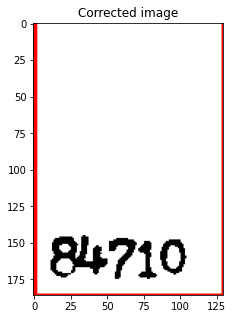

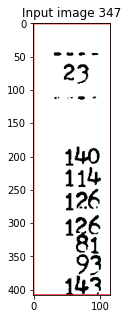

x [3811, 347, 3927, 755, 0, [[755], []], [1, 5, 1, 0]] [384, 755]
y [3811, 347, 3927, 755, 0, [[755], []], [1, 5, 1, 0]] [3846, 3927]


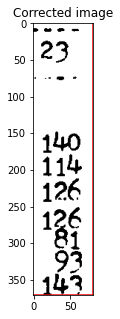

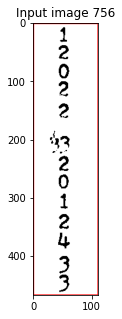

x [3046, 756, 3157, 1223, 0, [[347, 1228], [[2820, 755, 3041, 1228, 0], [3162, 755, 3393, 1228, 0]]], [1, 1, 1, 1]] [755, 1223]
y [3046, 756, 3157, 1223, 0, [[347, 1228], [[2820, 755, 3041, 1228, 0], [3162, 755, 3393, 1228, 0]]], [1, 1, 1, 1]] [3046, 3157]


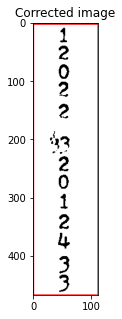

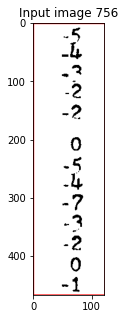

x [3531, 756, 3653, 1223, 0, [[347, 1228], [[3393, 755, 3526, 1228, 0], [3658, 755, 3808, 1228, 0]]], [1, 1, 1, 1]] [756, 1223]
y [3531, 756, 3653, 1223, 0, [[347, 1228], [[3393, 755, 3526, 1228, 0], [3658, 755, 3808, 1228, 0]]], [1, 1, 1, 1]] [3531, 3653]


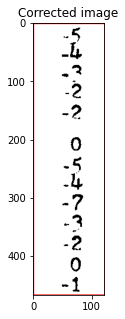

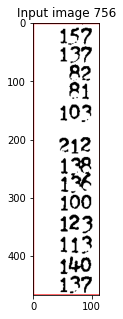

x [3813, 756, 3927, 1223, 0, [[347, 1228], []], [1, 1, 1, 1]] [755, 988, 1223]
y [3813, 756, 3927, 1223, 0, [[347, 1228], []], [1, 1, 1, 1]] [3855, 3927]


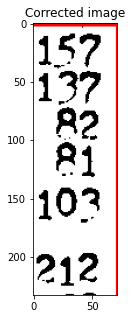

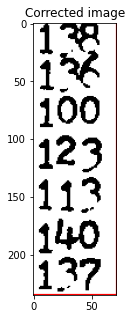

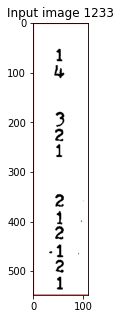

x [3046, 1233, 3157, 1781, 0, [[755, 1782], [[2820, 1228, 3041, 1782, 0], [3162, 1228, 3393, 1782, 0]]], [1, 1, 1, 1]] [1281, 1781]
y [3046, 1233, 3157, 1781, 0, [[755, 1782], [[2820, 1228, 3041, 1782, 0], [3162, 1228, 3393, 1782, 0]]], [1, 1, 1, 1]] [3046, 3157]


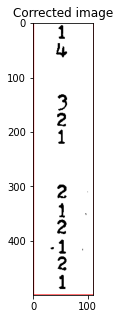

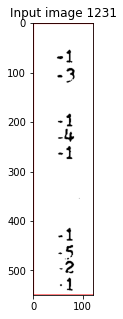

x [3531, 1231, 3653, 1781, 0, [[755, 1782], [[3393, 1228, 3526, 1782, 0], [3658, 1228, 3808, 1782, 0]]], [1, 1, 1, 1]] [1264, 1781]
y [3531, 1231, 3653, 1781, 0, [[755, 1782], [[3393, 1228, 3526, 1782, 0], [3658, 1228, 3808, 1782, 0]]], [1, 1, 1, 1]] [3531, 3653]


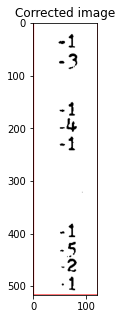

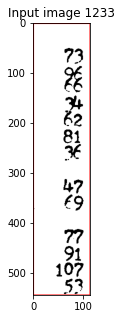

x [3813, 1233, 3927, 1777, 0, [[755, 1782], []], [1, 1, 1, 1]] [1280, 1777]
y [3813, 1233, 3927, 1777, 0, [[755, 1782], []], [1, 1, 1, 1]] [3813, 3927]


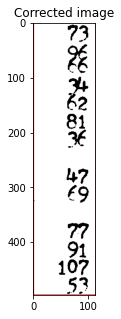

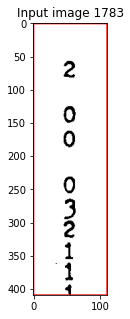

x [3046, 1783, 3157, 2192, 0, [[1228, 2193], [[2598, 1782, 2820, 2193, 0], [3162, 1782, 3393, 2193, 0]]], [1, 1, 1, 1]] [1783, 2192]
y [3046, 1783, 3157, 2192, 0, [[1228, 2193], [[2598, 1782, 2820, 2193, 0], [3162, 1782, 3393, 2193, 0]]], [1, 1, 1, 1]] [3046, 3157]


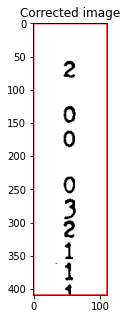

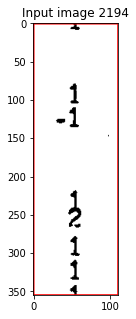

x [3046, 2194, 3157, 2549, 0, [[1782, 2550], [[2598, 2193, 2820, 2550, 0], [3162, 2193, 3393, 2550, 0]]], [1, 1, 1, 1]] [2194, 2549]
y [3046, 2194, 3157, 2549, 0, [[1782, 2550], [[2598, 2193, 2820, 2550, 0], [3162, 2193, 3393, 2550, 0]]], [1, 1, 1, 1]] [3046, 3157]


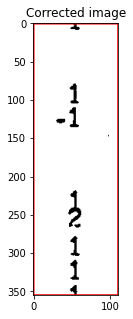

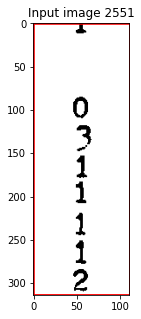

x [3046, 2551, 3157, 2865, 0, [[2193, 2866], [[2598, 2550, 2820, 2866, 0], [3162, 2550, 3393, 2866, 0]]], [1, 1, 1, 1]] [2551, 2865]
y [3046, 2551, 3157, 2865, 0, [[2193, 2866], [[2598, 2550, 2820, 2866, 0], [3162, 2550, 3393, 2866, 0]]], [1, 1, 1, 1]] [3046, 3157]


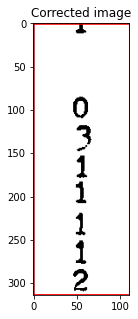

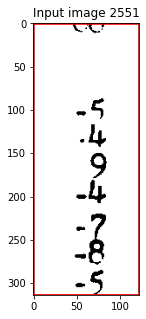

x [3531, 2551, 3653, 2865, 0, [[2193, 2866], []], [1, 1, 1, 1]] [2551, 2865]
y [3531, 2551, 3653, 2865, 0, [[2193, 2866], []], [1, 1, 1, 1]] [3531, 3653]


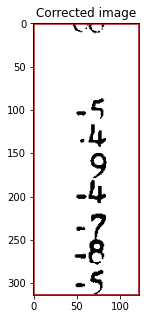

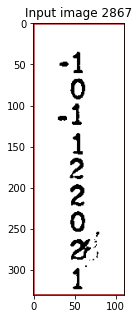

x [3046, 2867, 3157, 3198, 0, [[2550, 3203], [[2598, 2866, 2820, 3203, 0], [3162, 2866, 3393, 3203, 0]]], [1, 1, 1, 1]] [2866, 3192]
y [3046, 2867, 3157, 3198, 0, [[2550, 3203], [[2598, 2866, 2820, 3203, 0], [3162, 2866, 3393, 3203, 0]]], [1, 1, 1, 1]] [3046, 3157]


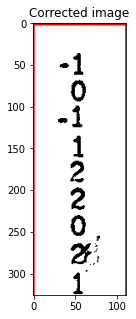

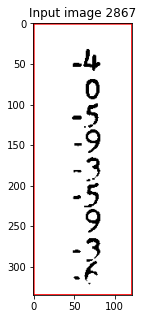

x [3531, 2867, 3653, 3202, 0, [[2550, 3203], [[3393, 2866, 3526, 3203, 0], [3658, 2866, 3808, 3203, 0]]], [1, 1, 1, 1]] [2867, 3202]
y [3531, 2867, 3653, 3202, 0, [[2550, 3203], [[3393, 2866, 3526, 3203, 0], [3658, 2866, 3808, 3203, 0]]], [1, 1, 1, 1]] [3531, 3653]


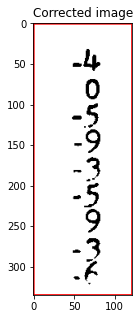

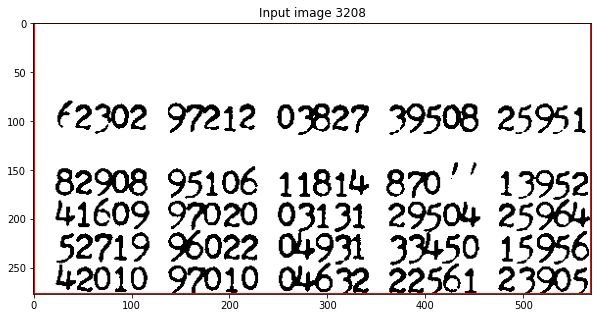

x [1041, 3208, 1611, 3485, 0, [[2866, 3485], [[337, 3203, 1036, 3485, 0], [1612, 3203, 1887, 3485, 0]]], [1, 1, 1, 0]] [3208, 3485]
y [1041, 3208, 1611, 3485, 0, [[2866, 3485], [[337, 3203, 1036, 3485, 0], [1612, 3203, 1887, 3485, 0]]], [1, 1, 1, 0]] [1041, 1611]


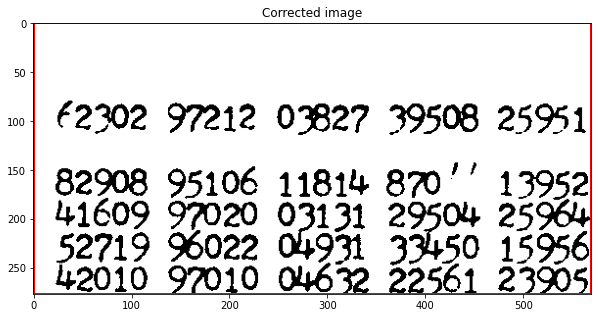

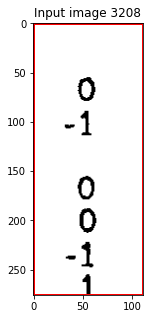

x [3046, 3208, 3157, 3484, 0, [[2866, 3485], [[2598, 3203, 2820, 3485, 0], [3162, 3203, 3393, 3485, 0]]], [1, 1, 1, 1]] [3208, 3484]
y [3046, 3208, 3157, 3484, 0, [[2866, 3485], [[2598, 3203, 2820, 3485, 0], [3162, 3203, 3393, 3485, 0]]], [1, 1, 1, 1]] [3046, 3157]


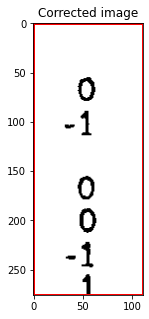

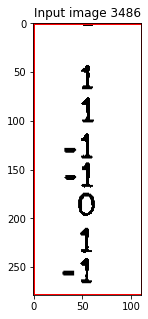

x [3046, 3486, 3157, 3765, 0, [[3203, 3766], [[2598, 3485, 2820, 3766, 0], [3162, 3485, 3393, 3766, 0]]], [1, 1, 1, 1]] [3486, 3765]
y [3046, 3486, 3157, 3765, 0, [[3203, 3766], [[2598, 3485, 2820, 3766, 0], [3162, 3485, 3393, 3766, 0]]], [1, 1, 1, 1]] [3046, 3157]


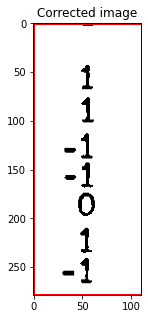

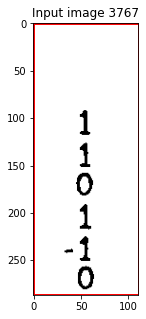

x [3046, 3767, 3157, 4054, 0, [[3485, 4055], [[2820, 3766, 3041, 4055, 0], [3162, 3766, 3393, 4055, 0]]], [1, 1, 1, 1]] [3767, 4054]
y [3046, 3767, 3157, 4054, 0, [[3485, 4055], [[2820, 3766, 3041, 4055, 0], [3162, 3766, 3393, 4055, 0]]], [1, 1, 1, 1]] [3046, 3157]


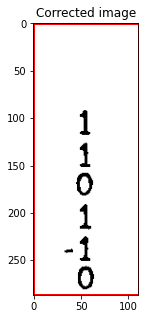

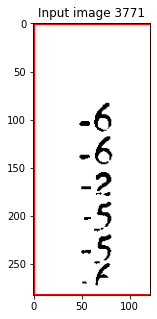

x [3531, 3771, 3653, 4054, 0, [[3485, 4055], []], [1, 1, 1, 1]] [3771, 4054]
y [3531, 3771, 3653, 4054, 0, [[3485, 4055], []], [1, 1, 1, 1]] [3531, 3653]


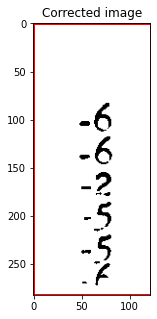

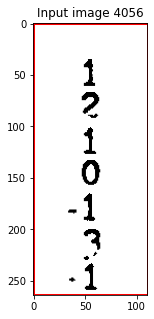

x [3046, 4056, 3157, 4320, 0, [[3766, 4321], [[2820, 4055, 3041, 4321, 0], [3162, 4055, 3393, 4321, 0]]], [1, 1, 1, 1]] [4056, 4320]
y [3046, 4056, 3157, 4320, 0, [[3766, 4321], [[2820, 4055, 3041, 4321, 0], [3162, 4055, 3393, 4321, 0]]], [1, 1, 1, 1]] [3046, 3157]


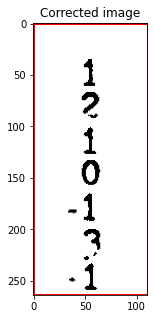

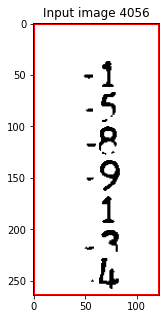

x [3531, 4056, 3653, 4320, 0, [[3766, 4321], []], [1, 1, 1, 1]] [4056, 4320]
y [3531, 4056, 3653, 4320, 0, [[3766, 4321], []], [1, 1, 1, 1]] [3531, 3653]


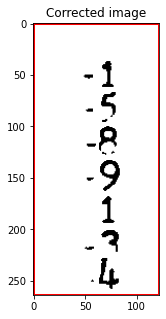

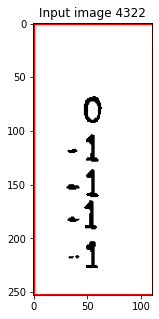

x [3046, 4322, 3157, 4575, 0, [[4055, 4576], [[2820, 4321, 3041, 4576, 0], [3162, 4321, 3393, 4576, 0]]], [1, 1, 1, 1]] [4386, 4575]
y [3046, 4322, 3157, 4575, 0, [[4055, 4576], [[2820, 4321, 3041, 4576, 0], [3162, 4321, 3393, 4576, 0]]], [1, 1, 1, 1]] [3046, 3157]


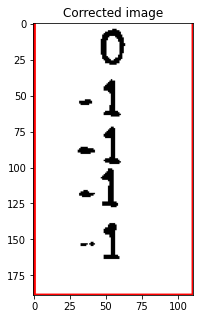

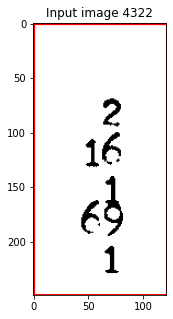

x [3531, 4322, 3653, 4571, 0, [[4055, 4576], [[3393, 4321, 3526, 4576, 0], [3658, 4321, 3808, 4576, 0]]], [1, 1, 1, 1]] [4353, 4552]
y [3531, 4322, 3653, 4571, 0, [[4055, 4576], [[3393, 4321, 3526, 4576, 0], [3658, 4321, 3808, 4576, 0]]], [1, 1, 1, 1]] [3531, 3653]


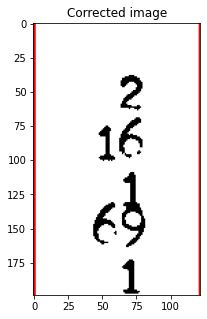

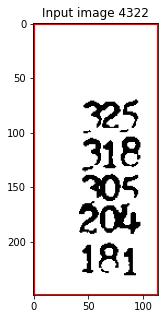

x [3813, 4322, 3927, 4571, 0, [[4055, 4576], []], [1, 1, 1, 1]] [4391, 4571]
y [3813, 4322, 3927, 4571, 0, [[4055, 4576], []], [1, 1, 1, 1]] [3813, 3927]


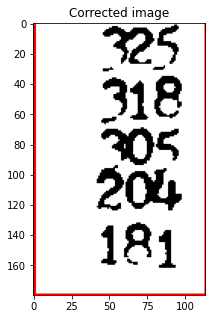

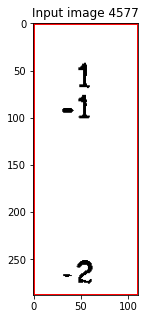

x [3046, 4577, 3157, 4865, 0, [[], [[2820, 4576, 3041, 4865, 0], [3162, 4576, 3393, 4865, 0]]], [1, 1, 1, 5]] [4679, 4865]
y [3046, 4577, 3157, 4865, 0, [[], [[2820, 4576, 3041, 4865, 0], [3162, 4576, 3393, 4865, 0]]], [1, 1, 1, 5]] [3046, 3157]


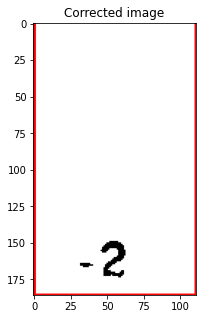

In [178]:
new_corrected_cells = []
for imagedraw in error_corrected_cells+not_overlap_error_cells:#
    
    croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
    plt.rcParams["figure.figsize"] = (10,5)
    plt.imshow(croppedimage_full)
    plt.title(f'Input image {imagedraw[1]}')
    plt.show()
    
    possible_cells = segment_image(image, imagedraw, masks[1])
    new_corrected_cells +=possible_cells
    
    for cell in possible_cells:
        croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
        plt.rcParams["figure.figsize"] = (10,5)
        plt.imshow(croppedimage_full)
        plt.title(f'Corrected image')
        plt.show()
    

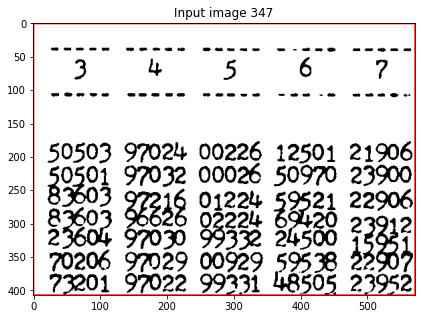

x [1041, 347, 1612, 754, 0, [[755], [[1612, 347, 1887, 755, 0]]], [1, 5, 0, 1]] [559, 753]
y [1041, 347, 1612, 754, 0, [[755], [[1612, 347, 1887, 755, 0]]], [1, 5, 0, 1]] [1041, 1612]


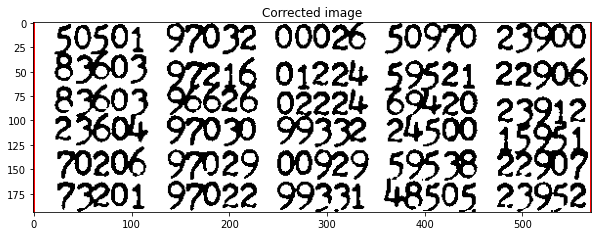

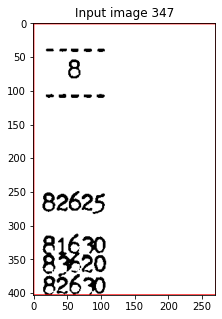

x [1612, 347, 1882, 750, 0, [[755], [[1036, 347, 1612, 755, 0], [1887, 347, 2116, 755, 0]]], [0, 5, 1, 1]] [458, 750]
y [1612, 347, 1882, 750, 0, [[755], [[1036, 347, 1612, 755, 0], [1887, 347, 2116, 755, 0]]], [0, 5, 1, 1]] [1611, 1882]


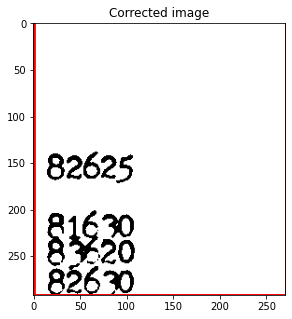

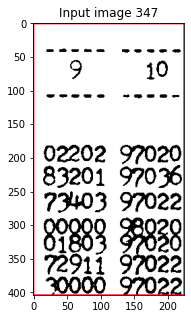

x [1892, 347, 2116, 751, 0, [[755], [[1612, 347, 1887, 755, 0], [2116, 347, 2464, 755, 0]]], [1, 5, 0, 1]] [347, 751]
y [1892, 347, 2116, 751, 0, [[755], [[1612, 347, 1887, 755, 0], [2116, 347, 2464, 755, 0]]], [1, 5, 0, 1]] [1892, 2116]


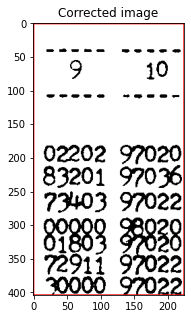

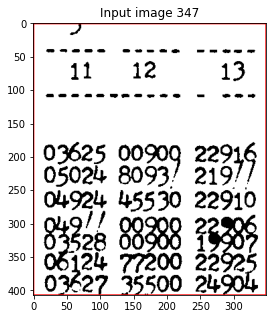

x [2116, 347, 2464, 754, 0, [[755], [[1887, 347, 2116, 755, 0], [2464, 347, 2598, 755, 0]]], [0, 5, 0, 1]] [347, 754]
y [2116, 347, 2464, 754, 0, [[755], [[1887, 347, 2116, 755, 0], [2464, 347, 2598, 755, 0]]], [0, 5, 0, 1]] [2116, 2464]


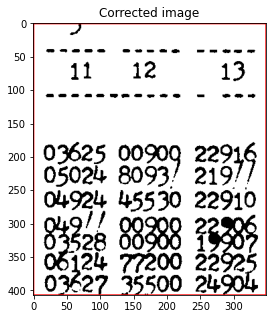

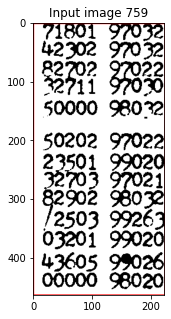

x [1892, 759, 2116, 1223, 0, [[347, 1228], [[2116, 755, 2464, 1228, 0]]], [1, 1, 0, 1]] [758, 1223]
y [1892, 759, 2116, 1223, 0, [[347, 1228], [[2116, 755, 2464, 1228, 0]]], [1, 1, 0, 1]] [1892, 2116]


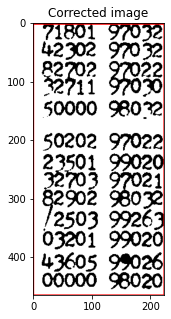

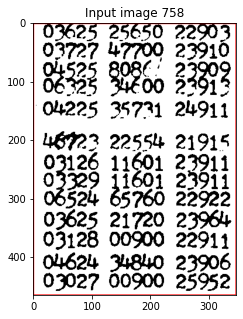

x [2116, 758, 2463, 1223, 0, [[347, 1228], [[1887, 755, 2116, 1228, 0], [2464, 755, 2598, 1228, 0]]], [0, 1, 1, 1]] [758, 1223]
y [2116, 758, 2463, 1223, 0, [[347, 1228], [[1887, 755, 2116, 1228, 0], [2464, 755, 2598, 1228, 0]]], [0, 1, 1, 1]] [2116, 2463]


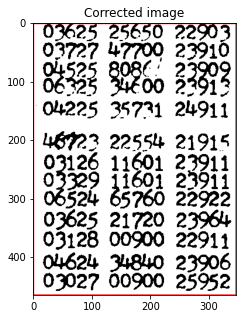

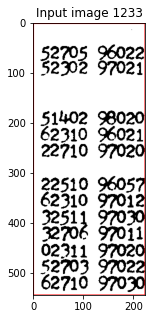

x [1892, 1233, 2116, 1777, 0, [[755, 1782], [[2116, 1228, 2464, 1782, 0]]], [1, 1, 0, 1]] [1570, 1768]
y [1892, 1233, 2116, 1777, 0, [[755, 1782], [[2116, 1228, 2464, 1782, 0]]], [1, 1, 0, 1]] [1892, 2116]


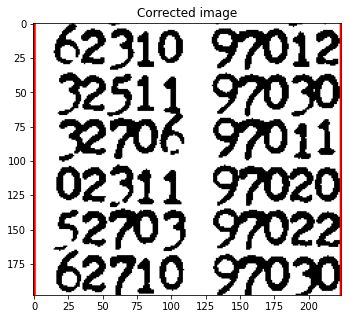

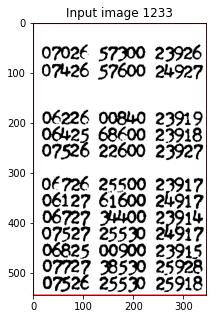

x [2116, 1233, 2463, 1777, 0, [[755, 1782], []], [0, 1, 1, 1]] [1408, 1771]
y [2116, 1233, 2463, 1777, 0, [[755, 1782], []], [0, 1, 1, 1]] [2116, 2463]


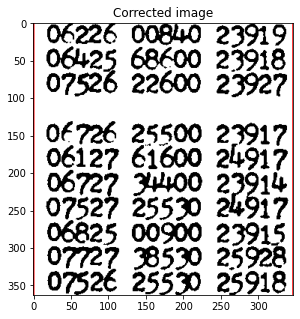

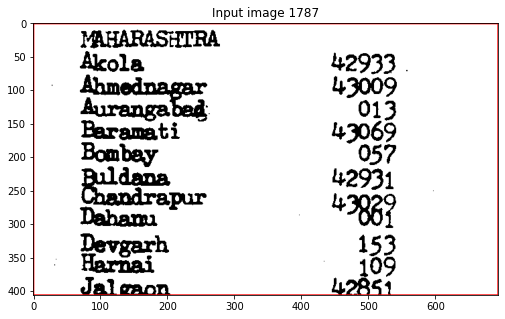

x [337, 1787, 1031, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0]]], [5, 1, 1, 0]] [1899, 2193]
y [337, 1787, 1031, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0]]], [5, 1, 1, 0]] [406, 616, 780, 1031]


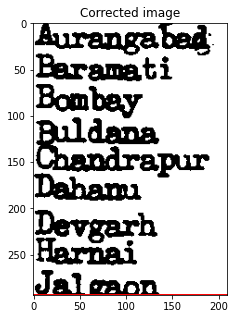

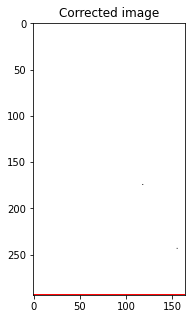

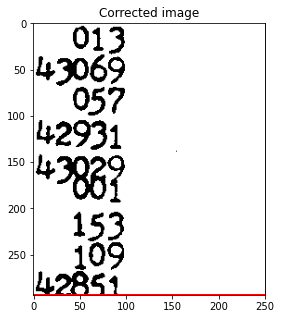

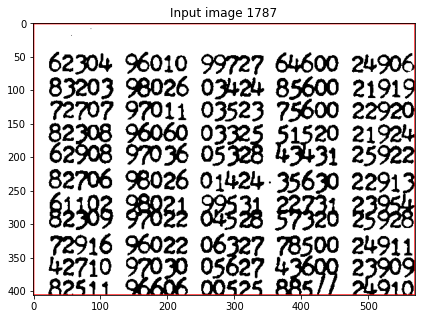

x [1041, 1787, 1611, 2193, 0, [[1228, 2193], [[337, 1782, 1036, 2193, 0], [1887, 1782, 2116, 2193, 0]]], [1, 1, 1, 0]] [1829, 2193]
y [1041, 1787, 1611, 2193, 0, [[1228, 2193], [[337, 1782, 1036, 2193, 0], [1887, 1782, 2116, 2193, 0]]], [1, 1, 1, 0]] [1041, 1611]


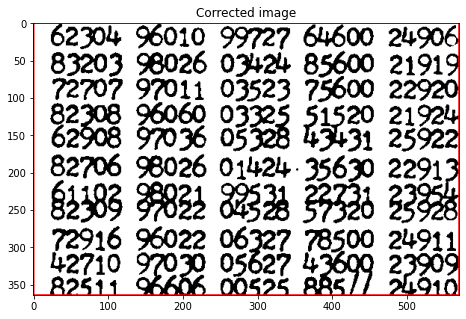

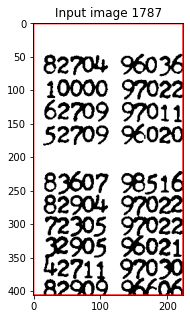

x [1892, 1787, 2116, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0], [2116, 1782, 2464, 2193, 0]]], [1, 1, 0, 0]] [1787, 2193]
y [1892, 1787, 2116, 2193, 0, [[1228, 2193], [[1036, 1782, 1612, 2193, 0], [2116, 1782, 2464, 2193, 0]]], [1, 1, 0, 0]] [1892, 2116]


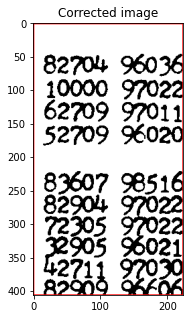

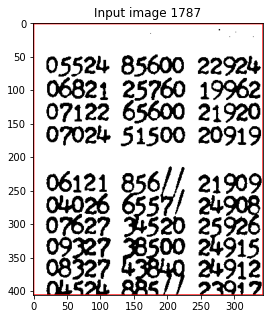

x [2116, 1787, 2459, 2193, 0, [[1228, 2193], [[1887, 1782, 2116, 2193, 0], [2820, 1782, 3041, 2193, 0]]], [0, 1, 1, 0]] [1787, 2193]
y [2116, 1787, 2459, 2193, 0, [[1228, 2193], [[1887, 1782, 2116, 2193, 0], [2820, 1782, 3041, 2193, 0]]], [0, 1, 1, 0]] [2115, 2458]


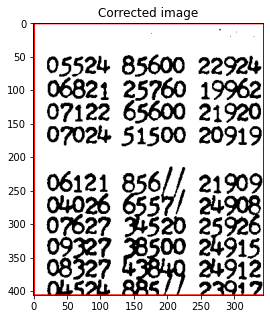

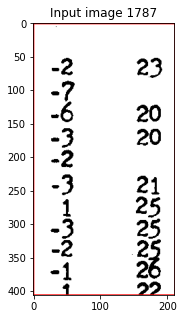

x [2825, 1787, 3036, 2193, 0, [[1228, 2193], [[2116, 1782, 2464, 2193, 0], [3393, 1782, 3526, 2193, 0]]], [1, 1, 1, 0]] [1787, 2193]
y [2825, 1787, 3036, 2193, 0, [[1228, 2193], [[2116, 1782, 2464, 2193, 0], [3393, 1782, 3526, 2193, 0]]], [1, 1, 1, 0]] [2887, 3036]


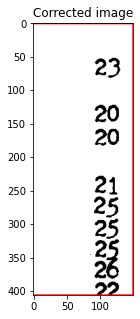

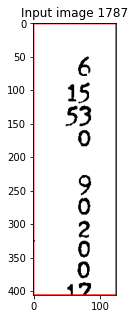

x [3398, 1787, 3521, 2193, 0, [[1228, 2193], [[2820, 1782, 3041, 2193, 0], [3526, 1782, 3658, 2193, 0]]], [1, 1, 1, 0]] [1787, 2193]
y [3398, 1787, 3521, 2193, 0, [[1228, 2193], [[2820, 1782, 3041, 2193, 0], [3526, 1782, 3658, 2193, 0]]], [1, 1, 1, 0]] [3398, 3521]


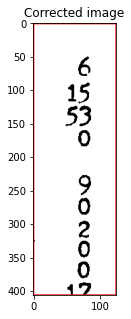

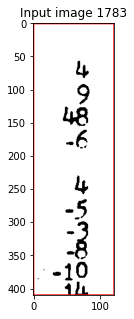

x [3531, 1783, 3653, 2193, 0, [[1228, 2193], [[3393, 1782, 3526, 2193, 0], [3658, 1782, 3808, 2193, 0]]], [1, 1, 1, 0]] [1783, 2193]
y [3531, 1783, 3653, 2193, 0, [[1228, 2193], [[3393, 1782, 3526, 2193, 0], [3658, 1782, 3808, 2193, 0]]], [1, 1, 1, 0]] [3531, 3653]


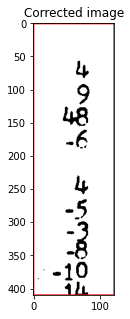

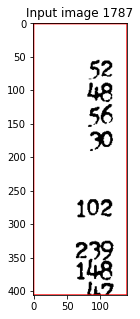

x [3663, 1787, 3803, 2193, 0, [[1228, 2193], [[3526, 1782, 3658, 2193, 0], [3808, 1782, 3932, 2193, 0]]], [1, 1, 1, 0]] [1838, 2193]
y [3663, 1787, 3803, 2193, 0, [[1228, 2193], [[3526, 1782, 3658, 2193, 0], [3808, 1782, 3932, 2193, 0]]], [1, 1, 1, 0]] [3663, 3803]


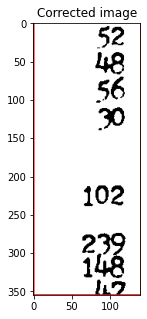

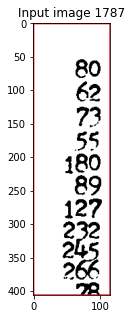

x [3813, 1787, 3927, 2193, 0, [[1228, 2193], []], [1, 1, 1, 0]] [1787, 2193]
y [3813, 1787, 3927, 2193, 0, [[1228, 2193], []], [1, 1, 1, 0]] [3856, 3927]


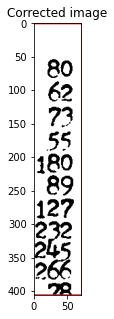

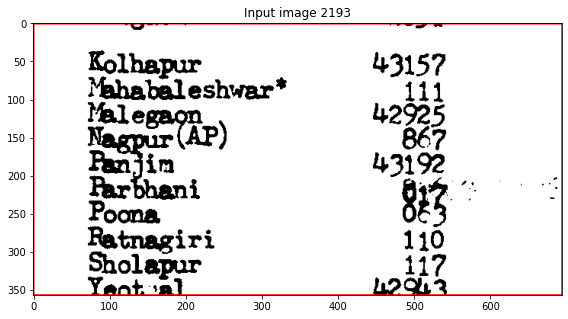

x [337, 2193, 1031, 2550, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0]]], [5, 0, 1, 0]] [2193, 2550]
y [337, 2193, 1031, 2550, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0]]], [5, 0, 1, 0]] [407, 627, 780, 1031]


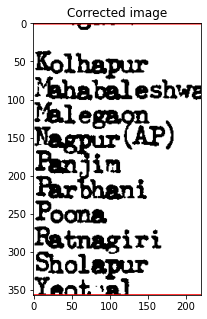

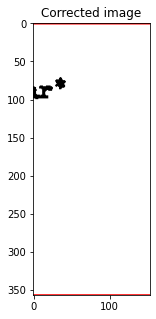

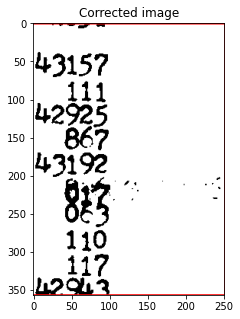

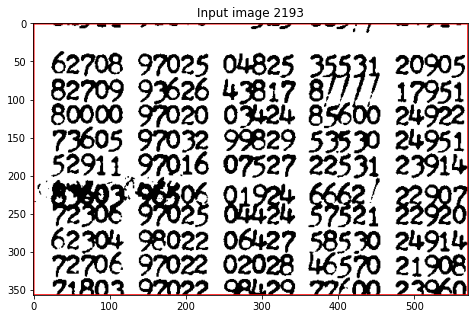

x [1041, 2193, 1612, 2550, 0, [[1782, 2550], [[337, 2193, 1036, 2550, 0], [1612, 2193, 1887, 2550, 0]]], [1, 0, 0, 0]] [2193, 2550]
y [1041, 2193, 1612, 2550, 0, [[1782, 2550], [[337, 2193, 1036, 2550, 0], [1612, 2193, 1887, 2550, 0]]], [1, 0, 0, 0]] [1041, 1612]


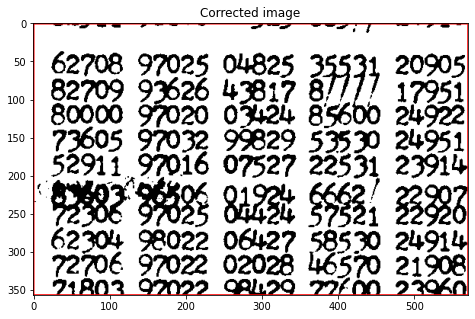

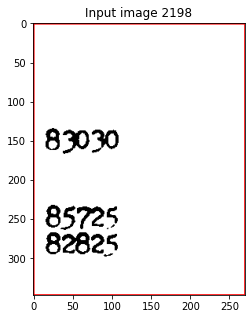

x [1612, 2198, 1882, 2545, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0], [1887, 2193, 2116, 2550, 0]]], [0, 1, 1, 1]] [2198, 2545]
y [1612, 2198, 1882, 2545, 0, [[1782, 2550], [[1036, 2193, 1612, 2550, 0], [1887, 2193, 2116, 2550, 0]]], [0, 1, 1, 1]] [1611, 1882]


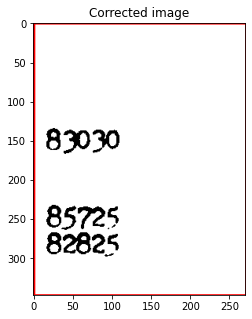

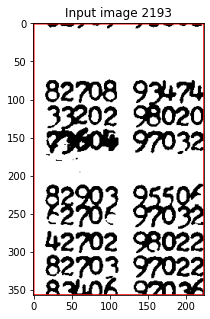

x [1892, 2193, 2116, 2550, 0, [[1782, 2550], [[1612, 2193, 1887, 2550, 0], [2116, 2193, 2464, 2550, 0]]], [1, 0, 0, 0]] [2267, 2550]
y [1892, 2193, 2116, 2550, 0, [[1782, 2550], [[1612, 2193, 1887, 2550, 0], [2116, 2193, 2464, 2550, 0]]], [1, 0, 0, 0]] [1892, 2116]


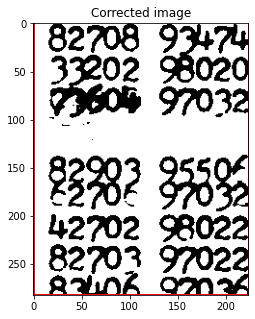

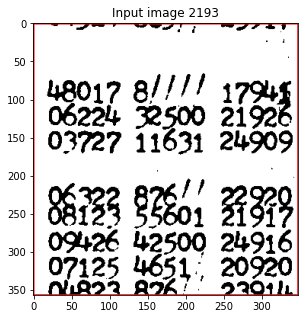

x [2116, 2193, 2464, 2550, 0, [[1782, 2550], [[1887, 2193, 2116, 2550, 0], [2464, 2193, 2598, 2550, 0]]], [0, 0, 0, 0]] [2193, 2550]
y [2116, 2193, 2464, 2550, 0, [[1782, 2550], [[1887, 2193, 2116, 2550, 0], [2464, 2193, 2598, 2550, 0]]], [0, 0, 0, 0]] [2116, 2464]


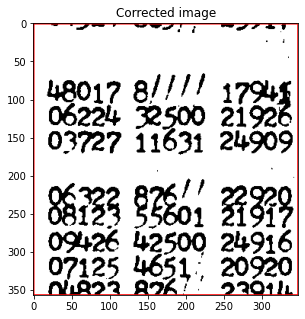

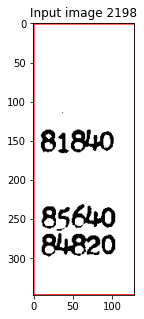

x [2464, 2198, 2593, 2545, 0, [[1782, 2550], [[2116, 2193, 2464, 2550, 0], [2820, 2193, 3041, 2550, 0]]], [0, 1, 1, 1]] [2198, 2545]
y [2464, 2198, 2593, 2545, 0, [[1782, 2550], [[2116, 2193, 2464, 2550, 0], [2820, 2193, 3041, 2550, 0]]], [0, 1, 1, 1]] [2463, 2593]


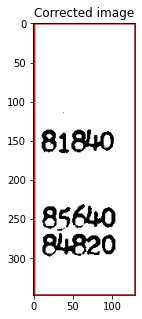

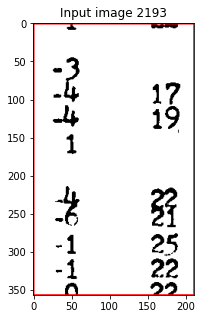

x [2825, 2193, 3036, 2550, 0, [[1782, 2550], [[2464, 2193, 2598, 2550, 0], [3393, 2193, 3526, 2550, 0]]], [1, 0, 1, 0]] [2193, 2550]
y [2825, 2193, 3036, 2550, 0, [[1782, 2550], [[2464, 2193, 2598, 2550, 0], [3393, 2193, 3526, 2550, 0]]], [1, 0, 1, 0]] [2887, 3036]


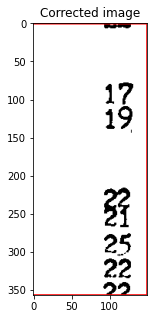

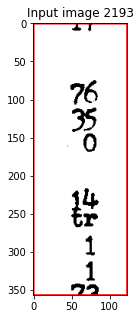

x [3398, 2193, 3521, 2550, 0, [[1782, 2550], [[2820, 2193, 3041, 2550, 0], [3526, 2193, 3658, 2550, 0]]], [1, 0, 1, 0]] [2193, 2550]
y [3398, 2193, 3521, 2550, 0, [[1782, 2550], [[2820, 2193, 3041, 2550, 0], [3526, 2193, 3658, 2550, 0]]], [1, 0, 1, 0]] [3398, 3521]


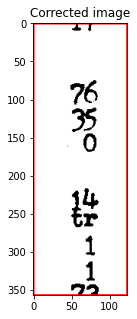

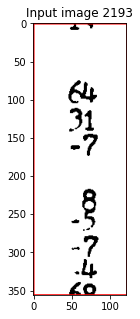

x [3531, 2193, 3653, 2549, 0, [[1782, 2550], [[3393, 2193, 3526, 2550, 0], [3658, 2193, 3808, 2550, 0]]], [1, 0, 1, 1]] [2193, 2549]
y [3531, 2193, 3653, 2549, 0, [[1782, 2550], [[3393, 2193, 3526, 2550, 0], [3658, 2193, 3808, 2550, 0]]], [1, 0, 1, 1]] [3531, 3653]


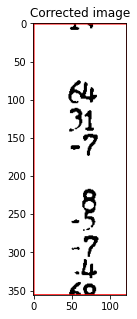

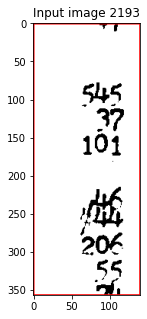

x [3663, 2193, 3803, 2550, 0, [[1782, 2550], [[3526, 2193, 3658, 2550, 0], [3808, 2193, 3932, 2550, 0]]], [1, 0, 1, 0]] [2269, 2550]
y [3663, 2193, 3803, 2550, 0, [[1782, 2550], [[3526, 2193, 3658, 2550, 0], [3808, 2193, 3932, 2550, 0]]], [1, 0, 1, 0]] [3663, 3803]


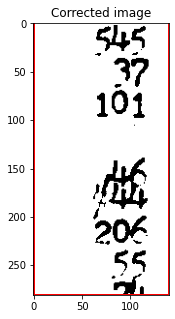

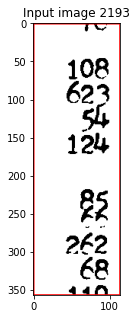

x [3813, 2193, 3927, 2550, 0, [[1782, 2550], []], [1, 0, 1, 0]] [2238, 2550]
y [3813, 2193, 3927, 2550, 0, [[1782, 2550], []], [1, 0, 1, 0]] [3853, 3927]


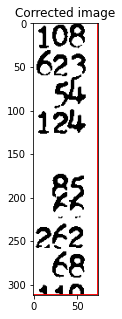

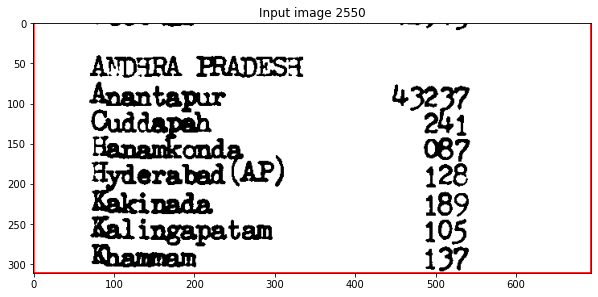

x [337, 2550, 1031, 2861, 0, [[2193, 2866], [[1036, 2550, 1612, 2866, 0]]], [5, 0, 1, 1]] [2628, 2861]
y [337, 2550, 1031, 2861, 0, [[2193, 2866], [[1036, 2550, 1612, 2866, 0]]], [5, 0, 1, 1]] [408, 677, 882, 1031]


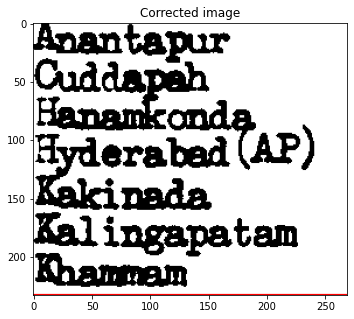

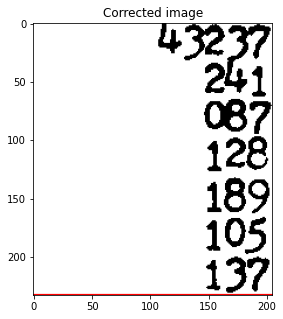

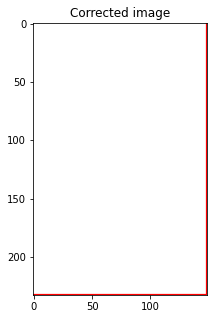

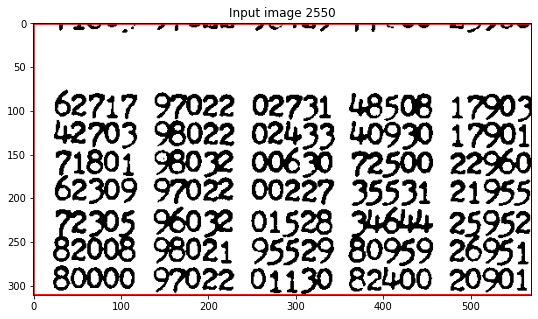

x [1041, 2550, 1611, 2861, 0, [[2193, 2866], [[337, 2550, 1036, 2866, 0], [1612, 2550, 1887, 2866, 0]]], [1, 0, 1, 1]] [2628, 2860]
y [1041, 2550, 1611, 2861, 0, [[2193, 2866], [[337, 2550, 1036, 2866, 0], [1612, 2550, 1887, 2866, 0]]], [1, 0, 1, 1]] [1041, 1611]


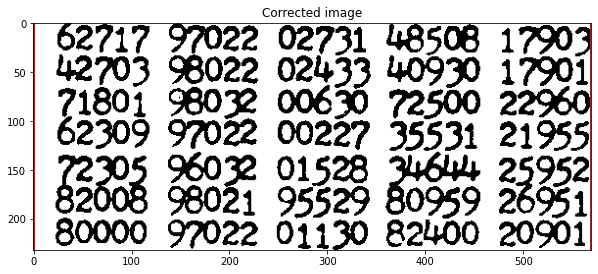

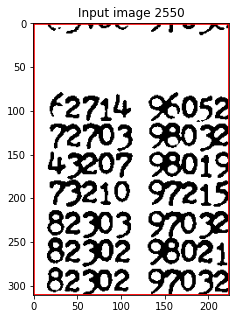

x [1892, 2550, 2116, 2861, 0, [[2193, 2866], [[1612, 2550, 1887, 2866, 0], [2116, 2550, 2464, 2866, 0]]], [1, 0, 0, 1]] [2631, 2861]
y [1892, 2550, 2116, 2861, 0, [[2193, 2866], [[1612, 2550, 1887, 2866, 0], [2116, 2550, 2464, 2866, 0]]], [1, 0, 0, 1]] [1892, 2116]


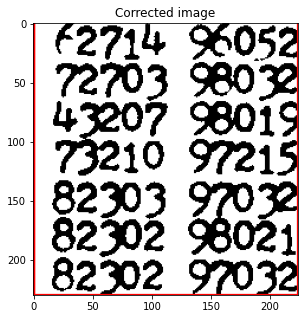

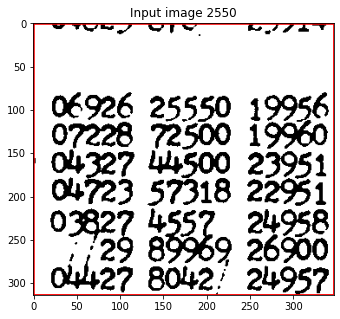

x [2116, 2550, 2463, 2864, 0, [[2193, 2866], [[1887, 2550, 2116, 2866, 0], [2464, 2550, 2598, 2866, 0]]], [0, 0, 1, 1]] [2632, 2864]
y [2116, 2550, 2463, 2864, 0, [[2193, 2866], [[1887, 2550, 2116, 2866, 0], [2464, 2550, 2598, 2866, 0]]], [0, 0, 1, 1]] [2116, 2463]


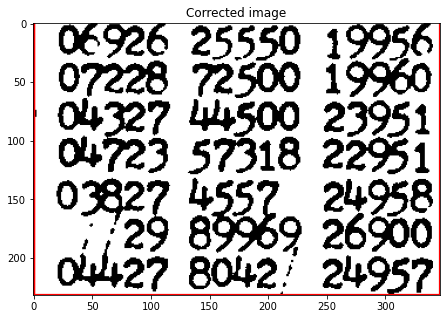

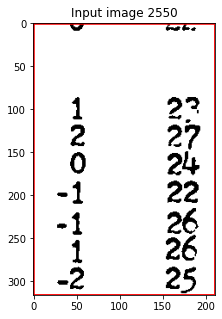

x [2825, 2550, 3036, 2866, 0, [[2193, 2866], [[2464, 2550, 2598, 2866, 0], [3393, 2550, 3526, 2866, 0]]], [1, 0, 1, 0]] [2550, 2866]
y [2825, 2550, 3036, 2866, 0, [[2193, 2866], [[2464, 2550, 2598, 2866, 0], [3393, 2550, 3526, 2866, 0]]], [1, 0, 1, 0]] [2887, 3036]


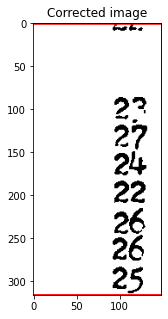

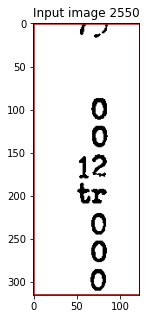

x [3398, 2550, 3521, 2865, 0, [[2193, 2866], [[2820, 2550, 3041, 2866, 0], [3658, 2550, 3808, 2866, 0]]], [1, 0, 1, 1]] [2550, 2865]
y [3398, 2550, 3521, 2865, 0, [[2193, 2866], [[2820, 2550, 3041, 2866, 0], [3658, 2550, 3808, 2866, 0]]], [1, 0, 1, 1]] [3398, 3521]


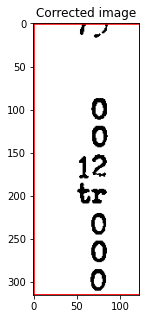

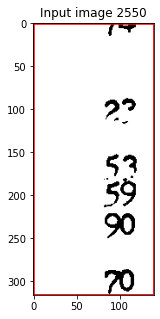

x [3663, 2550, 3803, 2866, 0, [[2193, 2866], [[3393, 2550, 3526, 2866, 0], [3808, 2550, 3932, 2866, 0]]], [1, 0, 1, 0]] [2550, 2866]
y [3663, 2550, 3803, 2866, 0, [[2193, 2866], [[3393, 2550, 3526, 2866, 0], [3808, 2550, 3932, 2866, 0]]], [1, 0, 1, 0]] [3663, 3803]


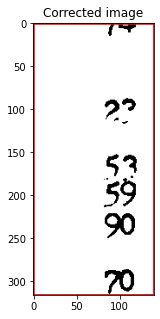

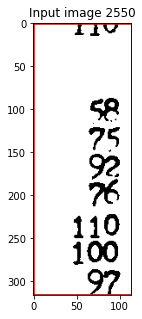

x [3813, 2550, 3927, 2866, 0, [[2193, 2866], []], [1, 0, 1, 0]] [2631, 2866]
y [3813, 2550, 3927, 2866, 0, [[2193, 2866], []], [1, 0, 1, 0]] [3813, 3927]


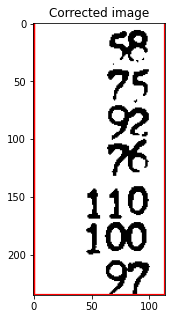

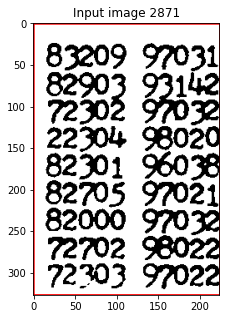

x [1892, 2871, 2116, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0]]], [1, 1, 0, 1]] [2993, 3189]
y [1892, 2871, 2116, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0]]], [1, 1, 0, 1]] [1892, 2116]


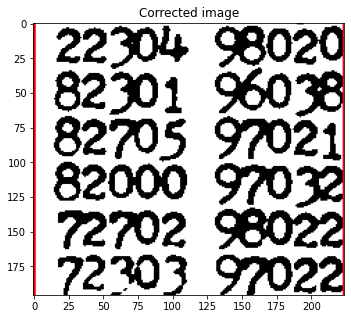

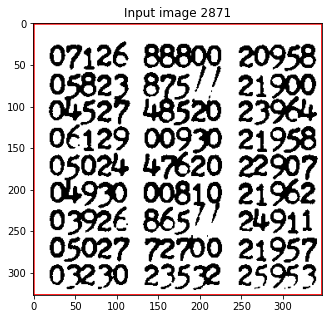

x [2116, 2871, 2463, 3198, 0, [[2550, 3203], [[1887, 2866, 2116, 3203, 0], [2820, 2866, 3041, 3203, 0]]], [0, 1, 1, 1]] [2895, 3190]
y [2116, 2871, 2463, 3198, 0, [[2550, 3203], [[1887, 2866, 2116, 3203, 0], [2820, 2866, 3041, 3203, 0]]], [0, 1, 1, 1]] [2116, 2463]


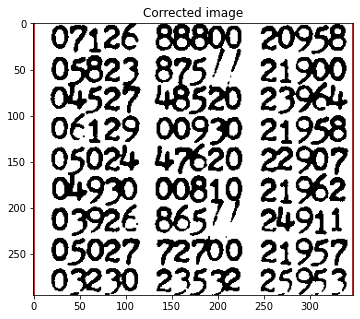

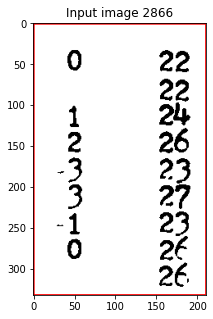

x [2825, 2866, 3036, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0], [3808, 2866, 3932, 3203, 0]]], [1, 0, 1, 1]] [2865, 3189]
y [2825, 2866, 3036, 3198, 0, [[2550, 3203], [[2116, 2866, 2464, 3203, 0], [3808, 2866, 3932, 3203, 0]]], [1, 0, 1, 1]] [2887, 3036]


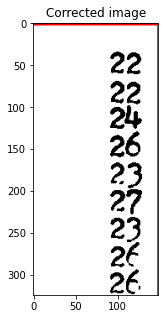

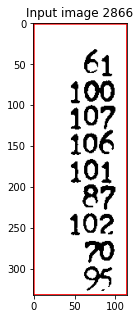

x [3813, 2866, 3927, 3198, 0, [[2550, 3203], []], [1, 0, 1, 1]] [2865, 3044, 3198]
y [3813, 2866, 3927, 3198, 0, [[2550, 3203], []], [1, 0, 1, 1]] [3854, 3927]


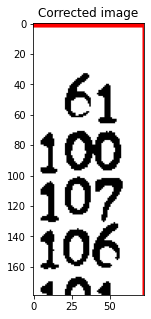

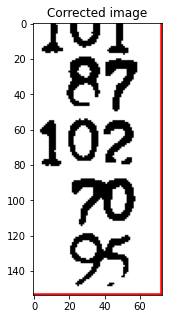

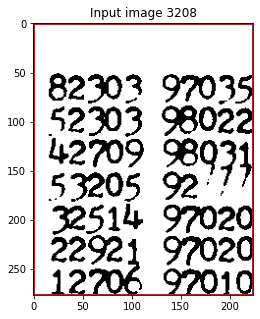

x [1892, 3208, 2116, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0]]], [1, 1, 0, 0]] [3258, 3485]
y [1892, 3208, 2116, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0]]], [1, 1, 0, 0]] [1892, 2116]


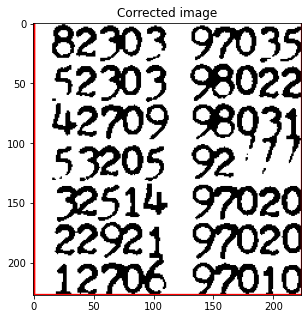

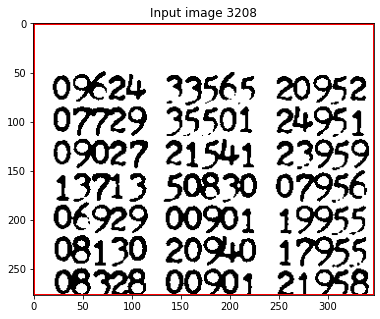

x [2116, 3208, 2463, 3485, 0, [[2866, 3485], [[1887, 3203, 2116, 3485, 0], [2820, 3203, 3041, 3485, 0]]], [0, 1, 1, 0]] [3258, 3485]
y [2116, 3208, 2463, 3485, 0, [[2866, 3485], [[1887, 3203, 2116, 3485, 0], [2820, 3203, 3041, 3485, 0]]], [0, 1, 1, 0]] [2116, 2463]


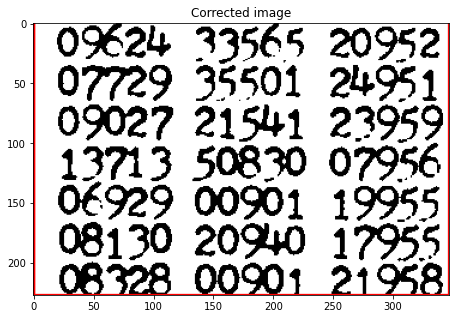

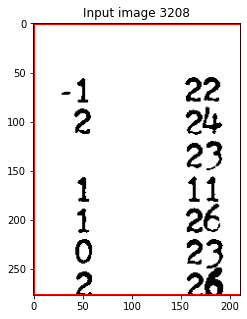

x [2825, 3208, 3036, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0], [3526, 3203, 3658, 3485, 0]]], [1, 1, 1, 0]] [3208, 3485]
y [2825, 3208, 3036, 3485, 0, [[2866, 3485], [[2116, 3203, 2464, 3485, 0], [3526, 3203, 3658, 3485, 0]]], [1, 1, 1, 0]] [2889, 3036]


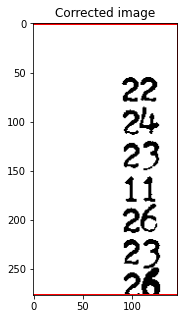

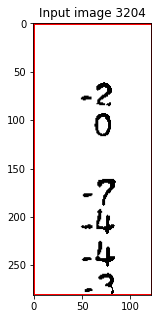

x [3531, 3204, 3653, 3485, 0, [[2866, 3485], [[2820, 3203, 3041, 3485, 0], [3658, 3203, 3808, 3485, 0]]], [1, 1, 1, 0]] [3204, 3485]
y [3531, 3204, 3653, 3485, 0, [[2866, 3485], [[2820, 3203, 3041, 3485, 0], [3658, 3203, 3808, 3485, 0]]], [1, 1, 1, 0]] [3531, 3653]


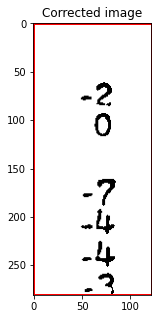

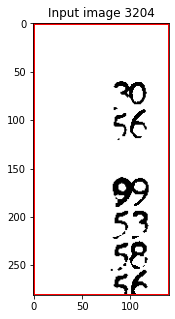

x [3663, 3204, 3803, 3485, 0, [[2866, 3485], [[3526, 3203, 3658, 3485, 0], [3808, 3203, 3932, 3485, 0]]], [1, 1, 1, 0]] [3220, 3485]
y [3663, 3204, 3803, 3485, 0, [[2866, 3485], [[3526, 3203, 3658, 3485, 0], [3808, 3203, 3932, 3485, 0]]], [1, 1, 1, 0]] [3663, 3803]


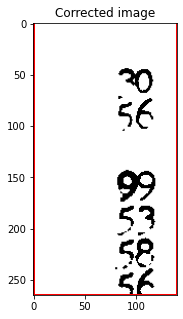

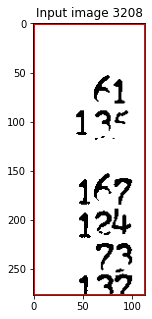

x [3813, 3208, 3927, 3485, 0, [[2866, 3485], []], [1, 1, 1, 0]] [3208, 3485]
y [3813, 3208, 3927, 3485, 0, [[2866, 3485], []], [1, 1, 1, 0]] [3853, 3927]


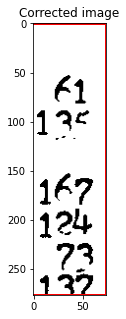

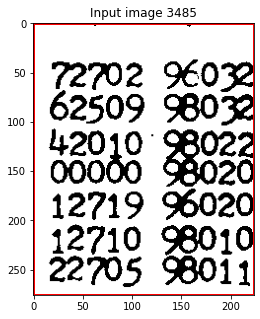

x [1892, 3485, 2116, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0]]], [1, 0, 0, 1]] [3485, 3761]
y [1892, 3485, 2116, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0]]], [1, 0, 0, 1]] [1892, 2116]


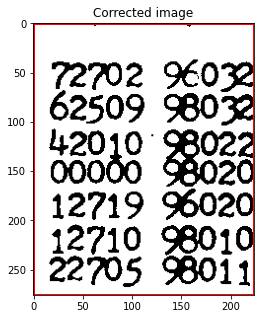

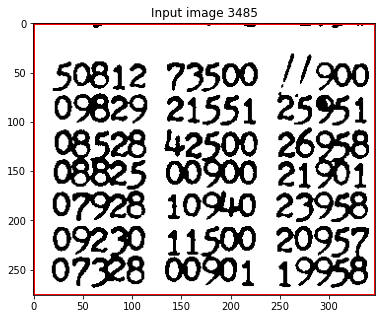

x [2116, 3485, 2463, 3761, 0, [[3203, 3766], [[1887, 3485, 2116, 3766, 0], [2820, 3485, 3041, 3766, 0]]], [0, 0, 1, 1]] [3485, 3761]
y [2116, 3485, 2463, 3761, 0, [[3203, 3766], [[1887, 3485, 2116, 3766, 0], [2820, 3485, 3041, 3766, 0]]], [0, 0, 1, 1]] [2116, 2463]


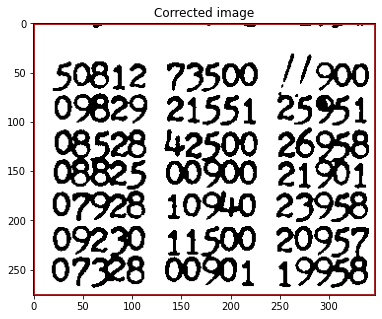

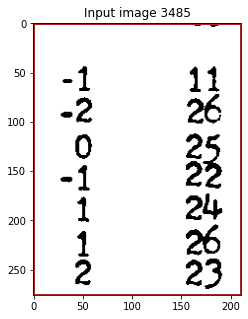

x [2825, 3485, 3036, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0], [3526, 3485, 3658, 3766, 0]]], [1, 0, 1, 1]] [3484, 3756]
y [2825, 3485, 3036, 3761, 0, [[3203, 3766], [[2116, 3485, 2464, 3766, 0], [3526, 3485, 3658, 3766, 0]]], [1, 0, 1, 1]] [2887, 3036]


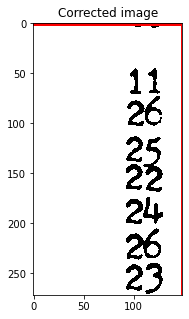

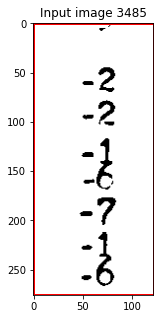

x [3531, 3485, 3653, 3761, 0, [[3203, 3766], [[2820, 3485, 3041, 3766, 0], [3658, 3485, 3808, 3766, 0]]], [1, 0, 1, 1]] [3484, 3753]
y [3531, 3485, 3653, 3761, 0, [[3203, 3766], [[2820, 3485, 3041, 3766, 0], [3658, 3485, 3808, 3766, 0]]], [1, 0, 1, 1]] [3531, 3653]


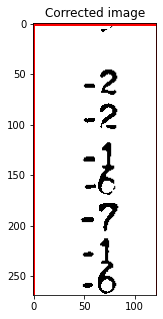

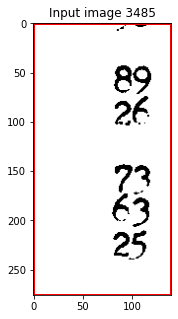

x [3663, 3485, 3803, 3761, 0, [[3203, 3766], [[3526, 3485, 3658, 3766, 0], [3808, 3485, 3932, 3766, 0]]], [1, 0, 1, 1]] [3484, 3726]
y [3663, 3485, 3803, 3761, 0, [[3203, 3766], [[3526, 3485, 3658, 3766, 0], [3808, 3485, 3932, 3766, 0]]], [1, 0, 1, 1]] [3663, 3803]


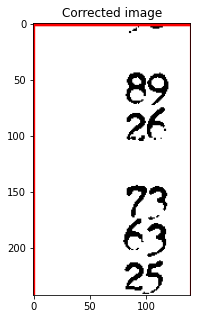

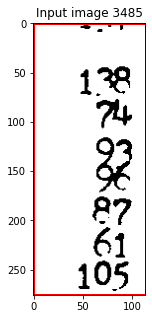

x [3813, 3485, 3927, 3761, 0, [[3203, 3766], []], [1, 0, 1, 1]] [3527, 3755]
y [3813, 3485, 3927, 3761, 0, [[3203, 3766], []], [1, 0, 1, 1]] [3813, 3927]


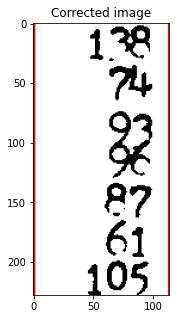

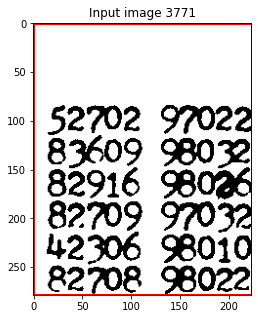

x [1892, 3771, 2116, 4050, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0]]], [1, 1, 0, 1]] [3854, 4049]
y [1892, 3771, 2116, 4050, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0]]], [1, 1, 0, 1]] [1892, 2116]


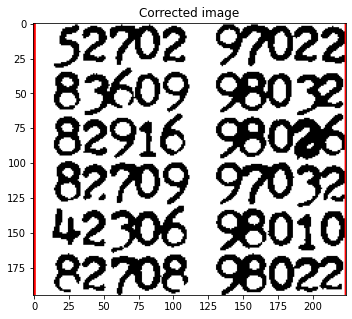

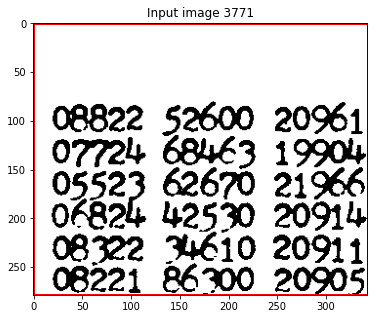

x [2116, 3771, 2459, 4050, 0, [[3485, 4055], [[1887, 3766, 2116, 4055, 0], [3658, 3766, 3808, 4055, 0]]], [0, 1, 1, 1]] [3853, 4050]
y [2116, 3771, 2459, 4050, 0, [[3485, 4055], [[1887, 3766, 2116, 4055, 0], [3658, 3766, 3808, 4055, 0]]], [0, 1, 1, 1]] [2115, 2458]


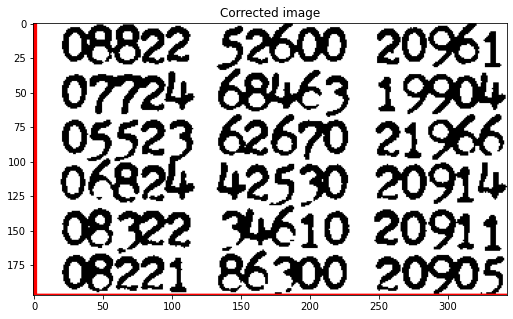

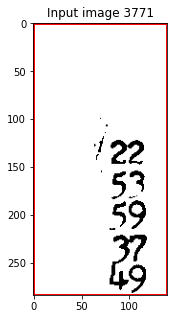

x [3663, 3771, 3803, 4055, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0], [3808, 3766, 3932, 4055, 0]]], [1, 1, 1, 0]] [3771, 4055]
y [3663, 3771, 3803, 4055, 0, [[3485, 4055], [[2116, 3766, 2464, 4055, 0], [3808, 3766, 3932, 4055, 0]]], [1, 1, 1, 0]] [3663, 3803]


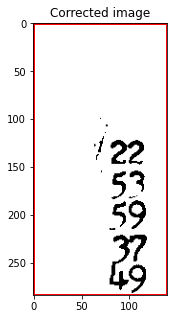

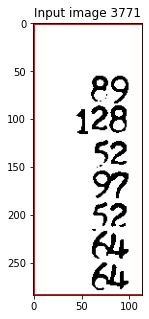

x [3813, 3771, 3927, 4055, 0, [[3485, 4055], []], [1, 1, 1, 0]] [3771, 4055]
y [3813, 3771, 3927, 4055, 0, [[3485, 4055], []], [1, 1, 1, 0]] [3813, 3927]


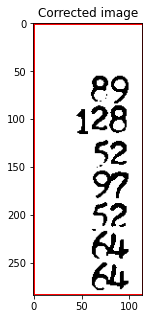

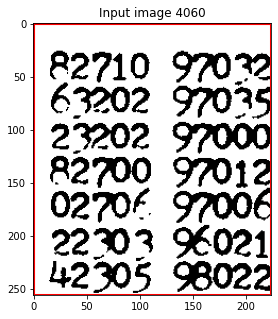

x [1892, 4060, 2116, 4316, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0]]], [1, 1, 0, 1]] [4085, 4313]
y [1892, 4060, 2116, 4316, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0]]], [1, 1, 0, 1]] [1892, 2116]


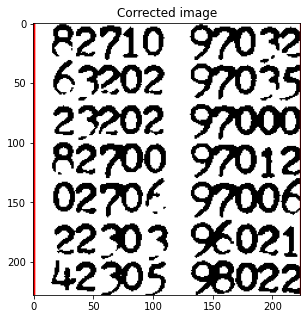

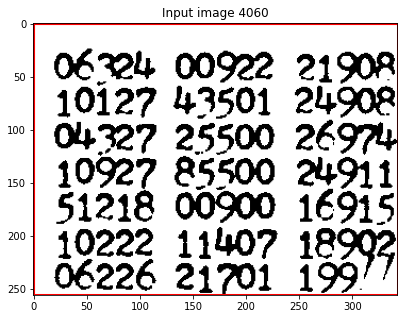

x [2116, 4060, 2459, 4316, 0, [[3766, 4321], [[1887, 4055, 2116, 4321, 0], [3658, 4055, 3808, 4321, 0]]], [0, 1, 1, 1]] [4152, 4316]
y [2116, 4060, 2459, 4316, 0, [[3766, 4321], [[1887, 4055, 2116, 4321, 0], [3658, 4055, 3808, 4321, 0]]], [0, 1, 1, 1]] [2115, 2458]


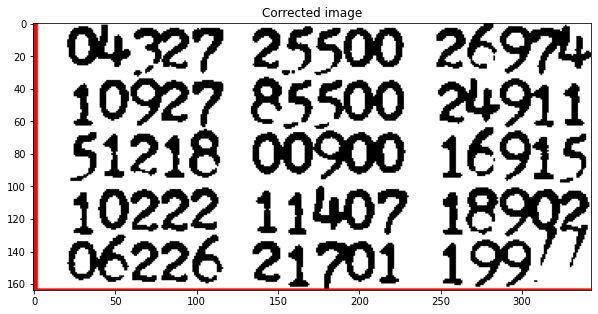

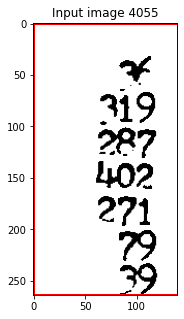

x [3663, 4055, 3803, 4319, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0], [3808, 4055, 3932, 4321, 0]]], [1, 0, 1, 1]] [4055, 4319]
y [3663, 4055, 3803, 4319, 0, [[3766, 4321], [[2116, 4055, 2464, 4321, 0], [3808, 4055, 3932, 4321, 0]]], [1, 0, 1, 1]] [3724, 3803]


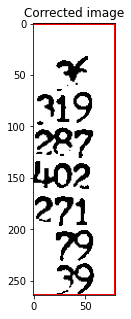

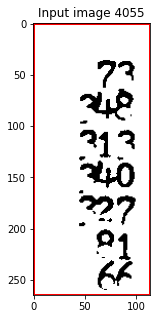

x [3813, 4055, 3927, 4320, 0, [[3766, 4321], []], [1, 0, 1, 1]] [4055, 4320]
y [3813, 4055, 3927, 4320, 0, [[3766, 4321], []], [1, 0, 1, 1]] [3813, 3927]


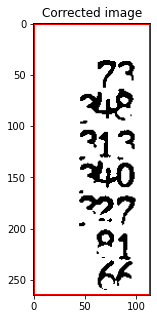

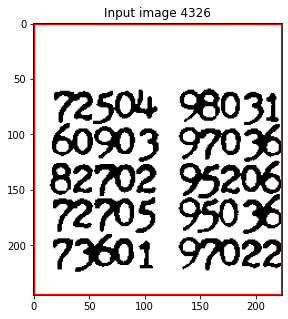

x [1892, 4326, 2116, 4571, 0, [[4055, 4576], [[1612, 4321, 1887, 4576, 0], [2116, 4321, 2464, 4576, 0]]], [1, 1, 0, 1]] [4386, 4571]
y [1892, 4326, 2116, 4571, 0, [[4055, 4576], [[1612, 4321, 1887, 4576, 0], [2116, 4321, 2464, 4576, 0]]], [1, 1, 0, 1]] [1892, 2116]


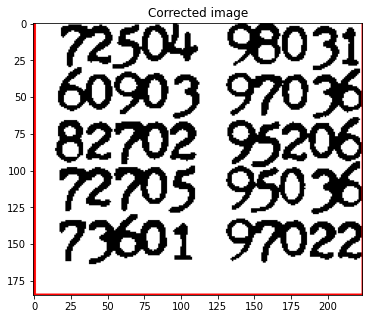

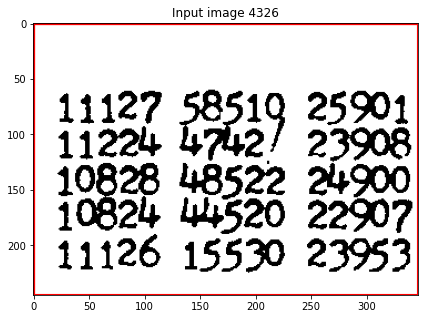

x [2116, 4326, 2463, 4571, 0, [[4055, 4576], [[1887, 4321, 2116, 4576, 0], [2464, 4321, 2598, 4576, 0]]], [0, 1, 1, 1]] [4386, 4571]
y [2116, 4326, 2463, 4571, 0, [[4055, 4576], [[1887, 4321, 2116, 4576, 0], [2464, 4321, 2598, 4576, 0]]], [0, 1, 1, 1]] [2116, 2463]


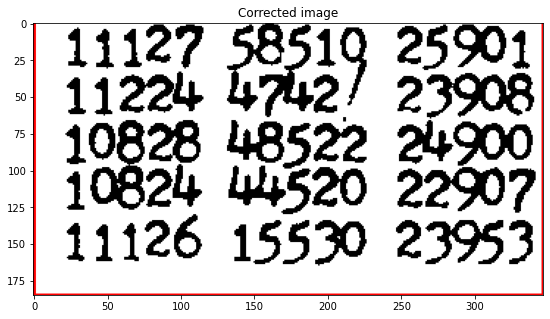

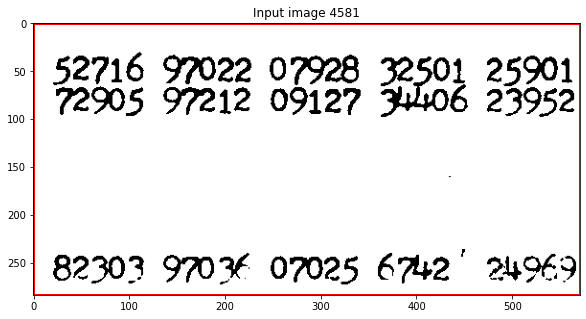

x [1041, 4581, 1612, 4865, 0, [[], [[337, 4576, 1036, 4865, 0], [1612, 4576, 1887, 4865, 0]]], [1, 1, 0, 5]] [4676, 4865]
y [1041, 4581, 1612, 4865, 0, [[], [[337, 4576, 1036, 4865, 0], [1612, 4576, 1887, 4865, 0]]], [1, 1, 0, 5]] [1041, 1612]


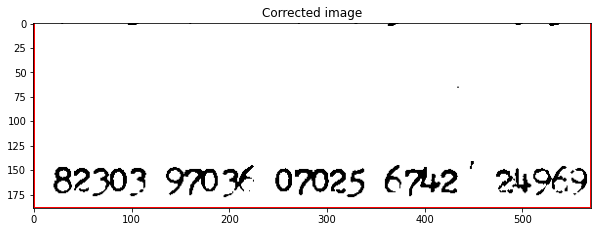

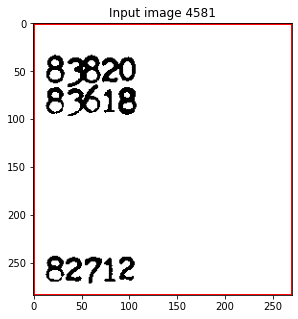

x [1612, 4581, 1882, 4865, 0, [[], [[1036, 4576, 1612, 4865, 0], [1887, 4576, 2116, 4865, 0]]], [0, 1, 1, 5]] [4677, 4865]
y [1612, 4581, 1882, 4865, 0, [[], [[1036, 4576, 1612, 4865, 0], [1887, 4576, 2116, 4865, 0]]], [0, 1, 1, 5]] [1611, 1882]


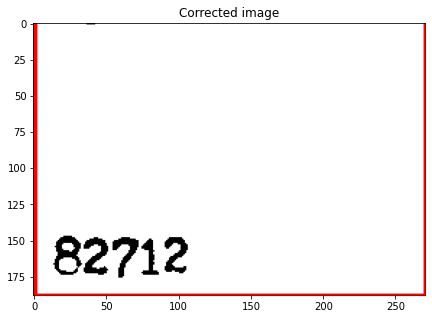

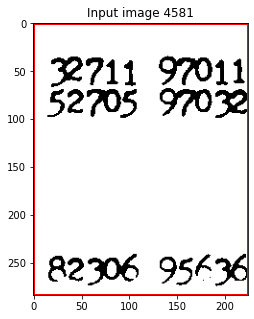

x [1892, 4581, 2116, 4865, 0, [[], [[1612, 4576, 1887, 4865, 0], [2116, 4576, 2464, 4865, 0]]], [1, 1, 0, 5]] [4680, 4865]
y [1892, 4581, 2116, 4865, 0, [[], [[1612, 4576, 1887, 4865, 0], [2116, 4576, 2464, 4865, 0]]], [1, 1, 0, 5]] [1892, 2116]


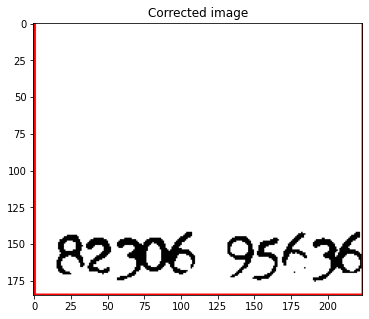

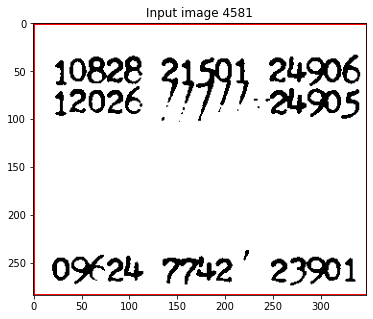

x [2116, 4581, 2464, 4865, 0, [[], [[1887, 4576, 2116, 4865, 0], [2464, 4576, 2598, 4865, 0]]], [0, 1, 0, 5]] [4678, 4865]
y [2116, 4581, 2464, 4865, 0, [[], [[1887, 4576, 2116, 4865, 0], [2464, 4576, 2598, 4865, 0]]], [0, 1, 0, 5]] [2116, 2464]


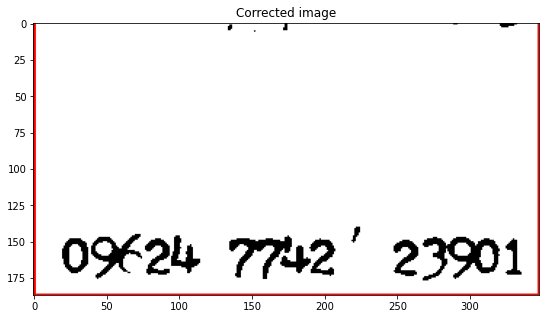

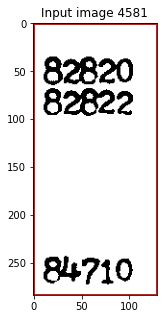

x [2464, 4581, 2593, 4865, 0, [[], [[2116, 4576, 2464, 4865, 0], [3808, 4576, 3932, 4865, 0]]], [0, 1, 1, 5]] [4679, 4865]
y [2464, 4581, 2593, 4865, 0, [[], [[2116, 4576, 2464, 4865, 0], [3808, 4576, 3932, 4865, 0]]], [0, 1, 1, 5]] [2463, 2593]


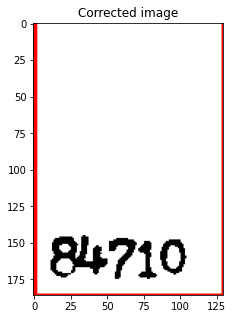

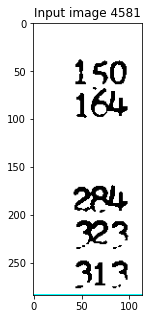

x [3813, 4581, 3927, 4865, 0, [[], []], [1, 1, 1, 5]] [4581, 4865]
y [3813, 4581, 3927, 4865, 0, [[], []], [1, 1, 1, 5]] [3852, 3927]


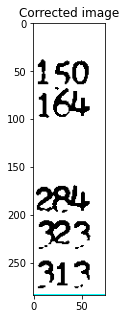

In [179]:
error_cells_corrected = []
for imagedraw in not_corrected_excluded_cells:#
    
    croppedimage_full=image[int(imagedraw[1]):int(imagedraw[3]),int(imagedraw[0]):int(imagedraw[2])]
    plt.rcParams["figure.figsize"] = (10,5)
    plt.imshow(croppedimage_full)
    plt.title(f'Input image {imagedraw[1]}')
    plt.show()
    
    possible_cells = segment_image(image, imagedraw, masks[1])
    error_cells_corrected += possible_cells
    for cell in possible_cells:
        croppedimage_full=image[int(cell[1]):int(cell[3]),int(cell[0]):int(cell[2])]
        plt.rcParams["figure.figsize"] = (10,5)
        plt.imshow(croppedimage_full)
        plt.title(f'Corrected image')
        plt.show()
    

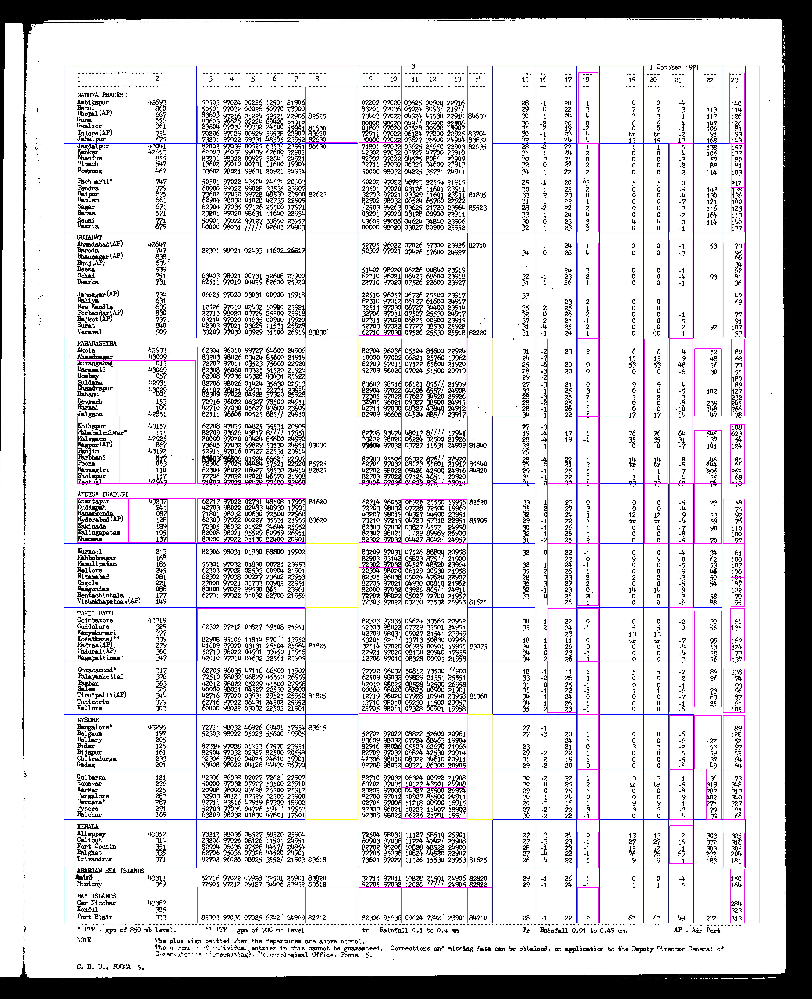

In [182]:
img = cv.imread("temp.jpg")
image, height, width, _ = image_preprocessing(img)

color = 255
for box in tables:
    box = list(map(int, box[0:4]))
    put_box(image,box,(0,color,color)) # Cyan 
    
for box in correct_cells:
    put_box(image,box,(0,0,color)) # Blue
    
for box in corrected_cells: #corrected_excluded_cells
    put_box(image,box,(0,color,0)) # Green

for box in new_corrected_cells:
    put_box(image,box,(color,0,color)) # pink
    
for box in error_cells_corrected:
#     print(box)
    put_box(image,box,(color,0,color))  # pink
    
for box in blank_cells:   
    put_box(image,box,(color,color,0)) # Yellow

im_pil = Image.fromarray(image)
im_pil.save(f"{filename}_temp_cell_multiple_cell_segmentation_correction.jpg")
im_pil  